In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import os
import sys

sys.path.insert(0, "C:/workspace/data-science//libs")

from uniswap_v2_tools import show_swaps_count_moving_averages, show_reserves_time_distribution,\
                                show_reserve_price_distributions, show_swaps_amount_in_moving_averages,\
                                    calc_price_and_increase_rates, increase_rate_moving_averages,\
                                        swaps_price_change_rates_moving_averages, pyplot_line_swap_change_rate,\
                                            pyplot_line_swap_prices, get_df_with_swap_prices_and_change_rates

In [2]:
sns.set_style("darkgrid", {"grid.color": ".6", "grid.linestyle": ":"})

# Reading data from pickle files

## WBTC/USDC

In [3]:
wbtc_usdc_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\wbtc_usdc_swaps.pkl')
wbtc_usdc_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\wbtc_usdc_mints.pkl")
wbtc_usdc_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\wbtc_usdc_burns.pkl")
wbtc_usdc_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\wbtc_usdc_reserves.pkl")

### Plot swapping in moving averages

In [4]:
wbtc_usdc_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
0,USDC,WBTC,1.534170e-01,0.000016,0.152773,2020-05-19 23:44:23,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x3da4491fed9f6d6b1391b2a02991c8d035d7716f,0xba9a47ed6b7d293da7e7643f434055ff76bdf609274f...
1,WBTC,USDC,2.501000e-04,2.367365,2.331250,2020-05-21 14:39:56,0x96569f124f6a3b62093c7115f14f8005705ba48a,0x96569f124f6a3b62093c7115f14f8005705ba48a,0xffff2870fd0aa2f909766844c95f53b83625854c925e...
2,WBTC,USDC,1.047330e-03,9.603013,9.597534,2020-05-22 20:47:02,0x96569f124f6a3b62093c7115f14f8005705ba48a,0x96569f124f6a3b62093c7115f14f8005705ba48a,0x68e9800197efaafee864d33cf6167d12e4aa29a527c9...
3,USDC,WBTC,8.923190e-01,0.000098,0.889846,2020-05-23 14:00:42,0x0d4743269fec611b422d0a209a460cd8cc0cc8b9,0x0d4743269fec611b422d0a209a460cd8cc0cc8b9,0x33fbec2e6e1a3a04a1f5109f3a8809f32c7ad7e75c7d...
4,WBTC,USDC,1.100000e-07,0.001000,0.000989,2020-05-24 17:37:32,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x211b6a1137bf539b2750e02b9e525cf5757a35ae,0x273375cad4d5cf584b70af639f3cf07a53ba00a07216...
...,...,...,...,...,...,...,...,...,...
68192,WBTC,USDC,7.505690e-03,424.700527,424.401522,2021-11-24 06:24:58,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xd75d1b30967d94b105f82f572ae7591cc3c48beb,0xf7fcf21f336b907c9f983231daee0e3cca573e31032a...
68193,WBTC,USDC,1.725796e-02,975.214613,976.463205,2021-11-24 06:41:08,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x85673c92f0f27a9c4d8c221f6bfefa33b716338a,0x78cf5c68d2d52bde37e7cfb356978292c80b2398b550...
68194,USDC,WBTC,3.800000e+02,0.006688,379.774886,2021-11-24 08:25:43,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0x4580925acc55d095ba7898a7126ba53e8a0279f0,0x34c587fb8a1264f5602634aa427a3cc813de87a2b329...
68195,WBTC,USDC,9.563900e-03,540.045837,539.794473,2021-11-24 13:58:33,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xea91e017718fddbd897e4b0fc8b5412f996f63f4,0x1a90f7b00cf1a94adc2742533e89b0cae39efdd9d76f...


In [5]:
wbtc_usdc_df = get_df_with_swap_prices_and_change_rates(wbtc_usdc_df, first_token='WBTC', second_token='USDC')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


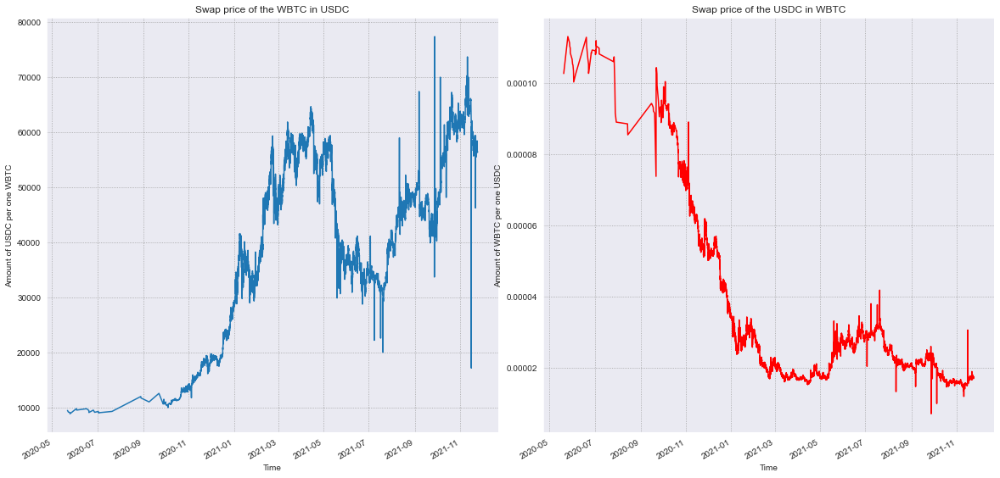

In [6]:
pyplot_line_swap_prices(wbtc_usdc_df, first_token='WBTC', second_token='USDC', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

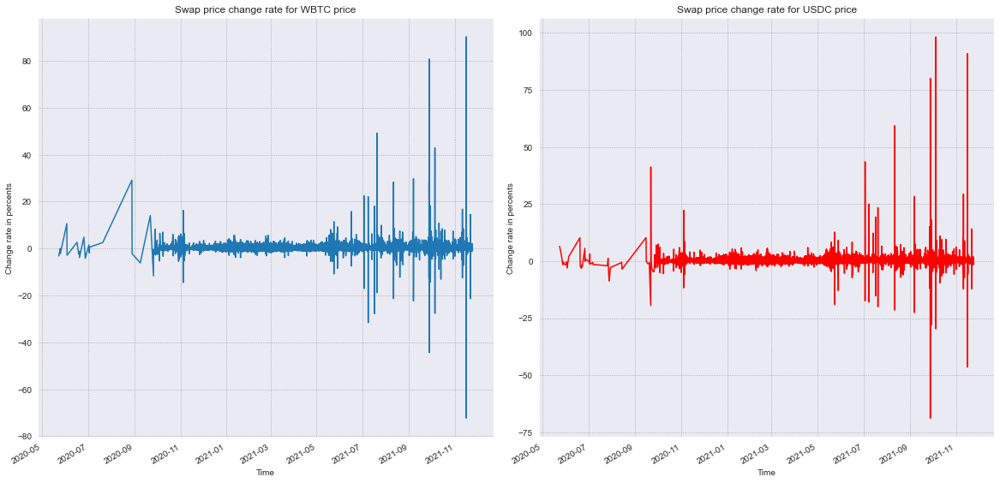

In [7]:
pyplot_line_swap_change_rate(wbtc_usdc_df, first_token='WBTC', second_token='USDC', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

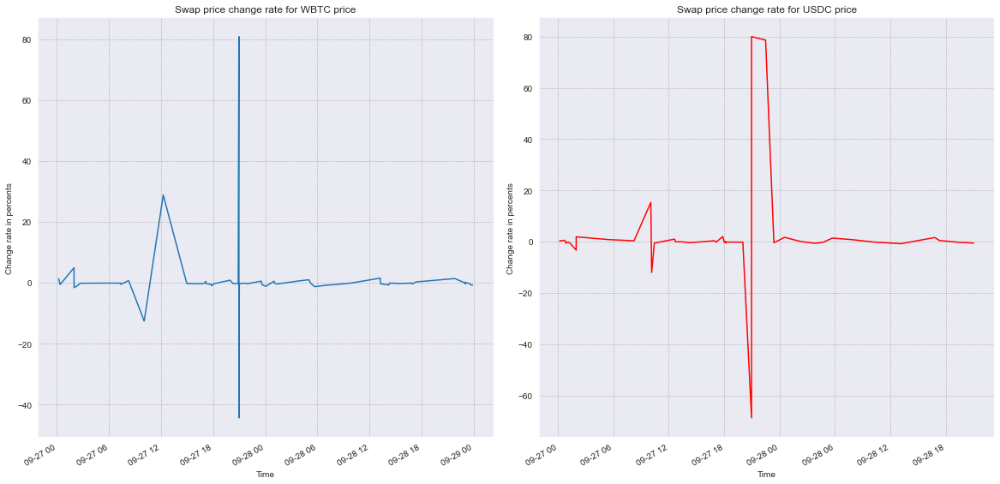

In [8]:
pyplot_line_swap_change_rate(wbtc_usdc_df[(wbtc_usdc_df.timestamp > datetime(2021, 9, 27)) & (wbtc_usdc_df.timestamp < datetime(2021, 9, 29))], 
                             first_token='WBTC', second_token='USDC', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

In [9]:
wbtc_usdc_df[(wbtc_usdc_df.price_change_rate < -40) | (wbtc_usdc_df.price_change_rate > 60)]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
65608,USDC,WBTC,12797.000000,0.092386,12787.458570,2021-09-27 20:58:07,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xdef39a2600f238bfe876484e21593690d01e7764,0x6e57b981d7157d234c0d68ca9f8c2aebc2a713f2533a...,0.000007,-68.754858
65609,USDC,WBTC,976323.861321,12.689636,975595.915259,2021-09-27 20:58:07,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x9bb156818f3af965f5d1ead14c1c55ed666e3d2eb36d...,0.000013,80.034360
65610,WBTC,USDC,12.689636,981830.211723,981098.160132,2021-09-27 20:58:07,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x00000000003b3cc22af3ae1eac0440bcee416b40,0xbf0d923e72d3a107e8183b77e422c6efddb5d136137c...,77372.604033,80.812972
65611,WBTC,USDC,0.061308,2641.148760,2641.231852,2021-09-27 20:58:58,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x8f7037074c7cd129588b5a8d731d116dc645eb6a,0xa58e69a29f0682fc8d5f9633bd0a934aef9c0f1a69a8...,43080.318166,-44.320966
65615,USDC,WBTC,2841.861339,0.065991,2842.008042,2021-09-27 22:29:30,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbb2b8038a1640196fbe3e38816f3e67cba72d940,0xdac0fff47147f08f30a2ee2f0c460cec6a99f400ce1f...,0.000023,78.660438
66007,USDC,WBTC,6542.858397,0.130782,6539.810070,2021-10-05 09:01:27,0x66f049111958809841bbe4b81c034da2d953aa0c,0x66f049111958809841bbe4b81c034da2d953aa0c,0x1715da453f2209c63f61d0380ed1958e13337a982e23...,0.000020,98.269215
67842,WBTC,USDC,0.135050,2317.565630,2317.813095,2021-11-16 03:28:33,0xdef171fe48cf0115b1d80b88dc8eab59176fee57,0xdef171fe48cf0115b1d80b88dc8eab59176fee57,0x33d6505eb7aa398f716d9019b97d75e6c57c9f473912...,17160.761385,-72.244336
67843,WBTC,USDC,15.779159,515070.486917,515125.485123,2021-11-16 03:28:33,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x34ccc48a1b7898a258159872b583775cd97ebbe7cbe9...,32642.454398,90.215653
67844,USDC,WBTC,515070.490141,15.826300,515125.488347,2021-11-16 03:28:33,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x4585fe77225b41b697c938b018e2ac67ac5a20c0,0x891cf339a78154fac5a8974e17f26ba6b3304a0dc5fa...,0.000031,90.909335
67845,WBTC,USDC,0.155345,9442.880753,9453.877101,2021-11-16 03:28:33,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x74de5d4fcbf63e00296fd95d33236b9794016631,0xb6be807b4ceefa1b0ef82eb902c1bd60681acb17731a...,60786.660993,86.219640


In [10]:
wbtc_usdc_df[wbtc_usdc_df.timestamp == datetime(2021, 9, 27, 20, 58, 7)]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
65608,USDC,WBTC,12797.000000,0.092386,12787.458570,2021-09-27 20:58:07,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xdef39a2600f238bfe876484e21593690d01e7764,0x6e57b981d7157d234c0d68ca9f8c2aebc2a713f2533a...,0.000007,-68.754858
65609,USDC,WBTC,976323.861321,12.689636,975595.915259,2021-09-27 20:58:07,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x9bb156818f3af965f5d1ead14c1c55ed666e3d2eb36d...,0.000013,80.034360
65610,WBTC,USDC,12.689636,981830.211723,981098.160132,2021-09-27 20:58:07,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x00000000003b3cc22af3ae1eac0440bcee416b40,0xbf0d923e72d3a107e8183b77e422c6efddb5d136137c...,77372.604033,80.812972


C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


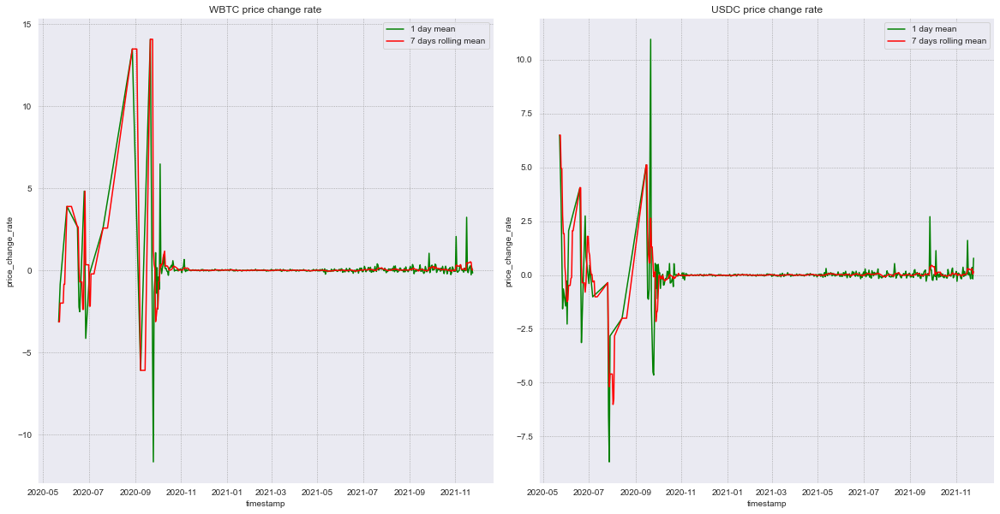

In [11]:
swaps_price_change_rates_moving_averages(wbtc_usdc_df, first_token='WBTC', second_token='USDC', 
                                           first_plot_name='WBTC price change rate', second_plot_name='USDC price change rate', 
                                           x_size=20, y_size=10)

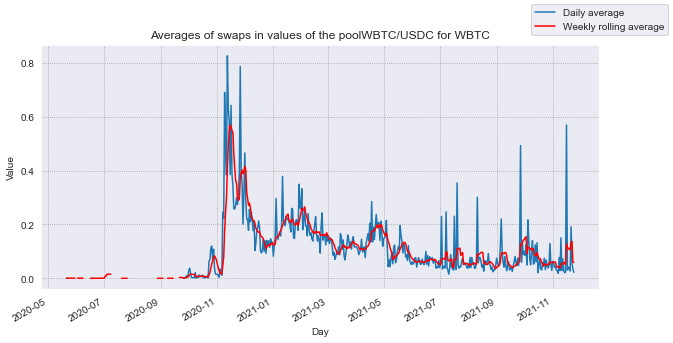

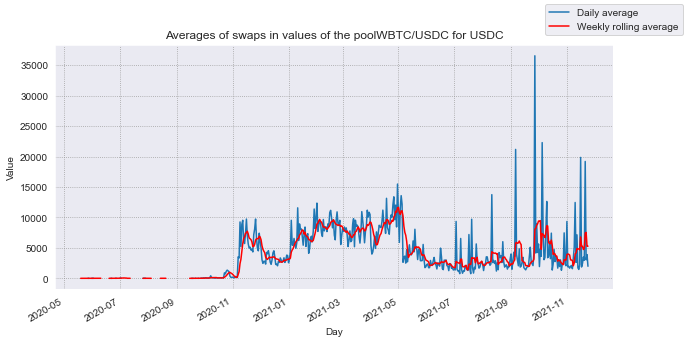

In [12]:
show_swaps_amount_in_moving_averages(swaps_df=wbtc_usdc_df[(wbtc_usdc_df.token_in == 'WBTC')], 
                                     pool_name="WBTC/USDC for WBTC")
show_swaps_amount_in_moving_averages(swaps_df=wbtc_usdc_df[(wbtc_usdc_df.token_in == 'USDC')], 
                                     pool_name="WBTC/USDC for USDC")

### Swaps values histograms

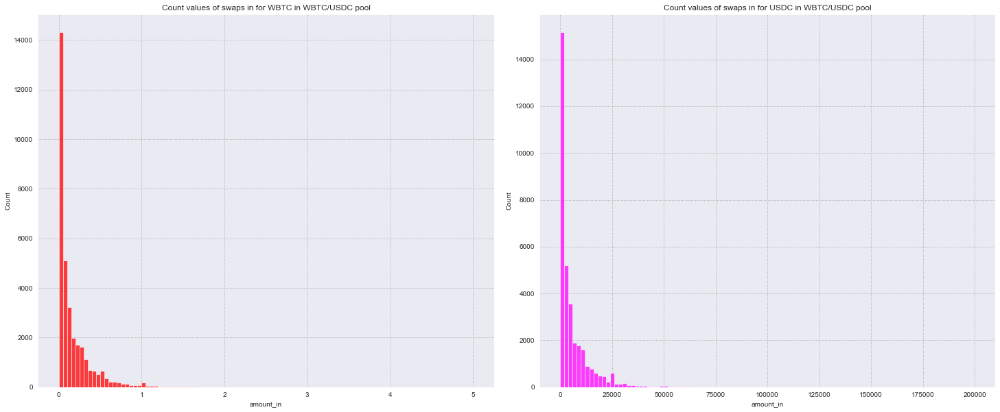

In [13]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=wbtc_usdc_df[wbtc_usdc_df.token_in == 'WBTC'], x='amount_in', bins=100, 
             color='red', binrange=[0, 5]).set_title("Count values of swaps in for WBTC in WBTC/USDC pool")
plt.subplot(1, 2, 2)
sns.histplot(data=wbtc_usdc_df[wbtc_usdc_df.token_in == 'USDC'], x='amount_in', bins=100, 
             color='magenta', binrange=[0, 200000]).set_title("Count values of swaps in for USDC in WBTC/USDC pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

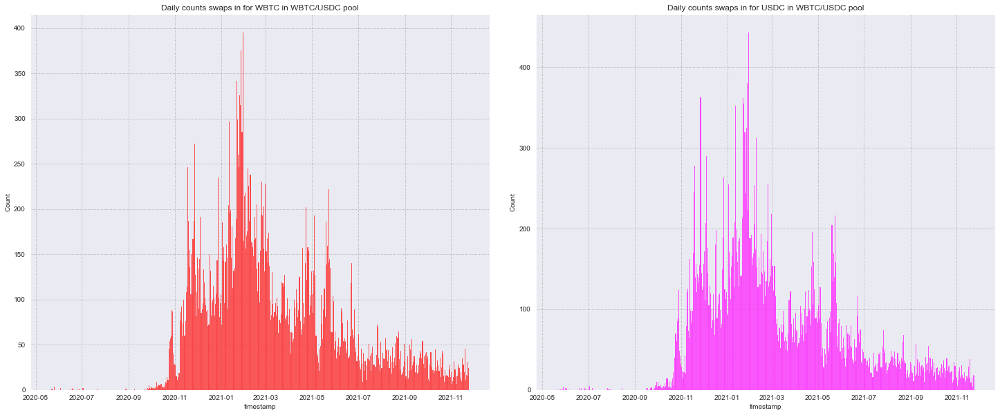

In [14]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=wbtc_usdc_df[wbtc_usdc_df.token_in == 'WBTC'], x='timestamp', 
             bins=(wbtc_usdc_df.timestamp[len(wbtc_usdc_df) - 1] - wbtc_usdc_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for WBTC in WBTC/USDC pool")
plt.subplot(1, 2, 2)
sns.histplot(data=wbtc_usdc_df[wbtc_usdc_df.token_in == 'USDC'], x='timestamp', 
             bins=(wbtc_usdc_df.timestamp[len(wbtc_usdc_df) - 1] - wbtc_usdc_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for USDC in WBTC/USDC pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

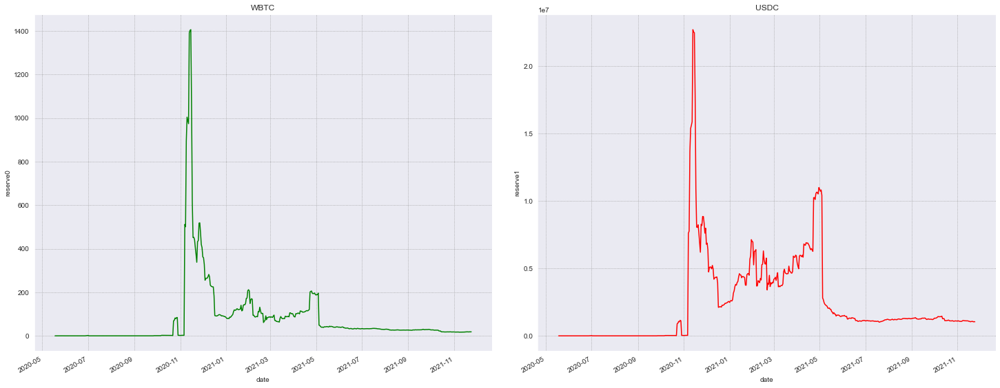

In [15]:
show_reserves_time_distribution(wbtc_usdc_reserves_df, first_token_reserve_name="WBTC", 
                                           second_token_reserve_name="USDC", x=25, y=10, wspace=0.1)

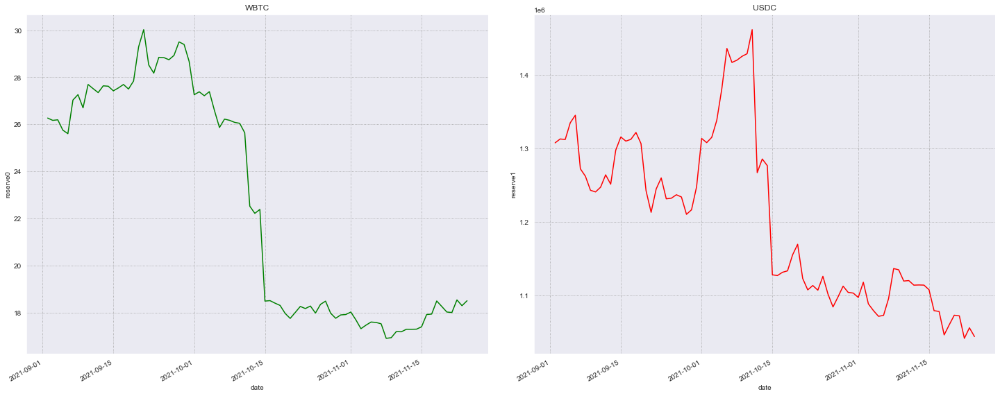

In [16]:
show_reserves_time_distribution(wbtc_usdc_reserves_df[wbtc_usdc_reserves_df.date > datetime(2021, 9, 1)], 
                                first_token_reserve_name="WBTC", second_token_reserve_name="USDC", 
                                x=25, y=10, wspace=0.1)

### Plotting price distribution in pool

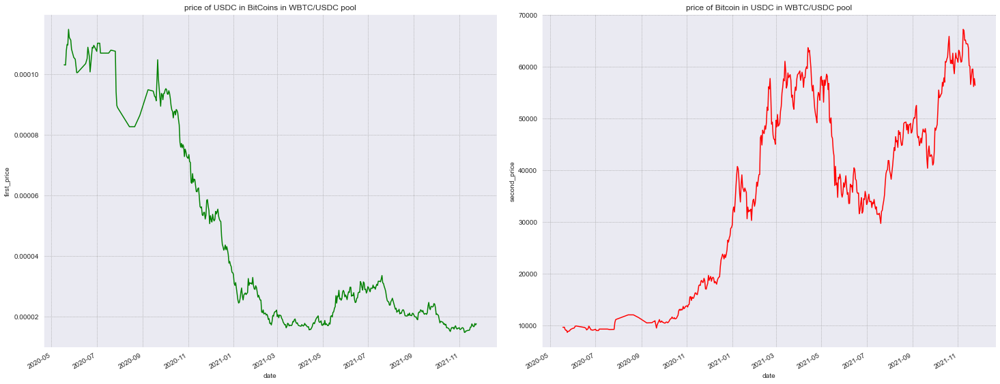

In [17]:
show_reserve_price_distributions(wbtc_usdc_reserves_df, first_token_price_name="price of USDC in BitCoins in WBTC/USDC pool", 
                                        second_token_price_name="price of Bitcoin in USDC in WBTC/USDC pool", x=25, y=10, wspace=0.1)

### Plot price increase rates distribution and their mean distribution

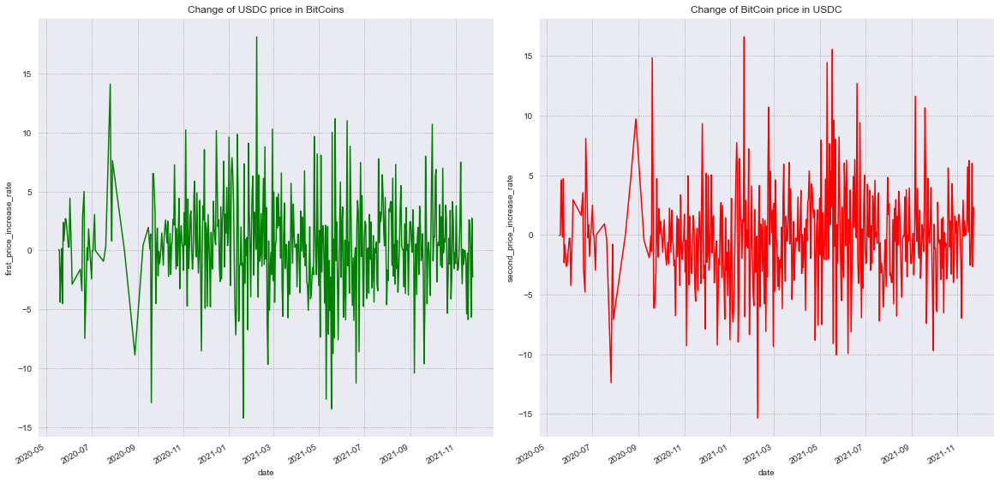

In [18]:
calc_price_and_increase_rates(wbtc_usdc_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=wbtc_usdc_reserves_df, x='date', y='first_price_increase_rate', color='green'
             ).set_title('Change of USDC price in BitCoins')
plt.subplot(1, 2, 2)
sns.lineplot(data=wbtc_usdc_reserves_df, x='date', y='second_price_increase_rate', color='red'
             ).set_title('Change of BitCoin price in USDC')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


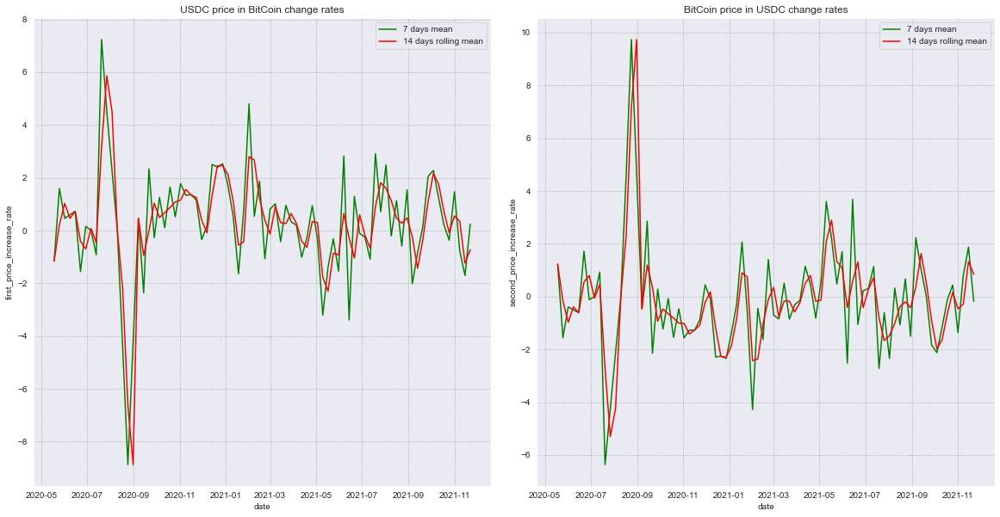

In [19]:
increase_rate_moving_averages(wbtc_usdc_reserves_df, 'USDC price in BitCoin change rates', 'BitCoin price in USDC change rates', x_size=20, y_size=10)

## ETH/USDC

In [20]:
weth_usdc_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\weth_usdc_swaps.pkl')
weth_usdc_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\weth_usdc_mints.pkl")
weth_usdc_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\weth_usdc_burns.pkl")
weth_usdc_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\weth_usdc_reserves.pkl")

In [21]:
weth_usdc_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
0,WETH,USDC,0.000005,0.001000,0.000501,2020-05-05 21:09:32,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x8688a84fcfd84d8f78020d0fc0b35987cc58911f,0x932cb88306450d481a0e43365a3ed832625b68f036e9...
1,WETH,USDC,0.000049,0.010000,0.004965,2020-05-05 21:12:35,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x11e4857bb9993a50c685a79afad4e6f65d518dda,0x697b7aaca56a80a8d3a2f560ed7f1ecb97c22b2edd6e...
2,WETH,USDC,0.000005,0.001000,0.000501,2020-05-06 16:24:55,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x8688a84fcfd84d8f78020d0fc0b35987cc58911f,0x43b6bfd06dde0814fe9c1b63ce98ec4c67c72d96169d...
3,USDC,WETH,0.000689,0.000003,0.000344,2020-05-06 18:51:12,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x12ede161c702d1494612d19f05992f43aa6a26fb,0x735cf98e86a5df67b6a837ae50de1d7a589d9f6baaf0...
4,WETH,USDC,0.001000,0.204870,0.099533,2020-05-11 13:08:48,0x57ead0a9f49fafdd2447f615b036f3c316af5171,0x57ead0a9f49fafdd2447f615b036f3c316af5171,0x840bb5ab0a779b4f733443651ac54dabe24e243c3606...
...,...,...,...,...,...,...,...,...,...
2895921,WETH,USDC,11.552050,49657.885159,49743.971758,2021-11-02 02:57:02,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x6c99a64f95bf6457463bfc9d77758ea63c635827,0x1c5a9c558a8d3959c4cebf3cd52df35a03a41b8f19b4...
2895922,USDC,WETH,1000.000000,0.231346,998.958692,2021-11-02 02:57:31,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xdf60e6416fcf8c955fddf01148753a911f7a5905,0x0262ea4a7b11af147b694e692fd5dbfb812b445b4e71...
2895923,USDC,WETH,3000.000000,0.694011,2998.413803,2021-11-02 02:58:25,0x11111112542d85b3ef69ae05771c2dccff4faa26,0xf82d8ec196fb0d56c6b82a8b1870f09502a49f88,0x8316bfabdab5fb94ed1960bbfe4cd40eaafc78c94c9e...
2895924,WETH,USDC,1.486875,6388.596124,6404.843537,2021-11-02 02:58:34,0xdef171fe48cf0115b1d80b88dc8eab59176fee57,0xf6dcdce0ac3001b2f67f750bc64ea5beb37b5824,0x16908278f6eb318d808662f2540ece2977e075461ba8...


## Plotting swapping in moving averages

In [22]:
weth_usdc_df = get_df_with_swap_prices_and_change_rates(weth_usdc_df, first_token='WETH', second_token='USDC')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


First version of plotting the data, using ```seaborn``` module

In [23]:
weth_usdc_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
0,WETH,USDC,0.000005,0.001000,0.000501,2020-05-05 21:09:32,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x8688a84fcfd84d8f78020d0fc0b35987cc58911f,0x932cb88306450d481a0e43365a3ed832625b68f036e9...,205.176618,NaN
1,WETH,USDC,0.000049,0.010000,0.004965,2020-05-05 21:12:35,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x11e4857bb9993a50c685a79afad4e6f65d518dda,0x697b7aaca56a80a8d3a2f560ed7f1ecb97c22b2edd6e...,202.919065,-1.100298
2,WETH,USDC,0.000005,0.001000,0.000501,2020-05-06 16:24:55,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x8688a84fcfd84d8f78020d0fc0b35987cc58911f,0x43b6bfd06dde0814fe9c1b63ce98ec4c67c72d96169d...,200.678676,-1.104080
3,USDC,WETH,0.000689,0.000003,0.000344,2020-05-06 18:51:12,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x12ede161c702d1494612d19f05992f43aa6a26fb,0x735cf98e86a5df67b6a837ae50de1d7a589d9f6baaf0...,0.004953,NaN
4,WETH,USDC,0.001000,0.204870,0.099533,2020-05-11 13:08:48,0x57ead0a9f49fafdd2447f615b036f3c316af5171,0x57ead0a9f49fafdd2447f615b036f3c316af5171,0x840bb5ab0a779b4f733443651ac54dabe24e243c3606...,204.870000,2.088575
...,...,...,...,...,...,...,...,...,...,...,...
2895921,WETH,USDC,11.552050,49657.885159,49743.971758,2021-11-02 02:57:02,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x6c99a64f95bf6457463bfc9d77758ea63c635827,0x1c5a9c558a8d3959c4cebf3cd52df35a03a41b8f19b4...,4298.620987,-0.041111
2895922,USDC,WETH,1000.000000,0.231346,998.958692,2021-11-02 02:57:31,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xdf60e6416fcf8c955fddf01148753a911f7a5905,0x0262ea4a7b11af147b694e692fd5dbfb812b445b4e71...,0.000231,0.089430
2895923,USDC,WETH,3000.000000,0.694011,2998.413803,2021-11-02 02:58:25,0x11111112542d85b3ef69ae05771c2dccff4faa26,0xf82d8ec196fb0d56c6b82a8b1870f09502a49f88,0x8316bfabdab5fb94ed1960bbfe4cd40eaafc78c94c9e...,0.000231,-0.003779
2895924,WETH,USDC,1.486875,6388.596124,6404.843537,2021-11-02 02:58:34,0xdef171fe48cf0115b1d80b88dc8eab59176fee57,0xf6dcdce0ac3001b2f67f750bc64ea5beb37b5824,0x16908278f6eb318d808662f2540ece2977e075461ba8...,4296.659856,-0.045622


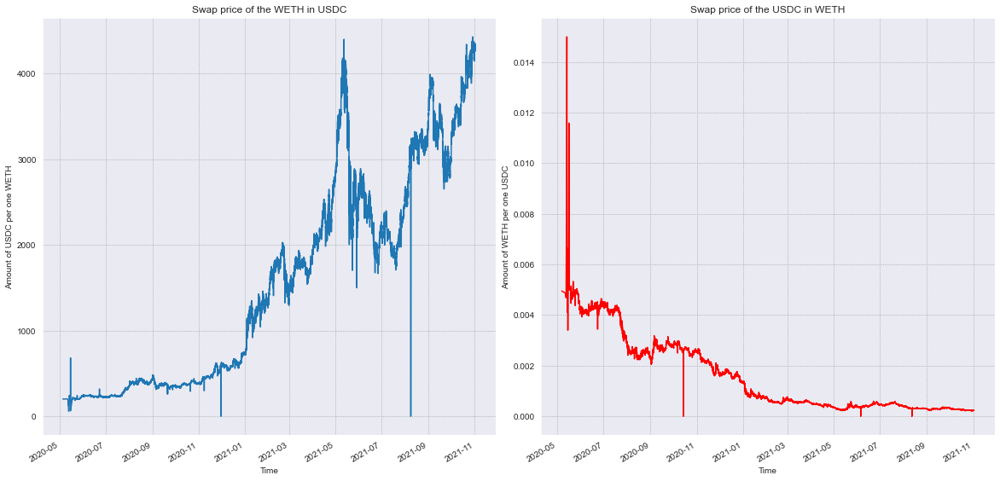

In [24]:
pyplot_line_swap_prices(df=weth_usdc_df, first_token='WETH', second_token='USDC', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

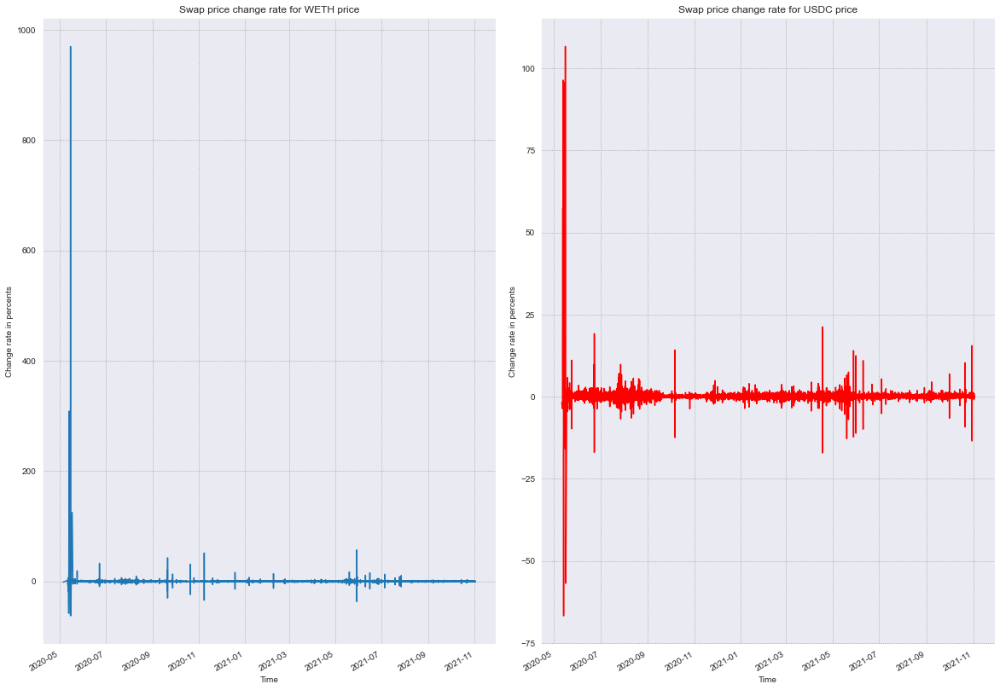

In [25]:
pyplot_line_swap_change_rate(df=weth_usdc_df[(weth_usdc_df.price_change_rate < 1000) & 
                                             (weth_usdc_df.price_change_rate > -90)], 
                             first_token='WETH', second_token='USDC', xsize=20, ysize=15, wspace=0.1, hspace=0.1)

In [26]:
# weth_usdc_df[(weth_usdc_df.price_change_rate <= -100) | (weth_usdc_df.price_change_rate > 100)]
weth_usdc_df[(weth_usdc_df.timestamp > datetime(2021, 8, 12, 3, 16)) & 
             (weth_usdc_df.timestamp < datetime(2021, 8, 12, 3, 39))].head(10)

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
2614077,WETH,USDC,4.611514,14869.611444,14878.586986,2021-08-12 03:16:08,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0x597da53a39ea634be355e6028136b5e5f28c25d9,0x0dc256b7a472f09b51f24820c2528f25858a304b07cc...,3224.453173,-0.008276
2614078,USDC,WETH,1989.672914,0.613412,1984.972399,2021-08-12 03:16:16,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x40f0e70a7d565985b967bcdb0ba5801994fc2e80,0x9b6ef383cec49e88f0c44cdfbd425d86fcfbc441663a...,0.000308,0.015614
2614079,WETH,USDC,0.033000,106.399318,106.473219,2021-08-12 03:16:38,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x5b155ea384905485fde4b24ef1cd63a7d2398100,0x9a956790e4ab8bfa2e9b3328fee7045575676ee98588...,3224.221758,-0.007177
2614080,WETH,USDC,0.200000,644.857938,645.292366,2021-08-12 03:17:45,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x5b155ea384905485fde4b24ef1cd63a7d2398100,0x1c7a1358594861e8ef51e6d23a0f07ae2537e30ac9ab...,3224.289690,0.002107
2614081,USDC,WETH,2000.000000,0.616581,1995.368519,2021-08-12 03:17:45,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x60031819a16266d896268cfea5d5be0b6c2b5d75,0xa9ade28c4d6eff05d172b56ae49bba9375f90e5d3f27...,0.000308,-0.002450
2614082,USDC,WETH,54.906921,0.016927,54.779183,2021-08-12 03:17:45,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe026bf6c24f1f96d9d5551945310e65de8254384,0xe54b9b94873c092b46caa9690f8595908879ce7ebe88...,0.000308,-0.000496
2614083,USDC,WETH,10000.000000,3.082689,9976.372517,2021-08-12 03:17:46,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0f5a2eb364d8b722cba4e1e30e2cf57b6f515b2a,0xe728a00f4fa7d69ad42d9e9b3c92f1d2365bb0cf60de...,0.000308,-0.006512
2614084,WETH,USDC,0.306000,986.032813,987.085857,2021-08-12 03:18:56,0x429302c74a0350410fc8b43e4839d459dec4d050,0xbbc95e1eb6ee476e9cbb8112435e14b372563038,0x05533b4269492eda721a6d5b1f8d905354b3e46f40fb...,3222.329454,-0.060796
2614085,WETH,USDC,17.352819,55937.245863,55986.439846,2021-08-12 03:18:56,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0f4ee9631f4be0a63756515141281a3e2b293bbe,0x565a45e28f18b82b451fdf0c718da97bd5c7c75afa6b...,3223.524979,0.037101
2614086,WETH,USDC,0.215488,694.366414,695.083233,2021-08-12 03:19:19,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbbc95e1eb6ee476e9cbb8112435e14b372563038,0x291538a3db2031cecf428da0bd6537a2a78bf7159111...,3222.294204,-0.038181


In [27]:
weth_usdc_df[weth_usdc_df.price_change_rate > 100000000]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
793358,WETH,USDC,1.073000,648.278639,647.213288,2020-11-30 20:44:03,0x00000000e1fa75ba0fcb4a319d2928a3fe3638e4,0x00000000e1fa75ba0fcb4a319d2928a3fe3638e4,0x192a2d2e1d28a8e3c7cb57a2125f4e31b655c0e86906...,604.173941,2.999970e+08
2600300,WETH,USDC,0.300000,915.134082,916.028055,2021-08-08 22:18:46,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x5b155ea384905485fde4b24ef1cd63a7d2398100,0xd7041dec531819955c5f40a0b421d1f2ad8f02556b77...,3050.446940,3.047395e+08
2614095,USDC,WETH,3760.048831,1.161932,3756.076713,2021-08-12 03:21:30,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x984a3eab3cf2fc2b4ca6e4a3768624a8272fe2a3,0x8a2a36a02aa564a51009a8c2492458f25c05c394fcaa...,0.000309,1.626423e+09


In [28]:
weth_usdc_df[(weth_usdc_df.index > 793340) & (weth_usdc_df.index < 793370)][['token_in', 'token_out', 'amount_in', 'amount_out', 'timestamp', 'first_to_second_price', 'price_change_rate']]

,token_in,token_out,amount_in,amount_out,timestamp,first_to_second_price,price_change_rate
793341,USDC,WETH,1434.545613,2.361018,2020-11-30 20:41:28,0.001646,-5.936251e-02
793342,WETH,USDC,0.524083,316.518651,2020-11-30 20:41:28,603.947088,-1.332408e-03
793343,USDC,WETH,98.973668,0.162890,2020-11-30 20:41:39,0.001646,-2.051341e-03
793344,USDC,WETH,745.036430,1.226164,2020-11-30 20:41:39,0.001646,-1.126223e-03
793345,USDC,WETH,1990.286602,3.275450,2020-11-30 20:41:45,0.001646,-3.651543e-03
793346,USDC,WETH,2000.000000,3.291260,2020-11-30 20:41:50,0.001646,-5.330350e-03
793347,WETH,USDC,0.300000,181.213266,2020-11-30 20:41:50,604.044220,1.608288e-02
793348,WETH,USDC,0.082776,50.000000,2020-11-30 20:42:10,604.042349,-3.097189e-04
793349,USDC,WETH,146.359779,0.240849,2020-11-30 20:42:13,0.001646,-2.251330e-03
793350,USDC,WETH,676.191186,1.112723,2020-11-30 20:42:17,0.001646,-1.097721e-03


In [29]:
0.000000/0.002646 * 100

0.0

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


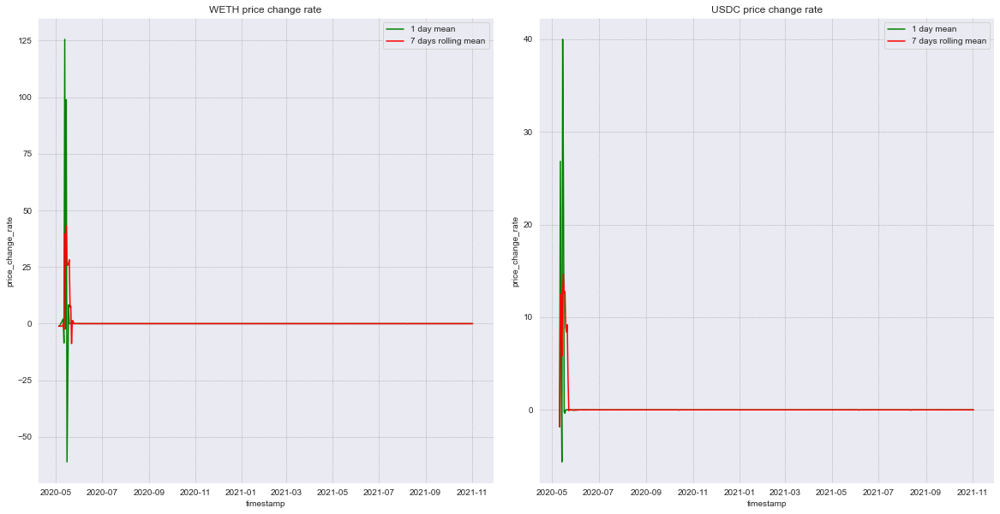

In [30]:
swaps_price_change_rates_moving_averages(weth_usdc_df[weth_usdc_df.price_change_rate < 1000], first_token='WETH', second_token='USDC', 
                                           first_plot_name='WETH price change rate', second_plot_name='USDC price change rate', 
                                           x_size=20, y_size=10)

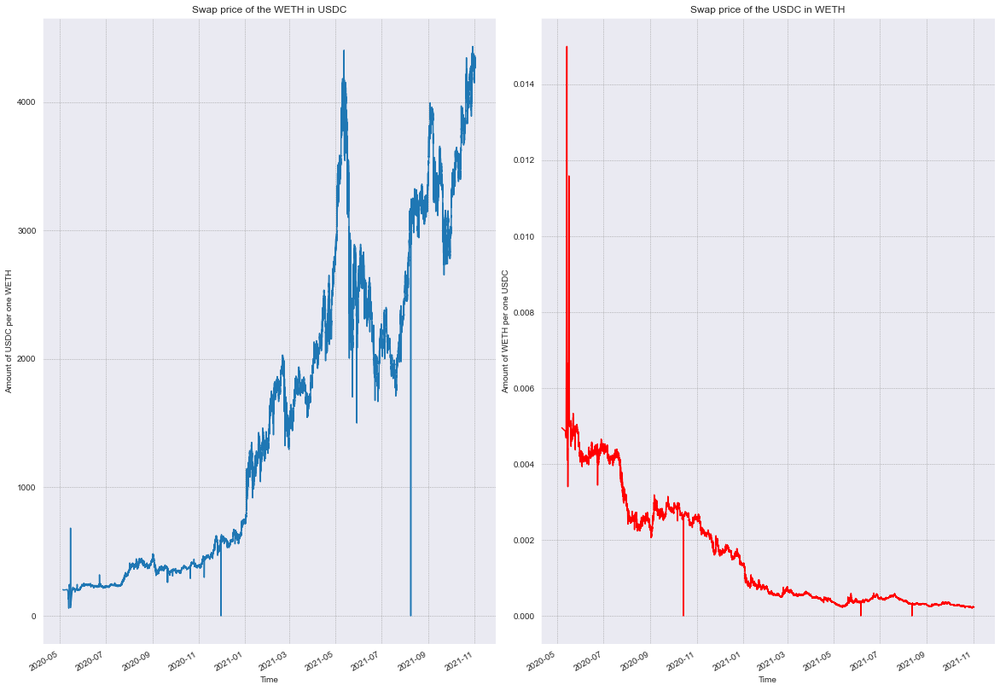

In [31]:
pyplot_line_swap_prices(df=weth_usdc_df[weth_usdc_df.first_to_second_price != 0], first_token='WETH', 
                        second_token='USDC', xsize=20, ysize=15, wspace=0.1, hspace=0.1)

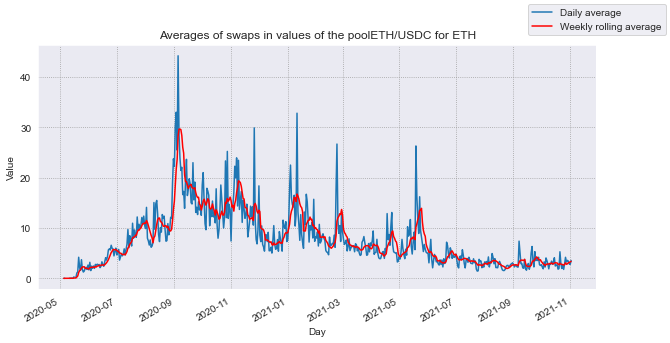

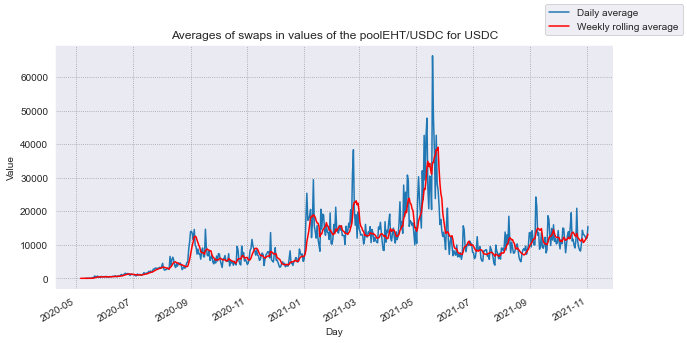

In [32]:
show_swaps_amount_in_moving_averages(swaps_df=weth_usdc_df[(weth_usdc_df.token_in == 'WETH')], 
                                     pool_name="ETH/USDC for ETH")
show_swaps_amount_in_moving_averages(swaps_df=weth_usdc_df[(weth_usdc_df.token_in == 'USDC')], 
                                     pool_name="EHT/USDC for USDC")

### Swaps value histograms

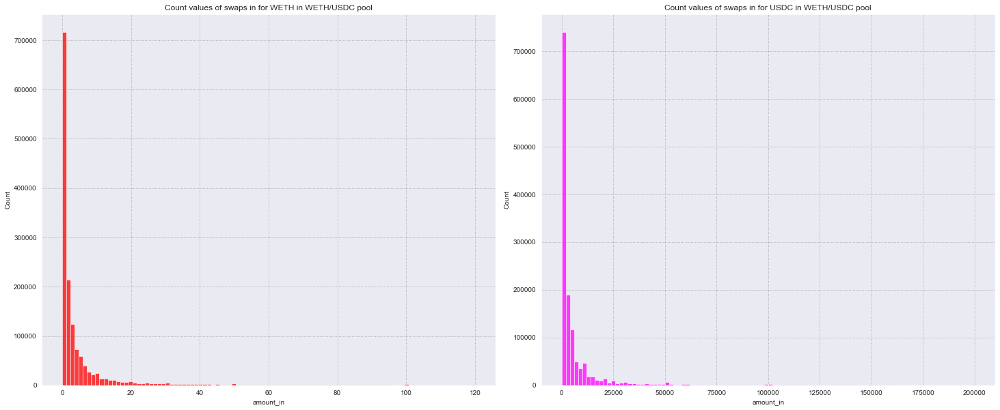

In [33]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=weth_usdc_df[weth_usdc_df.token_in == 'WETH'], x='amount_in', 
             bins=100, color='red', binrange=[0, 120]).set_title("Count values of swaps in for WETH in WETH/USDC pool")
plt.subplot(1, 2, 2)
sns.histplot(data=weth_usdc_df[weth_usdc_df.token_in == 'USDC'], x='amount_in', 
             bins=100, color='magenta', binrange=[0, 200000]).set_title("Count values of swaps in for USDC in WETH/USDC pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

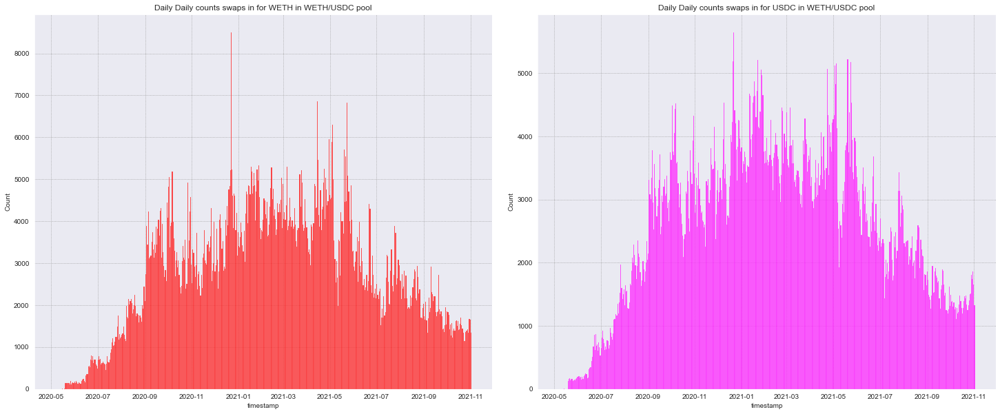

In [34]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=weth_usdc_df[weth_usdc_df.token_in == 'WETH'], x='timestamp', 
             bins=(weth_usdc_df.timestamp[len(weth_usdc_df) - 1] - weth_usdc_df.timestamp[0]).days, 
             color='red').set_title("Daily Daily counts swaps in for WETH in WETH/USDC pool")
plt.subplot(1, 2, 2)
sns.histplot(data=weth_usdc_df[weth_usdc_df.token_in == 'USDC'], x='timestamp', 
             bins=(weth_usdc_df.timestamp[len(weth_usdc_df) - 1] - weth_usdc_df.timestamp[0]).days, 
             color='magenta').set_title("Daily Daily counts swaps in for USDC in WETH/USDC pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

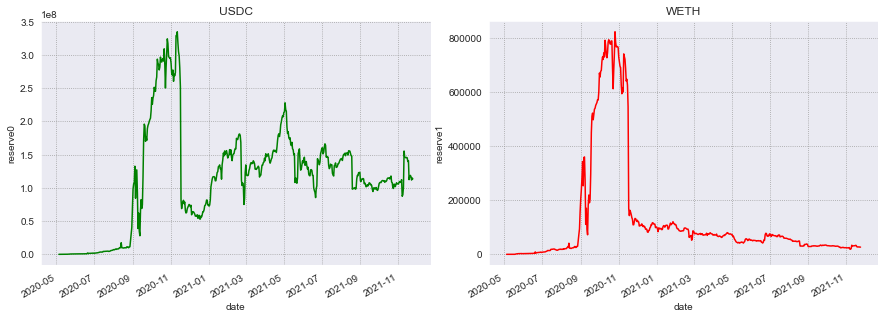

In [35]:
show_reserves_time_distribution(weth_usdc_reserves_df, first_token_reserve_name="USDC", 
                                second_token_reserve_name="WETH", x=15, wspace=0.15)

### Plottting price distribution for pool

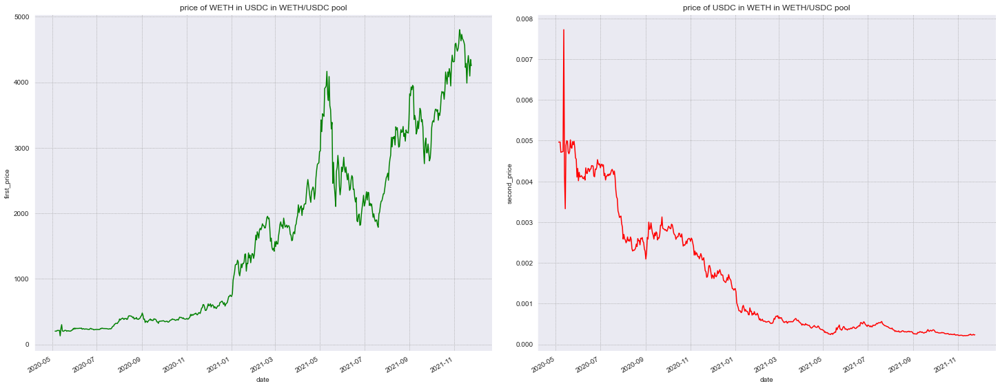

In [36]:
show_reserve_price_distributions(weth_usdc_reserves_df, 
                                first_token_price_name="price of WETH in USDC in WETH/USDC pool", 
                                second_token_price_name="price of USDC in WETH in WETH/USDC pool", 
                                x=25, y=10, wspace=0.1)

### Plotting price change rates and their mean distributions

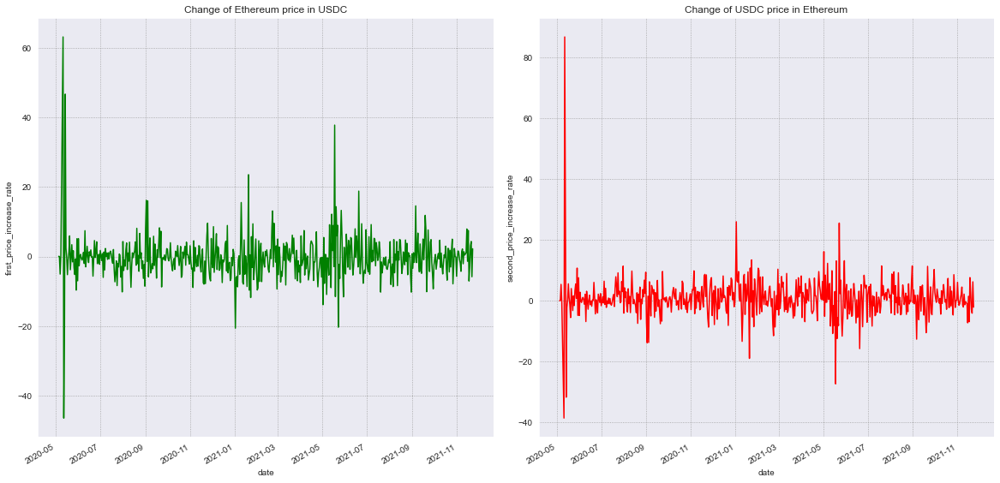

In [37]:
calc_price_and_increase_rates(weth_usdc_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=weth_usdc_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in USDC')
plt.subplot(1, 2, 2)
sns.lineplot(data=weth_usdc_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of USDC price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


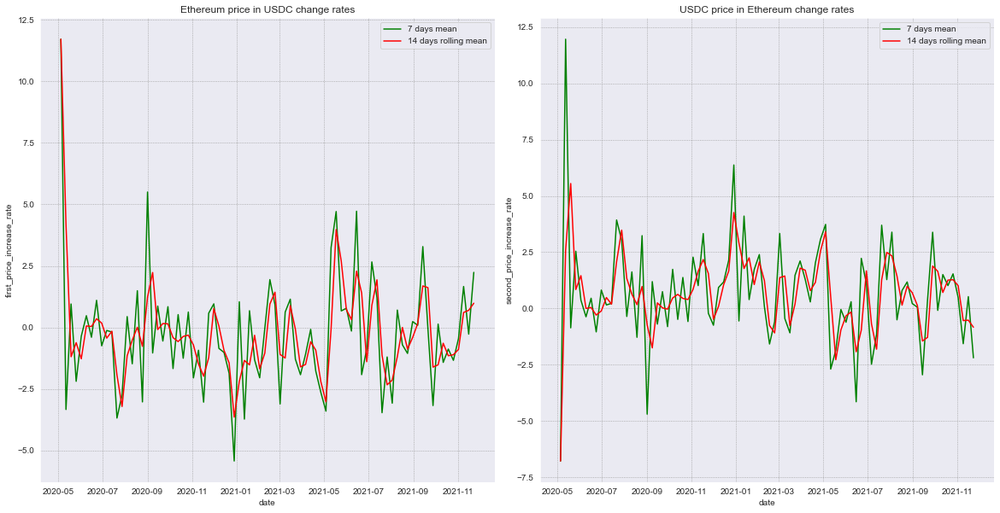

In [38]:
increase_rate_moving_averages(weth_usdc_reserves_df, 'Ethereum price in USDC change rates', 
                              'USDC price in Ethereum change rates', x_size=20, y_size=10)

## WBTC/DAI (fixed pickle)

In [39]:
wbtc_dai_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\wbtc_dai_swaps.pkl')
wbtc_dai_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\wbtc_dai_mints.pkl")
wbtc_dai_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\wbtc_dai_burns.pkl")
wbtc_dai_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\wbtc_dai_reserves.pkl")

In [40]:
wbtc_dai_df.loc[4200:4240]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
4200,DAI,WBTC,0.403913,0.000012,0.405726,2021-02-01 20:52:15,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xaa873c9da6541f13c89416c17271b4c21bf7b2d7,0x023ff97e56bf6460f87dcd378422490f8a69c7da63a2...
4201,DAI,WBTC,17.383211,0.000515,17.430428,2021-02-01 21:18:48,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbb2b8038a1640196fbe3e38816f3e67cba72d940,0xcce312fe05d8fcb92edf7f9e84ca5c220bdb5b094492...
4202,DAI,WBTC,51.968815,0.001514,51.982058,2021-02-02 08:53:35,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbb2b8038a1640196fbe3e38816f3e67cba72d940,0x866c8a8287ad80da0d321dcd0022b02fc531fab5d88d...
4203,DAI,WBTC,5.611220,0.000161,5.647344,2021-02-02 09:33:11,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xaa873c9da6541f13c89416c17271b4c21bf7b2d7,0x61e34c969f936cb152f6f1f8808e9ceec6bf014f55a7...
4204,DAI,WBTC,2.144614,0.000061,2.141867,2021-02-02 13:35:44,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xba30a255a23fc6e864f1195eaccedf1eeac9a64c,0xf5da0e7eb3e715f56eefd1b56b4a1cb2c0b6da6f8664...
4205,DAI,WBTC,37.835308,0.001073,37.895029,2021-02-02 16:48:38,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe86204c4eddd2f70ee00ead6805f917671f56c52,0xc990ba997ff15b9ffef2f3a2c379b95ee9a296507ee7...
4206,WBTC,DAI,0.000215,7.598125,7.537107,2021-02-02 17:50:56,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x14da60f116a1634f039138e9ca3d79492c780147,0x491c43c8f39fd6c4472ff3d25bda641bc096b70603d2...
4207,WBTC,DAI,0.000042,1.488874,1.480510,2021-02-02 18:24:36,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xf00e80f0de9aea0b33aa229a4014572777e422ee,0x05b8c75b0963fa98e73cb020fdb6bbd5fd35c813d80c...
4208,DAI,WBTC,23.169225,0.000650,23.153448,2021-02-02 21:20:12,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x372358d176df696019996c50afd966ebad8d6804,0xd7e5a8d9f3c2378683f6352f5d464cc12e011d4233ec...
4209,DAI,WBTC,12.259807,0.000341,12.287588,2021-02-03 03:14:03,0xd291328a6c202c5b18dcb24f279f69de1e065f70,0xd291328a6c202c5b18dcb24f279f69de1e065f70,0xcee9bb3776049d267428086cad80c2d01f1f3d7c1d3c...


### Plotting swapping in moving averages

In [41]:
wbtc_dai_df = get_df_with_swap_prices_and_change_rates(df=wbtc_dai_df, first_token='WBTC', second_token='DAI')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


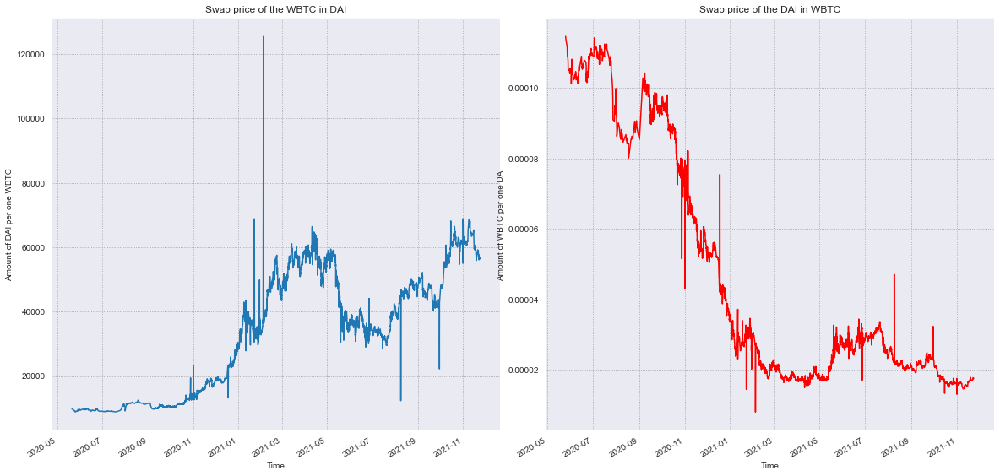

In [42]:
pyplot_line_swap_prices(wbtc_dai_df, first_token='WBTC', second_token='DAI', xsize=20, ysize=10, 
                        wspace=0.1, hspace=0.1)

In [43]:
wbtc_dai_df[wbtc_dai_df.first_to_second_price > 100000]
wbtc_dai_df[(wbtc_dai_df.timestamp > datetime(2021, 2, 3, 15, 0)) & 
            (wbtc_dai_df.timestamp < datetime(2021, 2, 4, 2, 30))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
4216,DAI,WBTC,15.976918,0.000435,16.021554,2021-02-03 16:51:46,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xaa873c9da6541f13c89416c17271b4c21bf7b2d7,0x115ccb0ea5f27783101ed5b9e18f7534eae05c0b35aa...,0.000027,0.636052
4217,DAI,WBTC,16.363380,0.000442,16.377474,2021-02-03 18:13:00,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xd03e3e767fae065b41fccbfa0dfb3c538cf2b484,0x1119aaffe03473fa15c89a73dbafbea3c0b36cb42078...,0.000027,-0.764651
4218,DAI,WBTC,10000.000000,0.080101,6502.749813,2021-02-03 23:10:39,0xe069cb01d06ba617bcdf789bf2ff0d5e5ca20c71,0xe069cb01d06ba617bcdf789bf2ff0d5e5ca20c71,0x2bce76806ce9e5e303b2408823006cd3052213aa1af3...,0.000008,-70.372304
4219,WBTC,DAI,0.079270,9951.020610,6462.670591,2021-02-03 23:10:39,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0xebad7655e2185f5dc5941eac066a94c7abd241543a9a...,125533.897798,245.316126


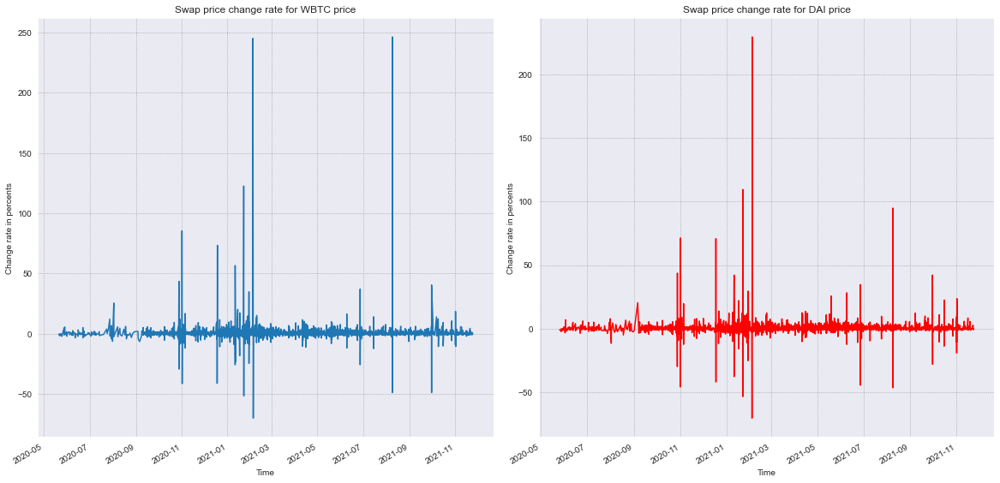

In [44]:
pyplot_line_swap_change_rate(wbtc_dai_df, first_token='WBTC', second_token='DAI', xsize=20, ysize=10, 
                             wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


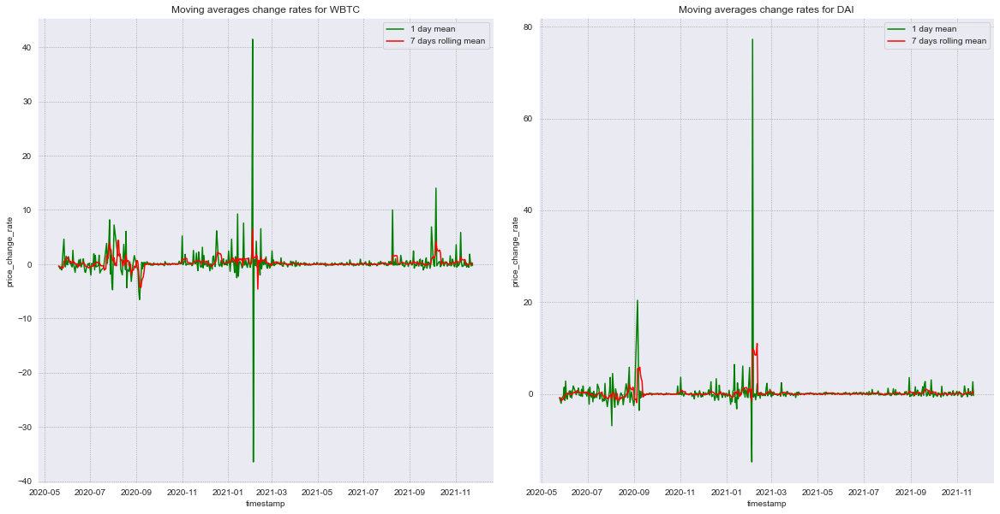

In [45]:
swaps_price_change_rates_moving_averages(df=wbtc_dai_df, first_token='WBTC', second_token='DAI', first_plot_name='Moving averages change rates for WBTC', second_plot_name='Moving averages change rates for DAI',
                                           x_size=20, y_size=10, wspace=0.1, hspace=0.1)

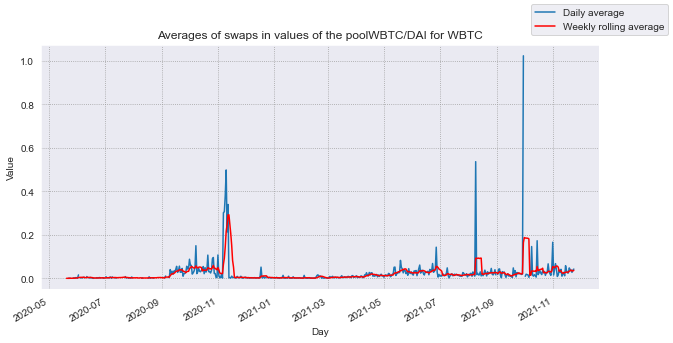

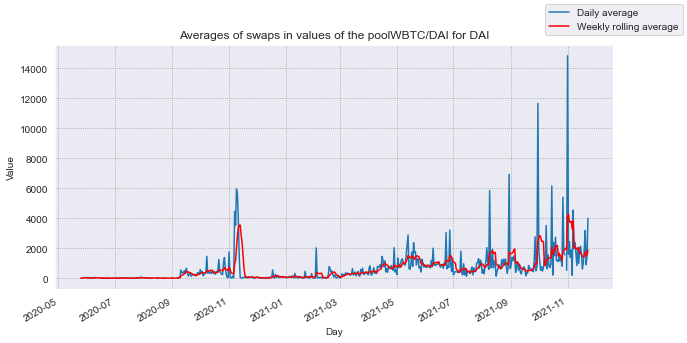

In [46]:
show_swaps_amount_in_moving_averages(swaps_df=wbtc_dai_df[(wbtc_dai_df.token_in == 'WBTC')], 
                                     pool_name="WBTC/DAI for WBTC")
show_swaps_amount_in_moving_averages(swaps_df=wbtc_dai_df[(wbtc_dai_df.token_in == 'DAI')], 
                                     pool_name="WBTC/DAI for DAI")

### Swaps values histograms

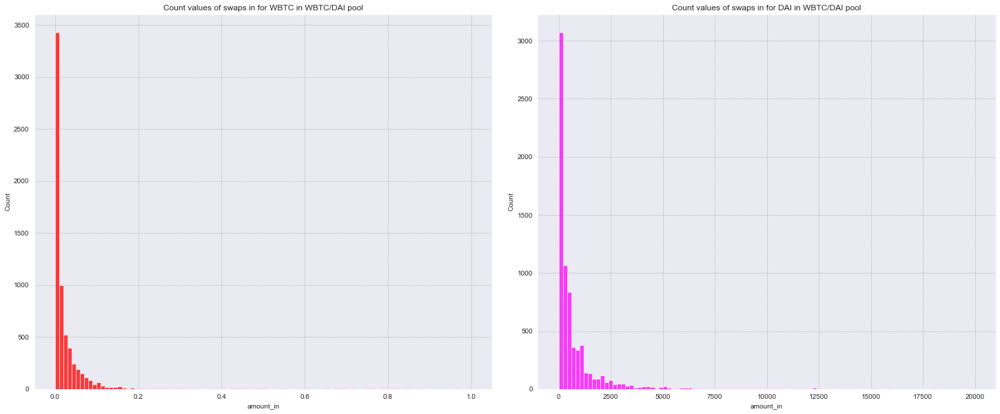

In [47]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=wbtc_dai_df[wbtc_dai_df.token_in == 'WBTC'], x='amount_in', bins=100, 
             color='red', binrange=[0, 1]).set_title("Count values of swaps in for WBTC in WBTC/DAI pool")
plt.subplot(1, 2, 2)
sns.histplot(data=wbtc_dai_df[wbtc_dai_df.token_in == 'DAI'], x='amount_in', bins=100, 
             color='magenta', binrange=[0, 20000]).set_title("Count values of swaps in for DAI in WBTC/DAI pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

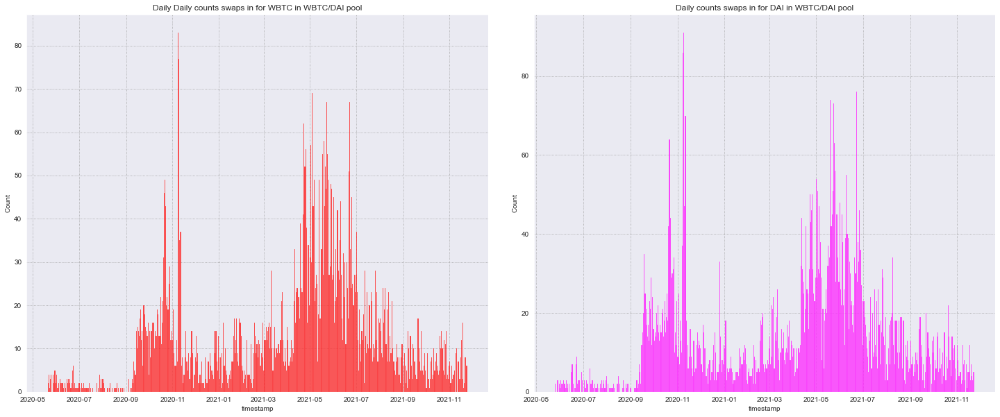

In [48]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=wbtc_dai_df[wbtc_dai_df.token_in == 'WBTC'], x='timestamp', 
             bins=(wbtc_dai_df.timestamp[len(wbtc_dai_df) - 1] - wbtc_dai_df.timestamp[0]).days, 
             color='red').set_title("Daily Daily counts swaps in for WBTC in WBTC/DAI pool")
plt.subplot(1, 2, 2)
sns.histplot(data=wbtc_dai_df[wbtc_dai_df.token_in == 'DAI'], x='timestamp', 
             bins=(wbtc_dai_df.timestamp[len(wbtc_dai_df) - 1] - wbtc_dai_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for DAI in WBTC/DAI pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

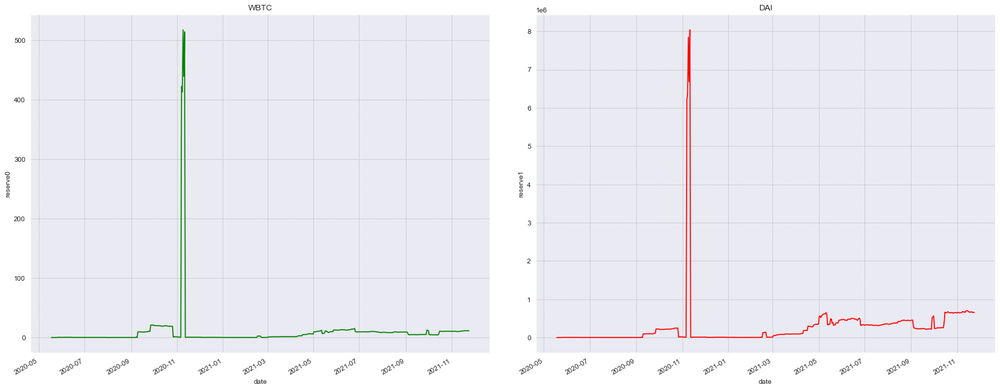

In [49]:
show_reserves_time_distribution(wbtc_dai_reserves_df, first_token_reserve_name="WBTC", 
                                second_token_reserve_name="DAI", x=25, y=10, wspace=0.1)

### Plotting price distribution in pool

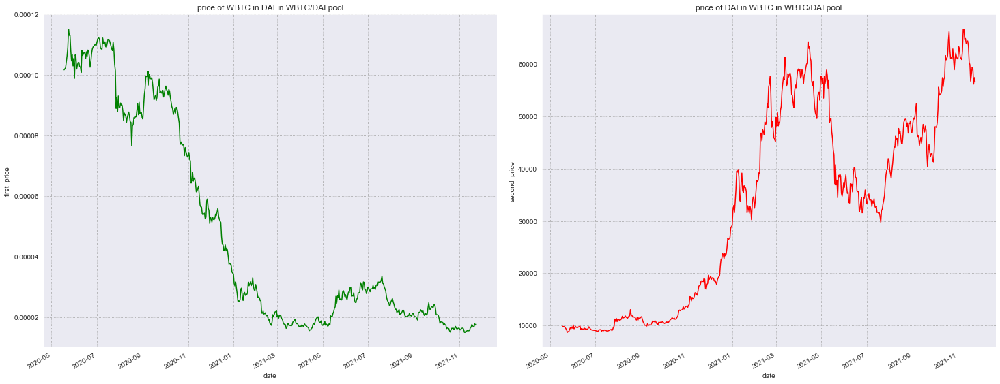

In [50]:
show_reserve_price_distributions(wbtc_dai_reserves_df, first_token_price_name="price of WBTC in DAI in WBTC/DAI pool", 
                                        second_token_price_name="price of DAI in WBTC in WBTC/DAI pool", 
                                        x=25, y=10, wspace=0.1)

### Plotting price changes rates and their mean distribution

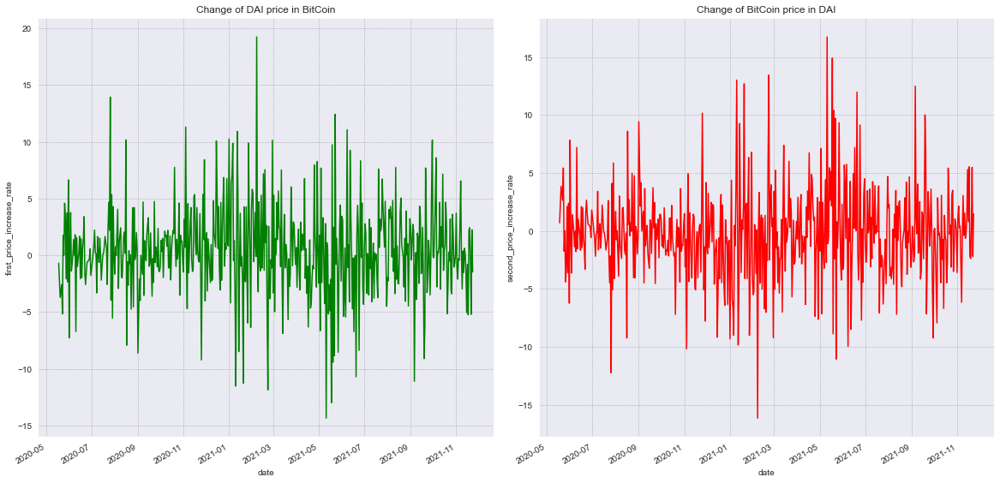

In [51]:
calc_price_and_increase_rates(wbtc_dai_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=wbtc_dai_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of DAI price in BitCoin')
plt.subplot(1, 2, 2)
sns.lineplot(data=wbtc_dai_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of BitCoin price in DAI')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


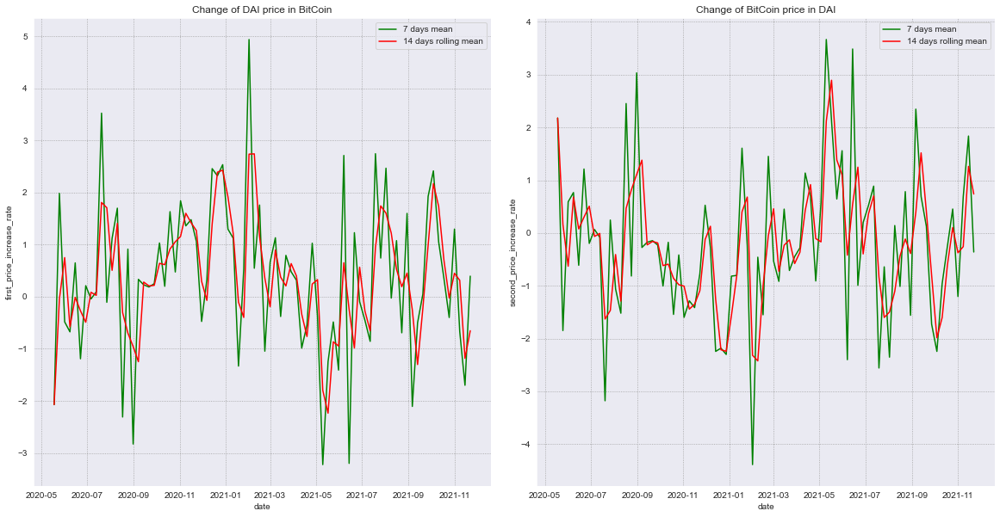

In [52]:
increase_rate_moving_averages(wbtc_dai_reserves_df, 'Change of DAI price in BitCoin', 
                              'Change of BitCoin price in DAI', x_size=20, y_size=10)

## IXS/ETH

In [53]:
ixs_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\ixs_weth_swaps.pkl')
ixs_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\ixs_weth_mints.pkl")
ixs_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\ixs_weth_burns.pkl")
ixs_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\ixs_weth_reserves.pkl")

### Plotting swapping in moving averages

In [54]:
ixs_weth_df = get_df_with_swap_prices_and_change_rates(df=ixs_weth_df, first_token='IXS', second_token='WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


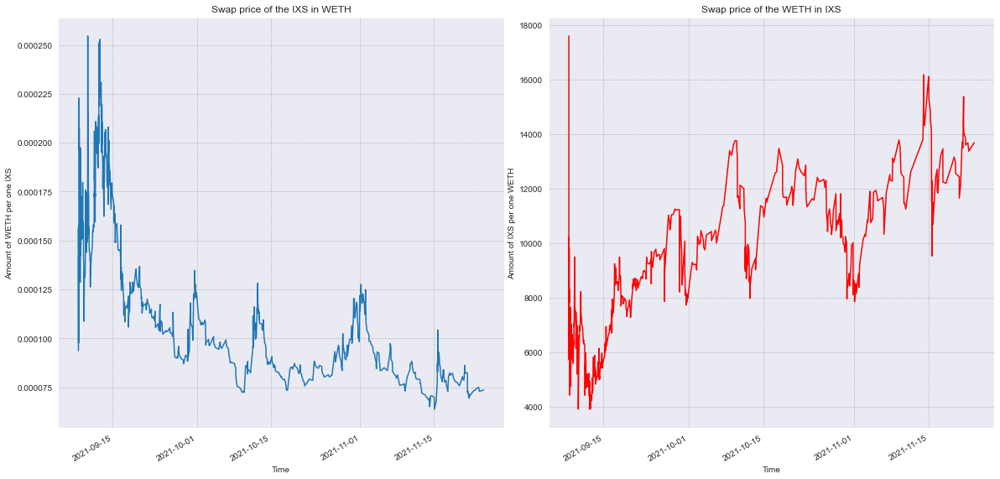

In [55]:
pyplot_line_swap_prices(df=ixs_weth_df, first_token='IXS', second_token='WETH', xsize=20, ysize=10, 
                        wspace=0.1, hspace=0.1)

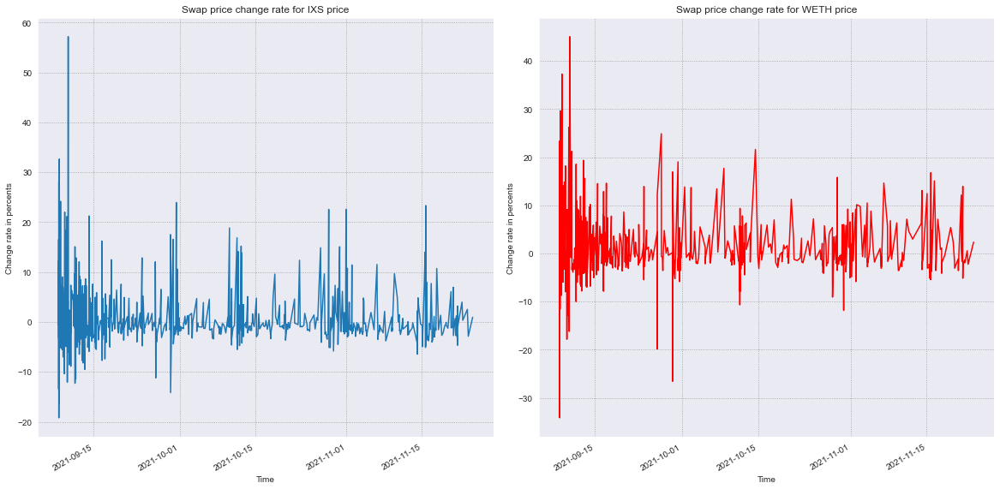

In [56]:
pyplot_line_swap_change_rate(df=ixs_weth_df, first_token='IXS', second_token='WETH', xsize=20, ysize=10, 
                             wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


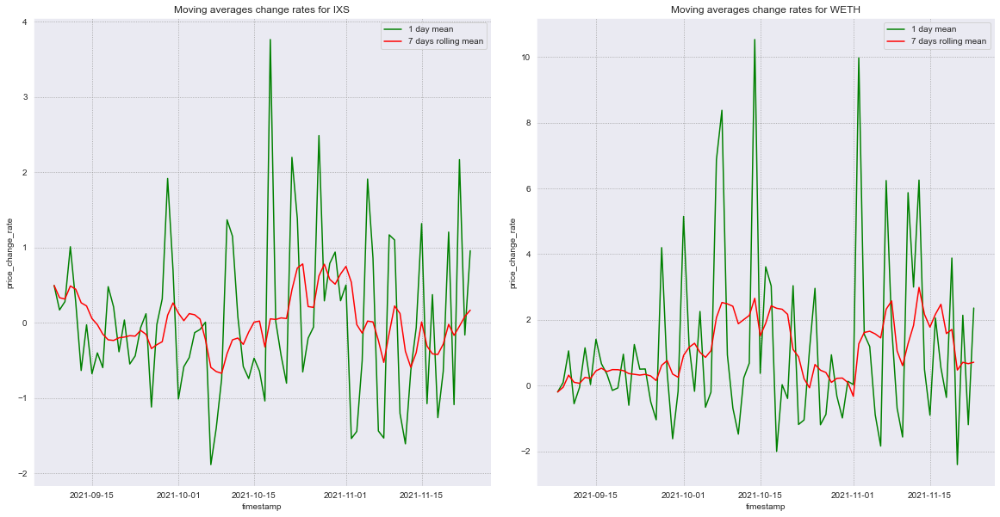

In [57]:
swaps_price_change_rates_moving_averages(ixs_weth_df, first_token='IXS', second_token='WETH', 
                                         first_plot_name='Moving averages change rates for IXS', 
                                         second_plot_name='Moving averages change rates for WETH', 
                                         x_size=20, y_size=10, wspace=0.1, hspace=0.1)

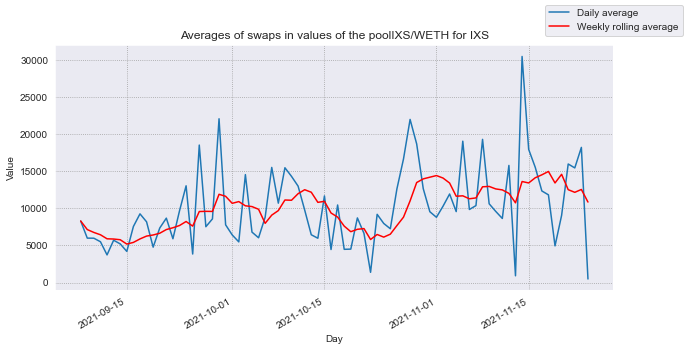

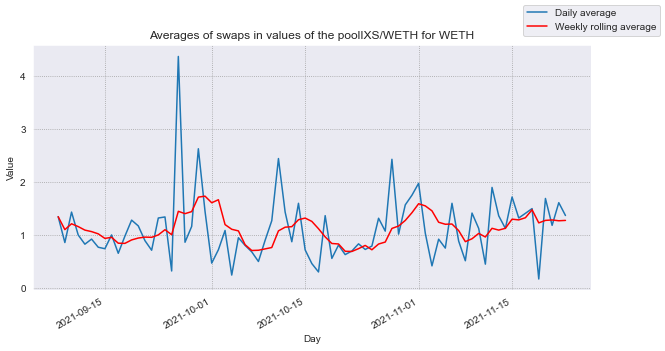

In [58]:
show_swaps_amount_in_moving_averages(swaps_df=ixs_weth_df[(ixs_weth_df.token_in == 'IXS')], 
                                     pool_name="IXS/WETH for IXS")
show_swaps_amount_in_moving_averages(swaps_df=ixs_weth_df[(ixs_weth_df.token_in == 'WETH')], 
                                     pool_name="IXS/WETH for WETH")

### Swaps values histograms

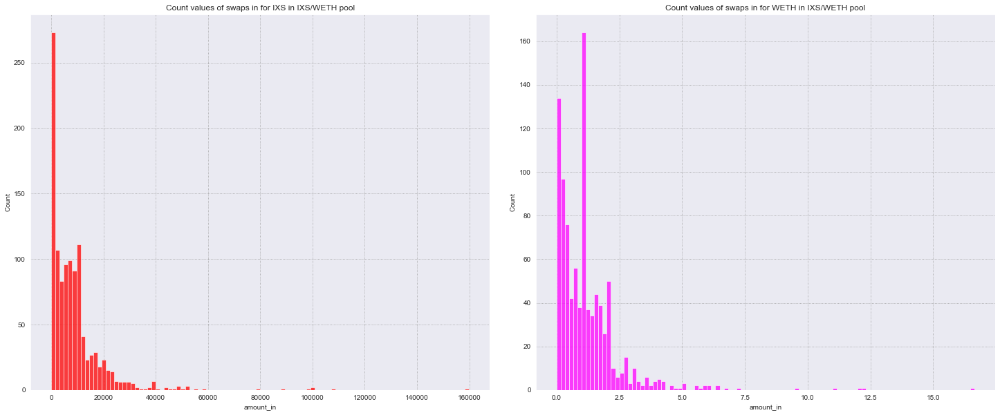

In [59]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=ixs_weth_df[ixs_weth_df.token_in == 'IXS'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for IXS in IXS/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=ixs_weth_df[ixs_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for WETH in IXS/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

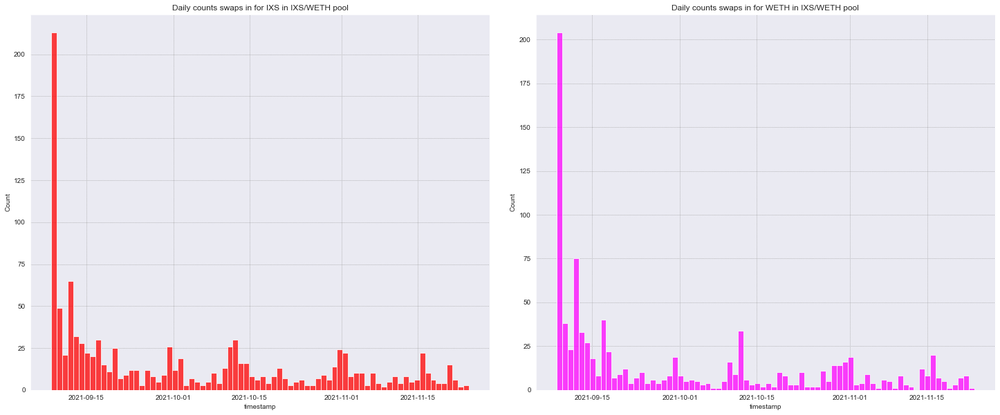

In [60]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=ixs_weth_df[ixs_weth_df.token_in == 'IXS'], x='timestamp', 
             bins=(ixs_weth_df.timestamp[len(ixs_weth_df) - 1] - ixs_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for IXS in IXS/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=ixs_weth_df[ixs_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(ixs_weth_df.timestamp[len(ixs_weth_df) - 1] - ixs_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in IXS/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Pool reserves distribution

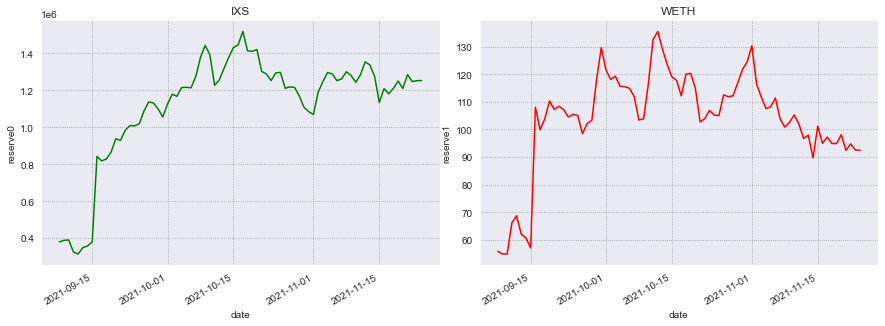

In [61]:
show_reserves_time_distribution(ixs_weth_reserves_df, first_token_reserve_name="IXS", 
                                second_token_reserve_name="WETH", x=15, wspace=0.1)

### Price distribution in pool

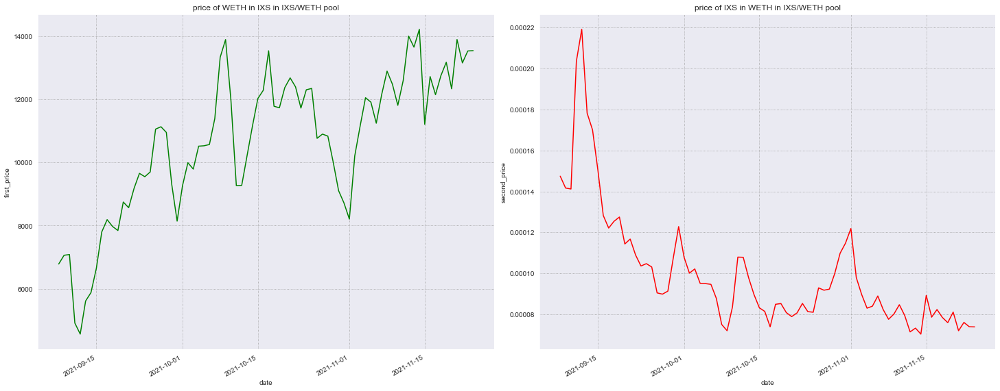

In [62]:
show_reserve_price_distributions(ixs_weth_reserves_df, 
                                 first_token_price_name="price of WETH in IXS in IXS/WETH pool", 
                                second_token_price_name="price of IXS in WETH in IXS/WETH pool", 
                                x=25, y=10, wspace=0.1)

In [63]:
ixs_weth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,3.794422e+05,55.944001,390788.928776,3.245787e+06,425.302832,2021-09-08,6782.535597,0.000147
1,3.880956e+05,54.966786,376226.981271,6.385440e+05,93.661413,2021-09-09,7060.548292,0.000142
2,3.895395e+05,54.992914,352105.690608,5.129601e+05,85.994939,2021-09-10,7083.448476,0.000141
3,3.251391e+05,66.178741,431450.660405,5.158716e+05,94.863760,2021-09-11,4913.044172,0.000204
4,3.138946e+05,68.793197,472201.658618,3.769885e+05,81.732506,2021-09-12,4562.873332,0.000219
...,...,...,...,...,...,...,...,...
73,1.209956e+06,98.094824,862454.304721,1.672137e+05,13.709443,2021-11-20,12334.554265,0.000081
74,1.284852e+06,92.456066,797584.511803,3.727151e+05,26.932798,2021-11-21,13896.894186,0.000072
75,1.247104e+06,94.797725,810045.759781,9.639416e+04,7.093675,2021-11-22,13155.415953,0.000076
76,1.252266e+06,92.530748,780026.110262,5.520048e+04,4.052464,2021-11-23,13533.515878,0.000074


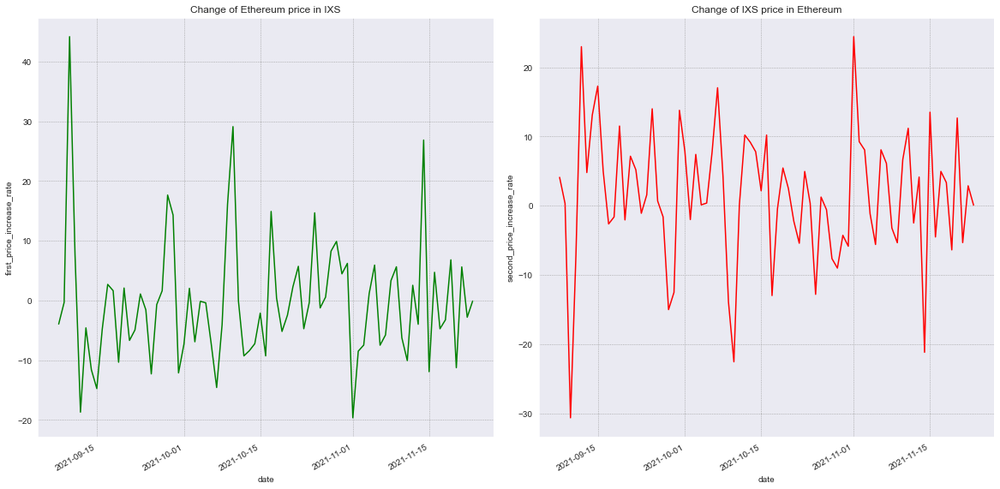

In [64]:
calc_price_and_increase_rates(ixs_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=ixs_weth_reserves_df, x='date', y='first_price_increase_rate', color='green').set_title('Change of Ethereum price in IXS')
plt.subplot(1, 2, 2)
sns.lineplot(data=ixs_weth_reserves_df, x='date', y='second_price_increase_rate', color='red').set_title('Change of IXS price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


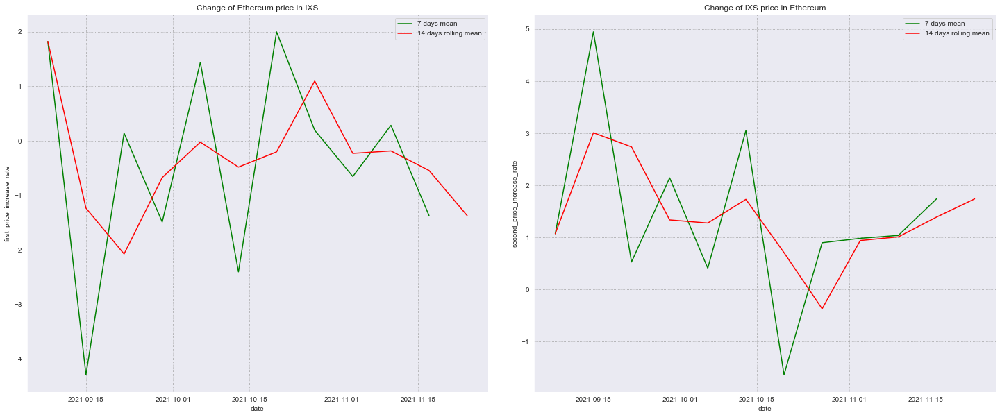

In [65]:
increase_rate_moving_averages(ixs_weth_reserves_df, 'Change of Ethereum price in IXS', 'Change of IXS price in Ethereum', x_size=25, y_size=10)

## SQUID/ETH

In [66]:
squid_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\squid_weth_swaps.pkl')
squid_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\squid_weth_mints.pkl")
squid_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\squid_weth_reserves.pkl")

### Plotting swapping in moving averages

In [67]:
squid_weth_df[squid_weth_df.token_in == 'SQUID']

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
0,SQUID,WETH,1.515152e+10,0.882363,2368.034156,2021-09-29 21:58:26,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x817a2564c2300f96b539332fde239bfa2f7a44a5a9c5...
1,SQUID,WETH,1.274336e+10,0.619296,1680.994807,2021-09-29 21:58:26,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x817a2564c2300f96b539332fde239bfa2f7a44a5a9c5...
2,SQUID,WETH,9.266101e+09,0.473672,1298.817313,2021-09-29 21:59:00,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xcda98c33dcdff5252700cac9921313c8d5e6b1569e6f...
3,SQUID,WETH,1.263748e+10,0.565413,1538.285490,2021-09-29 21:59:00,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xcda98c33dcdff5252700cac9921313c8d5e6b1569e6f...
4,SQUID,WETH,1.515152e+10,0.945236,2533.074357,2021-09-29 21:59:00,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xdda4b205d0b44eb3030010f6ac32ced6b62e6211e51f...
...,...,...,...,...,...,...,...,...,...
173,SQUID,WETH,1.017555e+10,0.042067,147.895471,2021-10-10 13:15:24,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xba307bef6a8f4609a82bbfd66623f310a7f21c3d2d82...
174,SQUID,WETH,7.732504e+08,0.003135,10.716093,2021-10-12 12:54:22,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x54049a82a84a87145125e6c8c147bf970489bfe25574...
175,SQUID,WETH,9.998849e+09,0.039789,134.914133,2021-10-12 12:54:22,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x54049a82a84a87145125e6c8c147bf970489bfe25574...
176,SQUID,WETH,8.645340e+08,0.003396,13.140648,2021-10-18 06:52:26,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x2c1d79cb2425904c1be268687e275df742f8a352d100...


In [68]:
squid_weth_df = get_df_with_swap_prices_and_change_rates(df=squid_weth_df, first_token='SQUID', second_token='WETH')

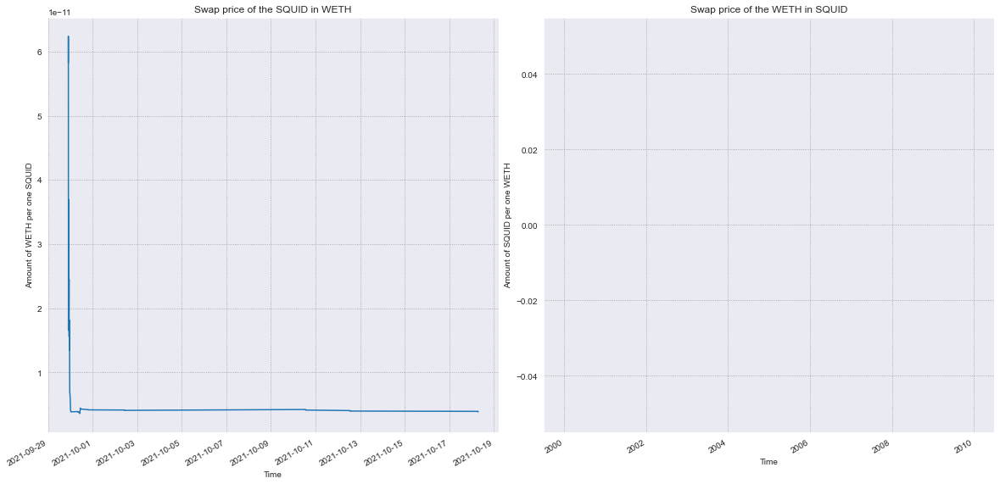

In [69]:
pyplot_line_swap_prices(squid_weth_df, first_token='SQUID', second_token='WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

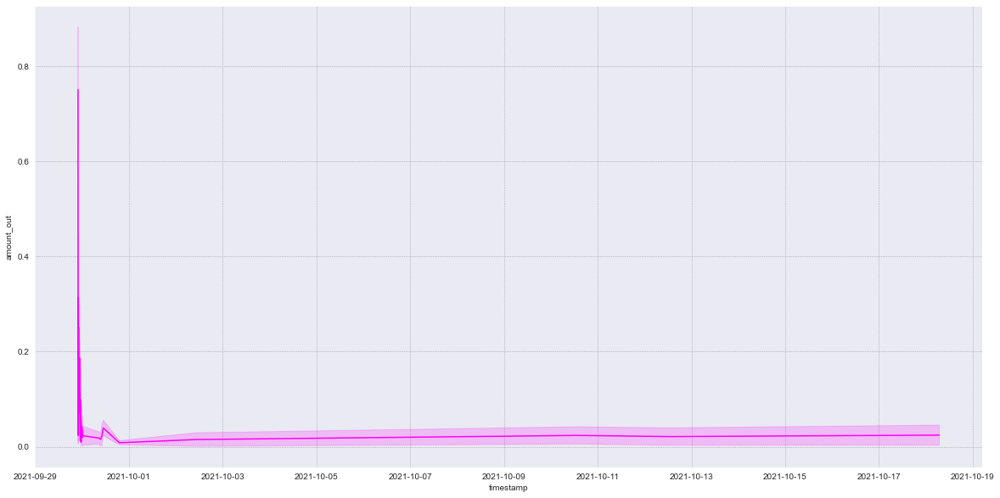

In [70]:
plt.figure(figsize=(20, 10))
sns.lineplot(x=squid_weth_df[squid_weth_df.token_in == 'SQUID'].timestamp, 
             y=squid_weth_df[squid_weth_df.token_in == 'SQUID'].amount_out, color='magenta')
plt.show()

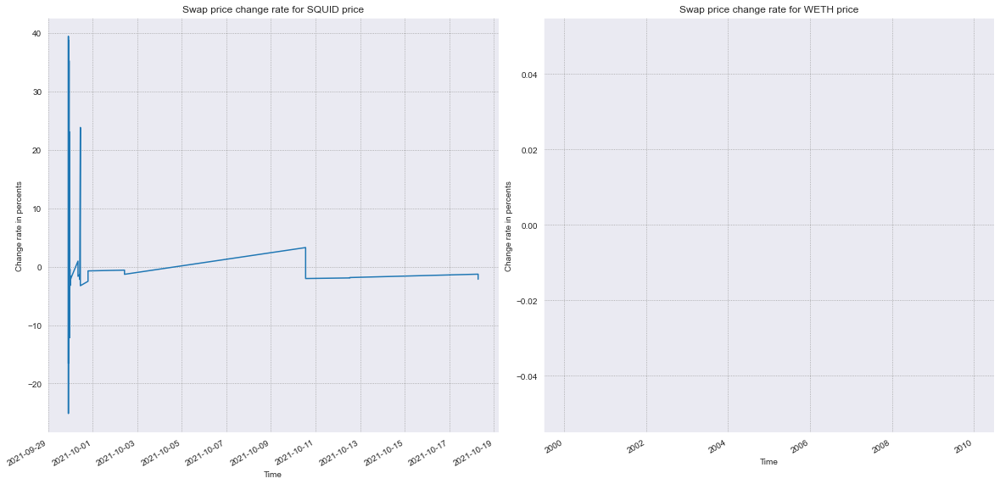

In [71]:
pyplot_line_swap_change_rate(squid_weth_df, first_token='SQUID', second_token='WETH', xsize=20, ysize=10, 
                             wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


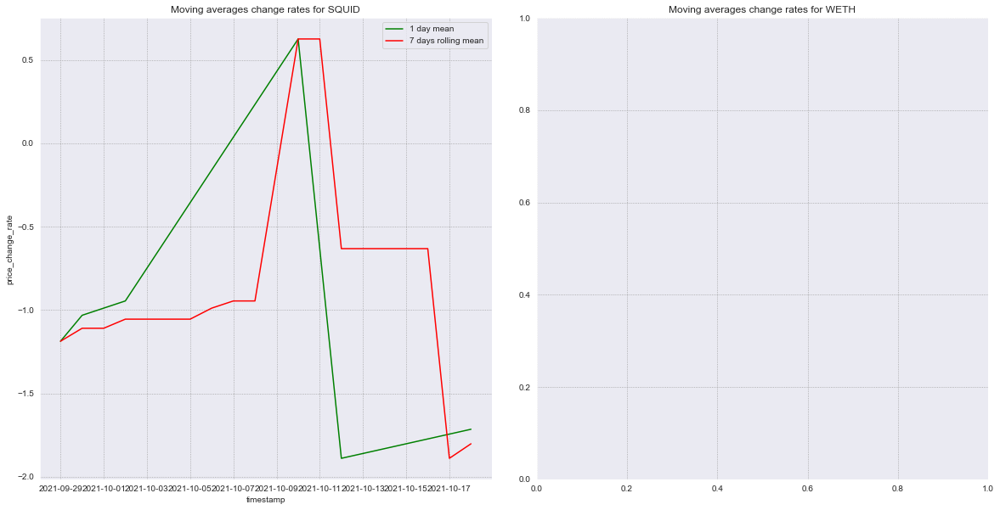

In [72]:
swaps_price_change_rates_moving_averages(squid_weth_df, first_token='SQUID', second_token='WETH', 
                                         first_plot_name='Moving averages change rates for SQUID', 
                                        second_plot_name='Moving averages change rates for WETH', 
                                        x_size=20, y_size=10, wspace=0.1, hspace=0.1)

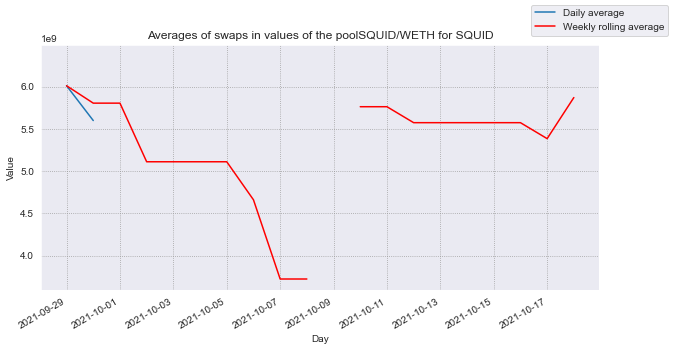

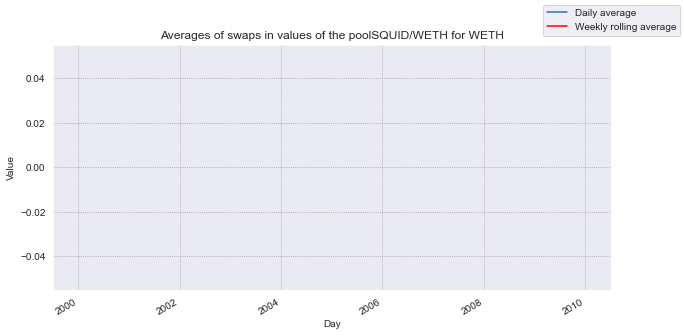

In [73]:
show_swaps_amount_in_moving_averages(swaps_df=squid_weth_df[(squid_weth_df.token_in == 'SQUID')], 
                                     pool_name="SQUID/WETH for SQUID")
show_swaps_amount_in_moving_averages(swaps_df=squid_weth_df[(squid_weth_df.token_in == 'WETH')], 
                                     pool_name="SQUID/WETH for WETH")

### Swaps values histograms

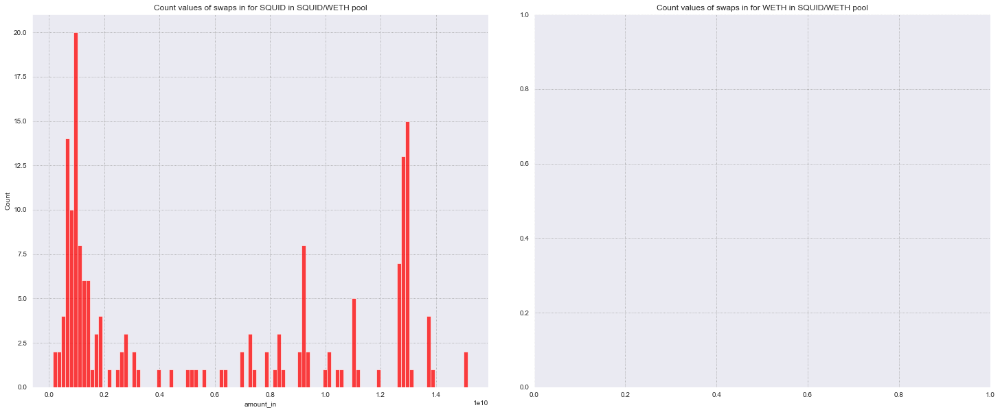

In [74]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=squid_weth_df[squid_weth_df.token_in == 'SQUID'], x='amount_in', 
             bins=100, color='red').set_title("Count values of swaps in for SQUID in SQUID/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=squid_weth_df[squid_weth_df.token_in == 'WETH'], x='amount_in', 
             bins=100, color='magenta').set_title("Count values of swaps in for WETH in SQUID/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

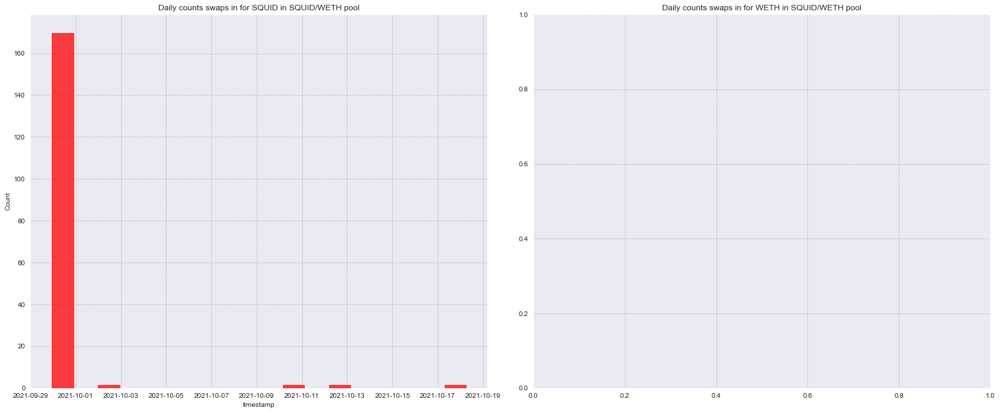

In [75]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=squid_weth_df[squid_weth_df.token_in == 'SQUID'], x='timestamp', 
             bins=(squid_weth_df.timestamp[len(squid_weth_df) - 1] - squid_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for SQUID in SQUID/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=squid_weth_df[squid_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(squid_weth_df.timestamp[len(squid_weth_df) - 1] - squid_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in SQUID/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

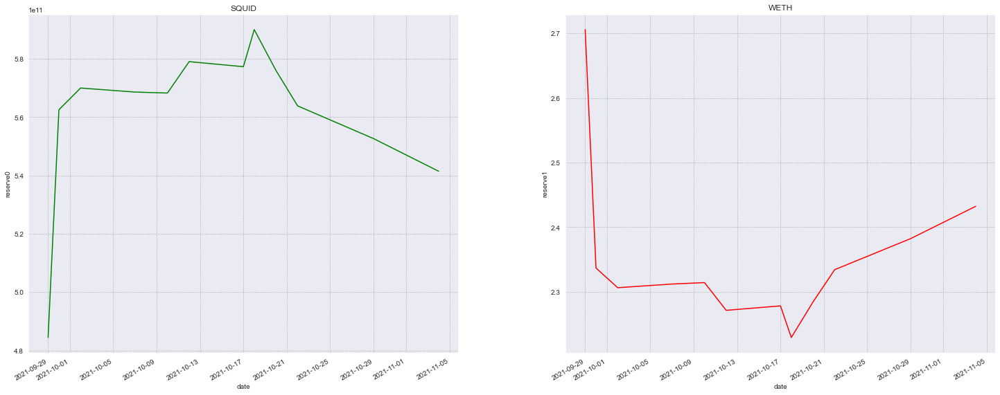

In [76]:
show_reserves_time_distribution(squid_weth_reserves_df, first_token_reserve_name="SQUID", second_token_reserve_name="WETH", x=25, y=10)

### Plotting pool prices

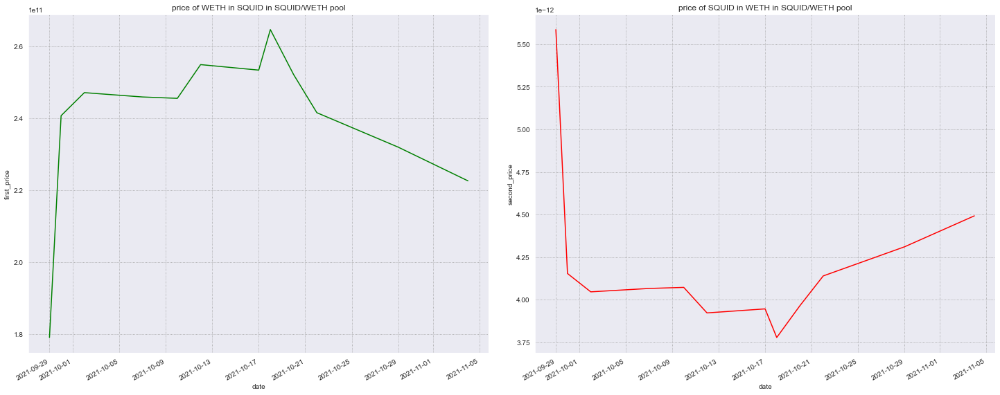

In [77]:
show_reserve_price_distributions(squid_weth_reserves_df, 
                                 first_token_price_name="price of WETH in SQUID in SQUID/WETH pool", 
                                second_token_price_name="price of SQUID in WETH in SQUID/WETH pool", 
                                x=25, y=10, wspace=0.1)

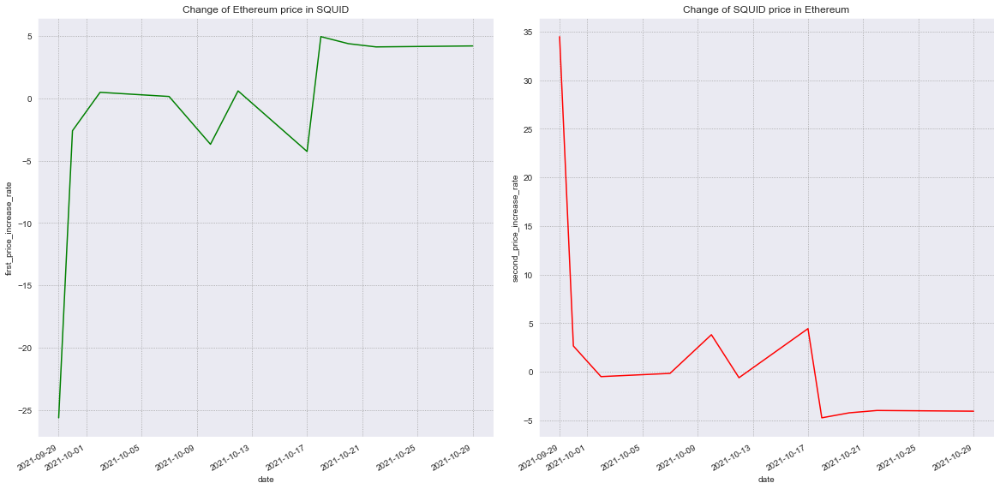

In [78]:
calc_price_and_increase_rates(squid_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=squid_weth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in SQUID')
plt.subplot(1, 2, 2)
sns.lineplot(data=squid_weth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of SQUID price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


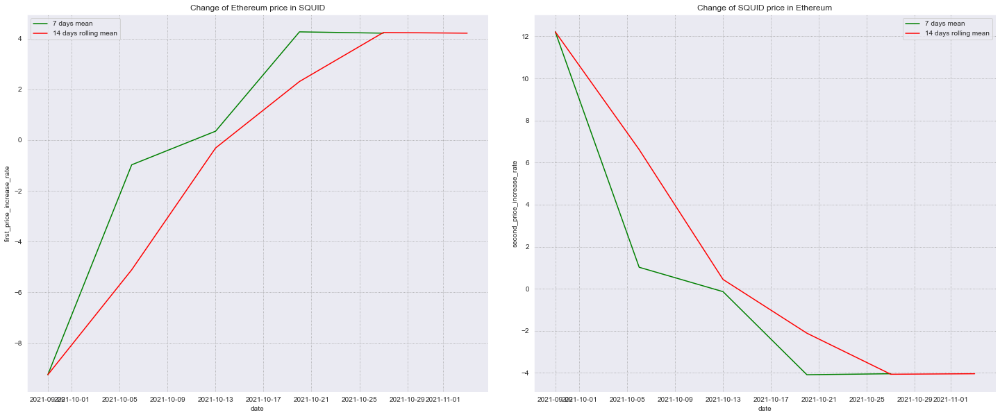

In [79]:
increase_rate_moving_averages(squid_weth_reserves_df, 'Change of Ethereum price in SQUID', 'Change of SQUID price in Ethereum', x_size=25, y_size=10)

## HKMT/USDT

In [80]:
hkmt_usdt_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\hkmt_usdt_swaps.pkl')
hkmt_usdt_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\hkmt_usdt_mints.pkl")
hkmt_usdt_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\hkmt_usdt_burns.pkl")
hkmt_usdt_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\hkmt_usdt_reserves.pkl")

### Plotting swapping in moving averages

In [81]:
hkmt_usdt_df = get_df_with_swap_prices_and_change_rates(df=hkmt_usdt_df, first_token='HKMT', second_token='USDT')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


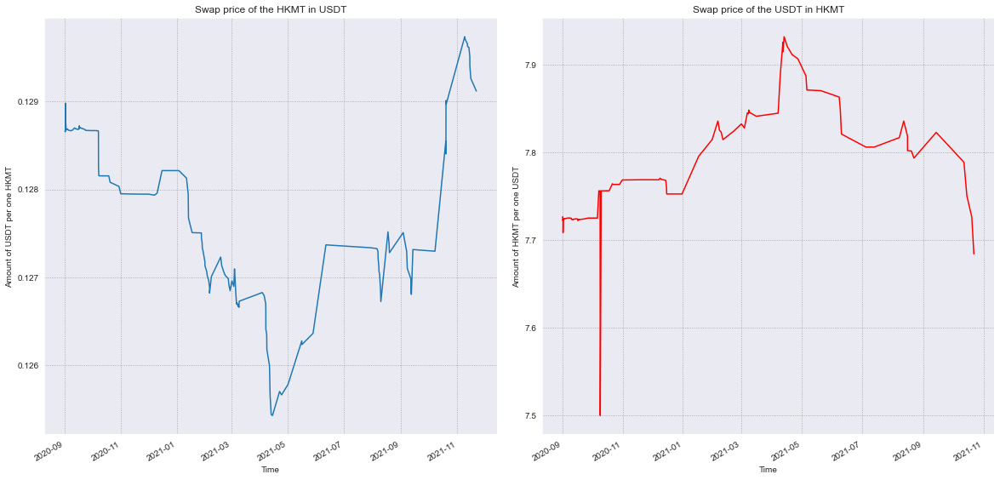

In [82]:
pyplot_line_swap_prices(df=hkmt_usdt_df, first_token='HKMT', second_token='USDT', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

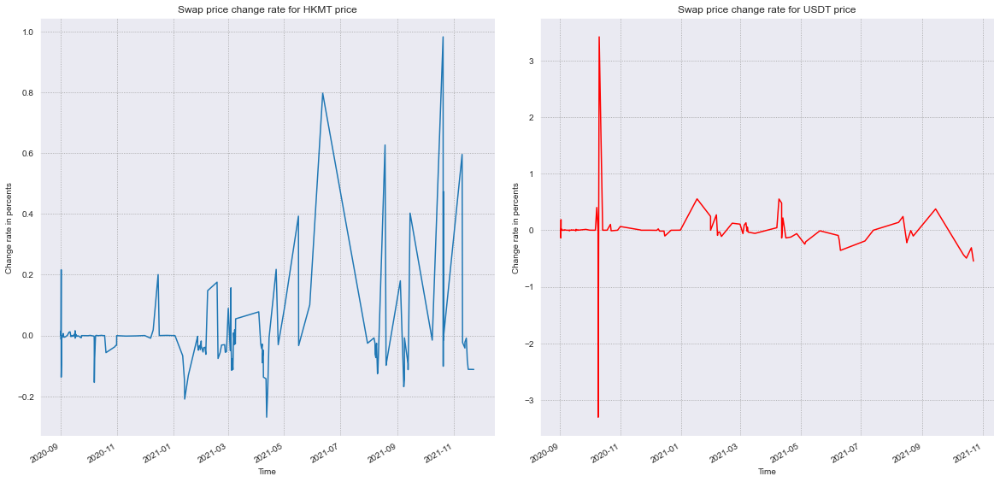

In [83]:
pyplot_line_swap_change_rate(df=hkmt_usdt_df, first_token='HKMT', second_token='USDT', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


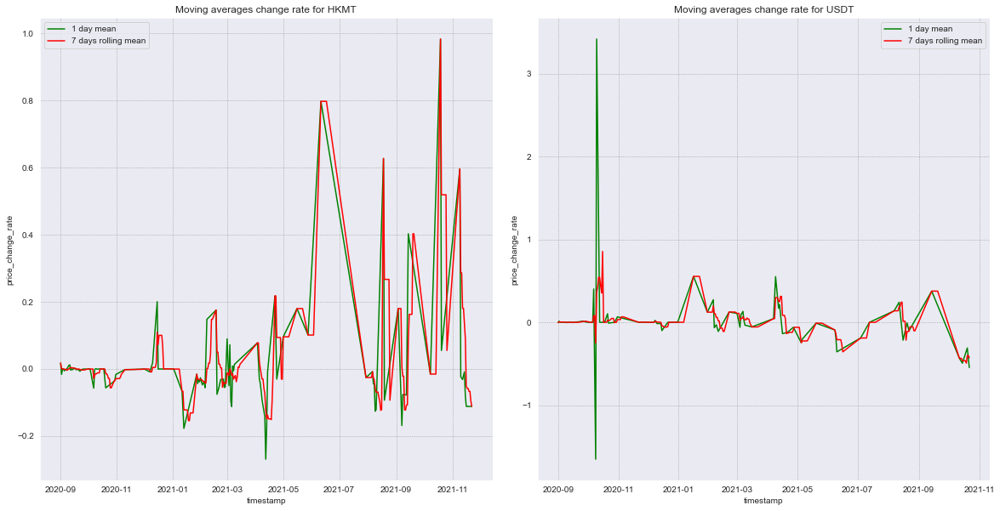

In [84]:
swaps_price_change_rates_moving_averages(df=hkmt_usdt_df, first_token='HKMT', second_token='USDT',
                                           first_plot_name='Moving averages change rate for HKMT',
                                           second_plot_name='Moving averages change rate for USDT',
                                           x_size=20, y_size=10, wspace=0.1, hspace=0.1)

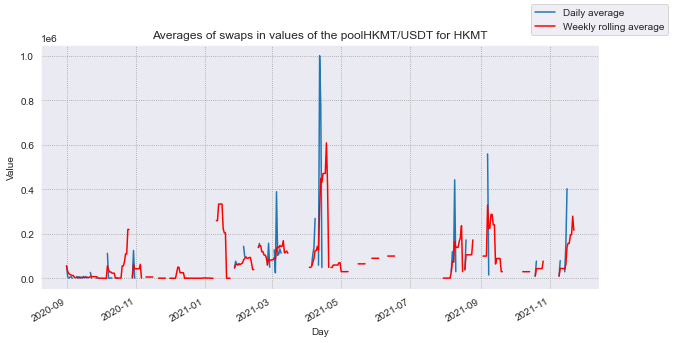

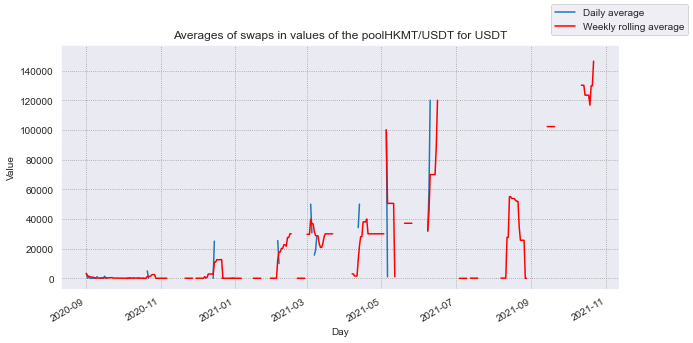

In [85]:
show_swaps_amount_in_moving_averages(swaps_df=hkmt_usdt_df[(hkmt_usdt_df.token_in == 'HKMT')],
                                     pool_name="HKMT/USDT for HKMT")
show_swaps_amount_in_moving_averages(swaps_df=hkmt_usdt_df[(hkmt_usdt_df.token_in == 'USDT')], 
                                     pool_name="HKMT/USDT for USDT")

### Swaps values histograms

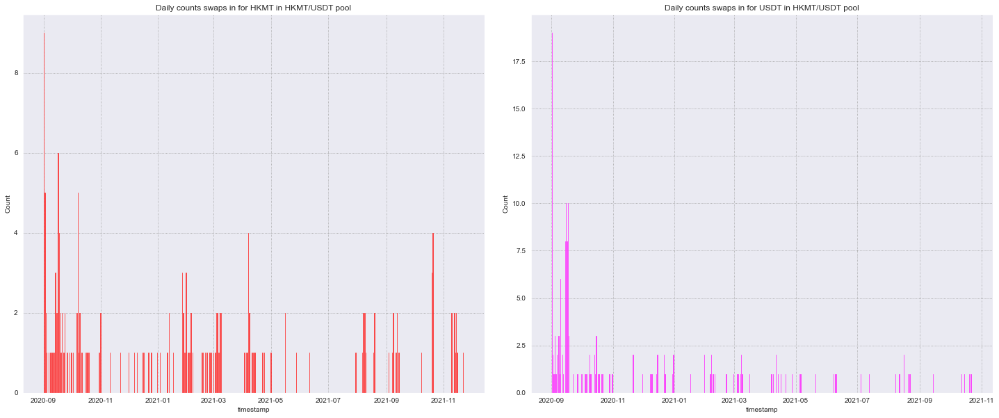

In [86]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=hkmt_usdt_df[hkmt_usdt_df.token_in == 'HKMT'], x='timestamp', 
             bins=(hkmt_usdt_df.timestamp[len(hkmt_usdt_df) - 1] - hkmt_usdt_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for HKMT in HKMT/USDT pool")
plt.subplot(1, 2, 2)
sns.histplot(data=hkmt_usdt_df[hkmt_usdt_df.token_in == 'USDT'], x='timestamp', 
             bins=(hkmt_usdt_df.timestamp[len(hkmt_usdt_df) - 1] - hkmt_usdt_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for USDT in HKMT/USDT pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

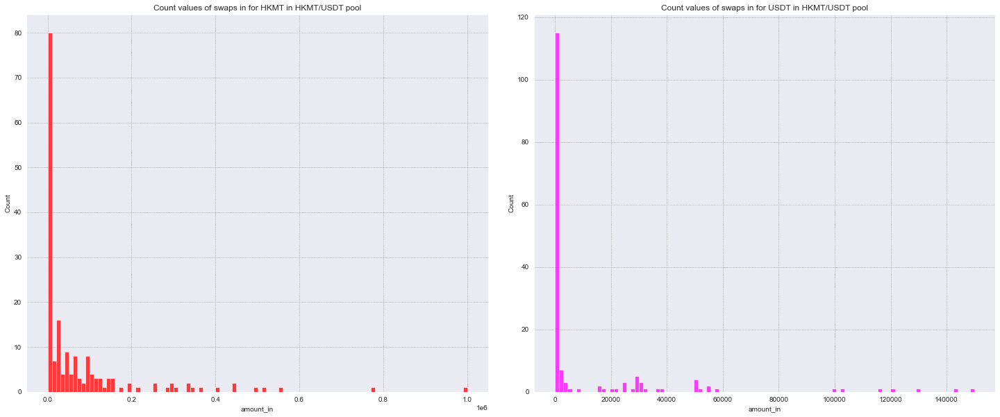

In [87]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=hkmt_usdt_df[hkmt_usdt_df.token_in == 'HKMT'], x='amount_in', 
             bins=100, color='red').set_title("Count values of swaps in for HKMT in HKMT/USDT pool")
plt.subplot(1, 2, 2)
sns.histplot(data=hkmt_usdt_df[hkmt_usdt_df.token_in == 'USDT'], x='amount_in', 
             bins=100, color='magenta').set_title("Count values of swaps in for USDT in HKMT/USDT pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

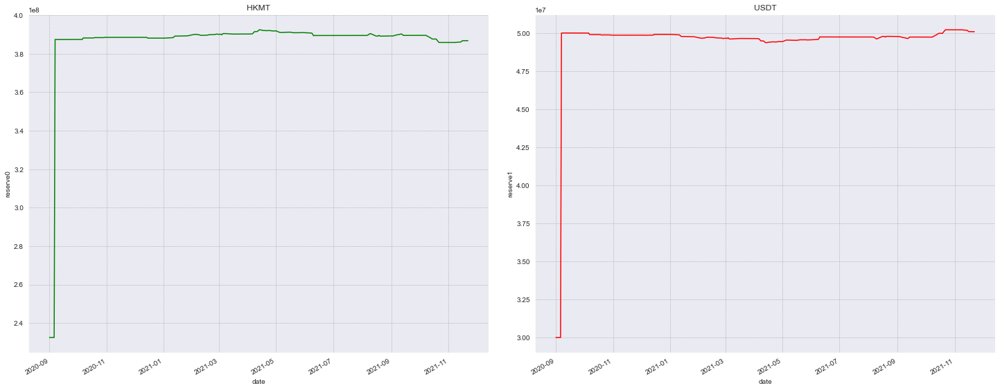

In [88]:
show_reserves_time_distribution(hkmt_usdt_reserves_df, 
                                first_token_reserve_name="HKMT", 
                                second_token_reserve_name="USDT", 
                                x=25, y=10, wspace=0.1)

### Plotting pool price

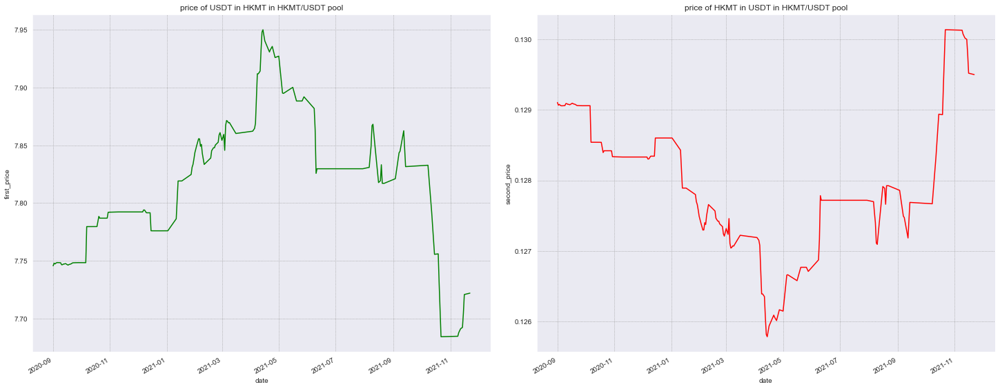

In [89]:
show_reserve_price_distributions(hkmt_usdt_reserves_df, 
                                first_token_price_name="price of USDT in HKMT in HKMT/USDT pool", 
                                second_token_price_name="price of HKMT in USDT in HKMT/USDT pool", 
                                x=25, y=10, wspace=0.1)

In [90]:
hkmt_usdt_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,2.324374e+08,3.000841e+07,5.962596e+07,841180.034572,108718.139712,2020-09-01,7.745741,0.129103
1,2.324720e+08,3.000396e+07,5.998884e+07,39685.978673,5109.376059,2020-09-02,7.748043,0.129065
2,2.324620e+08,3.000526e+07,5.980636e+07,12136.201494,1570.298902,2020-09-03,7.747375,0.129076
3,2.324728e+08,3.000387e+07,5.974688e+07,11266.150769,1449.936710,2020-09-04,7.748094,0.129064
4,2.324795e+08,3.000300e+07,5.981387e+07,7698.807460,990.995574,2020-09-05,7.748544,0.129057
...,...,...,...,...,...,...,...,...
154,3.860615e+08,5.019442e+07,1.002105e+08,83900.000000,10878.034552,2021-11-12,7.691323,0.130017
155,3.860910e+08,5.019060e+07,1.002239e+08,29450.000000,3817.212732,2021-11-14,7.692495,0.129997
156,3.864028e+08,5.015022e+07,1.002343e+08,311823.000000,40381.870291,2021-11-15,7.704907,0.129787
157,3.868051e+08,5.009822e+07,1.003490e+08,402277.856847,52000.000000,2021-11-16,7.720934,0.129518


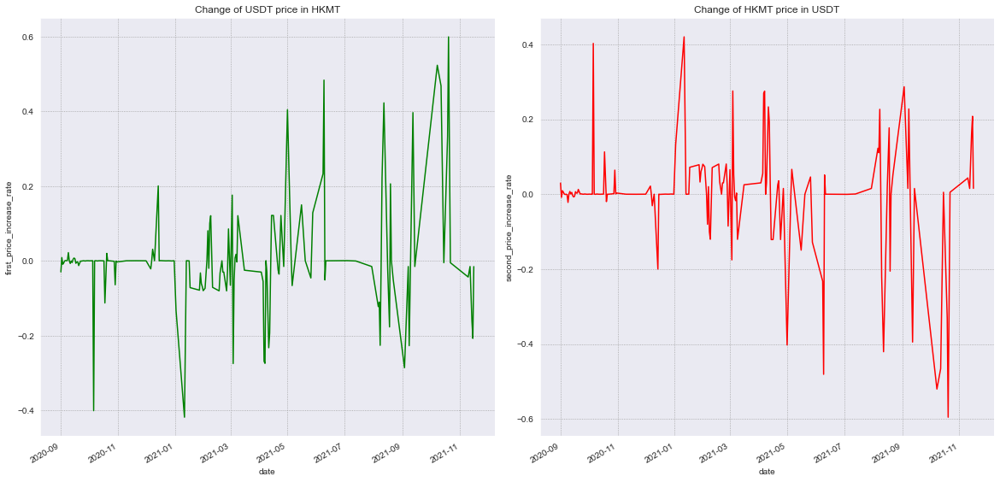

In [91]:
calc_price_and_increase_rates(hkmt_usdt_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=hkmt_usdt_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of USDT price in HKMT')
plt.subplot(1, 2, 2)
sns.lineplot(data=hkmt_usdt_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of HKMT price in USDT')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


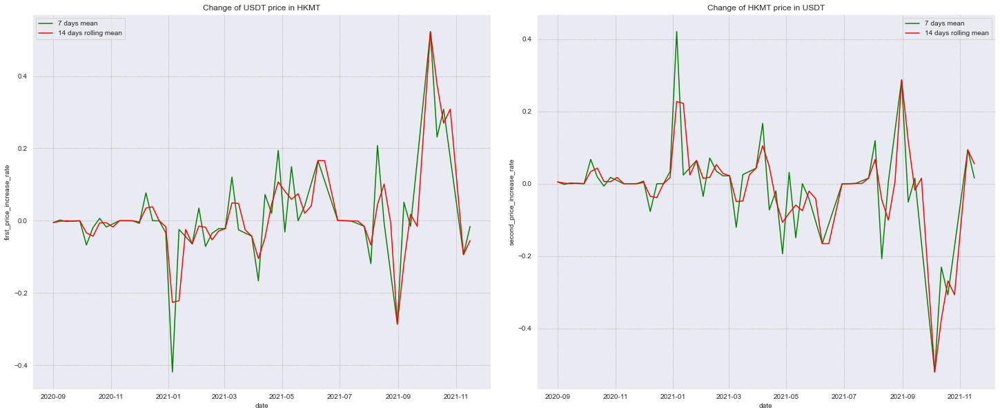

In [92]:
increase_rate_moving_averages(hkmt_usdt_reserves_df, 'Change of USDT price in HKMT', 
                              'Change of HKMT price in USDT', x_size=25, y_size=10)

## FEI/ETH

In [93]:
fei_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\fei_weth_swaps.pkl')
fei_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\fei_weth_mints.pkl")
fei_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\fei_weth_burns.pkl")
fei_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\fei_weth_reserves.pkl")

### Plotting swapping in moving averages

In [94]:
fei_weth_df = get_df_with_swap_prices_and_change_rates(df=fei_weth_df, first_token='FEI', second_token='WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [95]:
# fei_weth_df[(fei_weth_df.token_in == 'WETH') & (fei_weth_df.first_to_second_price < 1000)]
fei_weth_df[(fei_weth_df.timestamp > datetime(2021, 8, 28, 9, 0)) & 
            (fei_weth_df.timestamp < datetime(2021, 8, 28, 9, 50))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
39684,WETH,FEI,0.001000,3.248770,3.243474,2021-08-28 09:16:41,0x64b6714523b82b030ab67b9df3fd99ce5223e0e1,0x64b6714523b82b030ab67b9df3fd99ce5223e0e1,0x7514f5d1637f776a419d486dd3dfcb9732a0b43c14c0...,3248.770000,0.216102
39685,WETH,FEI,0.001000,3.248774,3.243331,2021-08-28 09:16:56,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xf9404708c16ec50dd563ca0bef2f07eb32d3d7c2,0x7710de4be1ae34ac52c75648774503e9807d54d1f335...,3248.773553,0.000109
39686,WETH,FEI,0.001000,0.324877,3.243483,2021-08-28 09:21:48,0x64b6714523b82b030ab67b9df3fd99ce5223e0e1,0x64b6714523b82b030ab67b9df3fd99ce5223e0e1,0x58fa60b6290169a41216fdce4906e04972a18c0f5ed5...,324.877000,-90.000011
39687,FEI,WETH,675.085714,0.206551,670.307283,2021-08-28 09:34:22,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe9f83593ea2ae696d649f7e1ee62f940aa64a7e944f4...,0.000306,-0.001645
39688,FEI,WETH,55447.930505,16.959115,55008.932388,2021-08-28 09:37:41,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb4543dddfb32e257e8ced174ee00fb8ebf80dc421c69...,0.000306,-0.034819


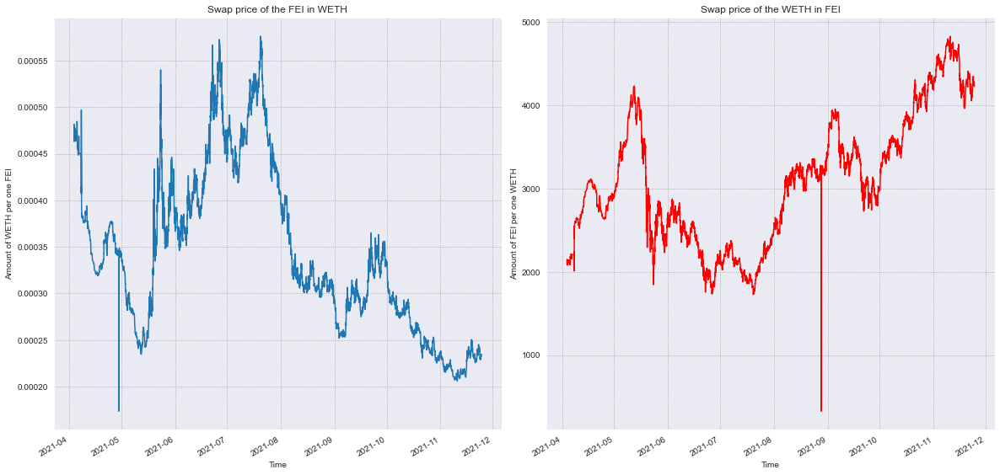

In [96]:
pyplot_line_swap_prices(df=fei_weth_df[fei_weth_df.first_to_second_price > 0], first_token='FEI', 
                        second_token='WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

In [97]:
fei_weth_df[fei_weth_df.price_change_rate > 80]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
9466,FEI,WETH,561380.165985,190.424079,531256.648195,2021-04-29 12:42:50,0x9271d303b57c204636c38df0ed339b18bf98f909,0x9271d303b57c204636c38df0ed339b18bf98f909,0xa424ab221f45d00bf4d0928770faa027521379d53247...,0.000339,95.315388
39692,WETH,FEI,1.550000,5048.731674,5027.088786,2021-08-28 10:52:39,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x9928e4046d7c6513326ccea028cd3e7a91c7590a,0xde242e760d321c7568254c4ee6a7d6373ed5af264a22...,3257.246241,902.609062


In [98]:
fei_weth_df[(fei_weth_df.timestamp > datetime(2021, 8, 28, 8, 50)) & (fei_weth_df.timestamp < datetime(2021, 8, 28, 12, 0))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
39683,FEI,WETH,1985.876412,0.607615,1967.602022,2021-08-28 08:51:02,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x688180b1876aab18db018799a3106201290ebbdb1c87...,0.000306,-0.021607
39684,WETH,FEI,0.001000,3.248770,3.243474,2021-08-28 09:16:41,0x64b6714523b82b030ab67b9df3fd99ce5223e0e1,0x64b6714523b82b030ab67b9df3fd99ce5223e0e1,0x7514f5d1637f776a419d486dd3dfcb9732a0b43c14c0...,3248.770000,0.216102
39685,WETH,FEI,0.001000,3.248774,3.243331,2021-08-28 09:16:56,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xf9404708c16ec50dd563ca0bef2f07eb32d3d7c2,0x7710de4be1ae34ac52c75648774503e9807d54d1f335...,3248.773553,0.000109
39686,WETH,FEI,0.001000,0.324877,3.243483,2021-08-28 09:21:48,0x64b6714523b82b030ab67b9df3fd99ce5223e0e1,0x64b6714523b82b030ab67b9df3fd99ce5223e0e1,0x58fa60b6290169a41216fdce4906e04972a18c0f5ed5...,324.877000,-90.000011
39687,FEI,WETH,675.085714,0.206551,670.307283,2021-08-28 09:34:22,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe9f83593ea2ae696d649f7e1ee62f940aa64a7e944f4...,0.000306,-0.001645
39688,FEI,WETH,55447.930505,16.959115,55008.932388,2021-08-28 09:37:41,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb4543dddfb32e257e8ced174ee00fb8ebf80dc421c69...,0.000306,-0.034819
39689,FEI,WETH,41410.764742,12.658133,41057.913311,2021-08-28 10:14:43,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x704894cd30e6eef19860c204101f5b90a0da675e5ec5...,0.000306,-0.060177
39690,FEI,WETH,63307.251626,19.338709,62739.037399,2021-08-28 10:15:51,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x96ef80393dd35372257b9885fa7d495aa4ed37ccb8e0...,0.000305,-0.065000
39691,FEI,WETH,51356.475263,15.676892,50855.477426,2021-08-28 10:16:25,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0a41425faf192d3b24054ac19cd8f593f8386113e98f...,0.000305,-0.071184
39692,WETH,FEI,1.550000,5048.731674,5027.088786,2021-08-28 10:52:39,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x9928e4046d7c6513326ccea028cd3e7a91c7590a,0xde242e760d321c7568254c4ee6a7d6373ed5af264a22...,3257.246241,902.609062


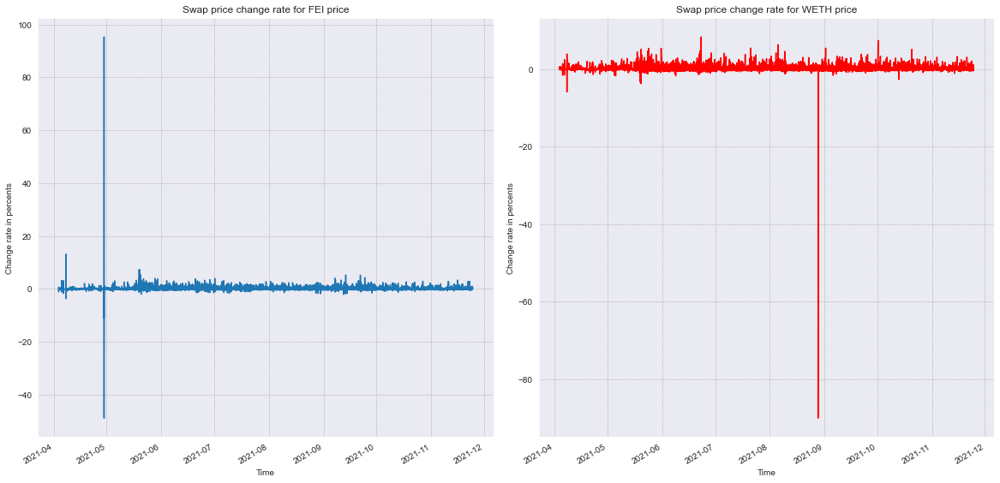

In [99]:
pyplot_line_swap_change_rate(df=fei_weth_df[(fei_weth_df.first_to_second_price > 0) & 
                                            (fei_weth_df.price_change_rate < 600)], 
                             first_token='FEI', second_token='WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


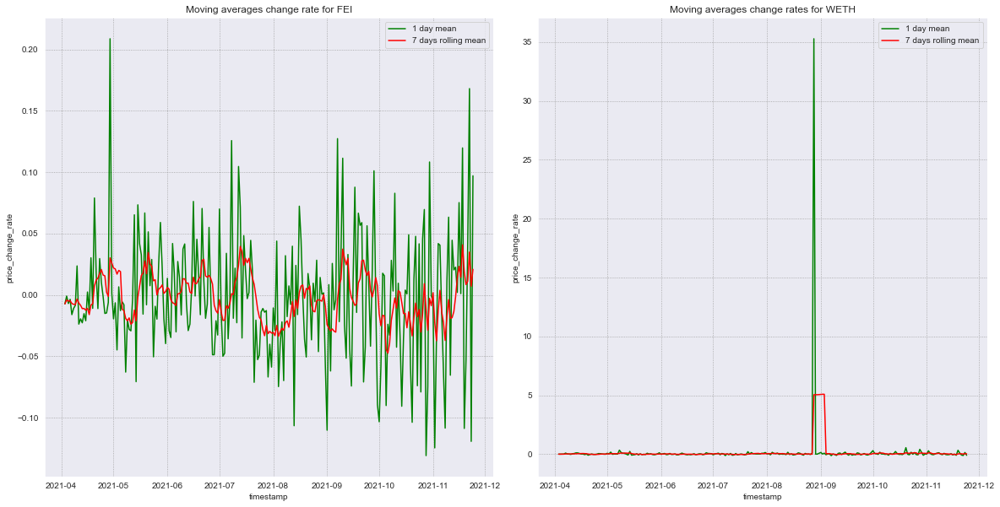

In [100]:
swaps_price_change_rates_moving_averages(fei_weth_df, first_token='FEI', second_token='WETH',
                                           first_plot_name='Moving averages change rate for FEI',
                                           second_plot_name='Moving averages change rates for WETH',
                                           x_size=20, y_size=10, wspace=0.1, hspace=0.1)

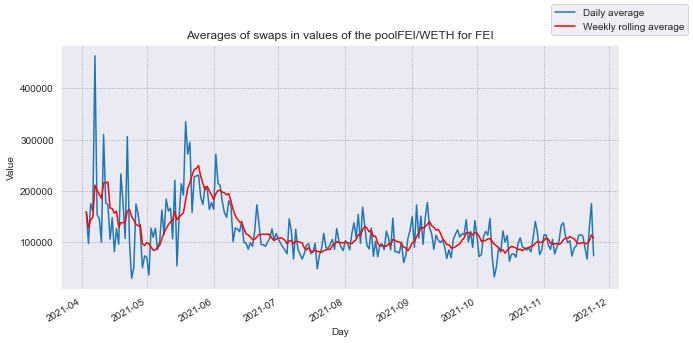

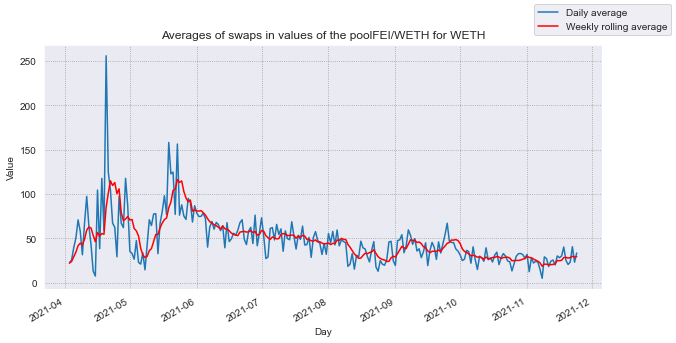

In [101]:
show_swaps_amount_in_moving_averages(swaps_df=fei_weth_df[(fei_weth_df.token_in == 'FEI')], 
                                     pool_name="FEI/WETH for FEI")
show_swaps_amount_in_moving_averages(swaps_df=fei_weth_df[(fei_weth_df.token_in == 'WETH')], 
                                     pool_name="FEI/WETH for WETH")

### Swaps values histograms

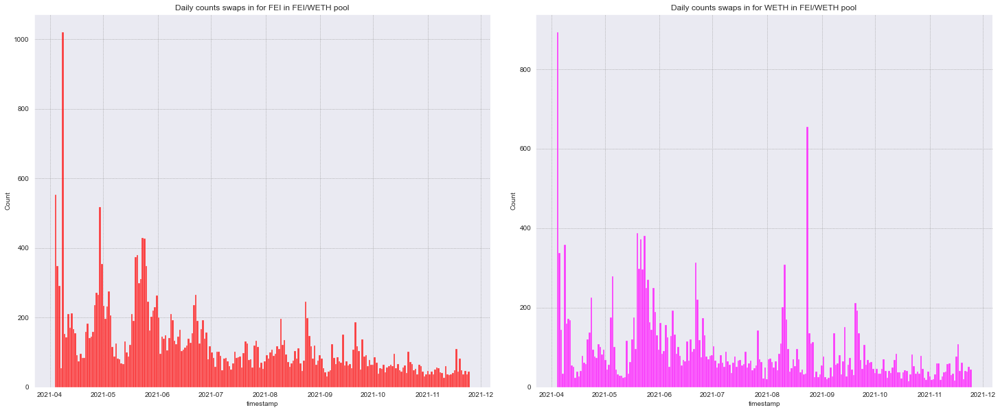

In [102]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=fei_weth_df[fei_weth_df.token_in == 'FEI'], x='timestamp', 
             bins=(fei_weth_df.timestamp[len(fei_weth_df) - 1] - fei_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for FEI in FEI/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=fei_weth_df[fei_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(fei_weth_df.timestamp[len(fei_weth_df) - 1] - fei_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in FEI/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

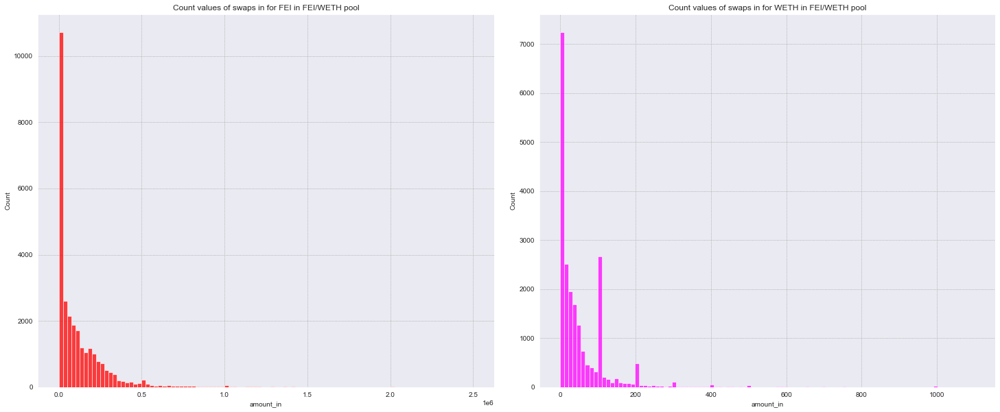

In [103]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=fei_weth_df[fei_weth_df.token_in == 'FEI'], x='amount_in', 
             bins=100, color='red', binrange=[0, 2500000]).set_title("Count values of swaps in for FEI in FEI/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=fei_weth_df[fei_weth_df.token_in == 'WETH'], x='amount_in', 
             bins=100, color='magenta', binrange=[0, 1100]).set_title("Count values of swaps in for WETH in FEI/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

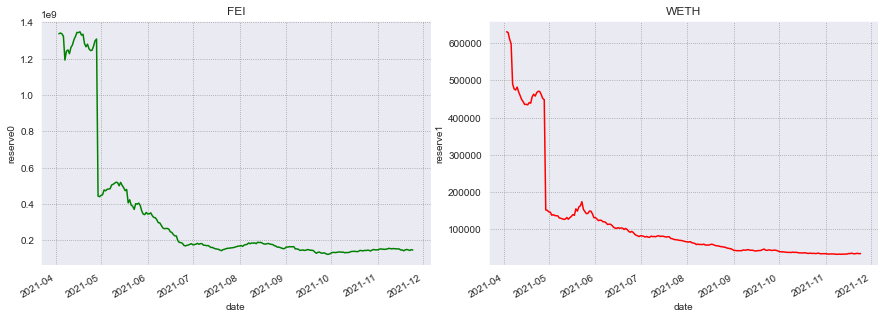

In [104]:
show_reserves_time_distribution(fei_weth_reserves_df, first_token_reserve_name="FEI", second_token_reserve_name="WETH", x=15, wspace=0.15)

### Plotting pool price

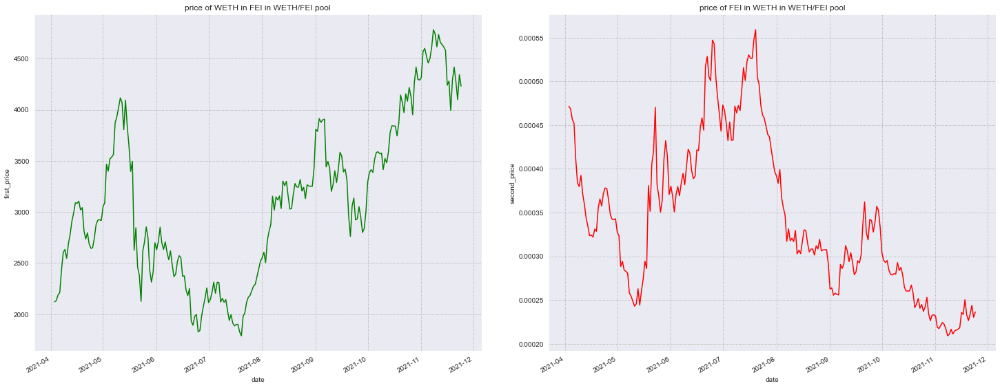

In [105]:
show_reserve_price_distributions(fei_weth_reserves_df, first_token_price_name="price of WETH in FEI in WETH/FEI pool", 
                                        second_token_price_name="price of FEI in WETH in WETH/FEI pool", x=25, y=10, wspace=0.15)

In [106]:
fei_weth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,1.337230e+09,630522.677036,2.537871e+09,5.830436e+07,27452.763852,2021-04-03,2120.828163,0.000472
1,1.341220e+09,628533.678068,2.604474e+09,6.647175e+07,31306.853434,2021-04-04,2133.886561,0.000469
2,1.337334e+09,610770.369281,2.561514e+09,8.717716e+07,40829.752667,2021-04-05,2189.585332,0.000457
3,1.323221e+09,598300.386209,2.531489e+09,5.256349e+07,24003.259833,2021-04-06,2211.633163,0.000452
4,1.192320e+09,490330.663557,1.925378e+09,2.657121e+08,122248.657720,2021-04-07,2431.665205,0.000411
...,...,...,...,...,...,...,...,...
231,1.489893e+08,33726.798670,2.971007e+08,7.857096e+06,1822.865090,2021-11-20,4417.533372,0.000226
232,1.465835e+08,34284.616392,2.937705e+08,6.154276e+06,1414.759309,2021-11-21,4275.489879,0.000234
233,1.435460e+08,35019.487375,2.869859e+08,1.292556e+07,3094.474835,2021-11-22,4099.031086,0.000244
234,1.477743e+08,34026.568066,2.956214e+08,1.295598e+07,3085.020510,2021-11-23,4342.909182,0.000230


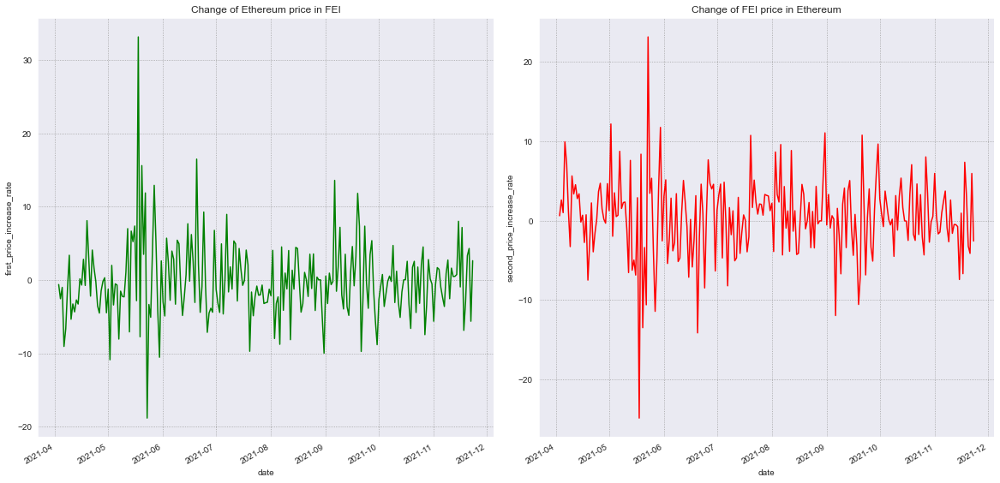

In [107]:
calc_price_and_increase_rates(fei_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=fei_weth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in FEI')
plt.subplot(1, 2, 2)
sns.lineplot(data=fei_weth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of FEI price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


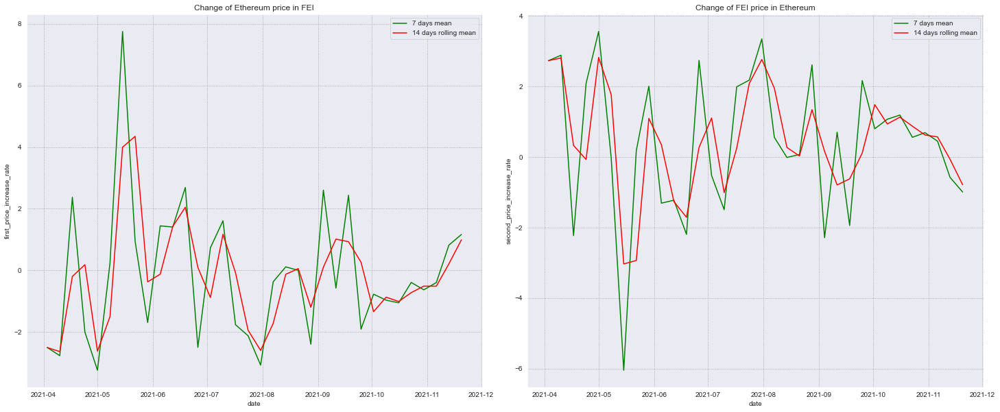

In [108]:
increase_rate_moving_averages(fei_weth_reserves_df, 'Change of Ethereum price in FEI', 
                              'Change of FEI price in Ethereum', x_size=25, y_size=10)

## AXS/ETH

In [109]:
axs_weth_v2_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\axs_weth_v2_swaps.pkl')
axs_weth_v2_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\axs_weth_v2_mints.pkl")
axs_weth_v2_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\axs_weth_v2_burns.pkl")
axs_weth_v2_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\axs_weth_v2_reserves.pkl")

In [110]:
axs_weth_v2_reserves_df.tail(50)

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date
139,95.670245,3.282155,23559.680283,48.950013,1.688619,2021-10-06
140,92.801629,3.386544,24521.290794,28.000050,0.971776,2021-10-07
141,94.588764,3.327924,23683.469711,51.360255,1.880936,2021-10-08
142,94.237914,3.349152,23943.999026,84.504913,3.130232,2021-10-09
143,95.786948,3.305269,22601.551873,106.402321,3.462262,2021-10-10
144,97.898560,3.238351,22776.552260,43.717355,1.570112,2021-10-11
145,95.084755,3.339458,23284.917287,52.931604,1.753696,2021-10-12
146,96.708654,3.287393,23411.230786,40.409825,1.379291,2021-10-13
147,93.274199,3.410404,25725.701464,18.783217,0.642714,2021-10-14
148,100.516068,3.166315,24327.956572,16.678843,0.572421,2021-10-15


### Plotting swapping in moving averages

In [111]:
axs_weth_v2_df = get_df_with_swap_prices_and_change_rates(axs_weth_v2_df, 'AXS', 'WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


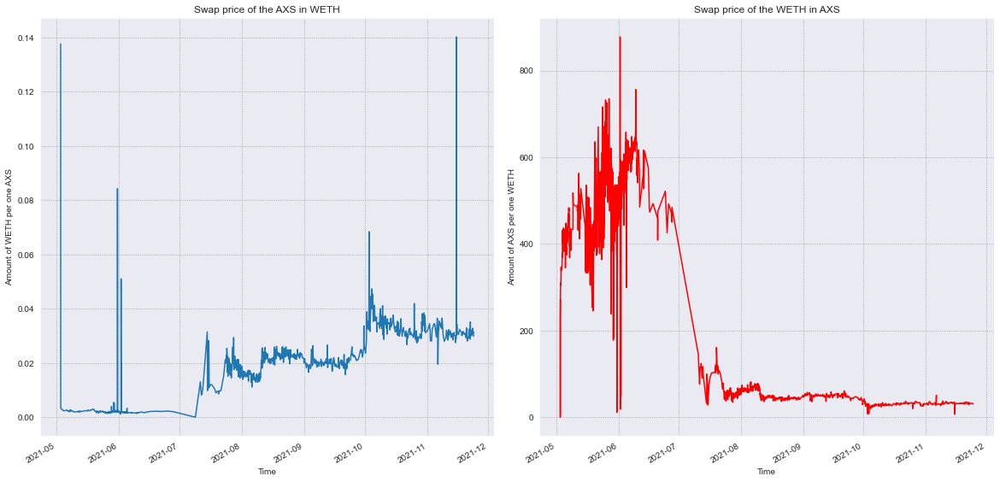

In [112]:
pyplot_line_swap_prices(axs_weth_v2_df[(axs_weth_v2_df.first_to_second_price < 10000000) & 
                                       (axs_weth_v2_df.first_to_second_price != 0)], 
                        'AXS', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

In [113]:
# axs_weth_v2_df[axs_weth_v2_df.price_change_rate > 1000]
axs_weth_v2_df[(axs_weth_v2_df.timestamp > datetime(2021, 6, 2, 1, 0)) & 
               (axs_weth_v2_df.timestamp < datetime(2021, 6, 2, 10, 0))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
1227,AXS,WETH,56.921349,0.104890,267.951405,2021-06-02 01:05:59,0x0000000000a8fb09af944ab3baf7a9b3e1ab29d8,0x0000000000a8fb09af944ab3baf7a9b3e1ab29d8,0x69c96ff08e16fa8db51158bc65261719fa8c339b7e00...,0.001843,-0.119639
1228,AXS,WETH,1942.043980,99.107407,131960.259325,2021-06-02 01:08:29,0x2afa9230b38fe6c64dc980163c0185270e1da91b,0x2afa9230b38fe6c64dc980163c0185270e1da91b,0x7e86f3971064346449a7bc9439fcc955c0a4207bd25f...,0.051033,2669.411482
1229,WETH,AXS,98.999966,1868.608420,255257.545074,2021-06-02 01:08:29,0x2afa9230b38fe6c64dc980163c0185270e1da91b,0x0c365789dbbb94a29f8720dc465554c587e897db,0xfd8c8af74b7ac6b6bdf043fe7f25034dc3d10c3cca48...,18.874839,-96.465965
1230,WETH,AXS,0.010109,6.000000,25.909705,2021-06-02 01:17:03,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xa18fa0ef9e6f3ee8e02ca43bb92111b6a6d8e372,0x47c782dd963898f60c745b3cd7044c82c5839363b70c...,593.533998,3044.577803
1231,WETH,AXS,0.099162,57.008253,257.845438,2021-06-02 01:39:32,0x0000000000a8fb09af944ab3baf7a9b3e1ab29d8,0x0c365789dbbb94a29f8720dc465554c587e897db,0xaf2e625f40f500bf4d7f1d1f3b6b9460604cf011e357...,574.902094,-3.139147
1232,WETH,AXS,0.188763,100.000000,496.870028,2021-06-02 01:40:35,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xdf65801790cdeff782bb78e2d5ddfc3ddb1a01ba,0x185a39bfeb1d97609774409dccef118d5c2d81925965...,529.763621,-7.851506
1233,AXS,WETH,88.016327,0.166220,417.505414,2021-06-02 01:40:35,0x6413cf794b95aa6265a1afddd98f5765d0bdd4e6,0x6413cf794b95aa6265a1afddd98f5765d0bdd4e6,0xe52e8fd3f31e0b3012bd93d8aa04091b7fb6b7b96d80...,0.001889,-96.299400
1234,WETH,AXS,0.036647,20.000000,94.424584,2021-06-02 01:46:02,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0413a4b0fd8915955759d0a98e676943f53264f7,0xf8faa6f3cf6fbc6a9d007ebffa169160cd0526cedbf5...,545.752504,3.018116
1235,AXS,WETH,209.059054,0.423128,1033.507940,2021-06-02 02:07:06,0x0000007253c7b66206e928357d14c4574c83de71,0x0000007253c7b66206e928357d14c4574c83de71,0x440f368f783bb29b263884ad292edfb4a7c4a098ed95...,0.002024,7.172446
1236,WETH,AXS,0.390000,189.739939,1059.514991,2021-06-02 02:07:06,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x587fb46c42618962a8fcfb5712beec73350e2644,0xd0bed3ce50ad54a860c98ac305aa484b052bcc63314e...,486.512663,-10.854708


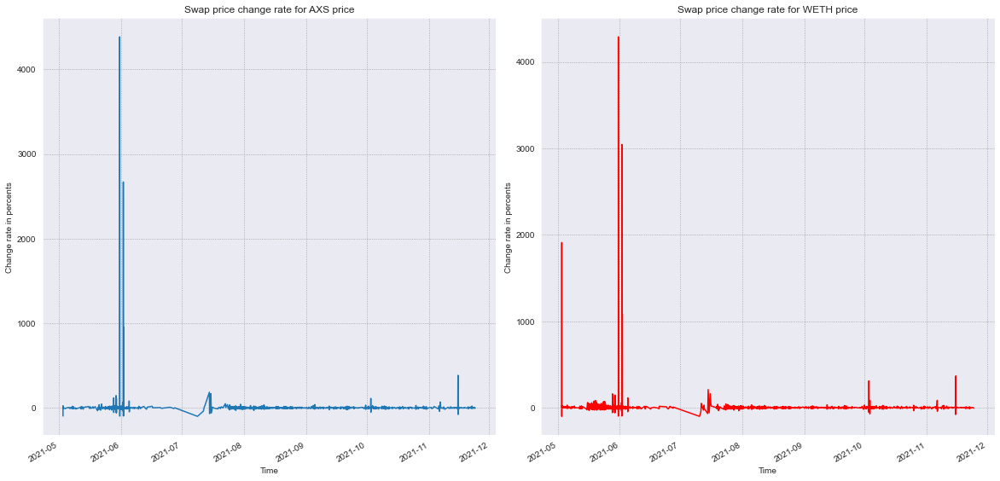

In [114]:
pyplot_line_swap_change_rate(axs_weth_v2_df[axs_weth_v2_df.price_change_rate < 8000], 'AXS', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


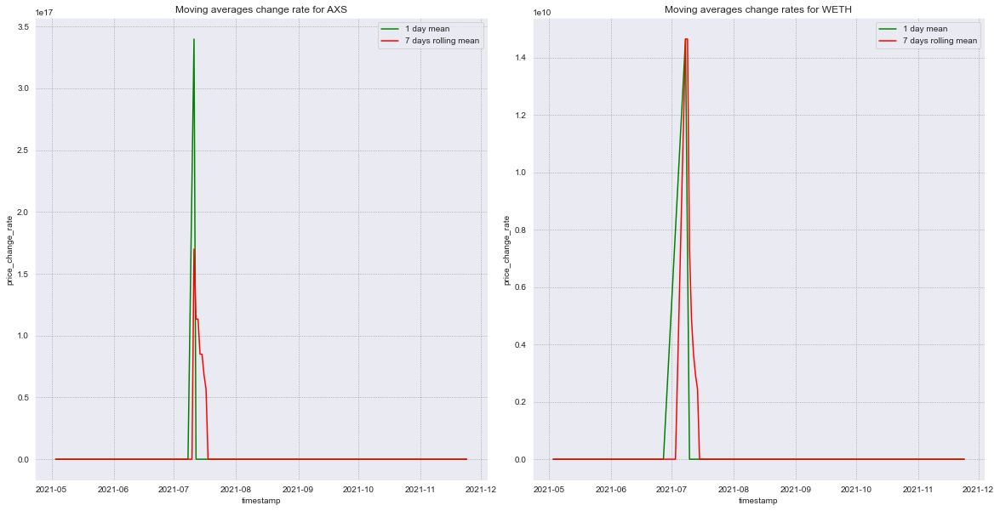

In [115]:
swaps_price_change_rates_moving_averages(axs_weth_v2_df, "AXS", "WETH", 
                                         'Moving averages change rate for AXS',
                                        'Moving averages change rates for WETH', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

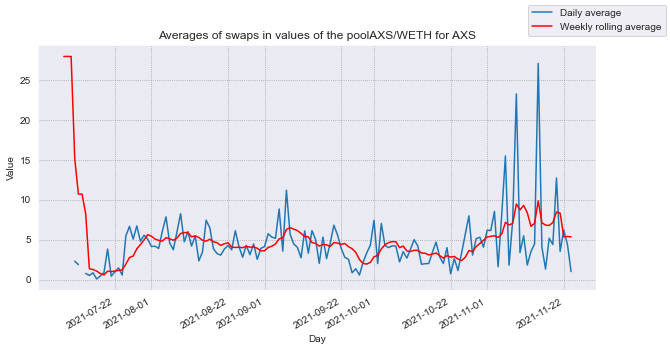

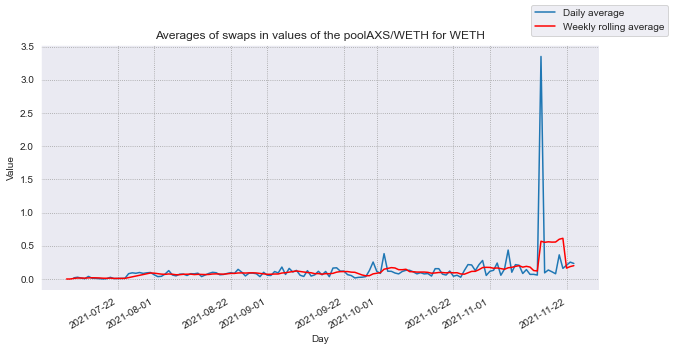

In [116]:
show_swaps_amount_in_moving_averages(swaps_df=axs_weth_v2_df[(axs_weth_v2_df.token_in == 'AXS') & 
                                                             (axs_weth_v2_df.timestamp > datetime(2021, 7, 1))], 
                                     pool_name="AXS/WETH for AXS")
show_swaps_amount_in_moving_averages(swaps_df=axs_weth_v2_df[(axs_weth_v2_df.token_in == 'WETH') & 
                                                             (axs_weth_v2_df.timestamp > datetime(2021, 7, 1))], 
                                     pool_name="AXS/WETH for WETH")

### Swaps values histograms

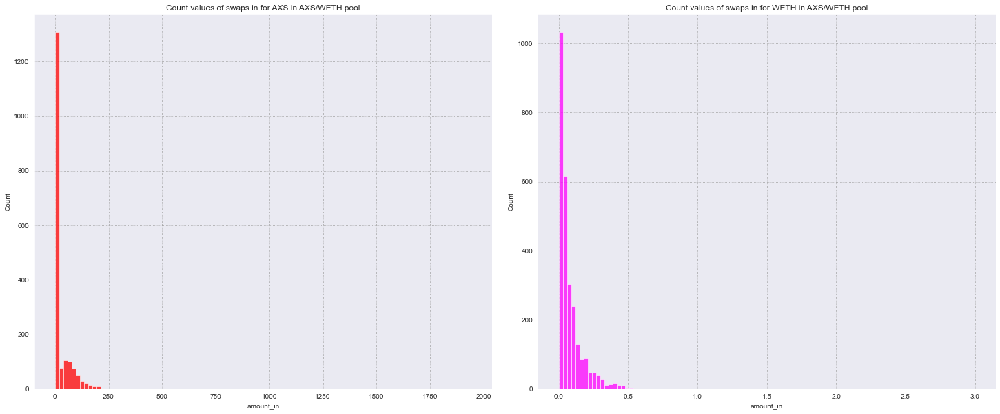

In [117]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=axs_weth_v2_df[axs_weth_v2_df.token_in == 'AXS'], x='amount_in', 
             bins=100, color='red').set_title("Count values of swaps in for AXS in AXS/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=axs_weth_v2_df[axs_weth_v2_df.token_in == 'WETH'], x='amount_in', 
             bins=100, color='magenta', binrange=[0, 3]).set_title("Count values of swaps in for WETH in AXS/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

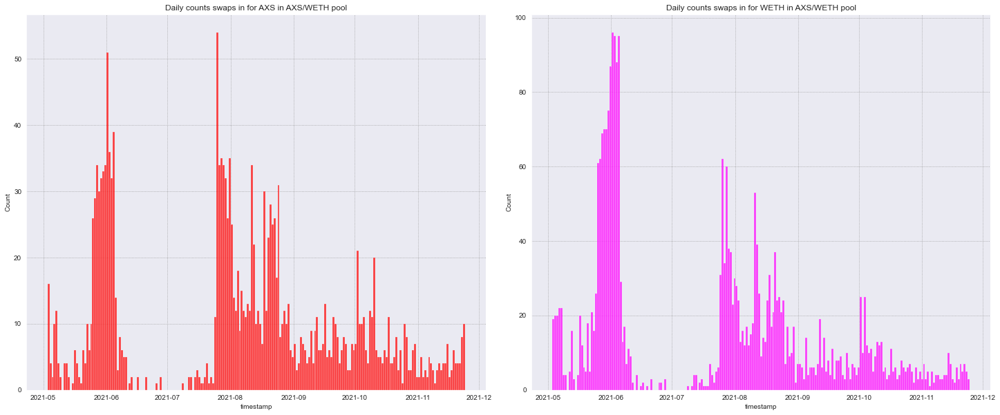

In [118]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=axs_weth_v2_df[axs_weth_v2_df.token_in == 'AXS'], x='timestamp', 
             bins=(axs_weth_v2_df.timestamp[len(axs_weth_v2_df) - 1] - axs_weth_v2_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for AXS in AXS/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=axs_weth_v2_df[axs_weth_v2_df.token_in == 'WETH'], x='timestamp', 
             bins=(axs_weth_v2_df.timestamp[len(axs_weth_v2_df) - 1] - axs_weth_v2_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in AXS/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

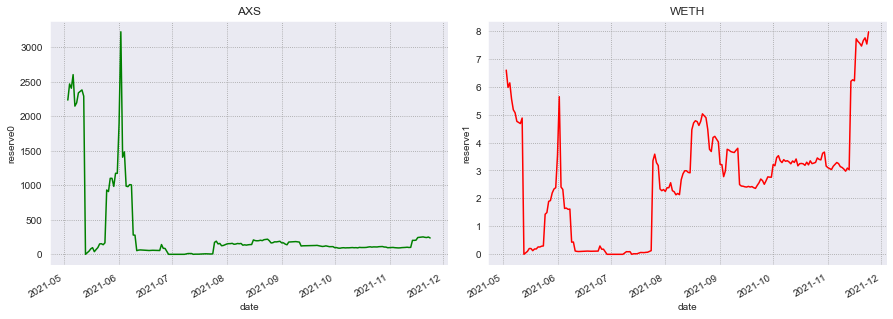

In [119]:
show_reserves_time_distribution(axs_weth_v2_reserves_df, first_token_reserve_name="AXS", second_token_reserve_name="WETH", x=15, wspace=0.1)

### Plotting pool price

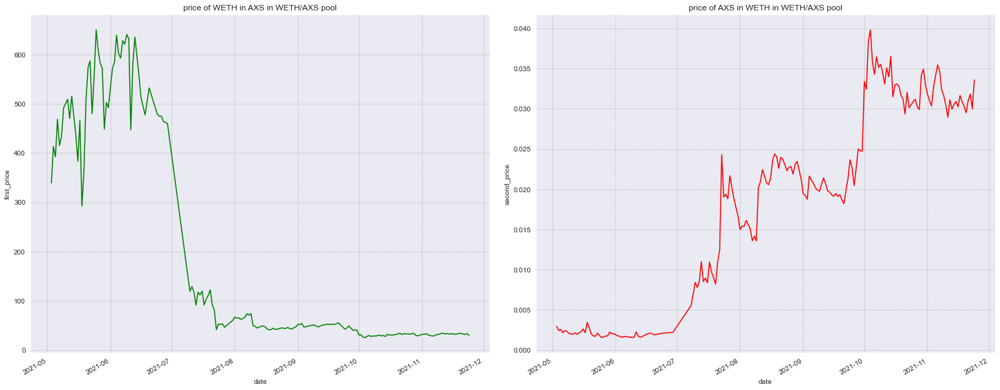

In [120]:
show_reserve_price_distributions(axs_weth_v2_reserves_df, first_token_price_name="price of WETH in AXS in WETH/AXS pool", 
                                        second_token_price_name="price of AXS in WETH in WETH/AXS pool", x=25, y=10, wspace=0.1)

In [121]:
axs_weth_v2_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,2235.318021,6.589013,43248.099360,5631.549029,412.261553,2021-05-03,339.249298,0.002948
1,2468.971504,5.971757,39933.495620,876.346517,2.191252,2021-05-04,413.441392,0.002419
2,2407.284859,6.133823,42093.892594,1233.886645,3.094878,2021-05-05,392.460751,0.002548
3,2603.981326,5.557229,38883.103492,1681.480184,4.037121,2021-05-06,468.575505,0.002134
4,2148.038360,5.171886,35978.200367,2004.968493,4.749660,2021-05-07,415.329783,0.002408
...,...,...,...,...,...,...,...,...
184,252.442218,7.452112,65834.588230,98.465778,3.006264,2021-11-20,33.875258,0.029520
185,246.162280,7.645403,66640.534300,34.488264,1.085657,2021-11-21,32.197422,0.031058
186,243.314960,7.744437,63016.184730,102.397294,3.219262,2021-11-22,31.418030,0.031829
187,250.674402,7.523598,65373.214397,72.124948,2.255345,2021-11-23,33.318423,0.030013


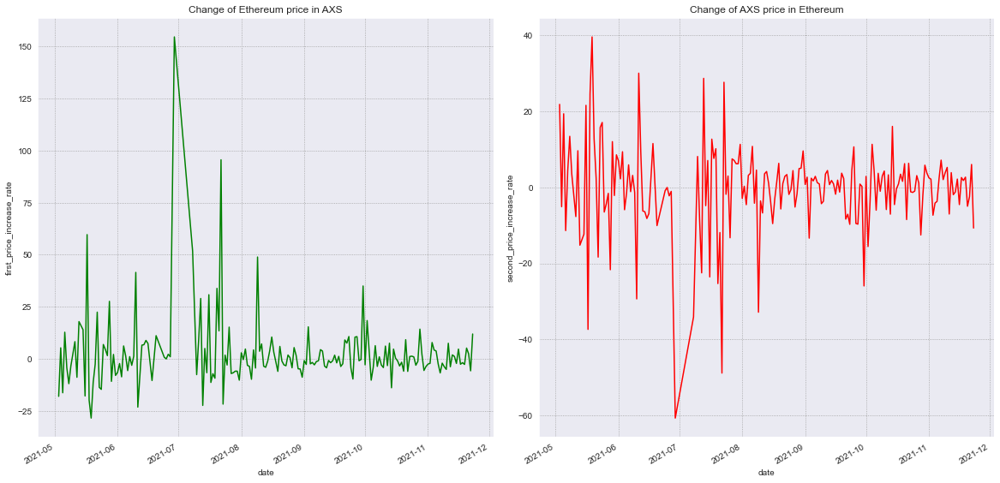

In [122]:
calc_price_and_increase_rates(axs_weth_v2_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=axs_weth_v2_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in AXS')
plt.subplot(1, 2, 2)
sns.lineplot(data=axs_weth_v2_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of AXS price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


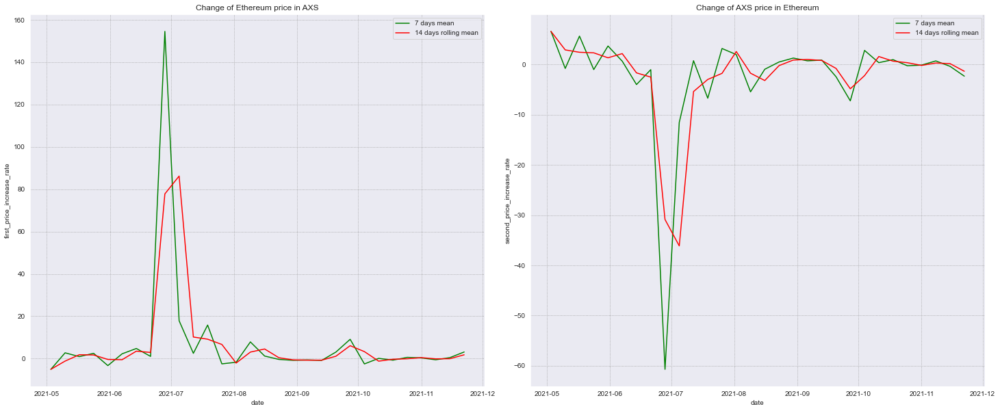

In [123]:
increase_rate_moving_averages(axs_weth_v2_reserves_df, 'Change of Ethereum price in AXS', 
                              'Change of AXS price in Ethereum', x_size=25, y_size=10)

## MANA/ETH

In [124]:
mana_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\mana_weth_swaps.pkl')
mana_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\mana_weth_mints.pkl")
mana_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\mana_weth_burns.pkl")
mana_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\mana_weth_reserves.pkl")

### Plotting swapping in moving averages

In [125]:
mana_weth_df = get_df_with_swap_prices_and_change_rates(mana_weth_df, 'MANA', 'WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [126]:
mana_weth_df[mana_weth_df.first_to_second_price == 0]
mana_weth_df[(mana_weth_df.timestamp > datetime(2021, 3, 13, 19)) & 
             (mana_weth_df.timestamp < datetime(2021, 3, 13, 19, 18))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
27045,MANA,WETH,4070.098023,2.196186,4191.201846,2021-03-13 19:00:04,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb342d4817ad2cf9694a807ef3eb83065aab1b047e910...,0.000540,-0.188056
27046,WETH,MANA,1.281184,2361.881811,2444.981244,2021-03-13 19:00:11,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x34b71fca26affe4fda257ee50744972efa741b54,0x06aabf4fac3494430705b74a97fca0a0642691617184...,1843.515258,-0.160347
27047,WETH,MANA,7.787365,14253.150237,14864.136799,2021-03-13 19:00:38,0x4d246be90c2f36730bb853ad41d0a189061192d3,0x4d246be90c2f36730bb853ad41d0a189061192d3,0xd041f430b49034a633ca56a232fece0230646d5fb217...,1830.291885,-0.717291
27048,WETH,MANA,18.381069,32956.038300,35095.294769,2021-03-13 19:01:15,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0087c5900b9bbc051b5f6299f5bce92383273b28,0xf8c91da8aab1972ae2935bb51aa0391397fdb5986ffc...,1792.933681,-2.041106
27049,MANA,WETH,1039.154105,0.584241,1115.572975,2021-03-13 19:01:36,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0d4a11d5eeaac28ec3f61d100daf4d40471f1852,0x89cb769ba5b773d36274280516a7e1663f8f15c0b1fc...,0.000562,4.195313
27050,MANA,WETH,7547.137191,4.227248,8071.617107,2021-03-13 19:01:36,0x3700006fbcde59a8b3af2c134d00e9530000e379,0x3700006fbcde59a8b3af2c134d00e9530000e379,0xfcdfbd372681bcb920ed5da1e02afe069a15f9352bfe...,0.000560,-0.376204
27051,WETH,MANA,10.408995,18384.181149,19854.867006,2021-03-13 19:02:47,0x4d246be90c2f36730bb853ad41d0a189061192d3,0x4d246be90c2f36730bb853ad41d0a189061192d3,0x0710bf5dedc5df05a8802a78b9b744127255357a83d9...,1766.182148,-1.492054
27052,MANA,WETH,320.131172,0.181616,346.454202,2021-03-13 19:03:31,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x95ca404f624fde4b516a8cf6724f22b2489d7f5f0553...,0.000567,1.286188
27053,WETH,MANA,5.530511,9650.097548,10550.226493,2021-03-13 19:03:31,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xdd46e179320c6c753833102f7f266742787a20c8,0xc31a4658328538e1b2b89c6357ac3c1e789345668d83...,1744.883480,-1.205916
27054,WETH,MANA,10.422160,17962.863728,19881.733437,2021-03-13 19:03:47,0x4d246be90c2f36730bb853ad41d0a189061192d3,0x4d246be90c2f36730bb853ad41d0a189061192d3,0x1c49b0acaedbfed86845be6dc38f3bf42da73922df12...,1723.525999,-1.224006


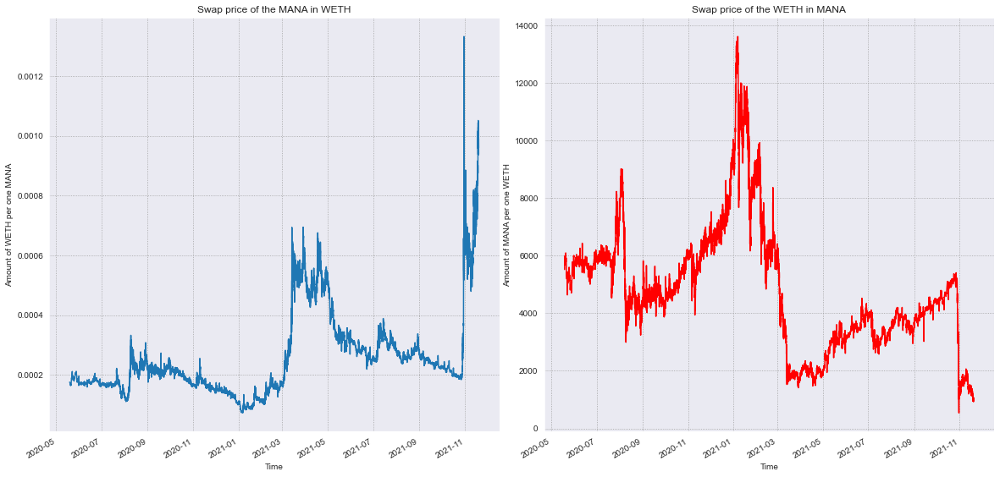

In [127]:
pyplot_line_swap_prices(mana_weth_df, 'MANA', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

In [128]:
mana_weth_df[mana_weth_df.price_change_rate > 100]
mana_weth_df[(mana_weth_df.timestamp > datetime(2021, 10, 31, 1, 5)) & 
             (mana_weth_df.timestamp < datetime(2021, 10, 31, 1, 25))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
65392,WETH,MANA,1.223910,1457.096466,5.364866e+03,2021-10-31 01:05:29,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xac9917d3c0b7472f9d5e5f24e2fc252991a69872,0x7f8ec1e12b04fbf0463793e09e74aa0cd6753a911e0e...,1190.526022,1.190319
65393,MANA,WETH,8600.991602,7.138024,3.129000e+04,2021-10-31 01:06:23,0xdd56a5c540c68fc348dfa04ae6bc51bd301363a4,0xdd56a5c540c68fc348dfa04ae6bc51bd301363a4,0xbb50fef610783cdcf9440d3d940c01f0a13f1eb9990f...,0.000830,-1.261848
65394,WETH,MANA,4.477278,5377.328308,1.962673e+04,2021-10-31 01:07:04,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xaf8613cc03d0b022dbacc942592a70a26739102a,0x8aab7095639a988b3c6b863aa81d23b45eda9c3ba221...,1201.026154,0.881974
65395,MANA,WETH,4806.475687,3.980024,1.744771e+04,2021-10-31 01:07:58,0xdd56a5c540c68fc348dfa04ae6bc51bd301363a4,0xdd56a5c540c68fc348dfa04ae6bc51bd301363a4,0x043675b1acc18c5e058fb5a60129de70708ec180bf98...,0.000828,-0.223228
65396,WETH,MANA,5.193374,6226.678526,2.276202e+04,2021-10-31 01:08:20,0xa57bd00134b2850b2a1c55860c9e9ea100fdd6cf,0x56178a0d5f301baf6cf3e1cd53d9863437345bf9,0xaf4f18f727013471b6244d451b3f6e0146d562d25ba6...,1198.965903,-0.171541
65397,WETH,MANA,0.100000,119.250622,4.381002e+02,2021-10-31 01:08:50,0x11111112542d85b3ef69ae05771c2dccff4faa26,0xa49af6c6d9279857e0c72d362783d4d5cab454c6,0x596c2c43147c660e13975bdd2ff8b20399cd0829281c...,1192.506224,-0.538771
65398,WETH,MANA,6.923298,8197.639400,3.033553e+04,2021-10-31 01:09:23,0xa57bd00134b2850b2a1c55860c9e9ea100fdd6cf,0x56178a0d5f301baf6cf3e1cd53d9863437345bf9,0x15f5c22ab3b0c5e5ee723ceb4882e356cf5e6dfc681c...,1184.065671,-0.707799
65399,MANA,WETH,3873.976742,3.264270,1.430342e+04,2021-10-31 01:09:40,0x67172edd6fea4857da43c1a9621e51f38548d4a9,0x67172edd6fea4857da43c1a9621e51f38548d4a9,0x468e14d66c378a9e5d297db56989eb1165f0f7e78375...,0.000843,1.758364
65400,WETH,MANA,6.113821,7191.794861,2.678768e+04,2021-10-31 01:09:57,0xa57bd00134b2850b2a1c55860c9e9ea100fdd6cf,0x56178a0d5f301baf6cf3e1cd53d9863437345bf9,0xf15ca3011b7c1f55787b773df2ce454523e92311ef36...,1176.317534,-0.654367
65401,WETH,MANA,0.413125,482.770920,1.811068e+03,2021-10-31 01:10:37,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x7a0fc55a5d23cd604dfee8384c443a9fb0a51d0f,0xe75944b6392e1c1320e47fb7b8b60e663be3ec010c13...,1168.584160,-0.657422


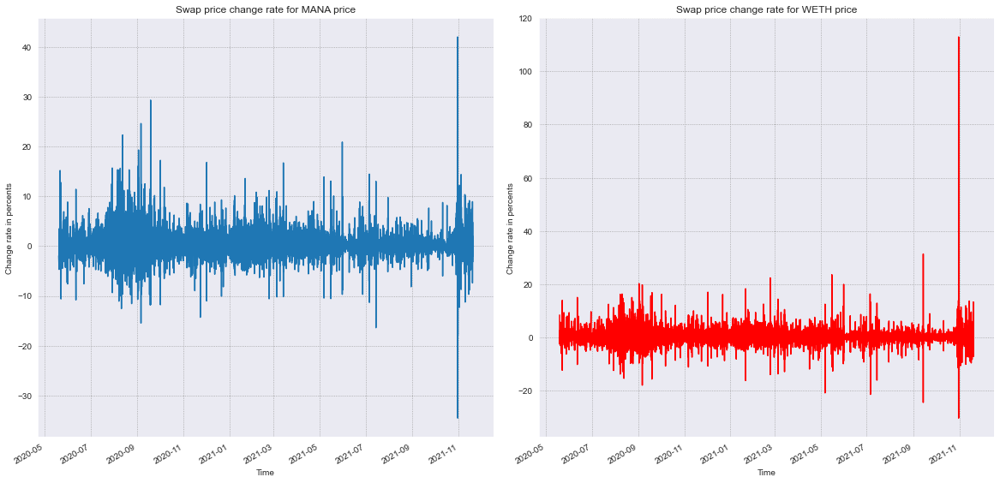

In [129]:
pyplot_line_swap_change_rate(mana_weth_df, 'MANA', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


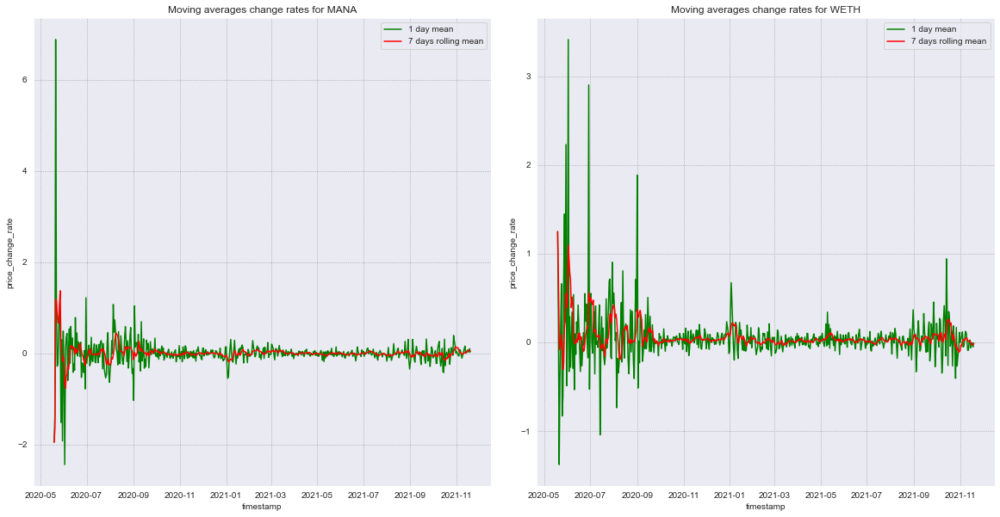

In [130]:
swaps_price_change_rates_moving_averages(mana_weth_df, 'MANA', 'WETH', 'Moving averages change rates for MANA', 
                                           'Moving averages change rates for WETH', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

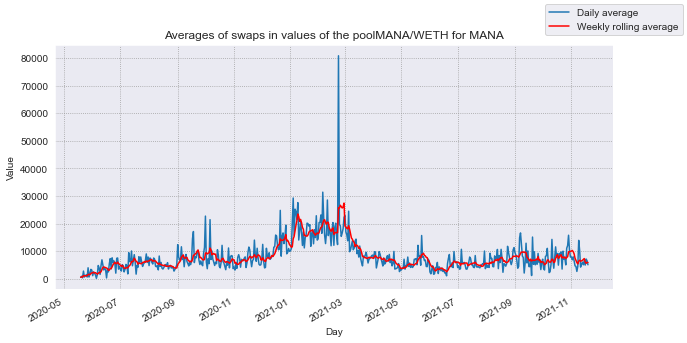

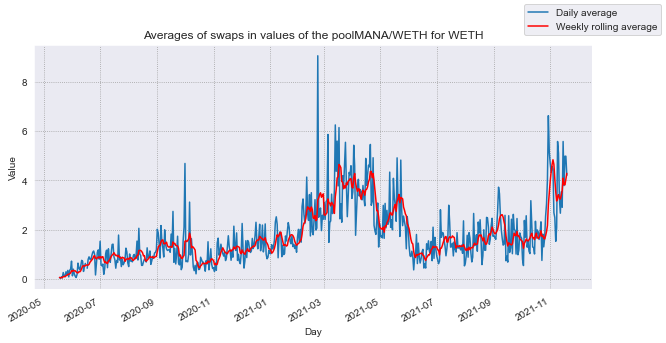

In [131]:
show_swaps_amount_in_moving_averages(swaps_df=mana_weth_df[(mana_weth_df.token_in == 'MANA')], pool_name="MANA/WETH for MANA")
show_swaps_amount_in_moving_averages(swaps_df=mana_weth_df[(mana_weth_df.token_in == 'WETH')], pool_name="MANA/WETH for WETH")

### Swaps values histograms

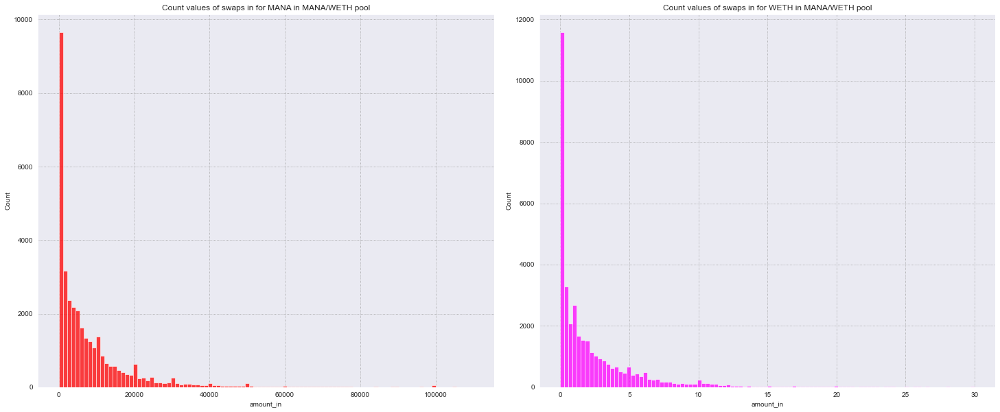

In [132]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=mana_weth_df[mana_weth_df.token_in == 'MANA'], x='amount_in', bins=100, 
             color='red', binrange=[0, 110000]).set_title("Count values of swaps in for MANA in MANA/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=mana_weth_df[mana_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta', binrange=[0, 30]).set_title("Count values of swaps in for WETH in MANA/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

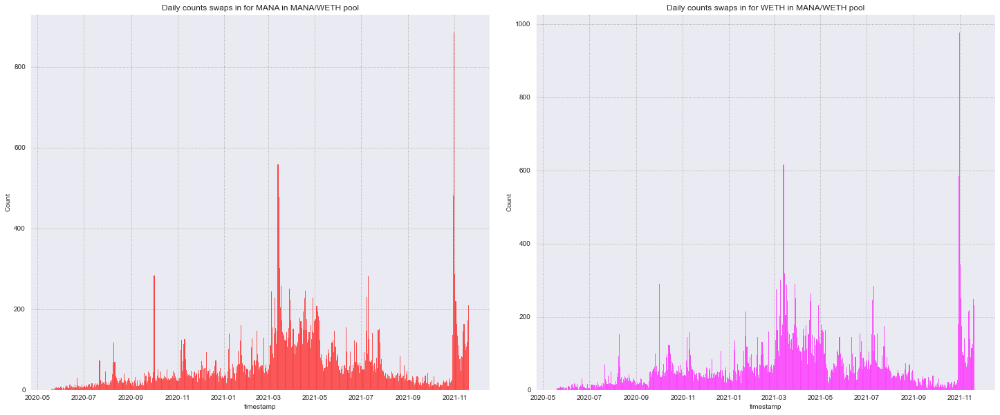

In [133]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=mana_weth_df[mana_weth_df.token_in == 'MANA'], x='timestamp', 
             bins=(mana_weth_df.timestamp[len(mana_weth_df) - 1] - mana_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for MANA in MANA/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=mana_weth_df[mana_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(mana_weth_df.timestamp[len(mana_weth_df) - 1] - mana_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in MANA/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

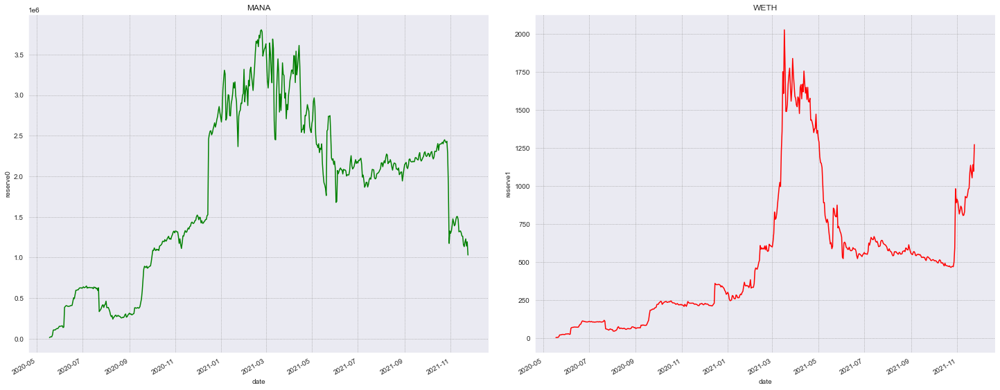

In [134]:
show_reserves_time_distribution(mana_weth_reserves_df, first_token_reserve_name="MANA", second_token_reserve_name="WETH", x=25, y=10, wspace=0.1)

### Plotting pool price

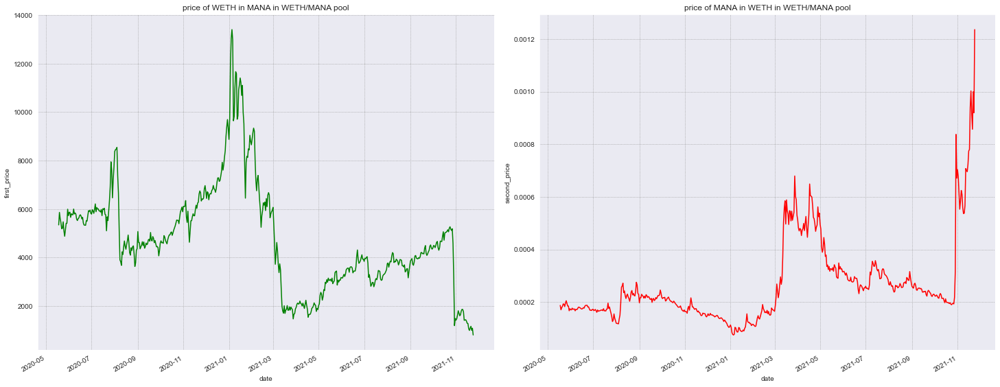

In [135]:
show_reserve_price_distributions(mana_weth_reserves_df, first_token_price_name="price of WETH in MANA in WETH/MANA pool", 
                                        second_token_price_name="price of MANA in WETH in WETH/MANA pool", x=25, y=10, wspace=0.1)

In [136]:
mana_weth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,1.313154e+04,2.455654,5.260017e+02,2.759552e+02,0.050000,2020-05-18,5347.470266,0.000187
1,1.995563e+04,3.402474,1.456969e+03,1.545187e+03,0.268593,2020-05-19,5865.036543,0.000171
2,2.320825e+04,4.142890,1.747858e+03,5.835603e+03,0.971594,2020-05-20,5601.946650,0.000179
3,2.287628e+04,4.203910,1.674104e+03,1.630945e+03,0.304859,2020-05-21,5441.667354,0.000184
4,4.713547e+04,9.083270,3.766017e+03,1.150966e+04,2.419877,2020-05-22,5189.261607,0.000193
...,...,...,...,...,...,...,...,...
551,1.189052e+06,1088.299840,9.585300e+06,5.698641e+05,534.498749,2021-11-20,1092.577853,0.000915
552,1.229540e+06,1053.815068,9.111223e+06,5.257195e+05,455.045753,2021-11-21,1166.751285,0.000857
553,1.140786e+06,1140.525657,9.348950e+06,7.929923e+05,760.154427,2021-11-22,1000.228279,0.001000
554,1.192215e+06,1096.862512,9.517764e+06,1.086525e+06,1066.868370,2021-11-23,1086.931911,0.000920


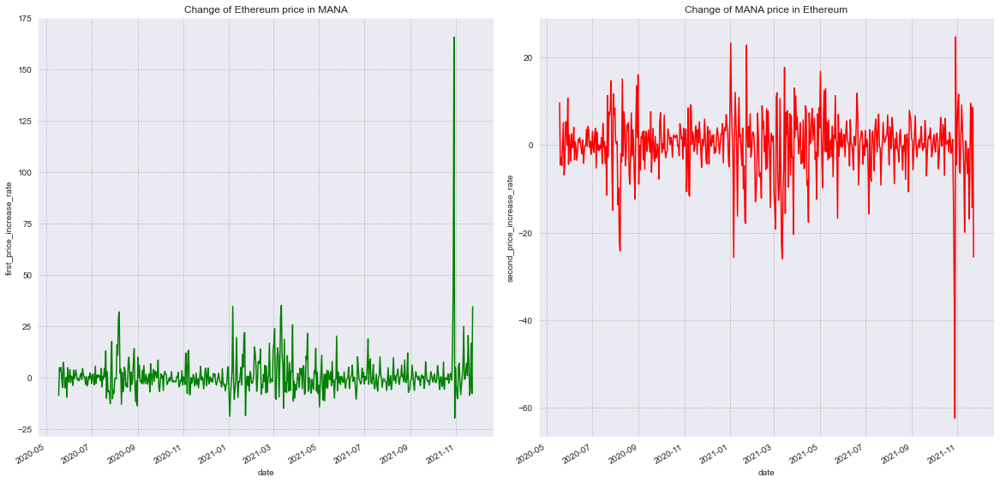

In [137]:
calc_price_and_increase_rates(mana_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=mana_weth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in MANA')
plt.subplot(1, 2, 2)
sns.lineplot(data=mana_weth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of MANA price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


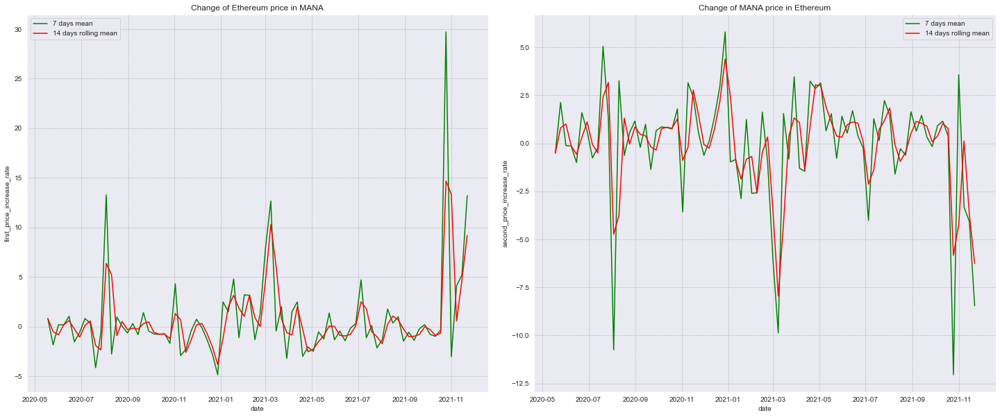

In [138]:
increase_rate_moving_averages(mana_weth_reserves_df, 'Change of Ethereum price in MANA', 
                              'Change of MANA price in Ethereum', x_size=25, y_size=10)

## ENJ/ETH

In [139]:
enj_eth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\enj_eth_swaps.pkl')
enj_eth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\enj_eth_mints.pkl")
enj_eth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\enj_eth_burns.pkl")
enj_eth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\enj_eth_reserves.pkl")

### Plotting swapping in moving averages

In [140]:
enj_eth_df = get_df_with_swap_prices_and_change_rates(enj_eth_df, 'ENJ', 'WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


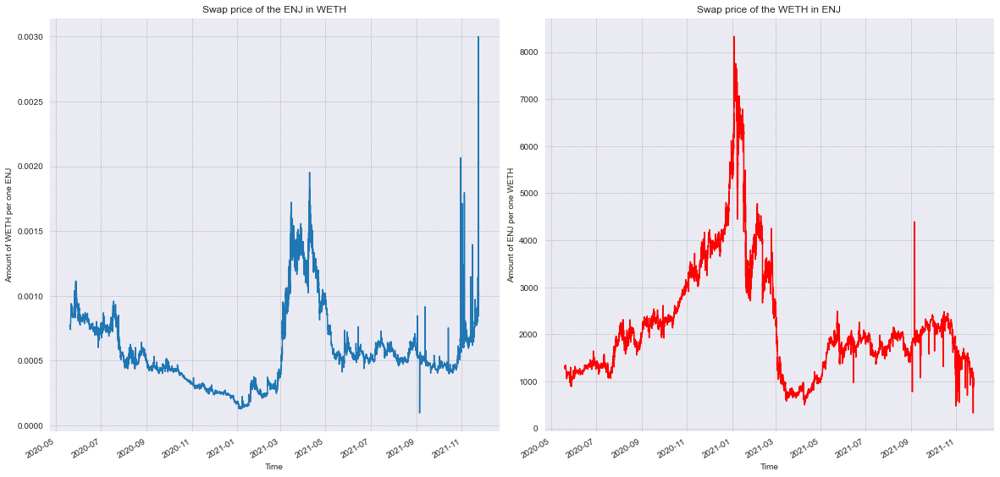

In [141]:
pyplot_line_swap_prices(enj_eth_df, 'ENJ', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

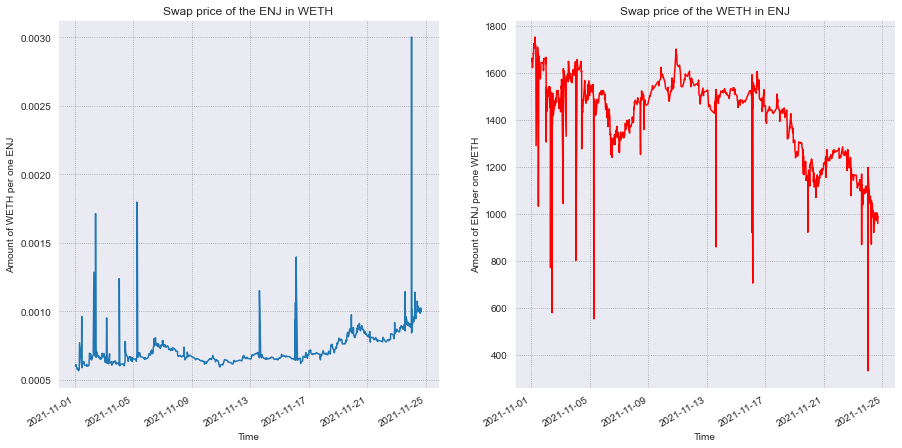

In [142]:
pyplot_line_swap_prices(enj_eth_df[enj_eth_df.timestamp > datetime(2021, 11, 1)], 'ENJ', 'WETH', xsize=15, ysize=7.5, 
                        wspace=0.2, hspace=0.1)

In [143]:
enj_eth_df[enj_eth_df.price_change_rate > 100]
# enj_eth_df[(enj_eth_df.timestamp > datetime(2021, 9, 5, 15, 0)) & (enj_eth_df.timestamp < datetime(2021, 9, 5, 20, 30))]
enj_eth_df[(enj_eth_df.timestamp > datetime(2021, 10, 31, 8, 0)) & 
           (enj_eth_df.timestamp < datetime(2021, 10, 31, 10, 0))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
72781,ENJ,WETH,4223.478413,2.765395,1.193130e+04,2021-10-31 08:09:56,0xa57bd00134b2850b2a1c55860c9e9ea100fdd6cf,0x56178a0d5f301baf6cf3e1cd53d9863437345bf9,0x48c4b02066a5cb87c7f137c36ba9a3212673231b3f14...,0.000655,-1.918353
72782,WETH,ENJ,0.198250,305.217692,8.492489e+02,2021-10-31 08:44:51,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x74de5d4fcbf63e00296fd95d33236b9794016631,0x2196a3365ab4c7f8c8b1ffb05284631b7b5dcf30b027...,1539.559608,5.799831
72783,WETH,ENJ,0.320000,491.263774,1.370114e+03,2021-10-31 08:55:39,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x5a827ee07806fa5cb4536958cb1d361ef7f20b79,0x59baaa98aa839fec95c0697d57cffb73a0f641ae7315...,1535.199294,-0.283218
72784,WETH,ENJ,406.412201,193519.686440,1.734995e+06,2021-10-31 09:23:04,0x00000000003b3cc22af3ae1eac0440bcee416b40,0xe16be1798f860bc1eb0feb64cd67ca00ae9b6e58,0x86342987eaf88eb19a589e8f75612d108bc44948547c...,476.166035,-68.983438
72785,ENJ,WETH,197625.424650,408.295164,1.743033e+06,2021-10-31 09:23:04,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x00000000003b3cc22af3ae1eac0440bcee416b40,0xe8cb1a4fc8844c56d09ab0f79ed5f9fa0ee56aa6834e...,0.002066,215.532801
72786,ENJ,WETH,3782.493673,2.361826,1.006688e+04,2021-10-31 09:43:28,0x67172edd6fea4857da43c1a9621e51f38548d4a9,0x67172edd6fea4857da43c1a9621e51f38548d4a9,0xd0ef80609ed3399f77eb2aaa85fe7a5575a3573b40aa...,0.000624,-69.776951
72787,WETH,ENJ,1.741229,2781.632271,7.424980e+03,2021-10-31 09:45:57,0x911605012f87a3017322c81fcb4c90ada7c09116,0x911605012f87a3017322c81fcb4c90ada7c09116,0xbcd5d14c5b1854b3e36d5a3f3ad44240a4ab665d892b...,1597.510990,235.494528
72788,WETH,ENJ,0.898985,1415.216577,3.830516e+03,2021-10-31 09:52:26,0xec001d0000004536cad29291f4000000d029abb2,0xec001d0000004536cad29291f4000000d029abb2,0x825485b44f6eefcb96471136dfcc15ccba41902902f3...,1574.237437,-1.456863
72789,WETH,ENJ,0.247812,387.649542,1.055465e+03,2021-10-31 09:53:16,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x74de5d4fcbf63e00296fd95d33236b9794016631,0xebd4e9e1c7df3ecb66a10a134f5a87fd4b6a7743c564...,1564.285667,-0.632164


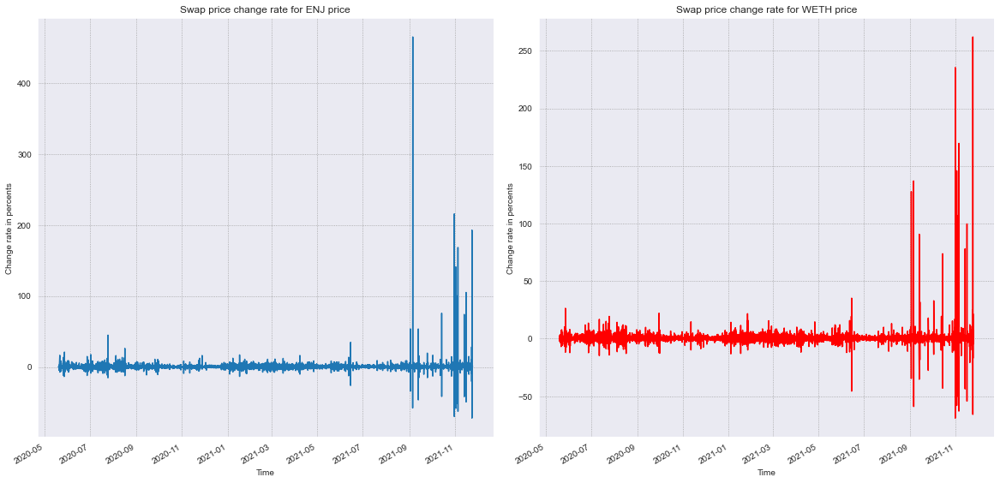

In [144]:
pyplot_line_swap_change_rate(enj_eth_df, 'ENJ', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


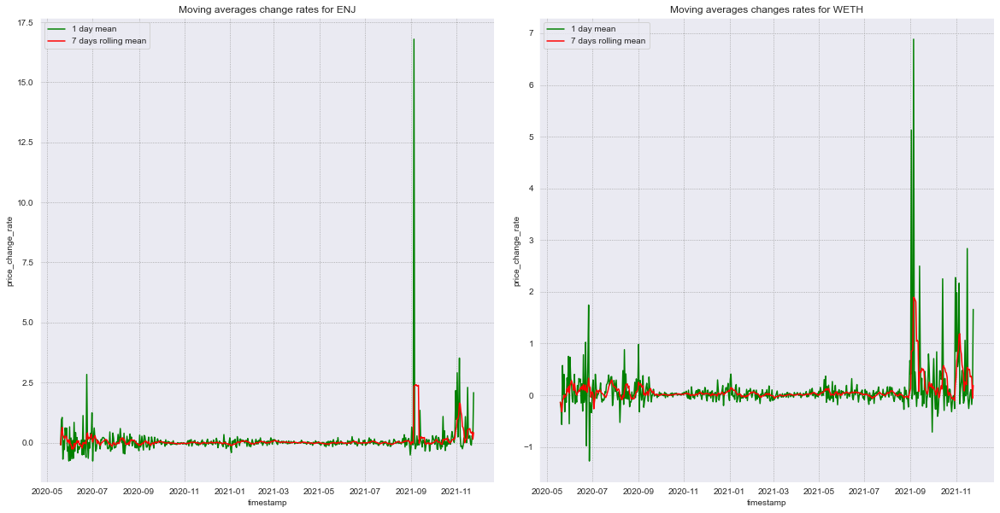

In [145]:
swaps_price_change_rates_moving_averages(enj_eth_df, 'ENJ', 'WETH', 'Moving averages change rates for ENJ',
                                           'Moving averages changes rates for WETH', x_size=20, y_size=10,
                                           wspace=0.1, hspace=0.1)

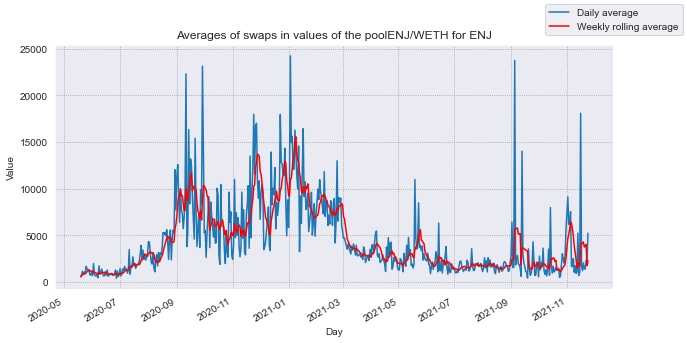

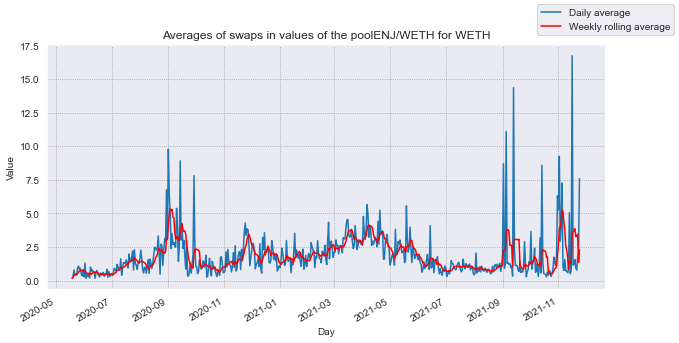

In [146]:
show_swaps_amount_in_moving_averages(swaps_df=enj_eth_df[(enj_eth_df.token_in == 'ENJ')], pool_name="ENJ/WETH for ENJ")
show_swaps_amount_in_moving_averages(swaps_df=enj_eth_df[(enj_eth_df.token_in == 'WETH')], pool_name="ENJ/WETH for WETH")

### Swaps values histograms

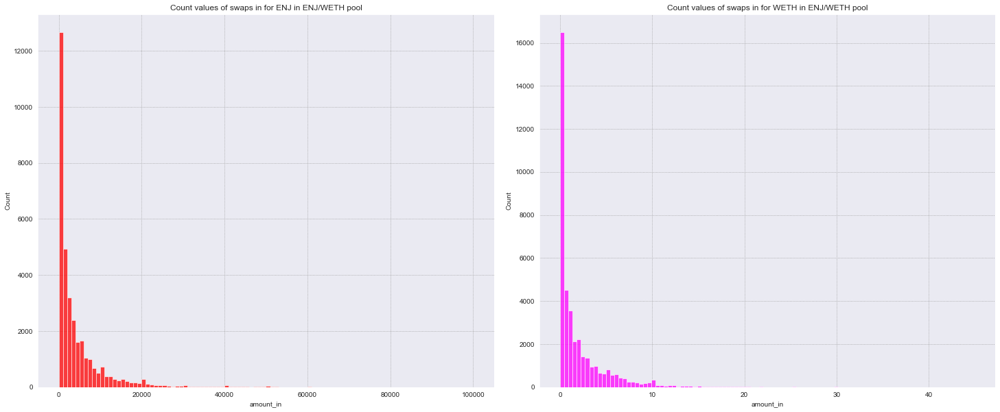

In [147]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=enj_eth_df[enj_eth_df.token_in == 'ENJ'], x='amount_in', bins=100, 
             color='red', binrange=[0, 100000]).set_title("Count values of swaps in for ENJ in ENJ/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=enj_eth_df[enj_eth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta', binrange=[0, 45]).set_title("Count values of swaps in for WETH in ENJ/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

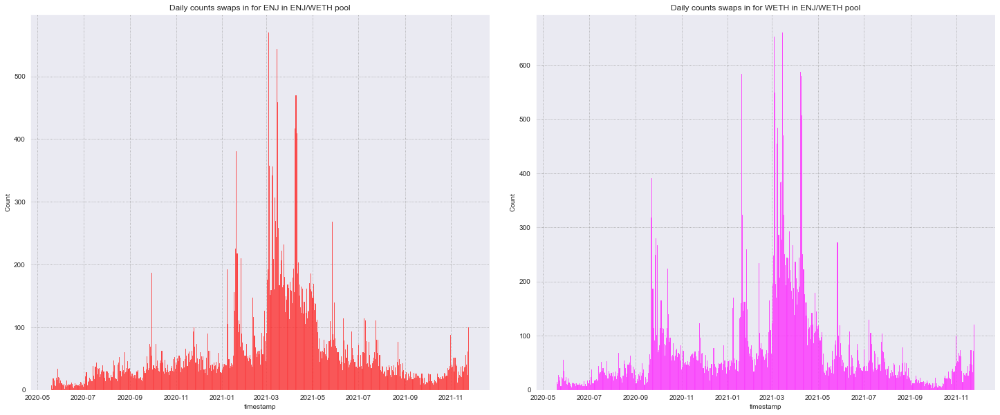

In [148]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=enj_eth_df[enj_eth_df.token_in == 'ENJ'], x='timestamp', 
             bins=(enj_eth_df.timestamp[len(enj_eth_df) - 1] - enj_eth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for ENJ in ENJ/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=enj_eth_df[enj_eth_df.token_in == 'WETH'], x='timestamp', 
             bins=(enj_eth_df.timestamp[len(enj_eth_df) - 1] - enj_eth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in ENJ/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

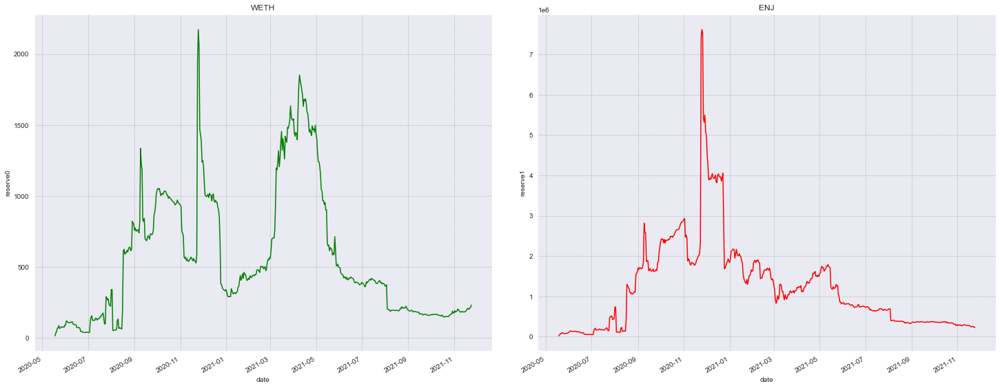

In [149]:
show_reserves_time_distribution(enj_eth_reserves_df, first_token_reserve_name="WETH", second_token_reserve_name="ENJ", x=25, y=10, wspace=0.1)

### Plotting pool price

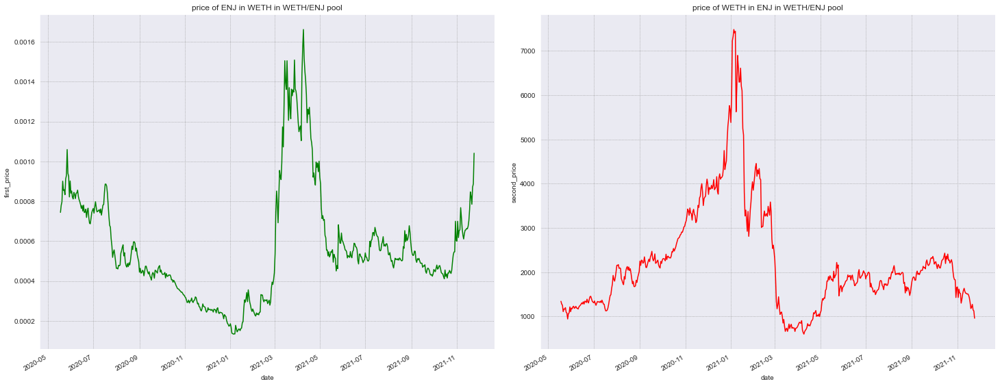

In [150]:
show_reserve_price_distributions(enj_eth_reserves_df, first_token_price_name="price of ENJ in WETH in WETH/ENJ pool", 
                                        second_token_price_name="price of WETH in ENJ in WETH/ENJ pool", x=25, y=10, wspace=0.1)

In [151]:
enj_eth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,14.596187,19609.896031,6.256915e+03,0.000000,0.000000,2020-05-18,0.000744,1343.494443
1,35.608058,45643.923958,1.503812e+04,4.334663,5636.075761,2020-05-19,0.000780,1281.842554
2,44.083044,55306.165361,1.852330e+04,6.154577,8060.401355,2020-05-20,0.000797,1254.590445
3,68.513132,76046.446474,2.728367e+04,39.970996,43953.282808,2020-05-21,0.000901,1109.954323
4,70.230793,82183.521342,2.917812e+04,15.703982,18107.270743,2020-05-22,0.000855,1170.192137
...,...,...,...,...,...,...,...,...
551,205.914460,249497.845790,1.813307e+06,126.858768,146488.397744,2021-11-20,0.000825,1211.657726
552,200.857905,255877.179741,1.749590e+06,75.037519,91391.167819,2021-11-21,0.000785,1273.921383
553,211.835049,243126.646149,1.737964e+06,149.054250,175787.658989,2021-11-22,0.000871,1147.716807
554,214.183717,241353.778074,1.860132e+06,290.795102,295654.897573,2021-11-23,0.000887,1126.854002


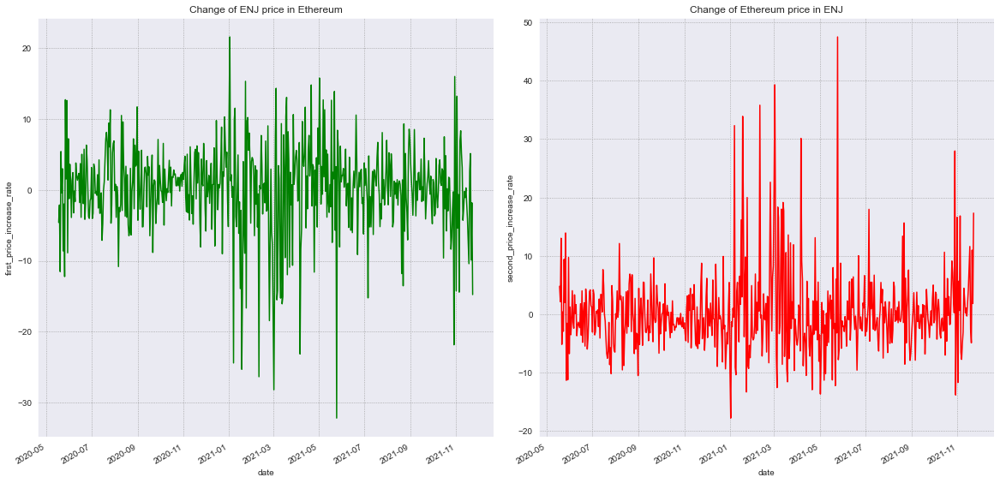

In [152]:
calc_price_and_increase_rates(enj_eth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=enj_eth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of ENJ price in Ethereum')
plt.subplot(1, 2, 2)
sns.lineplot(data=enj_eth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of Ethereum price in ENJ')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


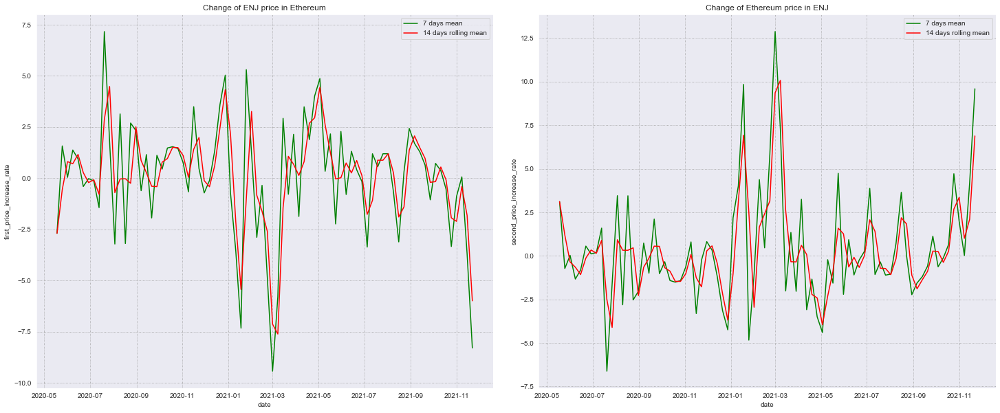

In [153]:
increase_rate_moving_averages(enj_eth_reserves_df, 'Change of ENJ price in Ethereum', 'Change of Ethereum price in ENJ', x_size=25, y_size=10)

## SAND/WETH

In [154]:
sand_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\sand_weth_swaps.pkl')
sand_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\sand_weth_mints.pkl")
sand_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\sand_weth_burns.pkl")
sand_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\sand_weth_reserves.pkl")

### Plotting swapping in moving averages

In [155]:
sand_weth_df = get_df_with_swap_prices_and_change_rates(sand_weth_df, 'SAND', 'WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


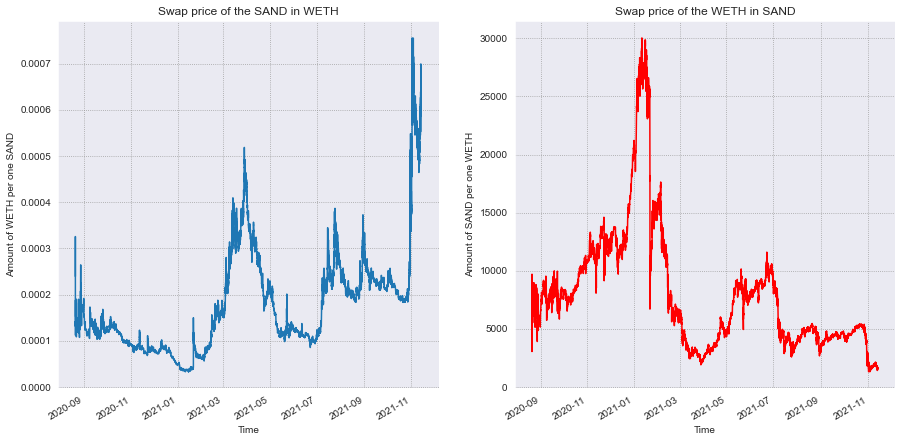

In [156]:
pyplot_line_swap_prices(sand_weth_df, 'SAND', 'WETH', xsize=15, ysize=7.5, wspace=0.2, hspace=0.1)

In [157]:
# sand_weth_df[sand_weth_df.first_to_second_price == 0]
sand_weth_df[(sand_weth_df.timestamp > datetime(2021, 10, 31, 1, 10)) & 
             (sand_weth_df.timestamp < datetime(2021, 10, 31, 1, 18))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
117498,WETH,SAND,2.700287,5178.375269,11832.059300,2021-10-31 01:10:19,0xb2bbfd73971279a457514325f209eb63a0341ef2,0x5b97b125cf8af96834f2d08c8f1291bd47724939,0xdae491c8d6e073930562fc8584b2bb2f048ea12771eb...,1917.712864,2.934607
117499,WETH,SAND,22.643621,43155.494032,99265.781694,2021-10-31 01:10:28,0x4d246be90c2f36730bb853ad41d0a189061192d3,0x4d246be90c2f36730bb853ad41d0a189061192d3,0x492e5efdec34ba61b62bb0a0e0f67bb21596e397c45b...,1905.856578,-0.618251
117500,SAND,WETH,2094.866455,1.098376,4815.092901,2021-10-31 01:10:28,0x83884ec924d43b6c6d1c52d7b6a57ce4121a4a53,0x83884ec924d43b6c6d1c52d7b6a57ce4121a4a53,0x6f41120ed7085764e9f55fd7f2770952845a208ffade...,0.000524,-0.949795
117501,WETH,SAND,1.880000,3563.456345,8241.600121,2021-10-31 01:10:28,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x4df7111dbb1cd99dddac669945da1e9b7aace9f5,0x7308f3388367a03c652ddc94c07d14d7084ea4906665...,1895.455503,-0.545743
117502,SAND,WETH,25000.002277,13.074511,57316.433696,2021-10-31 01:10:37,0xa57bd00134b2850b2a1c55860c9e9ea100fdd6cf,0x56178a0d5f301baf6cf3e1cd53d9863437345bf9,0x96fba7e9499cc6b4f5d660727009b0c1d16c1ce0d6fc...,0.000523,-0.255081
117503,SAND,WETH,1990.123273,1.037190,4546.866459,2021-10-31 01:10:37,0x83884ec924d43b6c6d1c52d7b6a57ce4121a4a53,0x83884ec924d43b6c6d1c52d7b6a57ce4121a4a53,0xbc141609b0710f5da4f70b972a62b27312039dfa3536...,0.000521,-0.346373
117504,WETH,SAND,1.626885,3068.409774,7132.541043,2021-10-31 01:11:04,0xa57bd00134b2850b2a1c55860c9e9ea100fdd6cf,0x56178a0d5f301baf6cf3e1cd53d9863437345bf9,0x98e21eced850d66de6423c837159c77b51d6a64527b4...,1886.064141,-0.495467
117505,WETH,SAND,12.000000,22557.883510,52610.039293,2021-10-31 01:11:04,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x876cdd95f952e97da1bdcfd5bafa97a9cfef95d7,0xdc8e7290c3dc78e40e658cb289f617ef95ba954e785f...,1879.823626,-0.330875
117506,WETH,SAND,22.568046,42817.679177,98942.148901,2021-10-31 01:11:04,0x4d246be90c2f36730bb853ad41d0a189061192d3,0x4d246be90c2f36730bb853ad41d0a189061192d3,0xf10dfcb3af1a2fc51c9bb0a1e02dc3bcc08ebe82c50c...,1897.270113,0.928092
117507,WETH,SAND,5.609624,10500.000000,24597.428130,2021-10-31 01:11:14,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xdb51082a56cc7656a80e90888ee794509e2b7273,0xf3836722015ebf6fd1c193afbbf2f2b7a82963b00018...,1871.783303,-1.343341


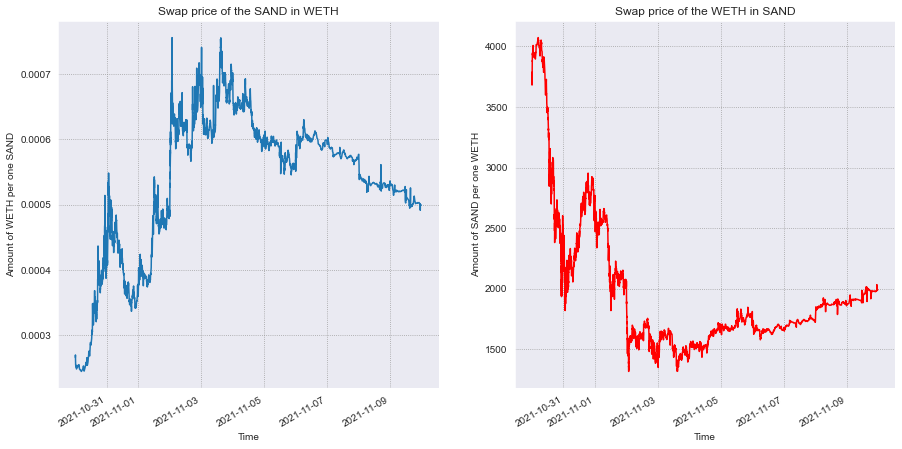

In [158]:
pyplot_line_swap_prices(sand_weth_df[(sand_weth_df.timestamp > datetime(2021, 10, 30)) & 
                                     (sand_weth_df.timestamp < datetime(2021, 11, 10))], 
                        'SAND', 'WETH', xsize=15, ysize=7.5, wspace=0.2, hspace=0.1)

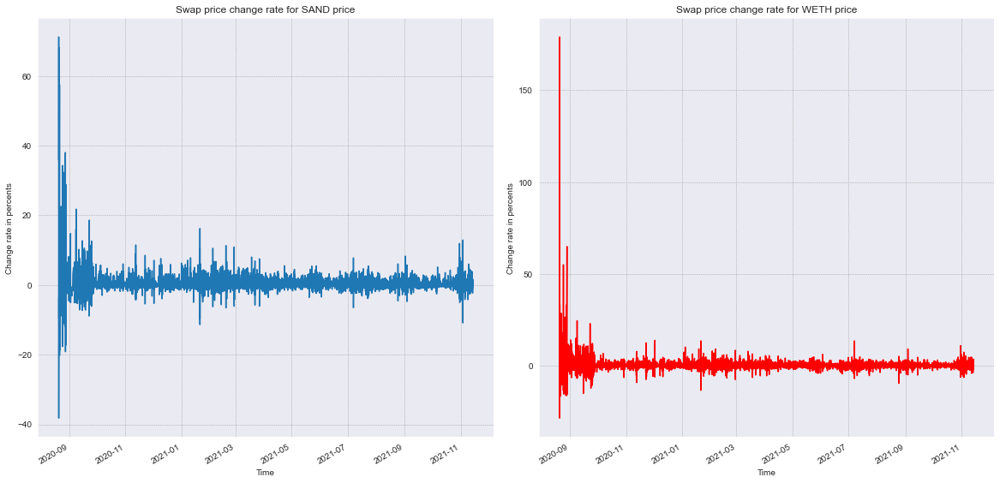

In [159]:
pyplot_line_swap_change_rate(sand_weth_df, 'SAND', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


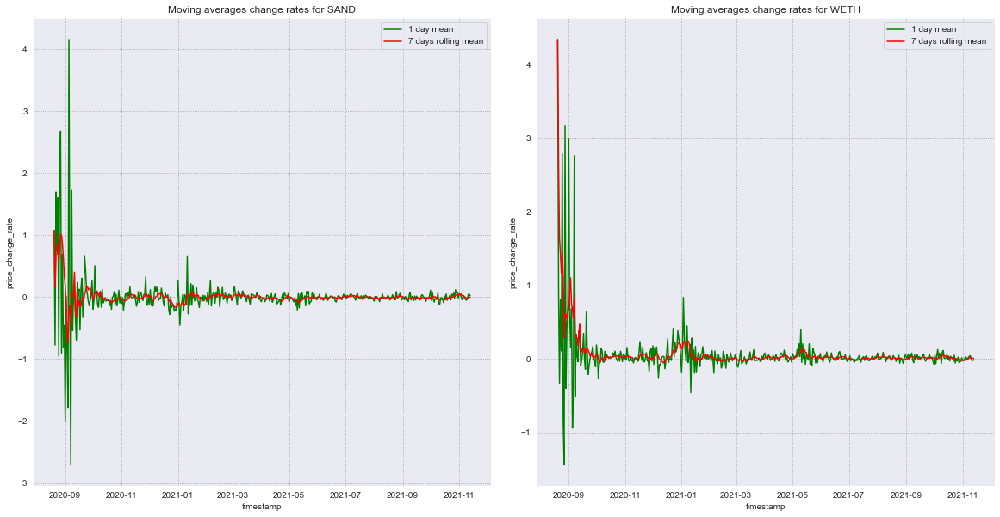

In [160]:
swaps_price_change_rates_moving_averages(sand_weth_df, 'SAND', 'WETH', 'Moving averages change rates for SAND',
                                           'Moving averages change rates for WETH', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

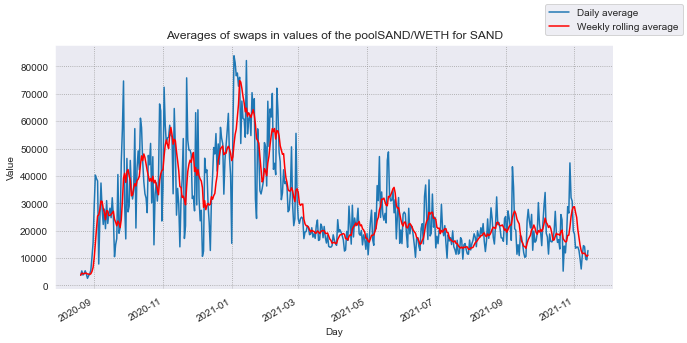

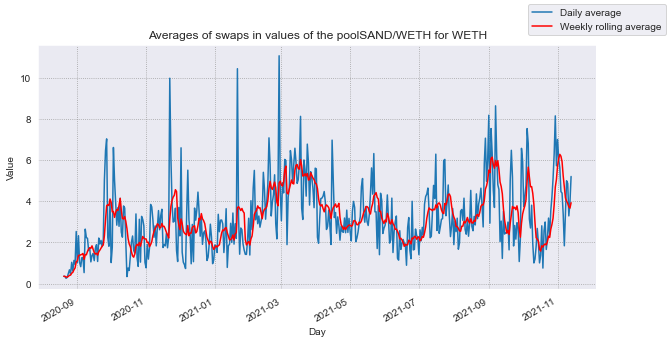

In [161]:
show_swaps_amount_in_moving_averages(swaps_df=sand_weth_df[(sand_weth_df.token_in == 'SAND')], pool_name="SAND/WETH for SAND")
show_swaps_amount_in_moving_averages(swaps_df=sand_weth_df[(sand_weth_df.token_in == 'WETH')], pool_name="SAND/WETH for WETH")

### Swapping values histograms

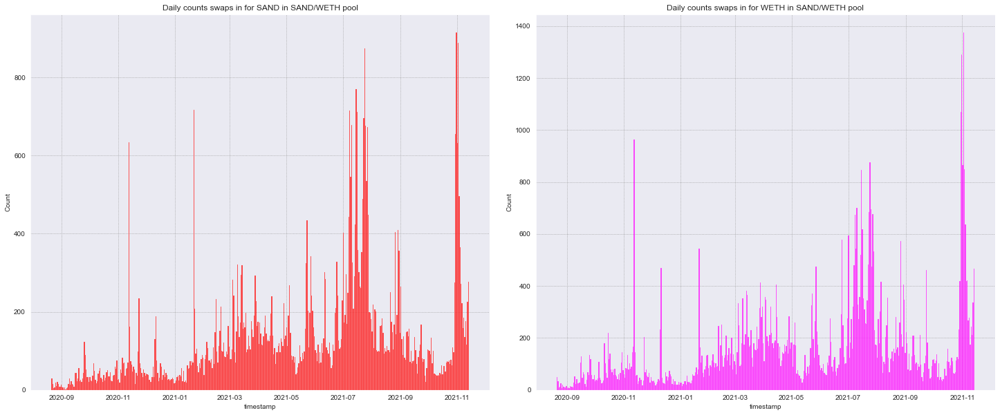

In [162]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=sand_weth_df[sand_weth_df.token_in == 'SAND'], x='timestamp', 
             bins=(sand_weth_df.timestamp[len(sand_weth_df) - 1] - sand_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for SAND in SAND/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=sand_weth_df[sand_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(sand_weth_df.timestamp[len(sand_weth_df) - 1] - sand_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in SAND/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

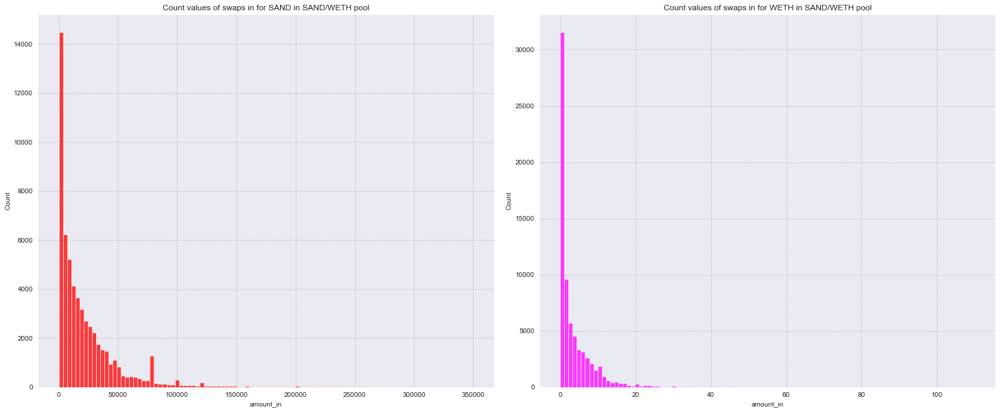

In [163]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=sand_weth_df[sand_weth_df.token_in == 'SAND'], x='amount_in', bins=100, 
             color='red', binrange=[0, 350000]).set_title("Count values of swaps in for SAND in SAND/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=sand_weth_df[sand_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta', binrange=[0, 110]).set_title("Count values of swaps in for WETH in SAND/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

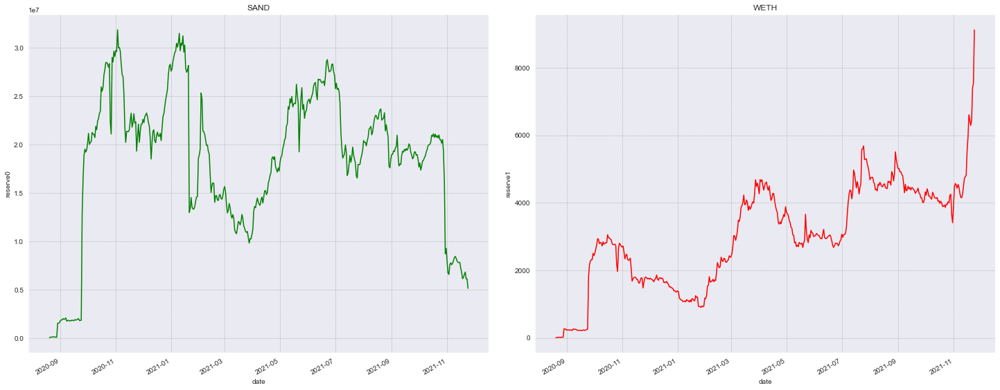

In [164]:
show_reserves_time_distribution(sand_weth_reserves_df, first_token_reserve_name="SAND", second_token_reserve_name="WETH", x=25, y=10, wspace=0.1)

### Plotting pool price

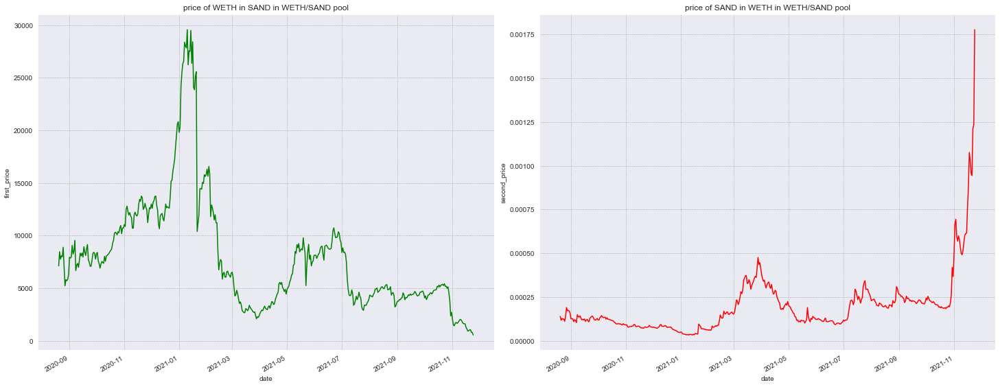

In [165]:
show_reserve_price_distributions(sand_weth_reserves_df, first_token_price_name="price of WETH in SAND in WETH/SAND pool", 
                                        second_token_price_name="price of SAND in WETH in WETH/SAND pool", x=25, y=10, wspace=0.1)

In [166]:
sand_weth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,4.620900e+04,6.473900,5.360654e+03,1.362405e+05,24.472452,2020-08-20,7137.737269,0.000140
1,8.011954e+04,9.442597,7.270852e+03,1.862165e+05,26.147471,2020-08-21,8484.905341,0.000118
2,8.079633e+04,10.412832,8.245477e+03,7.209562e+04,9.277340,2020-08-22,7759.304691,0.000129
3,1.145013e+05,14.152003,1.110878e+04,5.906999e+04,7.473852,2020-08-23,8090.820310,0.000124
4,1.199340e+05,14.999432,1.218586e+04,1.398868e+05,20.077351,2020-08-24,7995.904214,0.000125
...,...,...,...,...,...,...,...,...
457,6.567291e+06,6288.435033,5.540371e+07,3.608024e+06,3480.449469,2021-11-20,1044.344254,0.000958
458,6.817464e+06,6440.973519,5.536321e+07,2.214409e+06,2085.394378,2021-11-21,1058.452449,0.000945
459,6.107998e+06,7401.983994,6.067011e+07,5.484632e+06,5632.281126,2021-11-22,825.183943,0.001212
460,6.113292e+06,7546.419056,6.561037e+07,8.077255e+06,10216.035409,2021-11-23,810.091723,0.001234


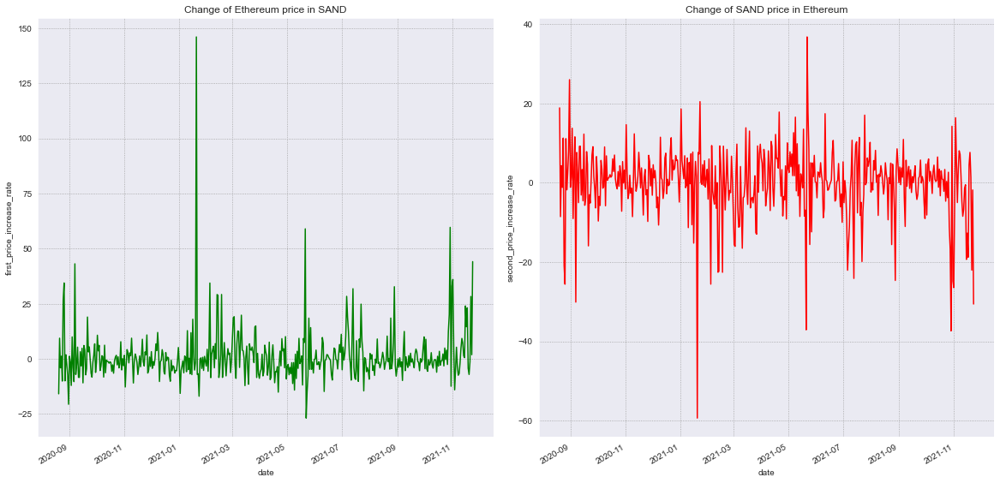

In [167]:
calc_price_and_increase_rates(sand_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=sand_weth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in SAND')
plt.subplot(1, 2, 2)
sns.lineplot(data=sand_weth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of SAND price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


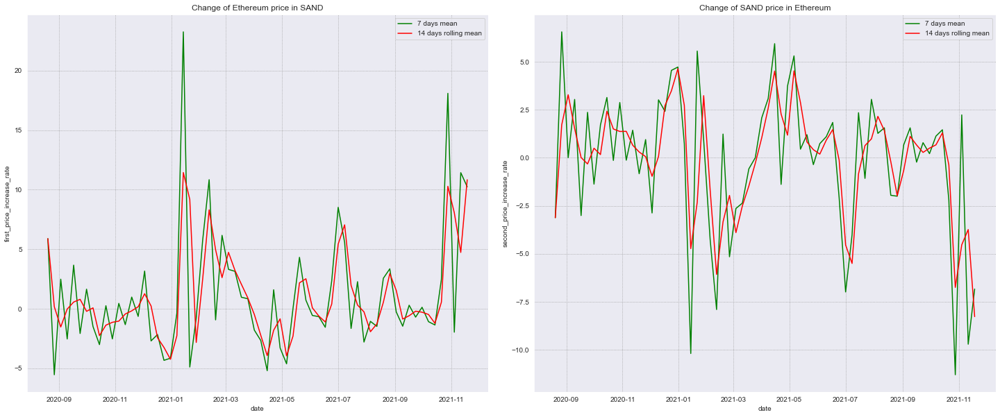

In [168]:
increase_rate_moving_averages(sand_weth_reserves_df, 'Change of Ethereum price in SAND', 
                              'Change of SAND price in Ethereum', x_size=25, y_size=10)

## ALICE/ETH

In [169]:
alice_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\alice_weth_swaps.pkl')
alice_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\alice_weth_mints.pkl")
alice_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\alice_weth_burns.pkl")
alice_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\alice_weth_reserves.pkl")

### Plotting swapping in moving averages

In [170]:
alice_weth_df = get_df_with_swap_prices_and_change_rates(alice_weth_df, 'ALICE', 'WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


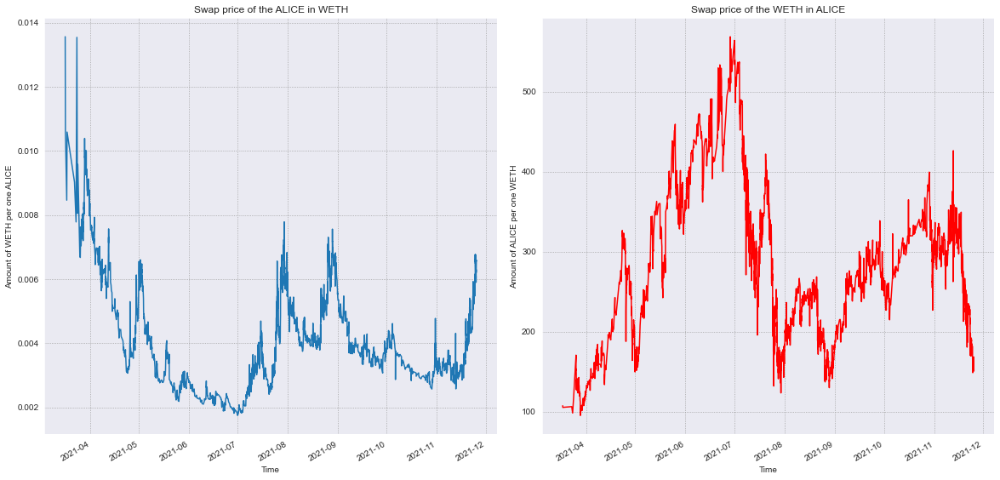

In [171]:
pyplot_line_swap_prices(alice_weth_df, 'ALICE', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

In [172]:
alice_weth_df[alice_weth_df.price_change_rate > 30]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
10,ALICE,WETH,16.606210,0.224846,338.812958,2021-03-23 14:05:43,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0x6ab67dce8f96e4e749a623f3fcfabe68f09176810ee9...,0.013540,73.999122
15,WETH,ALICE,1.037681,176.940288,1661.623574,2021-03-25 16:19:56,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0xde93684627d4e34d6ef96adf5bcabf10bbd8dd81,0x0c07222699b7614647b2d2f62a58f0a2ed6ff39577e7...,170.515185,47.518521
3668,WETH,ALICE,0.389989,90.334342,838.742335,2021-07-25 01:52:22,0xbdf5b4aed51d9f77b5e808802355ebecab823185,0xde93684627d4e34d6ef96adf5bcabf10bbd8dd81,0x072a6a65099d5dd8c6e0513d9fbfdb231011b928f066...,231.633117,38.195178
3685,WETH,ALICE,0.109500,23.727496,237.247290,2021-07-25 03:52:06,0x11111112542d85b3ef69ae05771c2dccff4faa26,0xa3c09f24c9d009aa09c4ba3f2d13ee75dc59052f,0x49e1ccb9feac0ebf9dfd539ab0aac79cb45a1ccbf20e...,216.689461,31.581904
3747,WETH,ALICE,0.091789,16.286585,198.777174,2021-07-25 06:55:38,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0x74de5d4fcbf63e00296fd95d33236b9794016631,0xf754fa17f079fa1302403ea4bab8ca77236672bea273...,177.435415,34.561731
7620,ALICE,WETH,1640.318287,7.065482,32538.133942,2021-11-12 12:42:41,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0000000000005117dd3a72e64a705198753fdd54,0x00f27b1332b07fdfd3ca5ecf9270c4ccb84fbb2e466f...,0.004307,48.878370


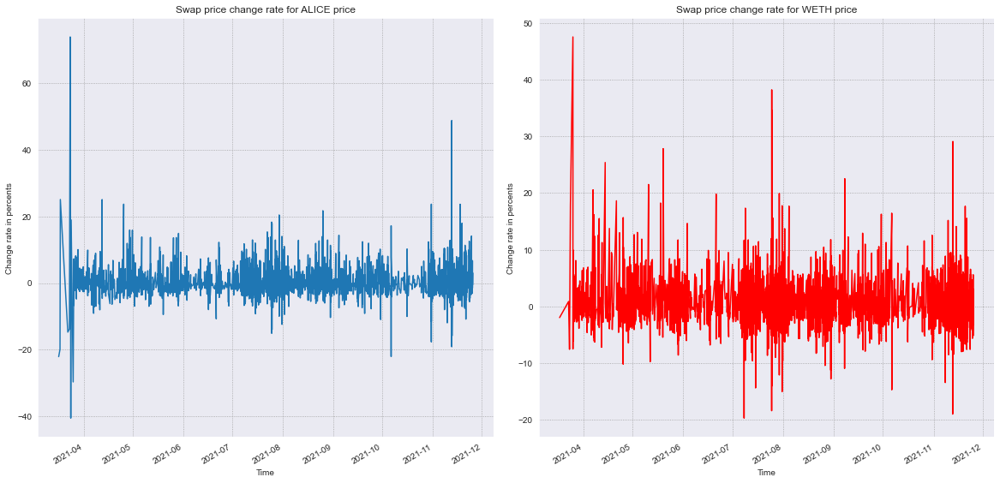

In [173]:
pyplot_line_swap_change_rate(alice_weth_df, 'ALICE', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


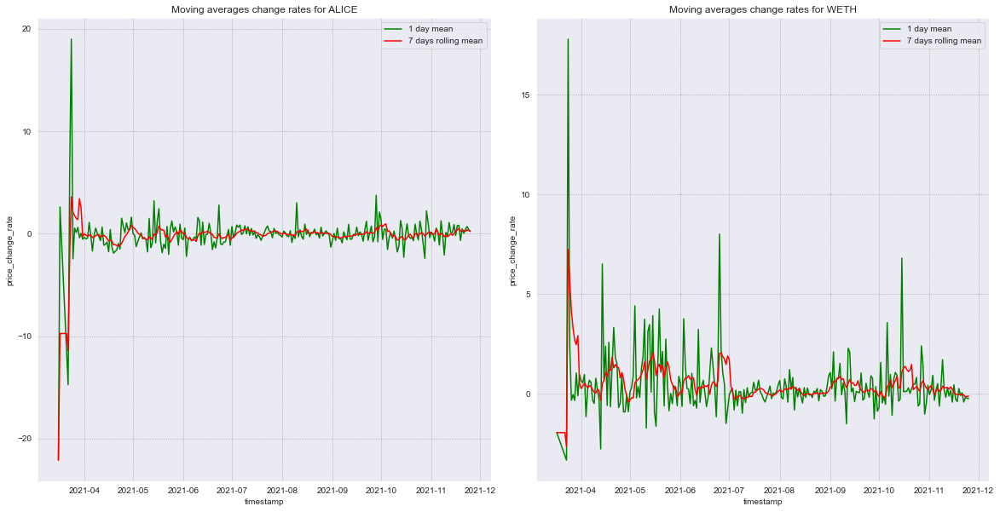

In [174]:
swaps_price_change_rates_moving_averages(alice_weth_df, 'ALICE', 'WETH', 'Moving averages change rates for ALICE',
                                           'Moving averages change rates for WETH', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

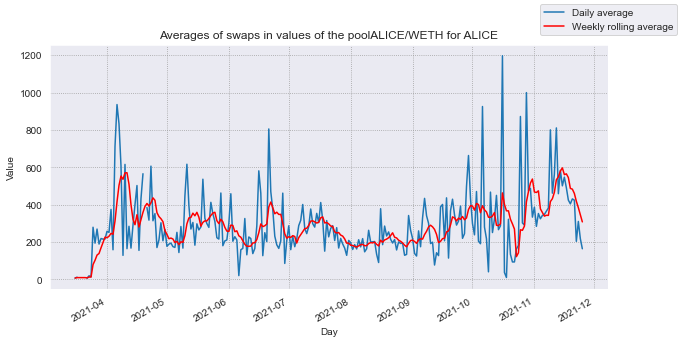

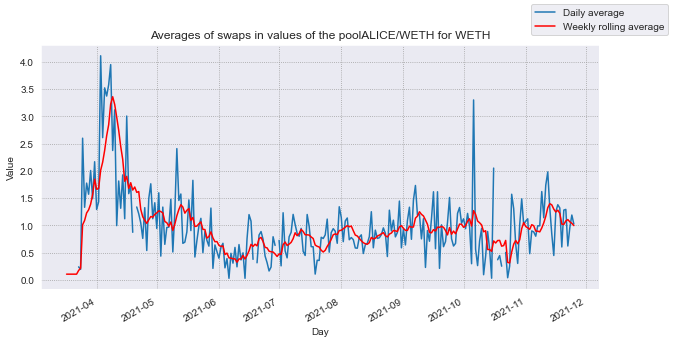

In [175]:
show_swaps_amount_in_moving_averages(swaps_df=alice_weth_df[(alice_weth_df.token_in == 'ALICE')], pool_name="ALICE/WETH for ALICE")
show_swaps_amount_in_moving_averages(swaps_df=alice_weth_df[(alice_weth_df.token_in == 'WETH')], pool_name="ALICE/WETH for WETH")

### Swapping values histograms

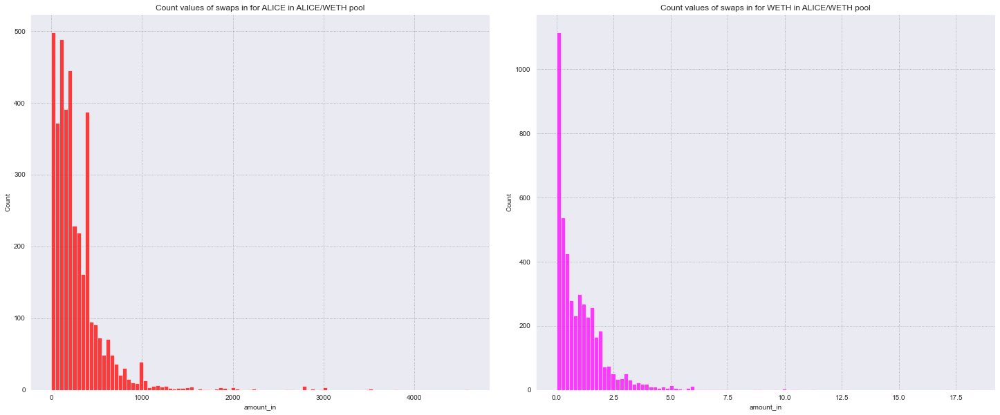

In [176]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=alice_weth_df[alice_weth_df.token_in == 'ALICE'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for ALICE in ALICE/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=alice_weth_df[alice_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for WETH in ALICE/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

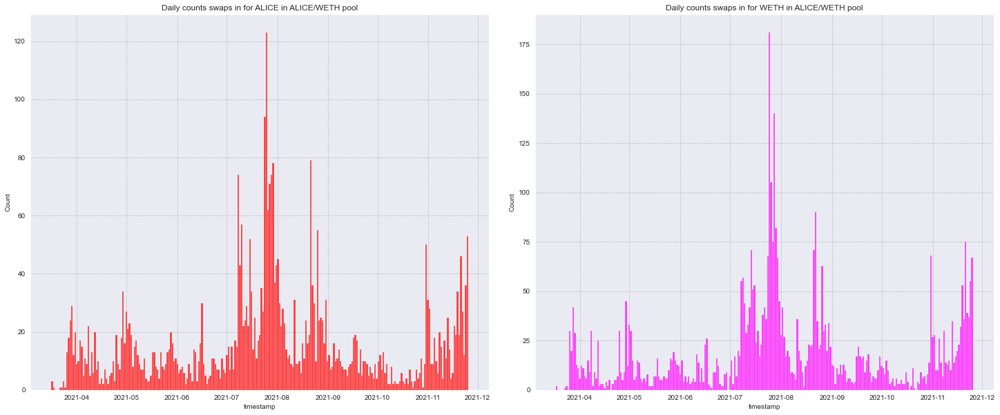

In [177]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=alice_weth_df[alice_weth_df.token_in == 'ALICE'], x='timestamp', 
             bins=(alice_weth_df.timestamp[len(alice_weth_df) - 1] - alice_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for ALICE in ALICE/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=alice_weth_df[alice_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(alice_weth_df.timestamp[len(alice_weth_df) - 1] - alice_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in ALICE/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

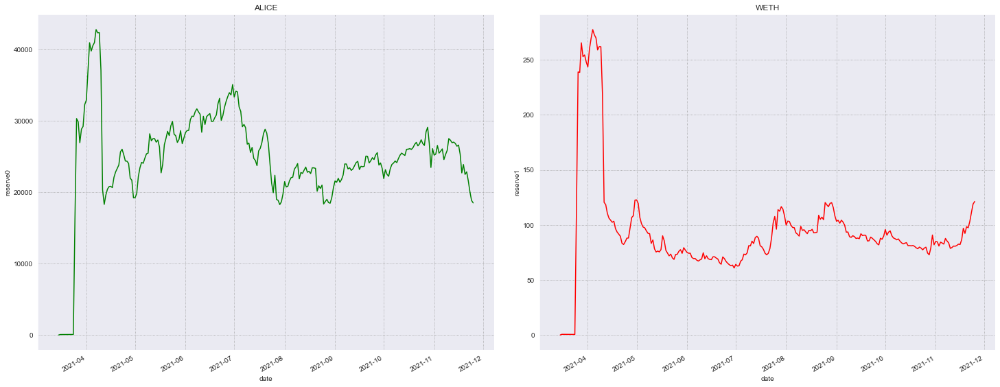

In [178]:
show_reserves_time_distribution(alice_weth_reserves_df, first_token_reserve_name="ALICE", second_token_reserve_name="WETH", x=25, y=10, wspace=0.1)

### Plotting pool price

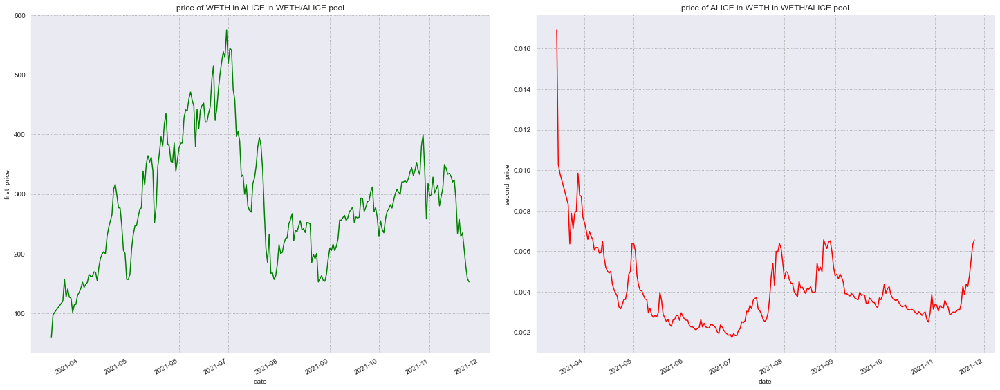

In [179]:
show_reserve_price_distributions(alice_weth_reserves_df, first_token_price_name="price of WETH in ALICE in WETH/ALICE pool", 
                                        second_token_price_name="price of ALICE in WETH in WETH/ALICE pool", x=25, y=10, wspace=0.1)

In [180]:
alice_weth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,6.000000,0.101598,3.673550e+02,0.000000,0.000000,2021-03-15,59.056221,0.016933
1,67.100212,0.689707,2.430779e+03,14.839028,0.195232,2021-03-16,97.287957,0.010279
2,68.634374,0.675505,2.232419e+03,46.915728,0.438203,2021-03-17,101.604599,0.009842
3,74.634374,0.621349,2.098103e+03,6.000000,0.054155,2021-03-22,120.116605,0.008325
4,85.550512,0.544140,1.817053e+03,106.134748,1.034504,2021-03-23,157.221427,0.006360
...,...,...,...,...,...,...,...,...
246,22848.051422,97.433199,8.331916e+05,41232.998887,197.500289,2021-11-21,234.499654,0.004264
247,21577.669556,103.220851,8.443882e+05,3717.518590,16.605229,2021-11-22,209.043708,0.004784
248,20056.083201,111.401124,9.685291e+05,21385.900979,116.369748,2021-11-23,180.034837,0.005554
249,18840.755150,118.996346,1.013472e+06,22159.528305,135.145361,2021-11-24,158.330535,0.006316


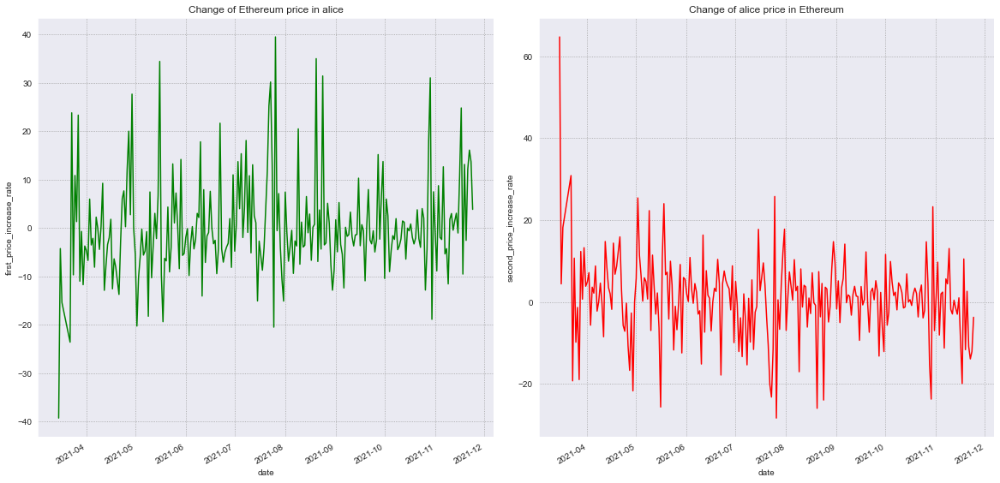

In [181]:
calc_price_and_increase_rates(alice_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=alice_weth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in alice')
plt.subplot(1, 2, 2)
sns.lineplot(data=alice_weth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of alice price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


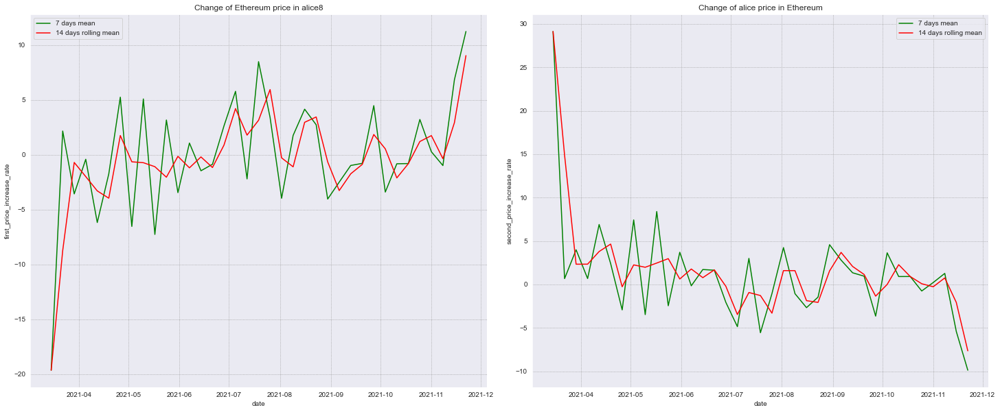

In [182]:
increase_rate_moving_averages(alice_weth_reserves_df, 'Change of Ethereum price in alice8', 'Change of alice price in Ethereum', x_size=25, y_size=10)

## DOGE/ETH

In [183]:
doge_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\doge_weth_swaps.pkl')
doge_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\doge_weth_mints.pkl")
doge_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\doge_weth_burns.pkl")
doge_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\doge_weth_reserves.pkl")

### Plotting swapping in moving averages

In [184]:
doge_weth_df = get_df_with_swap_prices_and_change_rates(doge_weth_df, 'DOGE', 'WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


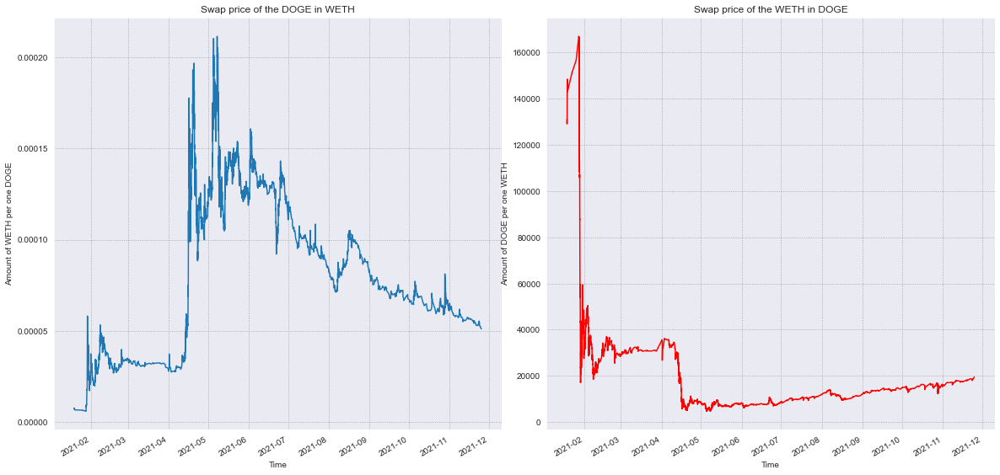

In [185]:
pyplot_line_swap_prices(doge_weth_df, 'DOGE', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

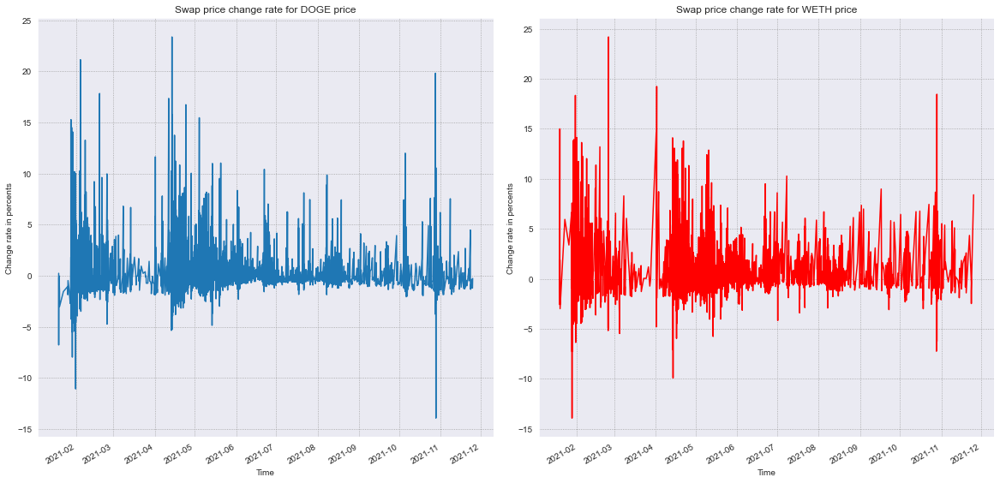

In [186]:
pyplot_line_swap_change_rate(doge_weth_df, 'DOGE', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


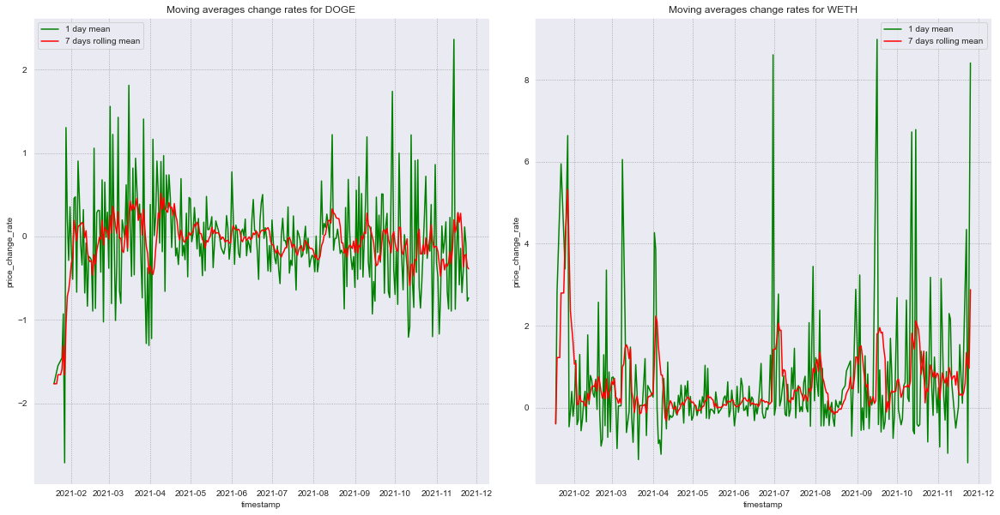

In [187]:
swaps_price_change_rates_moving_averages(doge_weth_df, 'DOGE', 'WETH', 'Moving averages change rates for DOGE',
                                           'Moving averages change rates for WETH', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

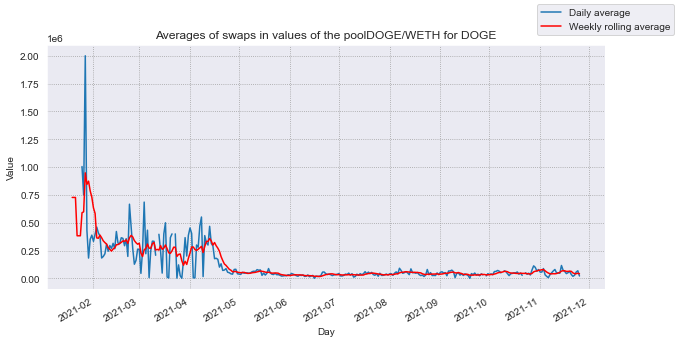

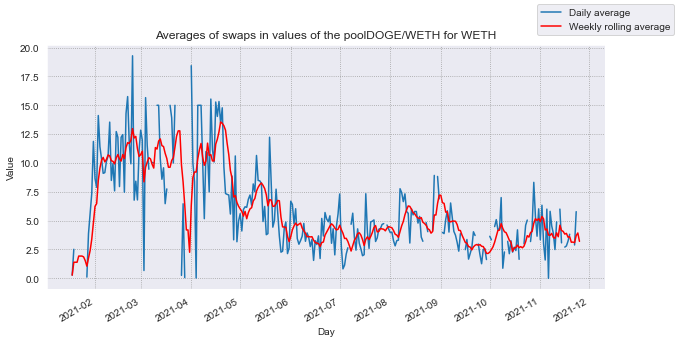

In [188]:
show_swaps_amount_in_moving_averages(swaps_df=doge_weth_df[(doge_weth_df.token_in == 'DOGE')], pool_name="DOGE/WETH for DOGE")
show_swaps_amount_in_moving_averages(swaps_df=doge_weth_df[(doge_weth_df.token_in == 'WETH')], pool_name="DOGE/WETH for WETH")

### Swapping values histograms

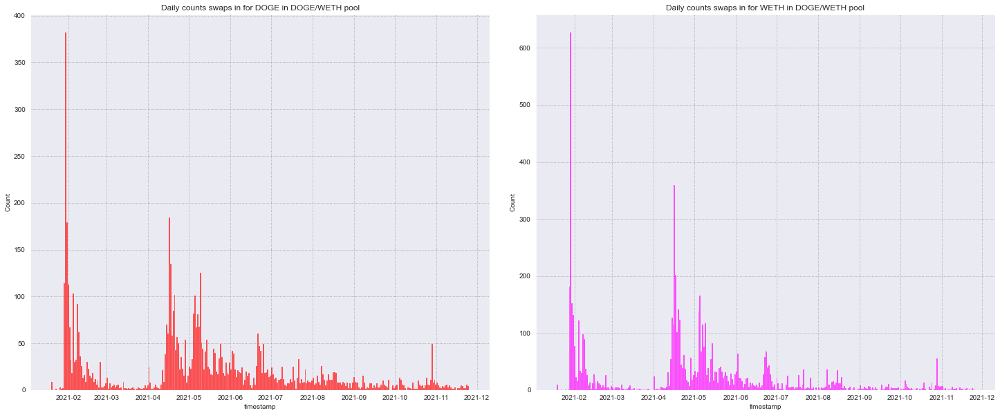

In [189]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=doge_weth_df[doge_weth_df.token_in == 'DOGE'], x='timestamp', 
             bins=(doge_weth_df.timestamp[len(doge_weth_df) - 1] - doge_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for DOGE in DOGE/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=doge_weth_df[doge_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(doge_weth_df.timestamp[len(doge_weth_df) - 1] - doge_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in DOGE/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

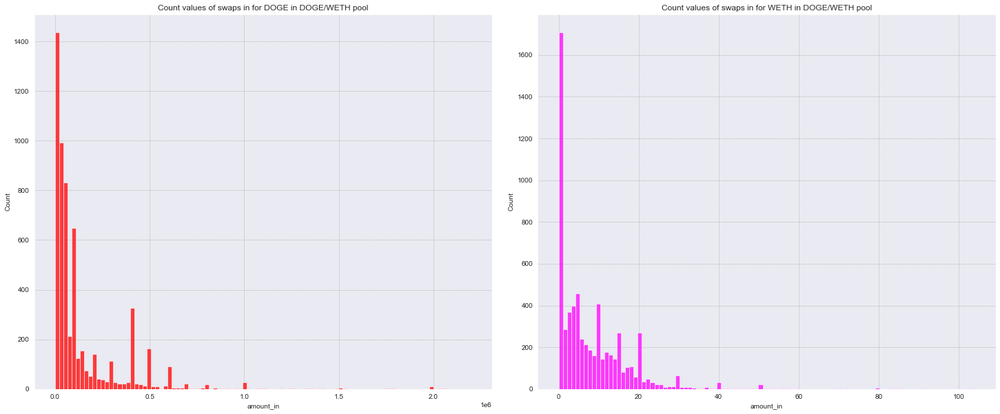

In [190]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=doge_weth_df[doge_weth_df.token_in == 'DOGE'], x='amount_in', bins=100, 
             color='red', binrange=[0, 2200000]).set_title("Count values of swaps in for DOGE in DOGE/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=doge_weth_df[doge_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for WETH in DOGE/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

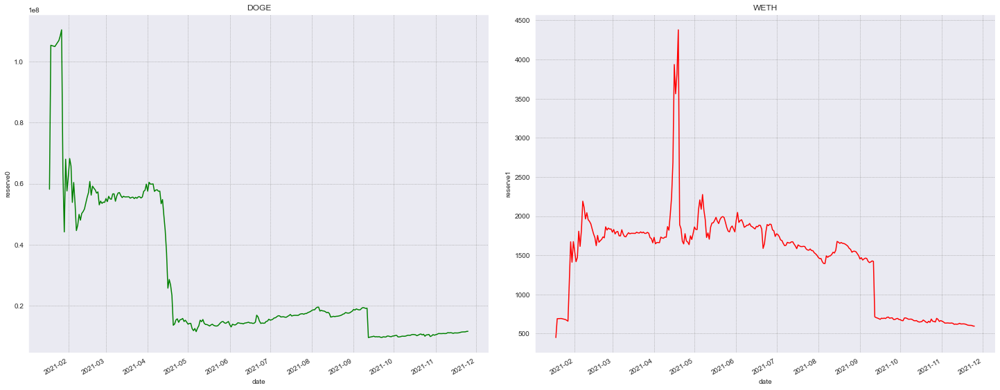

In [191]:
show_reserves_time_distribution(doge_weth_reserves_df, first_token_reserve_name="DOGE", 
                                second_token_reserve_name="WETH", x=25, y=10, wspace=0.1)

### Plotting pool price

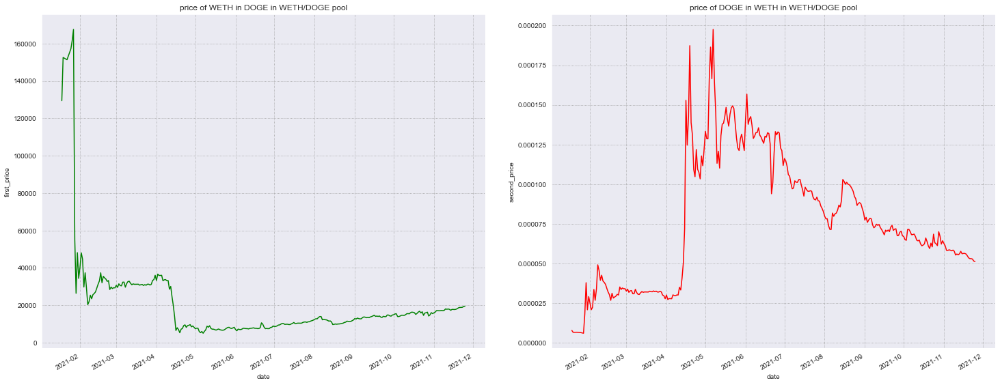

In [192]:
show_reserve_price_distributions(doge_weth_reserves_df, first_token_price_name="price of WETH in DOGE in WETH/DOGE pool", 
                                        second_token_price_name="price of DOGE in WETH in WETH/DOGE pool", x=25, y=10, wspace=0.15)

In [193]:
doge_weth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,5.815876e+07,449.362514,1.117025e+06,1.796070e+05,1.374850,2021-01-18,129425.031923,0.000008
1,1.053052e+08,690.380932,1.924844e+06,8.014429e+06,56.096709,2021-01-19,152532.060272,0.000007
2,1.048894e+08,693.127828,1.756477e+06,4.933253e+05,3.253104,2021-01-22,151327.605393,0.000007
3,1.068894e+08,680.197323,1.847699e+06,2.020000e+06,13.058171,2021-01-25,157144.656179,0.000006
4,1.083894e+08,670.812012,1.807903e+06,1.500000e+06,9.385311,2021-01-26,161579.358327,0.000006
...,...,...,...,...,...,...,...,...
303,1.142605e+07,605.853906,5.283400e+06,5.698648e+04,3.027678,2021-11-21,18859.409813,0.000053
304,1.142830e+07,605.751889,5.195916e+06,1.104917e+05,5.885732,2021-11-22,18866.311185,0.000053
305,1.145479e+07,604.456965,5.227746e+06,6.612421e+05,35.976650,2021-11-23,18950.553358,0.000053
306,1.159304e+07,597.270503,5.139708e+06,1.382418e+05,7.186462,2021-11-24,19410.025688,0.000052


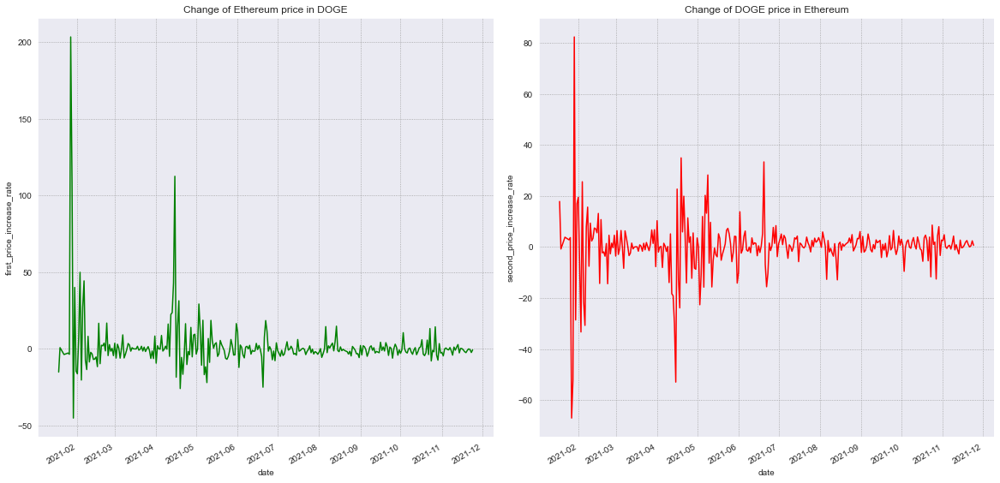

In [194]:
calc_price_and_increase_rates(doge_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=doge_weth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in DOGE')
plt.subplot(1, 2, 2)
sns.lineplot(data=doge_weth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of DOGE price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


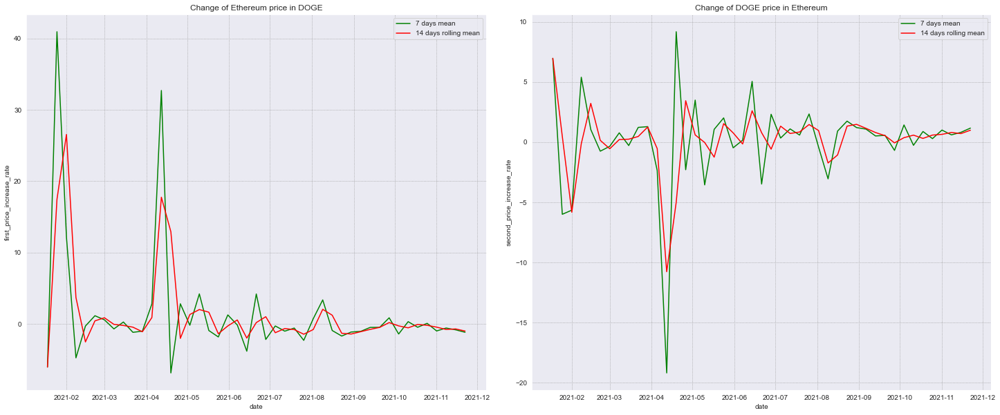

In [195]:
increase_rate_moving_averages(doge_weth_reserves_df, 'Change of Ethereum price in DOGE', 
                              'Change of DOGE price in Ethereum', x_size=25, y_size=10)

## ELON/ETH

In [196]:
elon_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\elon_weth_swaps.pkl')
elon_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\elon_weth_mints.pkl")
elon_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\elon_weth_burns.pkl")
elon_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\elon_weth_reserves.pkl")

### Plotting swapping in moving averages

In [197]:
elon_weth_df = get_df_with_swap_prices_and_change_rates(elon_weth_df, 'ELON', 'WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [198]:
elon_weth_df[elon_weth_df.price_change_rate > 10000]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
201478,WETH,ELON,2.20065,1.299231e+11,8360.57988,2021-09-03 04:07:53,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe02f0f6b322c6ebe5cc332523289a5a04be4afea,0x92ecd13687a25ffa926911e8ff0a378a748999647898...,5.903853e+10,5.903853e+12


In [199]:
elon_weth_df[(elon_weth_df.timestamp > datetime(2021, 9, 3, 1, 0)) & 
             (elon_weth_df.timestamp < datetime(2021, 9, 3, 5, 15))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
201472,WETH,ELON,1.322041e-02,7.811944e+08,4.939528e+01,2021-09-03 01:08:31,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xe66b31678d6c16e9ebf358268a790b763c133750,0x85255cb618812a42a3e4b69a353d9a4fe96f20ea23cd...,5.909002e+10,-3.443978e-02
201473,WETH,ELON,9.000268e-03,5.318127e+08,3.362562e+01,2021-09-03 01:11:34,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe2a9bfb742642413f76c768de43b9879ddb55797,0x95c2906d654bed37680b0f55b958c1340c81c4aeff03...,5.908854e+10,-2.502673e-03
201474,ELON,WETH,5.457151e+09,9.179362e-02,3.427337e+02,2021-09-03 01:19:07,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x4b1d67970fd68874aaee2cd45a6df1953ef982782f06...,1.682079e-11,5.973902e-02
201475,ELON,WETH,3.569799e+10,6.000000e-01,2.238869e+03,2021-09-03 01:53:39,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xf1a0d291dea798ae78c63a619c3afa3588a123ed73d9...,1.680767e-11,-7.804131e-02
201476,ELON,WETH,1.933268e+09,3.247048e-02,1.221740e+02,2021-09-03 02:50:43,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x07dcea4626213d618c523599dc5718441453654cdf0e...,1.679564e-11,-7.153145e-02
201477,WETH,ELON,1.000000e-18,1.000000e-18,3.771929e-15,2021-09-03 03:17:31,0x000000000010ca868c3b57d89b80fc66f7257c29,0x000000000010ca868c3b57d89b80fc66f7257c29,0x248fca8eedd9fb73d1f42b0c0ccb910693e6692adfe4...,1.000000e+00,-1.000000e+02
201478,WETH,ELON,2.200650e+00,1.299231e+11,8.360580e+03,2021-09-03 04:07:53,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe02f0f6b322c6ebe5cc332523289a5a04be4afea,0x92ecd13687a25ffa926911e8ff0a378a748999647898...,5.903853e+10,5.903853e+12
201479,ELON,WETH,5.027630e+09,8.485039e-02,3.237747e+02,2021-09-03 04:37:52,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x92482c0261ca1c4c6d01e717084416963bdcc5568999...,1.687682e-11,4.832956e-01
201480,WETH,ELON,4.700149e-01,2.767094e+10,1.791605e+03,2021-09-03 04:57:30,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xf9cd36a7b45bfdbc7c5d6bd1b9a698e4d247d754,0x767d40990796c244a53457b2cb6da3047c553670a56f...,5.887248e+10,-2.812665e-01
201481,WETH,ELON,7.000000e-01,4.115662e+10,2.669034e+03,2021-09-03 05:00:46,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x200abd7fb6466fc9e22191f80f54721234b66cf4,0xf13d5388abede93bae921e6a7b1279ac7ccc9cb896f1...,5.879516e+10,-1.313210e-01


In [200]:
elon_weth_df[(elon_weth_df.first_to_second_price > 100000000000) & 
             (elon_weth_df.timestamp > datetime(2021, 5, 1))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
123279,WETH,ELON,1.000000,1.434729e+11,4082.470866,2021-05-12 18:17:36,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x12394bcf7d5c40550c251d08860ad62e1c51d93c,0x26ae6eb16d68e70da72080318e891a976db8942697a5...,1.434729e+11,399.567462
123280,WETH,ELON,2.000000,2.887062e+11,8174.994306,2021-05-12 18:17:36,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x717b4aecf7973f27b62c9b2232933851eb5f1484,0x8a06b4ef9dfd7fe27d128ce5291bea456811232d52fd...,1.443531e+11,0.613500
123281,WETH,ELON,2.000000,2.910763e+11,8175.701659,2021-05-12 18:17:36,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x23ecfaba8f518b9080774a6b6dc3df38e760c914,0x9ea5bf26ec775d879ade9379eec6af5e027d3ac611d8...,1.455382e+11,0.820951
123283,WETH,ELON,0.140216,2.000000e+10,572.318381,2021-05-12 18:17:47,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x98895440933db3cedb9f2364c3eaf27ee84548bb,0xa98db64012f56198ec2729d1e51c3f7d7abb8fb55db3...,1.426367e+11,-1.993594
123284,WETH,ELON,0.514094,7.353176e+10,2098.849694,2021-05-12 18:17:47,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0xb272aa1290693d457ad07590d5c1be9d464fe2d4ddb5...,1.430318e+11,0.277002
123285,WETH,ELON,0.354154,5.056607e+10,1445.543488,2021-05-12 18:17:47,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x367c49e002616469e2ad73485ef3912520bcfca2,0xc6814cdbc313a9e600b4b5152d0bd28a27951eae5886...,1.427799e+11,-0.176123
123286,WETH,ELON,0.100000,1.316077e+10,408.125091,2021-05-12 18:17:53,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x237f1b444632f43b25e48612bfc923673979ca3b,0x2375854016f52e6de560a5a42f85c328ce1e0b6213e6...,1.316077e+11,-7.824756
123287,WETH,ELON,0.578790,7.607274e+10,2362.147608,2021-05-12 18:17:53,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x9a45c63ef50d0cc8ccdaffc54ea5ac8007313a6f,0x3c4d93b2670b731054ac328200221e38dc5befa81e4d...,1.314342e+11,-0.131896
123288,WETH,ELON,20.000000,2.739545e+12,81625.018234,2021-05-12 18:17:53,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb33cc3147d70ce2af31b2b90411bd6333eea0ea7,0xcc2d8df7fc3bceda2ce2e85d43ef1a5f563ce4ae67e7...,1.369773e+11,4.217404
123289,WETH,ELON,0.129182,1.841596e+10,527.222115,2021-05-12 18:17:53,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0x9d8d6e4e73c9211741a386ff8154f5872e8ec79d,0xe2fad3f7a70b17bebefd4353a97352f7b0daf74deb9d...,1.425588e+11,4.074819


In [201]:
elon_weth_df[(elon_weth_df.timestamp < datetime(2021, 5, 12, 18, 19)) & 
             (elon_weth_df.timestamp > datetime(2021, 5, 12, 18, 16, 30))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
123268,WETH,ELON,8.000000e-01,2.276273e+10,3.278678e+03,2021-05-12 18:16:48,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x358462f384fdf46bb4632a8814d68278439624d6,0x99271ec468542d008622063cad081ac23260f7ba4dff...,2.845342e+10,-1.467026
123269,WETH,ELON,9.697793e-01,2.754931e+10,3.976401e+03,2021-05-12 18:16:48,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0735574a0d9899ff3753917315af9acfcc2ac61e,0xa059012b6a0ace0f261115403d96499d5dc87f2d0f89...,2.840781e+10,-0.160273
123270,WETH,ELON,3.600000e+00,1.021293e+11,1.475493e+04,2021-05-12 18:17:03,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb0c56599e1f2161761b76c948d88b1050374f5fe,0x1a83295aeef6790463ee7464ffcc623ace6ebbd67d5e...,2.836924e+10,-0.135770
123271,ELON,WETH,4.366314e+10,1.527031e+00,6.258854e+03,2021-05-12 18:17:03,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0d4a11d5eeaac28ec3f61d100daf4d40471f1852,0x80b6fc30d93e958225dafcfa464a853ad8aac184f5c2...,3.497299e-11,-9.653625
123272,WETH,ELON,2.200000e+00,6.208561e+10,9.016901e+03,2021-05-12 18:17:03,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x784a6fb1a7de230b29c4ead319310d7401e05317,0xb41f9b4dbdf29416d41559e9a8d72ca11479133b72da...,2.822073e+10,-0.523493
123273,WETH,ELON,2.000000e+02,4.772950e+12,8.210612e+05,2021-05-12 18:17:09,0xd78a3280085ee846196cb5fab7d510b279486d44,0xf6da21e95d74767009accb145b96897ac3630bad,0x19f6d3b8263c959ba69e88ed4eae9c59722ebf96df60...,2.386475e+10,-15.435404
123274,ELON,WETH,5.726050e+11,2.000000e+01,8.209601e+04,2021-05-12 18:17:09,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x67c4d9975f84be42d738fe2a75fd9d81fbd74020f3f9...,3.492809e-11,-0.128372
123275,ELON,WETH,4.807081e+12,2.021711e+02,8.299744e+05,2021-05-12 18:17:09,0xd78a3280085ee846196cb5fab7d510b279486d44,0xf6da21e95d74767009accb145b96897ac3630bad,0x82a36d3ccb4b60352b4507c46306ce24c46cc779277e...,4.205694e-11,20.410075
123276,WETH,ELON,7.000000e+00,1.407326e+11,2.873714e+04,2021-05-12 18:17:09,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x3292b3ecd35df884481e034e8800d4c8f4508c47,0xb37975748a254a8189dba5ee5b49c9af65b676891997...,2.010466e+10,-15.755816
123277,WETH,ELON,4.670355e+00,1.323527e+11,1.911450e+04,2021-05-12 18:17:17,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xfa2c0641d1cba088cbd68595cf8a0cf2b7457863,0x4290a94a89d34a2fd7fc88507edfe4bbfd509b5563c0...,2.833890e+10,40.956859


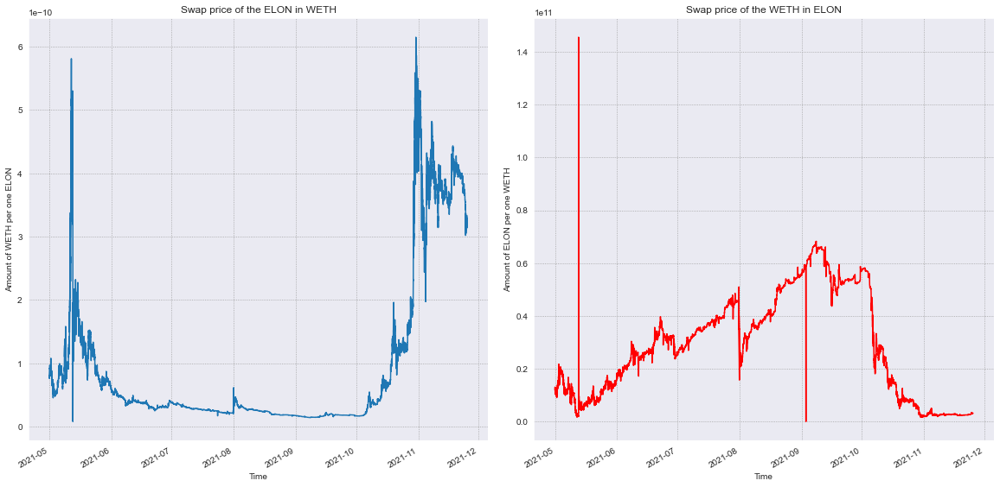

In [202]:
pyplot_line_swap_prices(elon_weth_df[elon_weth_df.timestamp > datetime(2021, 5, 1)], 'ELON', 'WETH', 
                        xsize=20, ysize=10, wspace=0.1, hspace=0.1)

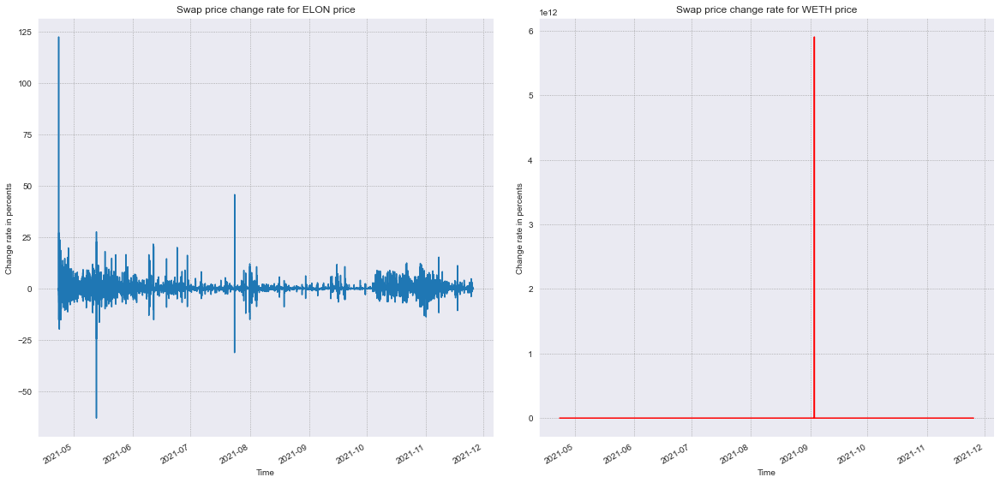

In [203]:
pyplot_line_swap_change_rate(elon_weth_df, 'ELON', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


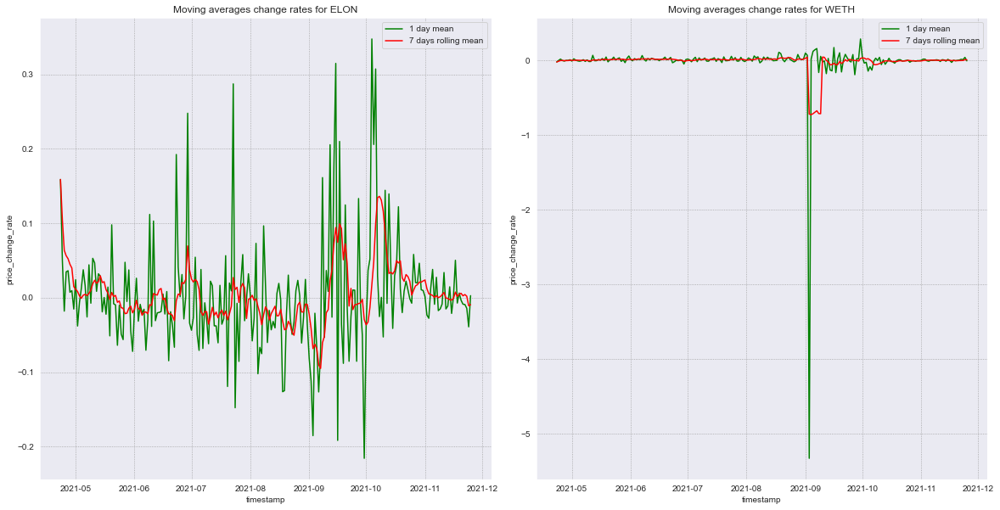

In [204]:
swaps_price_change_rates_moving_averages(elon_weth_df[elon_weth_df.price_change_rate < 2000], 'ELON', 'WETH', 'Moving averages change rates for ELON',
                                           'Moving averages change rates for WETH', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

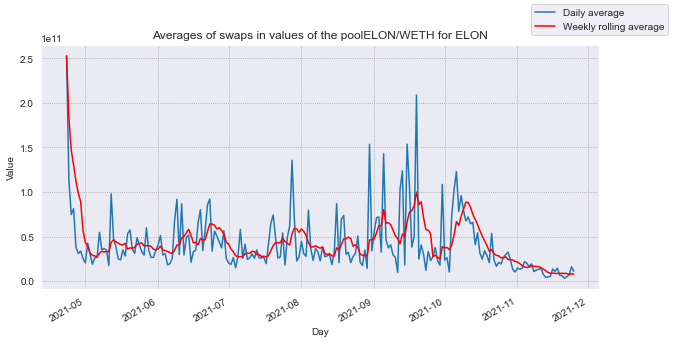

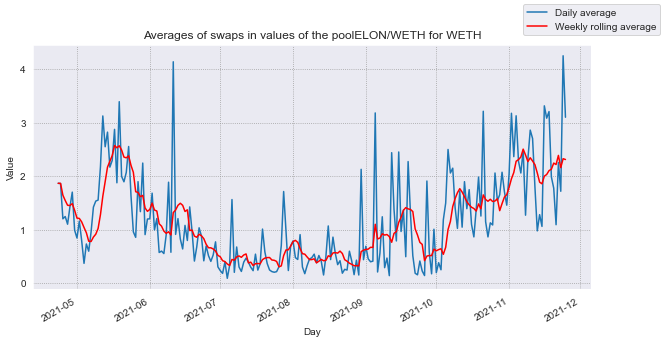

In [205]:
show_swaps_amount_in_moving_averages(swaps_df=elon_weth_df[(elon_weth_df.token_in == 'ELON')], pool_name="ELON/WETH for ELON")
show_swaps_amount_in_moving_averages(swaps_df=elon_weth_df[(elon_weth_df.token_in == 'WETH')], pool_name="ELON/WETH for WETH")

### Swapping values histograms

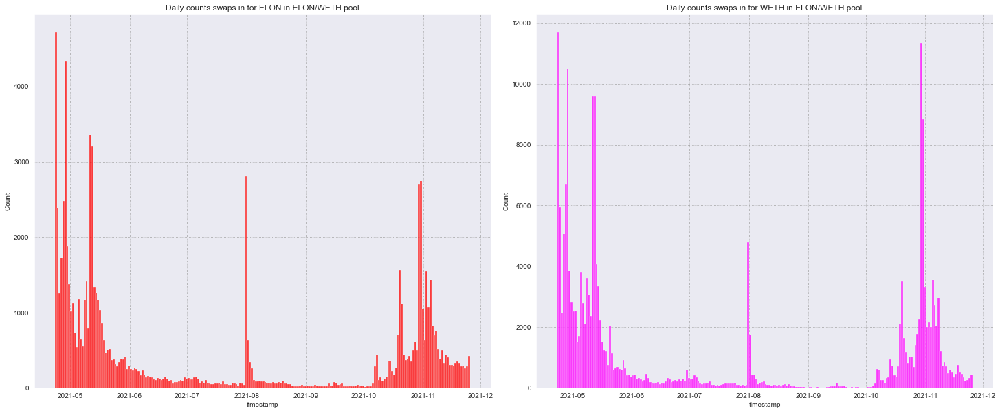

In [206]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=elon_weth_df[elon_weth_df.token_in == 'ELON'], x='timestamp', 
             bins=(elon_weth_df.timestamp[len(elon_weth_df) - 1] - elon_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for ELON in ELON/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=elon_weth_df[elon_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(elon_weth_df.timestamp[len(elon_weth_df) - 1] - elon_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in ELON/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

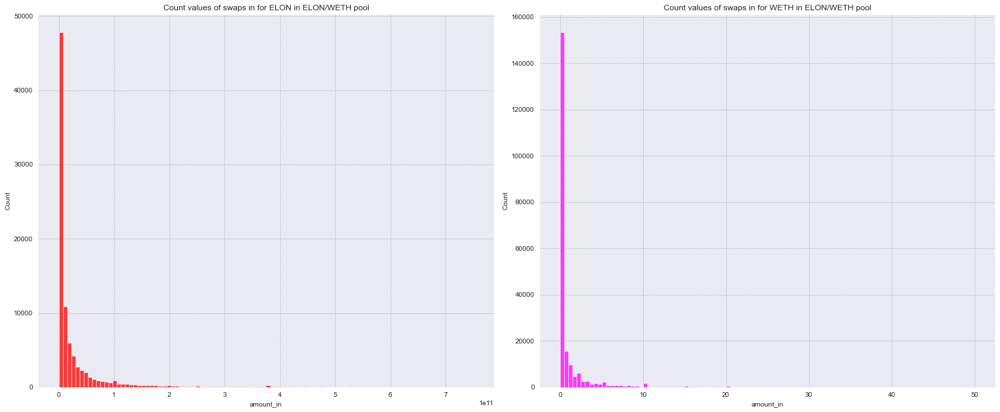

In [207]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=elon_weth_df[elon_weth_df.token_in == 'ELON'], x='amount_in', bins=100, 
             color='red', binrange=[0, 750000000000]).set_title("Count values of swaps in for ELON in ELON/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=elon_weth_df[elon_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta', binrange=[0, 50]).set_title("Count values of swaps in for WETH in ELON/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

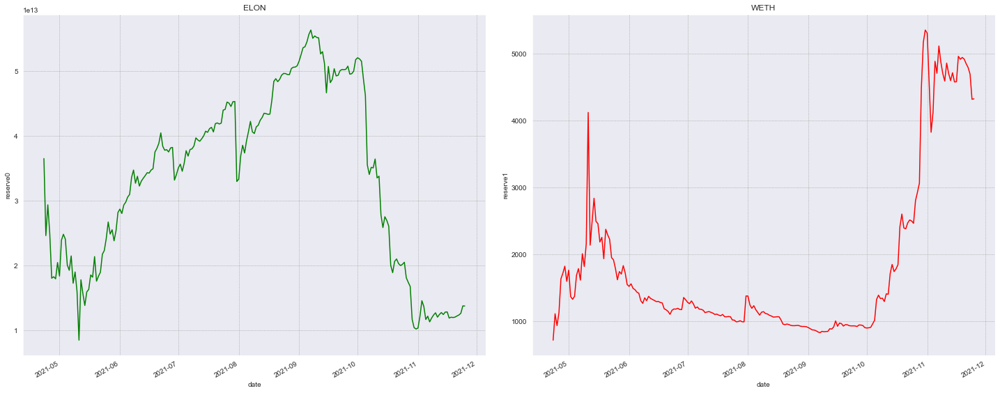

In [208]:
show_reserves_time_distribution(elon_weth_reserves_df, first_token_reserve_name="ELON", second_token_reserve_name="WETH", x=25, y=10, wspace=0.1)

### Plotting pool price

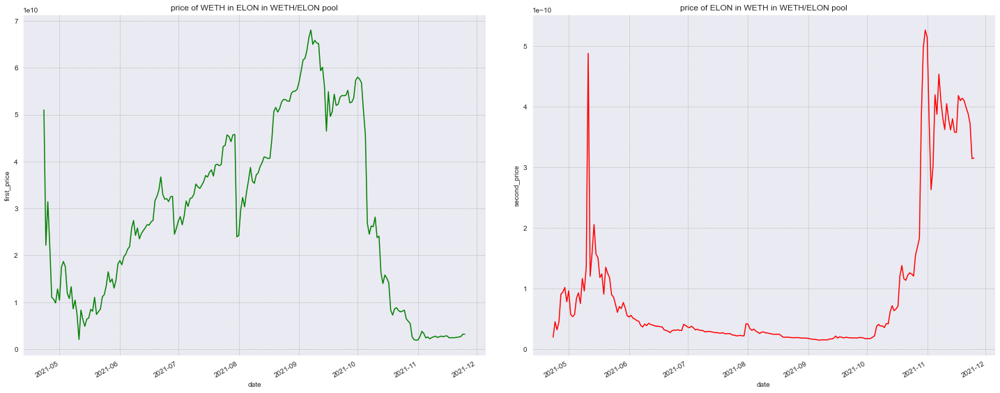

In [209]:
show_reserve_price_distributions(elon_weth_reserves_df, first_token_price_name="price of WETH in ELON in WETH/ELON pool", 
                                        second_token_price_name="price of ELON in WETH in WETH/ELON pool", x=25, y=10, wspace=0.1)

In [210]:
elon_weth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,first_price,second_price
0,3.650502e+13,715.602627,3.385606e+06,2.729964e+15,41193.755814,2021-04-23,5.101298e+10,1.960285e-11
1,2.459976e+13,1110.292501,4.916181e+06,5.911238e+14,22876.541746,2021-04-24,2.215610e+10,4.513429e-11
2,2.935363e+13,933.446347,4.311324e+06,1.858092e+14,6450.296998,2021-04-25,3.144651e+10,3.180003e-11
3,2.492029e+13,1127.543829,5.708305e+06,2.802904e+14,12044.298435,2021-04-26,2.210139e+10,4.524601e-11
4,1.801824e+13,1632.782457,8.678267e+06,1.908413e+14,13764.348242,2021-04-27,1.103530e+10,9.061832e-11
...,...,...,...,...,...,...,...,...
212,1.218692e+13,4848.289166,4.155711e+07,1.833893e+12,736.858975,2021-11-21,2.513654e+09,3.978272e-10
213,1.233739e+13,4791.356316,3.930956e+07,2.440711e+12,962.676185,2021-11-22,2.574926e+09,3.883606e-10
214,1.260622e+13,4693.219739,4.076270e+07,3.590066e+12,1358.401103,2021-11-23,2.686049e+09,3.722940e-10
215,1.374227e+13,4316.740588,3.678673e+07,1.203970e+13,3912.687800,2021-11-24,3.183484e+09,3.141213e-10


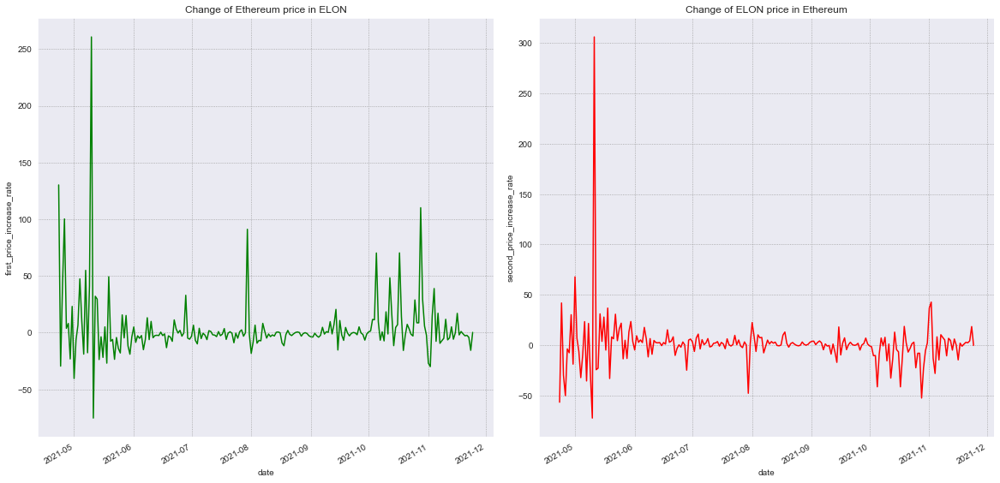

In [211]:
calc_price_and_increase_rates(elon_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=elon_weth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in ELON')
plt.subplot(1, 2, 2)
sns.lineplot(data=elon_weth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of ELON price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


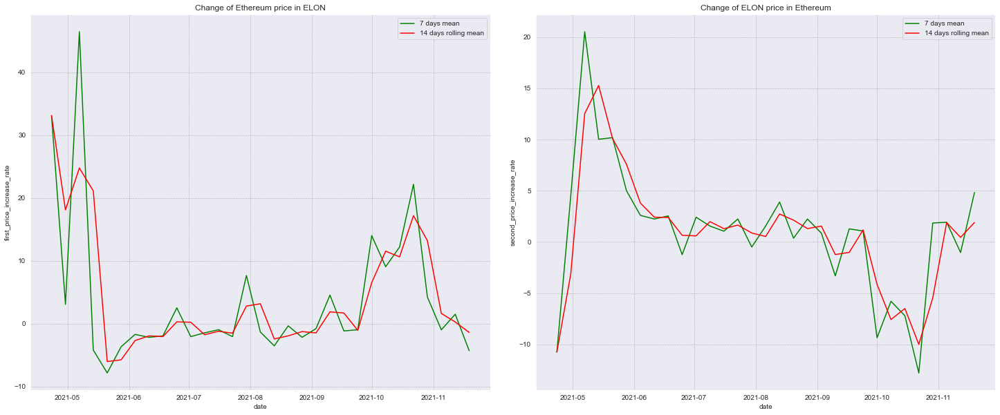

In [212]:
increase_rate_moving_averages(elon_weth_reserves_df, 'Change of Ethereum price in ELON', 
                              'Change of ELON price in Ethereum', x_size=25, y_size=10)

## SHIB/ETH

In [213]:
shib_weth_df = pd.read_pickle(os.getcwd() + '\\pkl_stories\\shib_weth_swaps.pkl')
shib_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\shib_weth_mints.pkl")
shib_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\shib_weth_burns.pkl")
shib_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\shib_weth_reserves.pkl")

### Plotting swapping in moving averages

In [214]:
shib_weth_df = get_df_with_swap_prices_and_change_rates(shib_weth_df, 'SHIB', 'WETH')

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


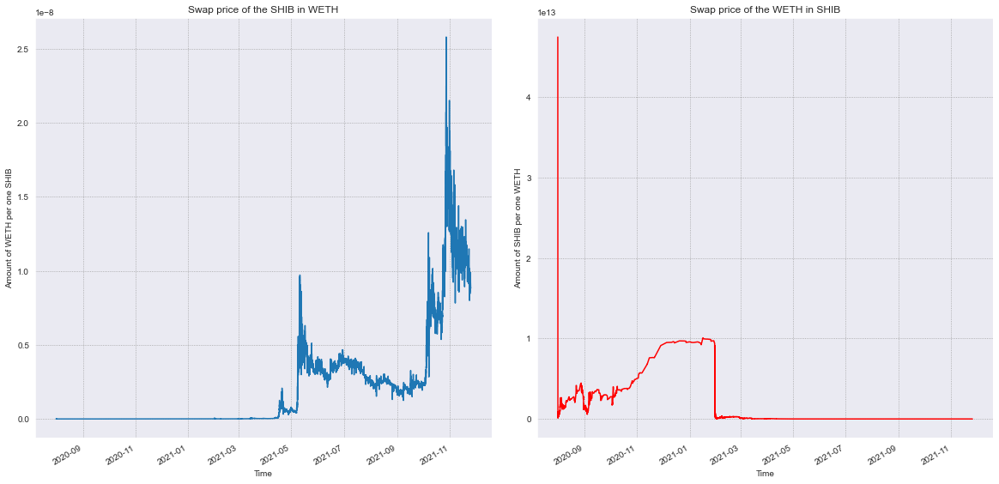

In [215]:
pyplot_line_swap_prices(shib_weth_df, 'SHIB', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

In [216]:
shib_weth_df[shib_weth_df.first_to_second_price == 0]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate


In [217]:
shib_weth_df[(shib_weth_df.timestamp > datetime(2021, 10, 27, 23, 38)) & 
             (shib_weth_df.timestamp < datetime(2021, 10, 27, 23, 42))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,first_to_second_price,price_change_rate
1159277,WETH,SHIB,1.254529e-01,6.108250e+06,495.608857,2021-10-27 23:39:03,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x1a46cf4b0c154d0e0630a73588c0243ff6a8f955,0x40bebf112c801854ea2f82e45459765f203160fa4d0a...,4.868960e+07,-0.123897
1159278,WETH,SHIB,1.878144e-02,9.147479e+05,74.183018,2021-10-27 23:39:03,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xe66b31678d6c16e9ebf358268a790b763c133750,0x955df95b7e85462f62a2f6bcd6c479f21ea469875205...,4.870488e+07,0.031381
1159279,WETH,SHIB,1.252096e-01,6.098870e+06,494.553456,2021-10-27 23:39:03,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xe66b31678d6c16e9ebf358268a790b763c133750,0x9b32ce3ee5954bce894aca55b254b4c52ace9d5ded43...,4.870927e+07,0.009031
1159280,WETH,SHIB,1.784250e-01,8.689095e+06,704.807527,2021-10-27 23:39:03,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x74de5d4fcbf63e00296fd95d33236b9794016631,0xcb06d0e0d1537c79f176d16eaebe76d770f21f280d68...,4.869887e+07,-0.021365
1159281,WETH,SHIB,5.182177e-02,2.522901e+06,204.724888,2021-10-27 23:39:15,0x27239549dd40e1d60f5b80b0c4196923745b1fd2,0x4e47383dac65afe68561571961b6c0e761ef85b4,0x5390d02aa6d15dad2894b4a1e6786cb6a95cc55f4a3f...,4.868419e+07,-0.030143
1159282,WETH,SHIB,1.504716e-01,7.324658e+06,594.446578,2021-10-27 23:39:20,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xe66b31678d6c16e9ebf358268a790b763c133750,0xf497f4c63f12398ddd981d802ae83c0834ce2b9a26b4...,4.867802e+07,-0.012658
1159283,WETH,SHIB,1.249180e-02,6.079566e+05,49.356779,2021-10-27 23:39:30,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xe66b31678d6c16e9ebf358268a790b763c133750,0x0af03bd6e57c6a6b3d6fcf5f84252022356ac6f5bcd5...,4.866846e+07,-0.019639
1159284,WETH,SHIB,7.523578e-02,3.661811e+06,297.266694,2021-10-27 23:39:30,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xe66b31678d6c16e9ebf358268a790b763c133750,0xd10f8fa6bb7570486dd0ea034ae08bcd78744dfed2b1...,4.867114e+07,0.005499
1159285,WETH,SHIB,1.980000e-02,9.622593e+05,78.198384,2021-10-27 23:39:43,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xe66b31678d6c16e9ebf358268a790b763c133750,0x093c603a29bd5fc17f1842b1a34fea822633520153ef...,4.859895e+07,-0.148317
1159286,WETH,SHIB,6.200000e-01,3.010725e+07,2449.080988,2021-10-27 23:39:43,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x6b44d3d563b8f1d870403ed2fbc01142be6f0edd,0x254adb46793130fc3755983d42f9ab00b613253c08ee...,4.856008e+07,-0.079990


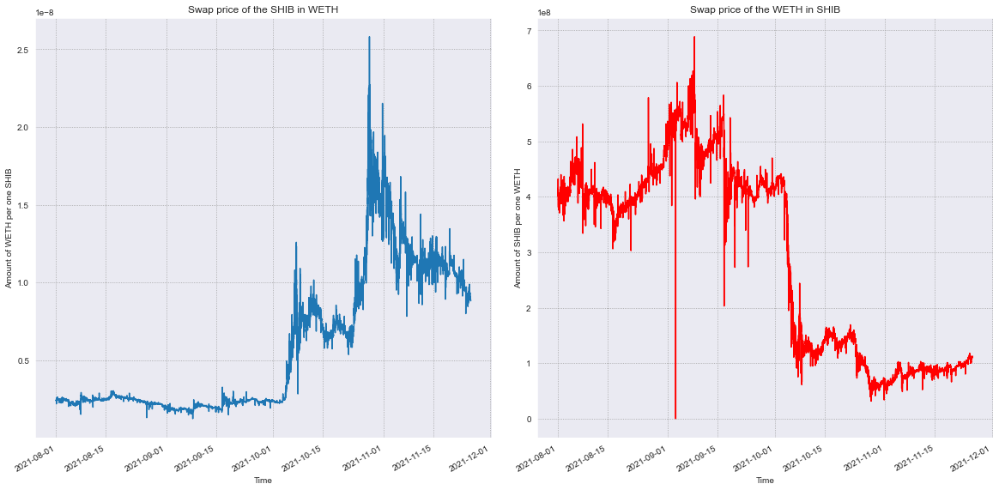

In [218]:
pyplot_line_swap_prices(shib_weth_df[shib_weth_df.timestamp > datetime(2021, 8, 1)], 
                        'SHIB', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

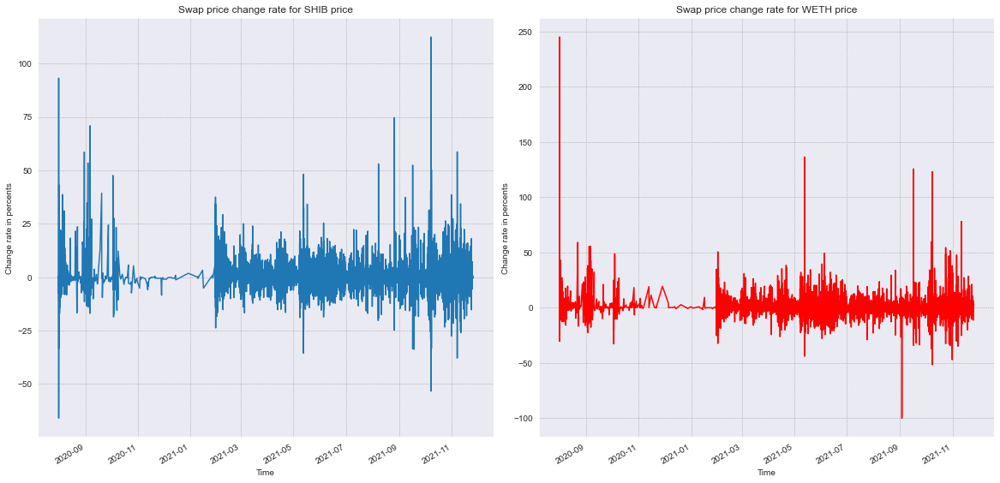

In [219]:
pyplot_line_swap_change_rate(shib_weth_df[(shib_weth_df.first_to_second_price != 0) & 
                                          (shib_weth_df.price_change_rate < 1000000)], 
                             'SHIB', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


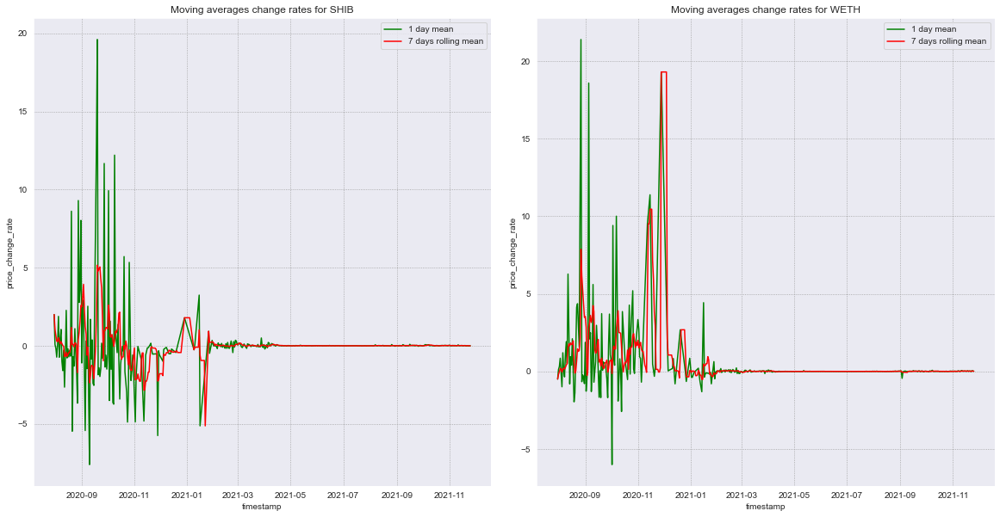

In [220]:
swaps_price_change_rates_moving_averages(shib_weth_df[shib_weth_df.price_change_rate < 2000], 'SHIB', 'WETH', 
                                         'Moving averages change rates for SHIB',
                                        'Moving averages change rates for WETH', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

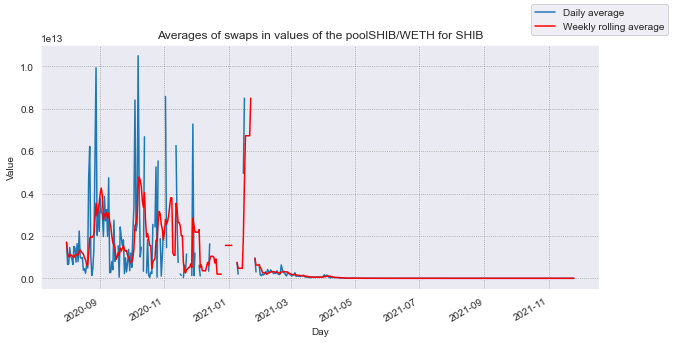

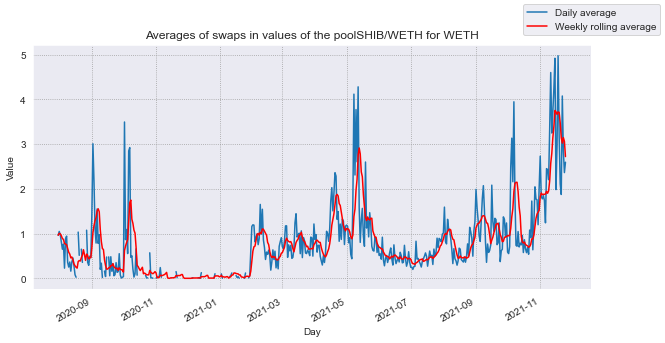

In [221]:
show_swaps_amount_in_moving_averages(swaps_df=shib_weth_df[(shib_weth_df.token_in == 'SHIB')], pool_name="SHIB/WETH for SHIB")
show_swaps_amount_in_moving_averages(swaps_df=shib_weth_df[(shib_weth_df.token_in == 'WETH')], pool_name="SHIB/WETH for WETH")

### Swapping values histograms

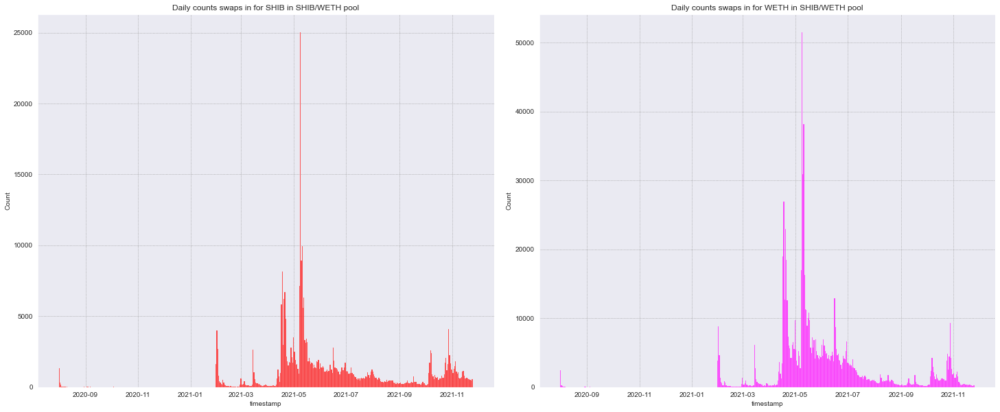

In [222]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=shib_weth_df[shib_weth_df.token_in == 'SHIB'], x='timestamp', 
             bins=(shib_weth_df.timestamp[len(shib_weth_df) - 1] - shib_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for SHIB in SHIB/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=shib_weth_df[shib_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(shib_weth_df.timestamp[len(shib_weth_df) - 1] - shib_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in SHIB/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

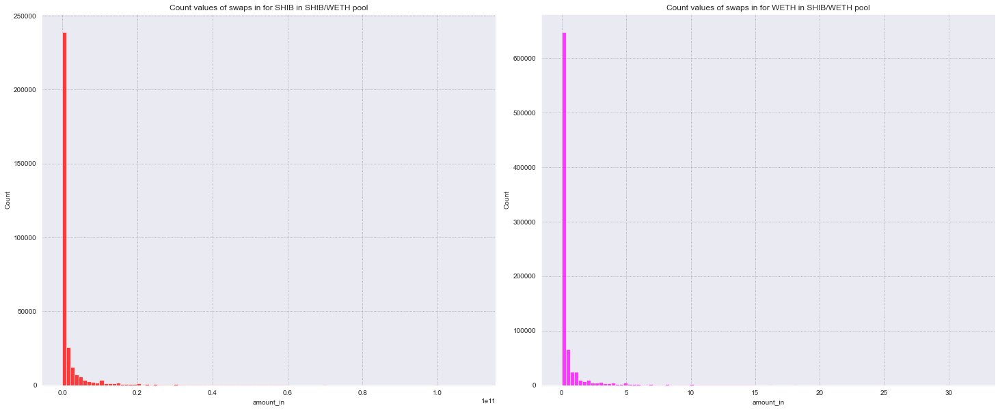

In [223]:
plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
sns.histplot(data=shib_weth_df[shib_weth_df.token_in == 'SHIB'], x='amount_in', bins=100, 
             color='red', binrange=[0, 110000000000]).set_title("Count values of swaps in for SHIB in SHIB/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=shib_weth_df[shib_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta', binrange=[0, 32]).set_title("Count values of swaps in for WETH in SHIB/WETH pool")

plt.subplots_adjust(wspace=0.1)
plt.show()

### Plotting pool reserves

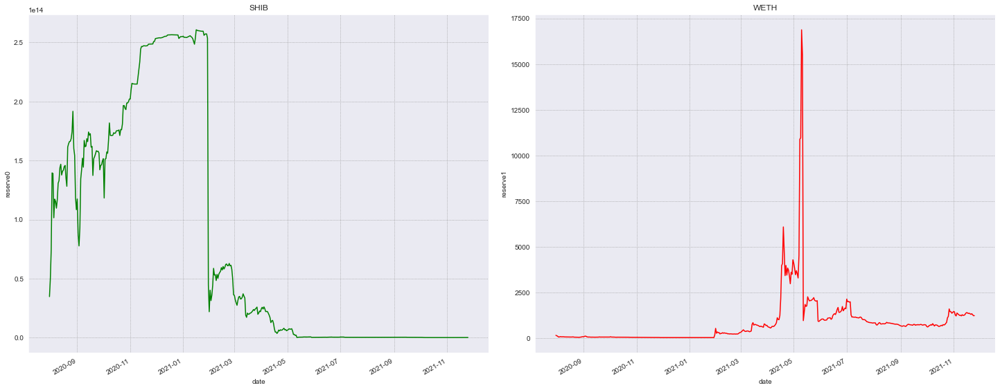

In [224]:
show_reserves_time_distribution(shib_weth_reserves_df, first_token_reserve_name="SHIB", second_token_reserve_name="WETH", x=25, y=10, wspace=0.1)

### Plotting pool price

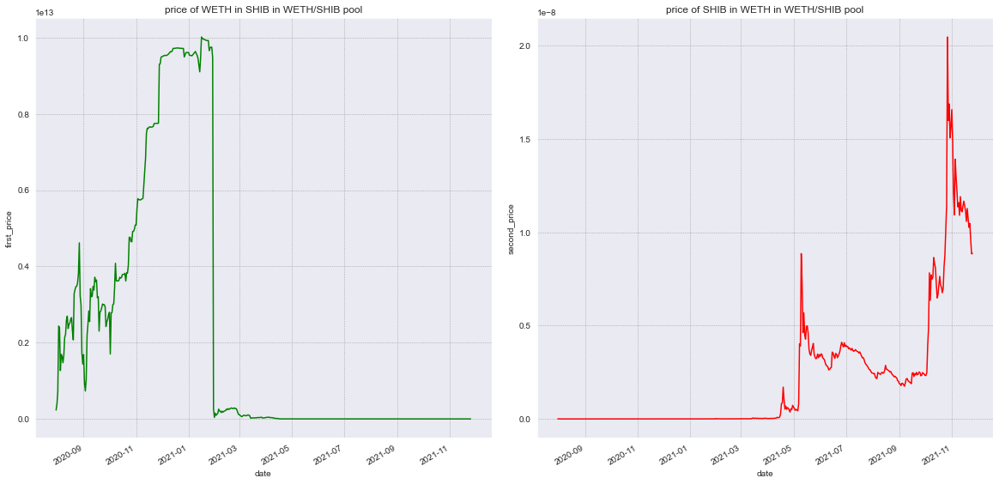

In [225]:
show_reserve_price_distributions(shib_weth_reserves_df, first_token_price_name="price of WETH in SHIB in WETH/SHIB pool", 
                                        second_token_price_name="price of SHIB in WETH in WETH/SHIB pool", x=20, y=10, wspace=0.1)

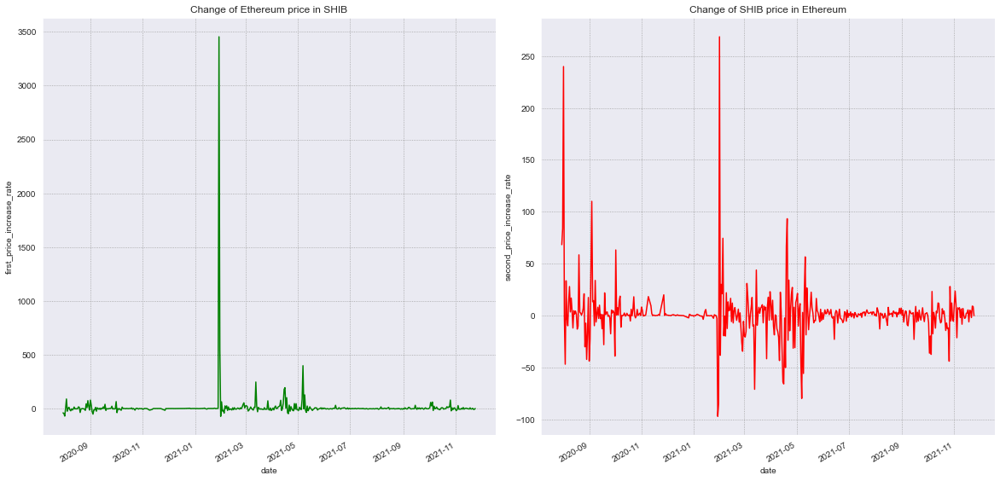

In [226]:
calc_price_and_increase_rates(shib_weth_reserves_df)

fig = plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
sns.lineplot(data=shib_weth_reserves_df, x='date', y='first_price_increase_rate', 
             color='green').set_title('Change of Ethereum price in SHIB')
plt.subplot(1, 2, 2)
sns.lineplot(data=shib_weth_reserves_df, x='date', y='second_price_increase_rate', 
             color='red').set_title('Change of SHIB price in Ethereum')

fig.autofmt_xdate()
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

C:/workspace/data-science//libs\uniswap_v2_tools.py:191: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:197: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


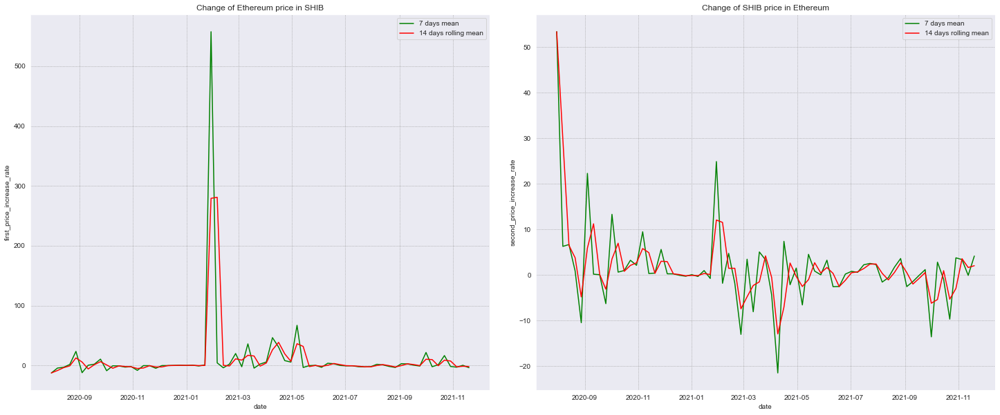

In [227]:
increase_rate_moving_averages(shib_weth_reserves_df, 'Change of Ethereum price in SHIB', 
                              'Change of SHIB price in Ethereum', x_size=25, y_size=10)

# XAUt/WETH (STO)

In [228]:
xaut_weth_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\xaut_weth_swaps.pkl")
xaut_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\xaut_weth_reserves.pkl")
xaut_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\xaut_weth_mints.pkl")
# xaut_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\xaut_weth_burns.pkl")

In [229]:
xaut_weth_mints_df

,amount0,amount1,amountUSD,liquidity,timestamp
0,2.000000,9.700000,3809.102773,4.404543e-06,2020-08-25 09:17:35
1,1.123192,5.447481,4310.404854,2.473574e-06,2020-08-25 11:03:09
2,3.000000,14.550000,11031.125400,6.606815e-06,2020-08-25 21:35:49
3,0.336874,1.633839,1241.666742,7.418880e-07,2020-08-25 21:50:02
4,1.081312,5.039151,3712.230849,2.334217e-06,2020-10-16 12:03:43


In [230]:
xaut_weth_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
0,XAUt,WETH,0.050915,0.244277,96.390518,2020-08-28 17:23:19,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x0efb068354c10c070ddd64a0e8eaf8f054df7e26,0xe81173951e5ed16d45c057837a1689d5d49043107874...
1,XAUt,WETH,0.040765,0.192847,76.555744,2020-08-29 13:04:09,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x2b5fc30e00eecec02345e39665a03425595d6e37541d...
2,XAUt,WETH,0.038743,0.181074,69.943045,2020-10-12 18:26:17,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe89f3900de9cff5a77f483ac980e36fe5808341a9b87...
3,XAUt,WETH,0.007973,0.037006,15.295573,2020-10-24 16:45:17,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x2cd2d275cdb237e696c60419109fac5f331484e1,0x9f4db3d4bd5df6908d6bf11645dc5fee4d660d9fc6f6...
4,XAUt,WETH,0.056348,0.259366,100.422505,2020-11-01 00:29:07,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x142b42c33eaed7aa0df1ba629e4932be82eccfd2c152...
5,XAUt,WETH,0.013219,0.060300,23.270928,2020-11-01 05:48:22,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xedaedd22e653c504ff6806bf61664292848eb26e,0x4271554075ad9ded6d7bf343eb5863ff6fb2efee93e5...
6,XAUt,WETH,0.266727,1.174339,533.796306,2020-11-16 17:17:10,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xa5e79baee540f000ef6f23d067cd3ac22c7d9fe6,0x8776b6b0a5aa4b5f5ca2dbcecad090dd13a9381ec62f...
7,XAUt,WETH,0.044158,0.186922,95.788356,2020-11-21 10:40:52,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x22f9dcf4647084d6c31b2765f6910cd85c178c18,0xd0d5dc5a34de1a9e203dbaf98f5933a0ac7beb145a2d...
8,XAUt,WETH,1.295523,4.700667,2641.260732,2020-11-23 22:05:53,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x72fd50eff7b67343f9e7c2fb64e19576ef1fdd8aa27a...
9,XAUt,WETH,0.017000,0.053045,31.415128,2020-12-02 00:55:21,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xed09fedb24c4ed9df203ef98bb67718145abdaddfd21...


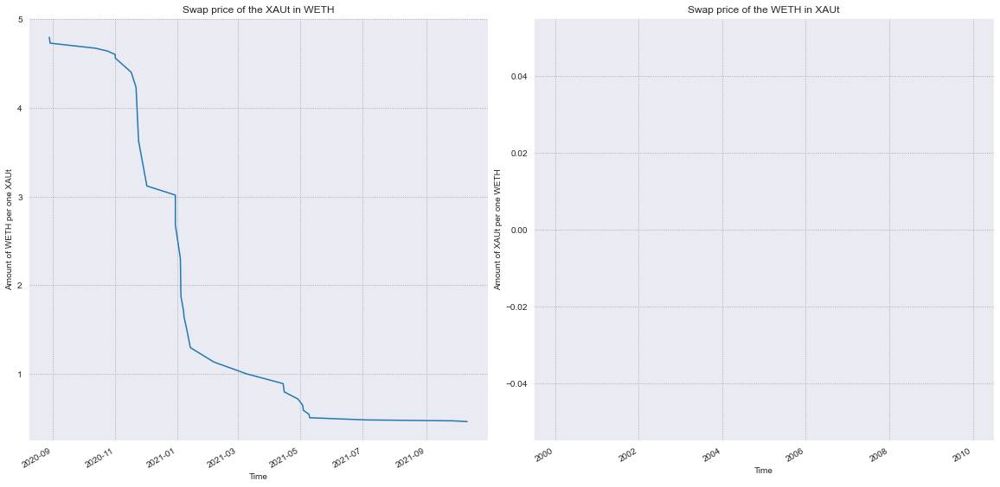

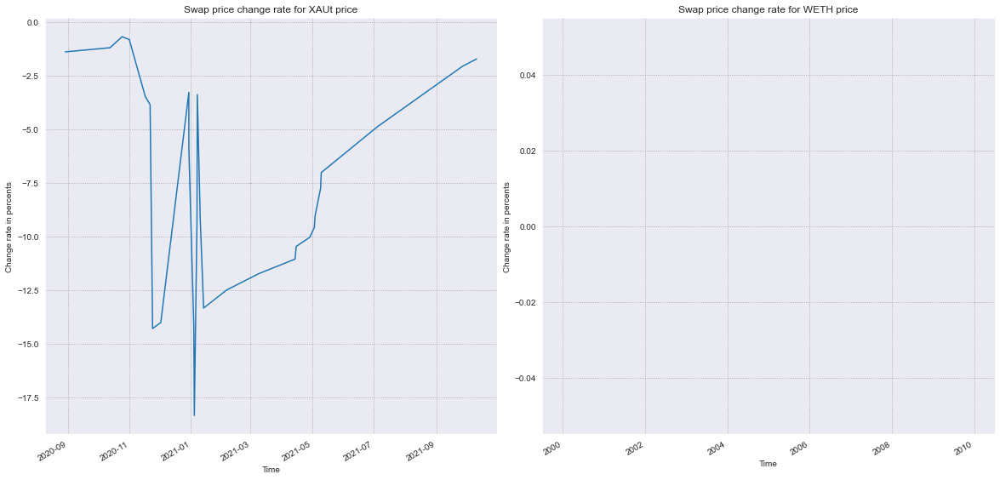

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


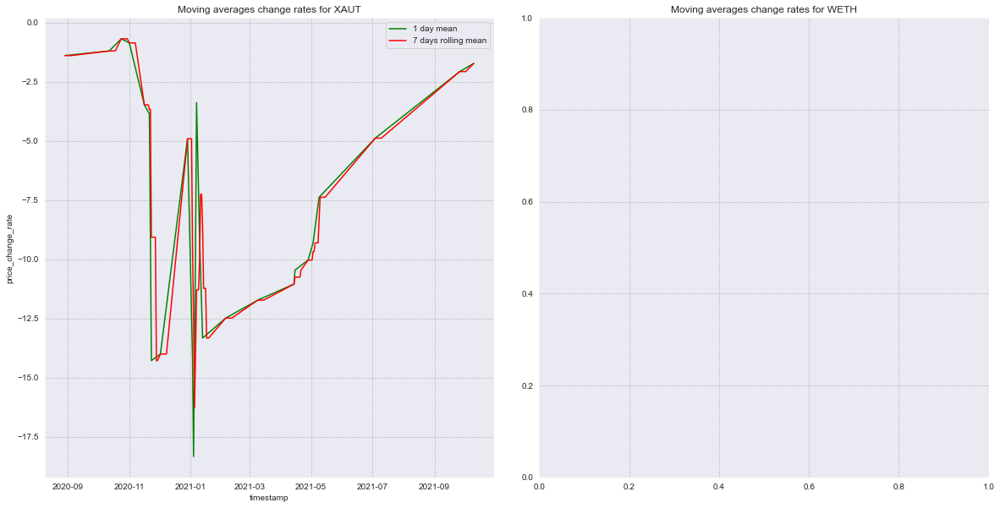

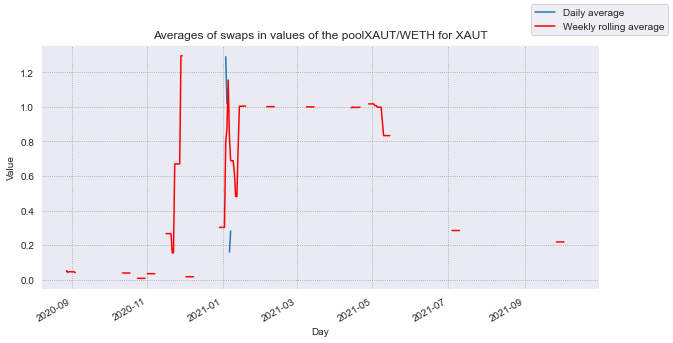

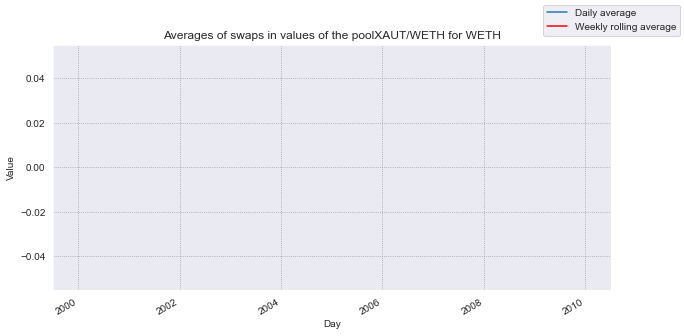

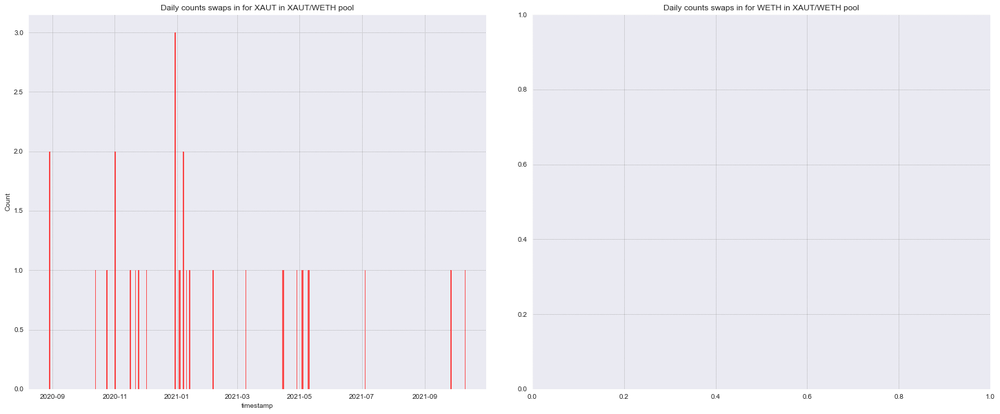

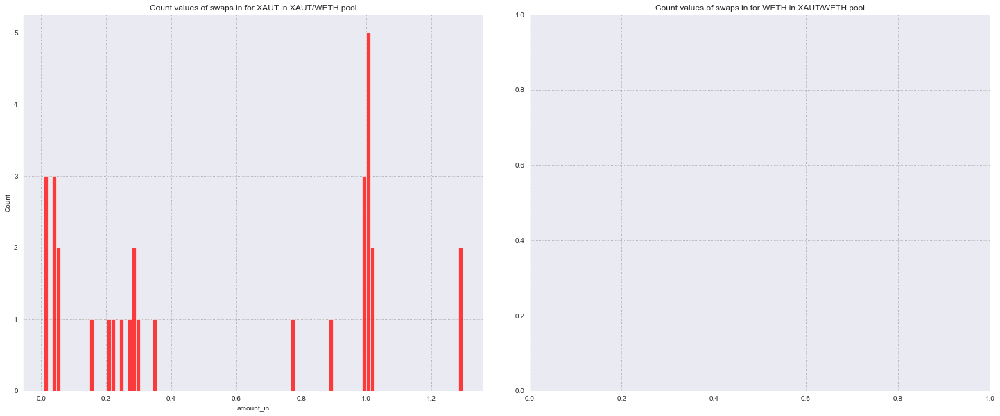

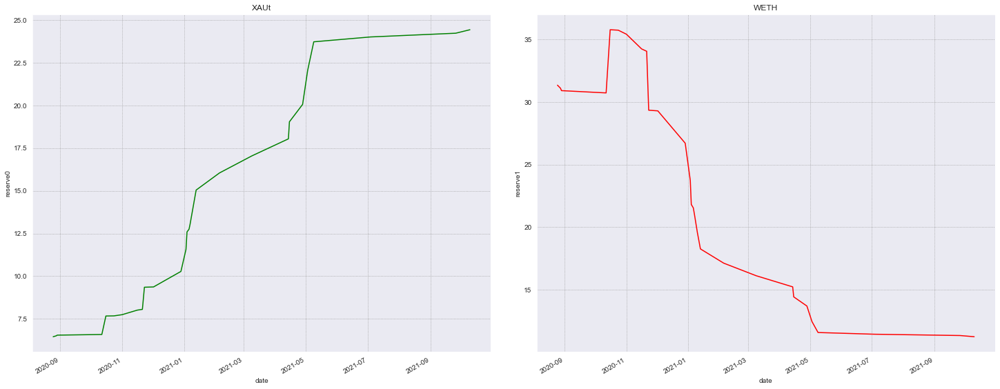

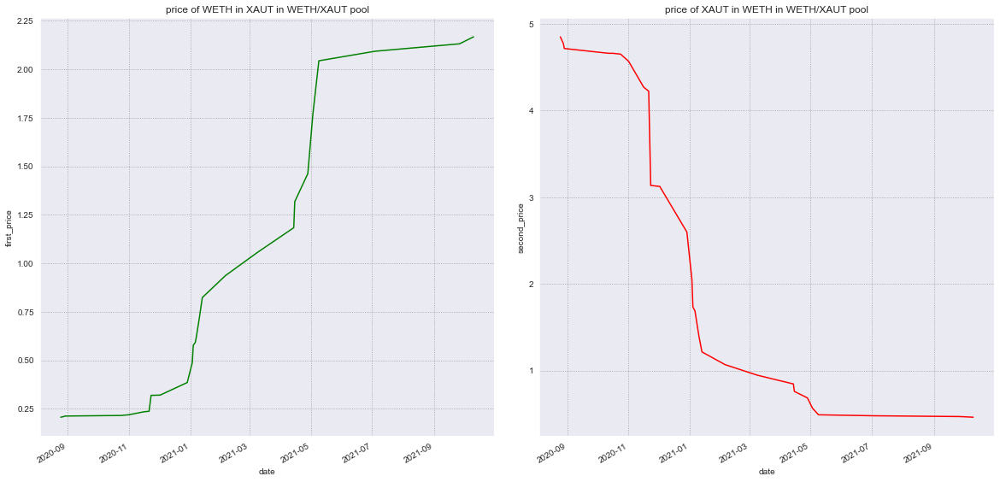

In [231]:
xaut_weth_df = get_df_with_swap_prices_and_change_rates(xaut_weth_df, 'XAUt', 'WETH')

pyplot_line_swap_prices(xaut_weth_df, 'XAUt', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

pyplot_line_swap_change_rate(xaut_weth_df, 'XAUt', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

swaps_price_change_rates_moving_averages(xaut_weth_df, 'XAUt', 'WETH', 'Moving averages change rates for XAUT',
                                           'Moving averages change rates for WETH', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

show_swaps_amount_in_moving_averages(swaps_df=xaut_weth_df[(xaut_weth_df.token_in == 'XAUt')], 
                                     pool_name="XAUT/WETH for XAUT")
show_swaps_amount_in_moving_averages(swaps_df=xaut_weth_df[(xaut_weth_df.token_in == 'WETH')], 
                                     pool_name="XAUT/WETH for WETH")

# swapping values histograms
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=xaut_weth_df[xaut_weth_df.token_in == 'XAUt'], x='timestamp', 
             bins=(xaut_weth_df.timestamp[len(xaut_weth_df) - 1] - xaut_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for XAUT in XAUT/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=xaut_weth_df[xaut_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(xaut_weth_df.timestamp[len(xaut_weth_df) - 1] - xaut_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in XAUT/WETH pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

# swapping in values distribution
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=xaut_weth_df[xaut_weth_df.token_in == 'XAUt'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for XAUT in XAUT/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=xaut_weth_df[xaut_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for WETH in XAUT/WETH pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

show_reserves_time_distribution(xaut_weth_reserves_df,
                                           first_token_reserve_name="XAUt", 
                                           second_token_reserve_name="WETH", x=25, y=10, wspace=0.1)

show_reserve_price_distributions(xaut_weth_reserves_df, 
                                        first_token_price_name="price of WETH in XAUT in WETH/XAUT pool", 
                                        second_token_price_name="price of XAUT in WETH in WETH/XAUT pool", 
                                        x=20, y=10, wspace=0.1)

# UMA/FEI (STO)

In [232]:
uma_fei_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\uma_fei_swaps.pkl")
uma_fei_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\uma_fei_reserves.pkl")
uma_fei_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\uma_fei_mints.pkl")
# uma_fei_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\uma_fei_burns.pkl")

In [233]:
uma_fei_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
0,FEI,UMA,29763.930711,2028.431898,30431.699497,2021-11-23 23:19:21,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0x9545c5bc50defba38e1cb3d15efdbeb5ab81912e06fa...
1,FEI,UMA,14991.490675,1016.008106,15284.783538,2021-11-23 23:20:54,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0x4756c2afc0a426a358fc48596b1105458296d08bae40...
2,FEI,UMA,14923.378191,1007.647675,15228.232087,2021-11-24 00:58:28,0x8698d9d5ea99809c00426484a80be2add4e54581,0x157dfa656fdf0d18e1ba94075a53600d81cb3a97,0xec06f0c0627a48c286675dab3b52b12162e276fdc1c7...
3,UMA,FEI,997.650000,14687.223241,14841.633179,2021-11-24 02:47:58,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0x94b0a3d511b6ecdb17ebf877278ab030acb0a878,0xf5bb16d17347ac05b7cb88082d2ccba93a35193b4372...
4,UMA,FEI,1448.948091,21236.062724,21465.493801,2021-11-24 03:32:20,0x8698d9d5ea99809c00426484a80be2add4e54581,0xbb2e5c2ff298fd96e166f90c8abacaf714df14f8,0xfee2383f6e7cc0d6cb0f53229dc636cb0dc756112e31...
5,UMA,FEI,2946.875181,42845.977124,43498.665360,2021-11-24 03:33:29,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0x52ee629a9565a7b0ea163f3903abfc5d59c45542e463...
6,UMA,FEI,1775.024141,25587.611383,25599.227151,2021-11-24 06:55:44,0x27239549dd40e1d60f5b80b0c4196923745b1fd2,0x94b0a3d511b6ecdb17ebf877278ab030acb0a878,0xb3e6b5c9f401d00c1eafe1f0f44407c88e3ba947b5a1...
7,UMA,FEI,1957.490510,28028.298659,28273.346926,2021-11-24 10:02:48,0x27239549dd40e1d60f5b80b0c4196923745b1fd2,0x27239549dd40e1d60f5b80b0c4196923745b1fd2,0x74bf221fb2d4b73efcec4dc575eddae5b6f287dd13e6...
8,UMA,FEI,2125.189821,30206.672027,30404.757931,2021-11-24 10:09:55,0x27239549dd40e1d60f5b80b0c4196923745b1fd2,0x27239549dd40e1d60f5b80b0c4196923745b1fd2,0xc554eb631f2770a867f8e1234e4537c44c3a1df948cd...
9,UMA,FEI,1774.996477,25053.190464,25228.564157,2021-11-24 11:12:16,0x27239549dd40e1d60f5b80b0c4196923745b1fd2,0x27239549dd40e1d60f5b80b0c4196923745b1fd2,0xc91588ba1f2073a128fa75f08edf3d77ef411e621aca...


C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


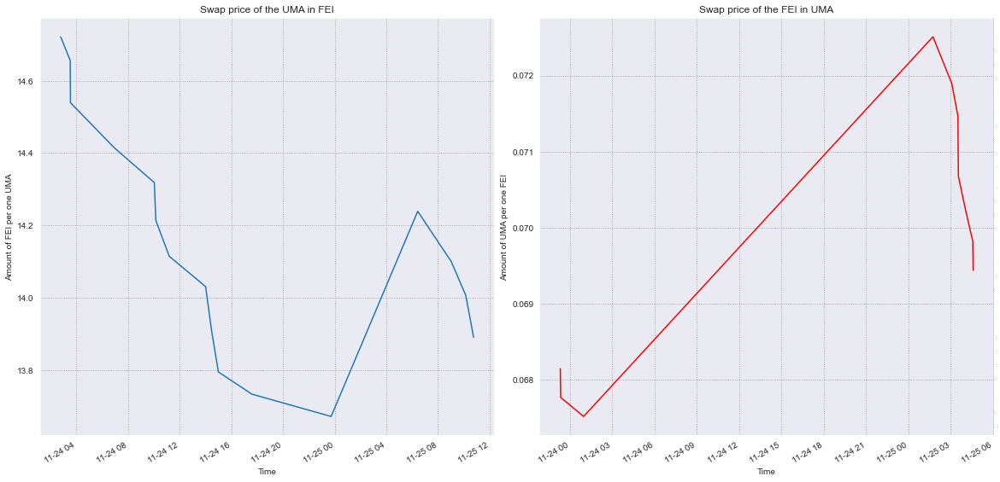

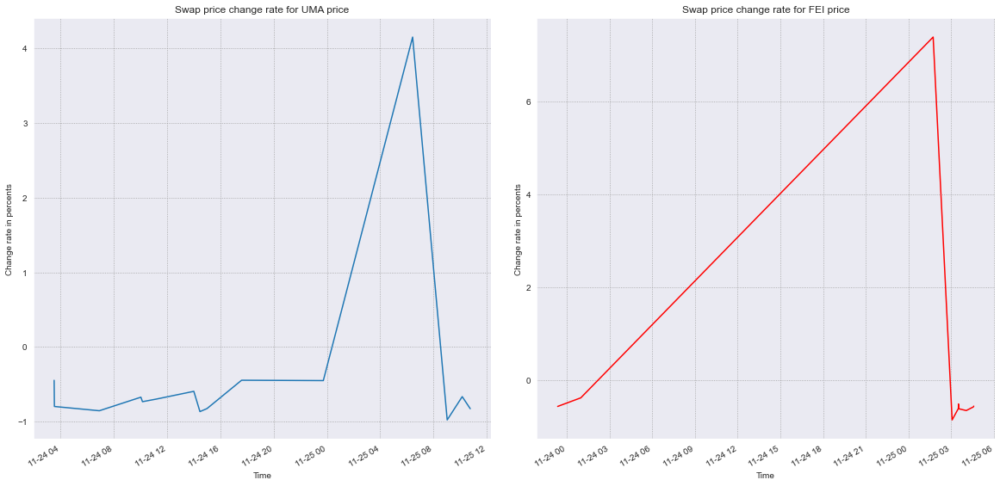

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


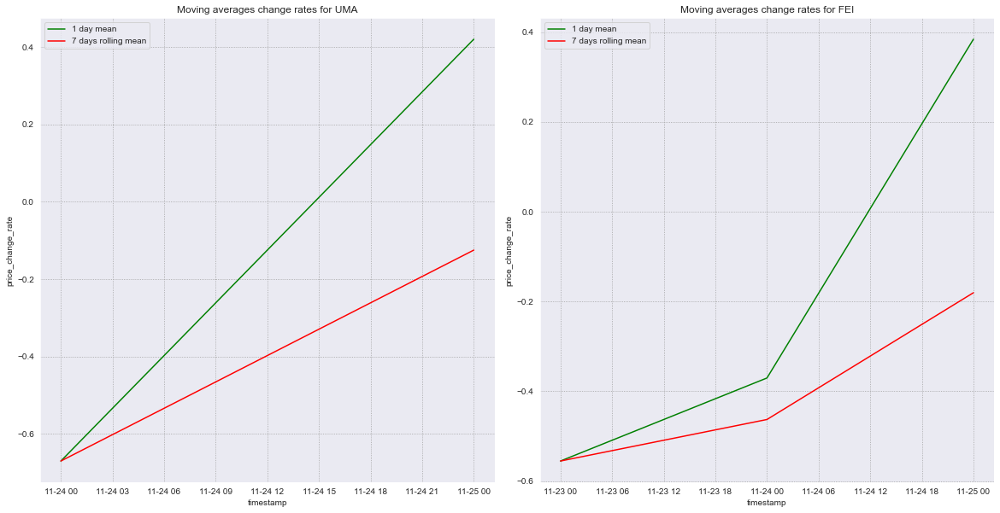

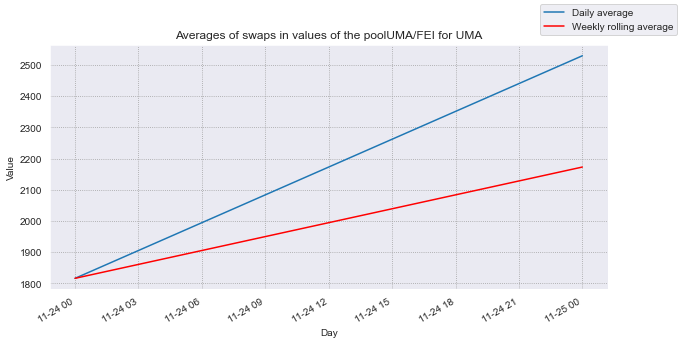

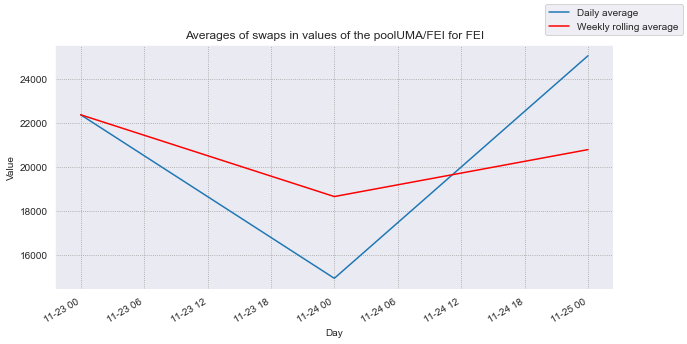

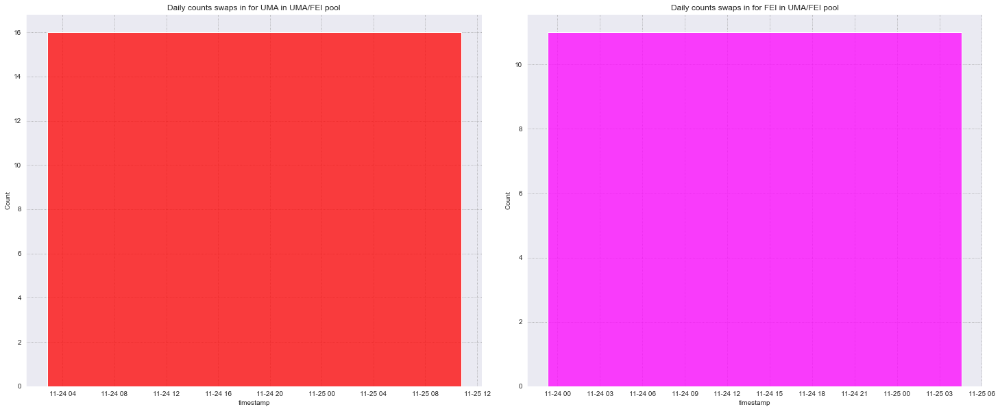

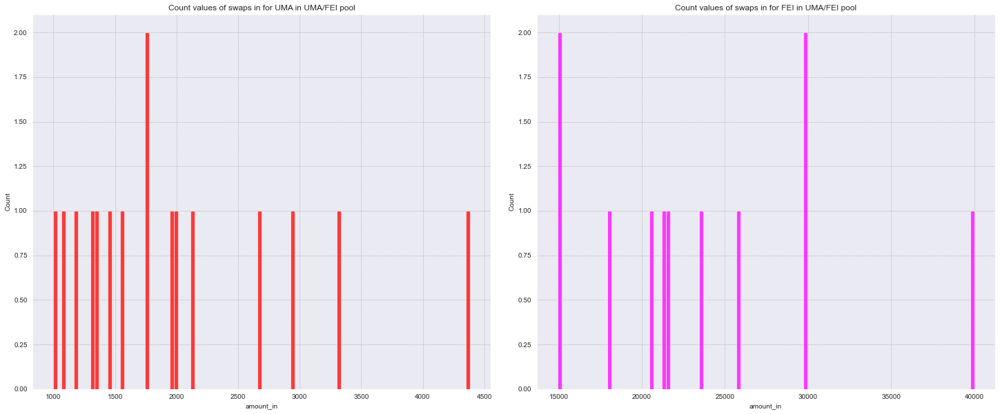

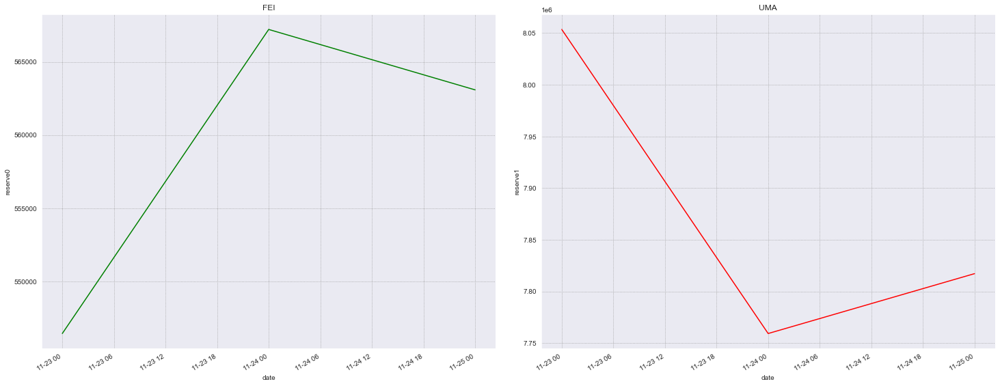

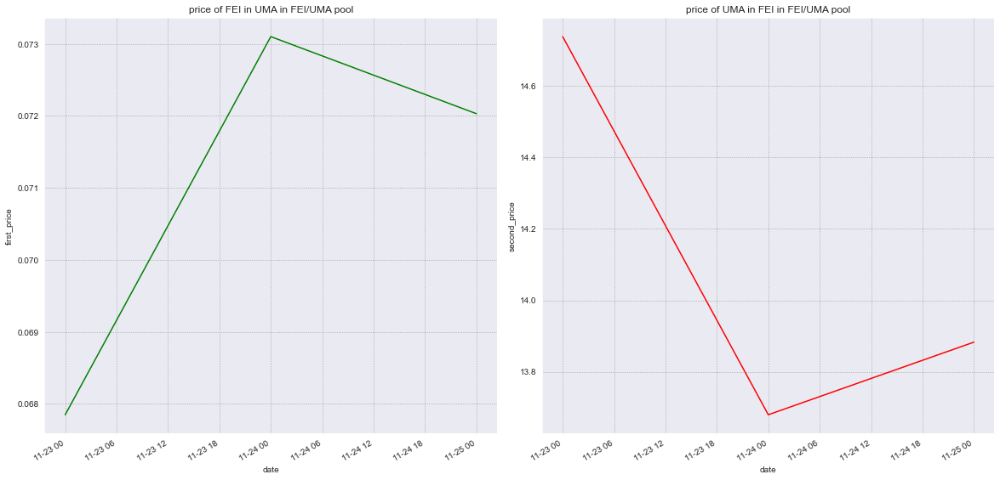

In [234]:
uma_fei_df = get_df_with_swap_prices_and_change_rates(uma_fei_df, 'UMA', 'FEI')

pyplot_line_swap_prices(uma_fei_df, 'UMA', 'FEI', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

pyplot_line_swap_change_rate(uma_fei_df, 'UMA', 'FEI', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

swaps_price_change_rates_moving_averages(uma_fei_df, 'UMA', 'FEI', 'Moving averages change rates for UMA',
                                           'Moving averages change rates for FEI', x_size=20, y_size=10, 
                                           wspace=0.1, hspace=0.1)

show_swaps_amount_in_moving_averages(swaps_df=uma_fei_df[(uma_fei_df.token_in == 'UMA')], pool_name="UMA/FEI for UMA")
show_swaps_amount_in_moving_averages(swaps_df=uma_fei_df[(uma_fei_df.token_in == 'FEI')], 
                                     pool_name="UMA/FEI for FEI")

# swapping values histograms
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=uma_fei_df[uma_fei_df.token_in == 'UMA'], x='timestamp', 
             bins=(uma_fei_df.timestamp[len(uma_fei_df) - 1] - uma_fei_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for UMA in UMA/FEI pool")
plt.subplot(1, 2, 2)
sns.histplot(data=uma_fei_df[uma_fei_df.token_in == 'FEI'], x='timestamp', 
             bins=(uma_fei_df.timestamp[len(uma_fei_df) - 1] - uma_fei_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for FEI in UMA/FEI pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

# swapping in values distribution
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=uma_fei_df[uma_fei_df.token_in == 'UMA'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for UMA in UMA/FEI pool")
plt.subplot(1, 2, 2)
sns.histplot(data=uma_fei_df[uma_fei_df.token_in == 'FEI'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for FEI in UMA/FEI pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

show_reserves_time_distribution(uma_fei_reserves_df,
                                           first_token_reserve_name="FEI", 
                                           second_token_reserve_name="UMA", x=25, y=10, wspace=0.1)

show_reserve_price_distributions(uma_fei_reserves_df, 
                                        first_token_price_name="price of FEI in UMA in FEI/UMA pool", 
                                        second_token_price_name="price of UMA in FEI in FEI/UMA pool", 
                                        x=20, y=10, wspace=0.1)

# PERL/WETH (STO)

In [235]:
perl_weth_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\perl_weth_swaps.pkl")
perl_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\perl_weth_reserves.pkl")
perl_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\perl_weth_mints.pkl")
perl_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\perl_weth_burns.pkl")

In [236]:
perl_weth_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
0,WETH,PERL,1.000000,408.979034,202.663354,2020-08-20 07:31:20,0x21e479e62603a3ea0b6dc687cb86b9938d39a3dd,0x21e479e62603a3ea0b6dc687cb86b9938d39a3dd,0x259920fbd70f1fb6081890bc61f3d04bb65f7fdb71be...
1,WETH,PERL,0.330000,9.444516,66.865797,2020-08-20 07:31:33,0x90b98c3db94f6d2a088a3d7e4c86e15a39f8ee0d,0x90b98c3db94f6d2a088a3d7e4c86e15a39f8ee0d,0xa2579b1d7d65a6196165219ce988979ed0c07a0ed4cb...
2,WETH,PERL,0.100000,2.058032,20.248495,2020-08-20 07:34:18,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x21f1d0daa58f49a0a03855966e79026d2001d00e,0x394e02caf2236dabe102ee16f563e438cc6dc4fa8c44...
3,WETH,PERL,0.111533,2.000000,22.576193,2020-08-20 07:37:55,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xc26da32095985cd03201103bf400fc8058621240,0xa7b8b130b5441fbf6aa77fe37c893ec9d9c76ae375e6...
4,PERL,WETH,2.058032,0.113905,23.020060,2020-08-20 07:41:29,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb69d1b70c6d0059ff0ec29acf0dc39756dd5c38c90f2...
...,...,...,...,...,...,...,...,...,...
1529,PERL,WETH,70201.678416,1.730590,7353.996463,2021-11-24 23:14:13,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0xbbe7cdeeaf0d55c054097ad4c8aa777a38714d402650...
1530,PERL,WETH,41395.008270,0.984122,4220.791473,2021-11-25 05:27:14,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbf5ae133b9a0fc1a07952a7df2afa21f7f69ef58,0x6c1756fe2e08651e279d5a64b258d182135465cddc98...
1531,WETH,PERL,0.516205,21720.443798,2212.233302,2021-11-25 05:34:22,0xa1006d0051a35b0000f961a8000000009ea8d2db,0xa1006d0051a35b0000f961a8000000009ea8d2db,0x2a7fff98154aec80dec5c1a1cdc098322061e7eaef96...
1532,PERL,WETH,39265.021300,0.922462,3963.355895,2021-11-25 08:32:36,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbf5ae133b9a0fc1a07952a7df2afa21f7f69ef58,0xc11b8124be745c228541257826e88e0ad7a46f815a53...


In [237]:
perl_weth_mints_df[['amount0', 'amount1', 'timestamp']]

,amount0,amount1,timestamp
0,0.100000,4.500000e+02,2020-08-20 07:31:20
1,0.184215,2.819900e+03,2020-09-29 17:26:24
2,0.002946,6.350000e+01,2020-11-06 17:48:44
3,0.458411,1.366484e+04,2020-11-15 03:28:53
4,4.000000,5.134500e+04,2021-03-17 16:13:30
5,0.709776,7.977305e+03,2021-04-22 04:32:40
6,1.000000,1.917393e+04,2021-05-03 04:26:02
7,2.427751,1.000000e+05,2021-08-05 10:25:44
8,67.660000,2.412971e+06,2021-08-05 13:24:54
9,4.497954,1.654781e+05,2021-08-05 14:17:20


In [238]:
perl_weth_df[perl_weth_df.timestamp > datetime(2021, 8, 5)]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
503,PERL,WETH,1050.000000,0.026010,33.881406,2021-08-05 10:20:54,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xac6314a6b7efa760eeeba12f5b020cd268638f78543f...
504,WETH,PERL,0.180000,7035.601644,482.361650,2021-08-05 11:43:43,0xc176761d388caf2f56cf03329d82e1e7c48ae09c,0xc176761d388caf2f56cf03329d82e1e7c48ae09c,0xb96ca8f75bff6932c500ab62c858c2a4f09765706563...
505,WETH,PERL,0.162432,5790.032837,435.307088,2021-08-05 12:28:14,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0x0000000000007f150bd6f54c40a34d7c3d5e9f56,0x1fe7a277f2fb62238c1cdda7e9d74de2ee3252e68bf7...
506,WETH,PERL,0.070000,2348.686598,181.889547,2021-08-05 12:57:16,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0x8fa26a72d65fbd1bc8fc34135dd6d79841900344,0x070d4cbb4259bae9f66db9a1023392dfb489193ff35a...
507,PERL,WETH,8400.000000,0.238086,604.677960,2021-08-05 13:13:55,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x14196279b53ed8a2e287b7575fde0742c4732e421ecc...
...,...,...,...,...,...,...,...,...,...
1529,PERL,WETH,70201.678416,1.730590,7353.996463,2021-11-24 23:14:13,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0x220bda5c8994804ac96ebe4df184d25e5c2196d4,0xbbe7cdeeaf0d55c054097ad4c8aa777a38714d402650...
1530,PERL,WETH,41395.008270,0.984122,4220.791473,2021-11-25 05:27:14,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbf5ae133b9a0fc1a07952a7df2afa21f7f69ef58,0x6c1756fe2e08651e279d5a64b258d182135465cddc98...
1531,WETH,PERL,0.516205,21720.443798,2212.233302,2021-11-25 05:34:22,0xa1006d0051a35b0000f961a8000000009ea8d2db,0xa1006d0051a35b0000f961a8000000009ea8d2db,0x2a7fff98154aec80dec5c1a1cdc098322061e7eaef96...
1532,PERL,WETH,39265.021300,0.922462,3963.355895,2021-11-25 08:32:36,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbf5ae133b9a0fc1a07952a7df2afa21f7f69ef58,0xc11b8124be745c228541257826e88e0ad7a46f815a53...


In [239]:
perl_weth_burns_df

,amount0,amount1,amountUSD,liquidity,timestamp
0,0.168286,3152.146958,61.360317,22.653158,2020-10-16 20:45:28
1,0.512509,12226.335932,234.545693,77.502604,2020-11-15 03:31:26
2,4.955154,42139.409144,18322.008027,433.261162,2021-03-31 18:12:31
3,1.188370,40797.542986,7648.119458,201.282176,2021-08-25 23:15:04


In [240]:
perl_weth_reserves_df

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date
0,0.153498,2.958885e+02,62.347684,3.435517,1.087056e+03,2020-08-20
1,0.081605,5.573478e+02,33.663391,0.071893,2.614593e+02,2020-08-21
2,0.091605,4.966680e+02,33.233211,0.010000,6.067977e+01,2020-09-13
3,0.054551,8.350475e+02,19.107331,0.037054,3.383795e+02,2020-09-26
4,0.211676,4.124108e+03,75.807403,0.027090,4.691610e+02,2020-09-29
...,...,...,...,...,...,...
243,80.799774,2.850057e+06,697804.883043,212.875288,7.081302e+06,2021-11-21
244,76.170139,3.025013e+06,620158.020751,14.806463,5.753920e+05,2021-11-22
245,72.524184,3.178264e+06,631014.898615,9.120572,3.901169e+05,2021-11-23
246,74.652832,3.089421e+06,634461.717019,14.935974,5.796793e+05,2021-11-24


C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


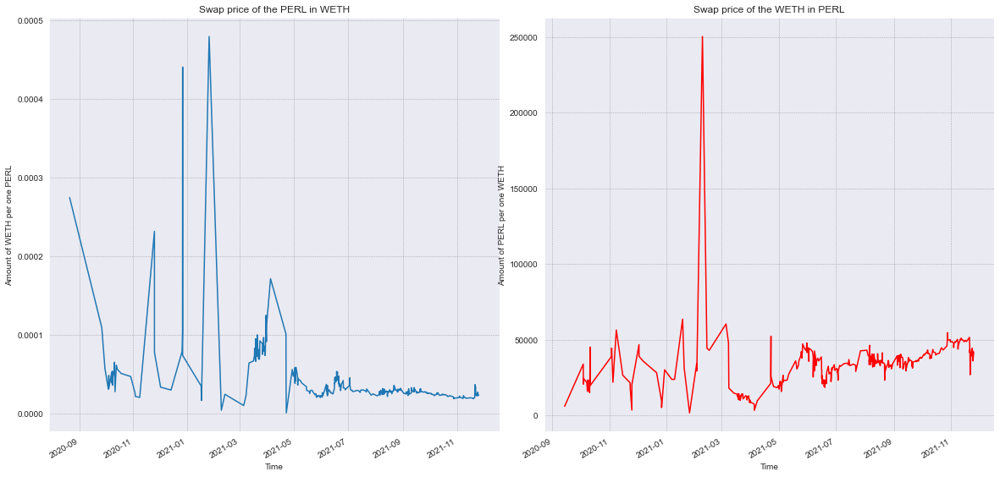

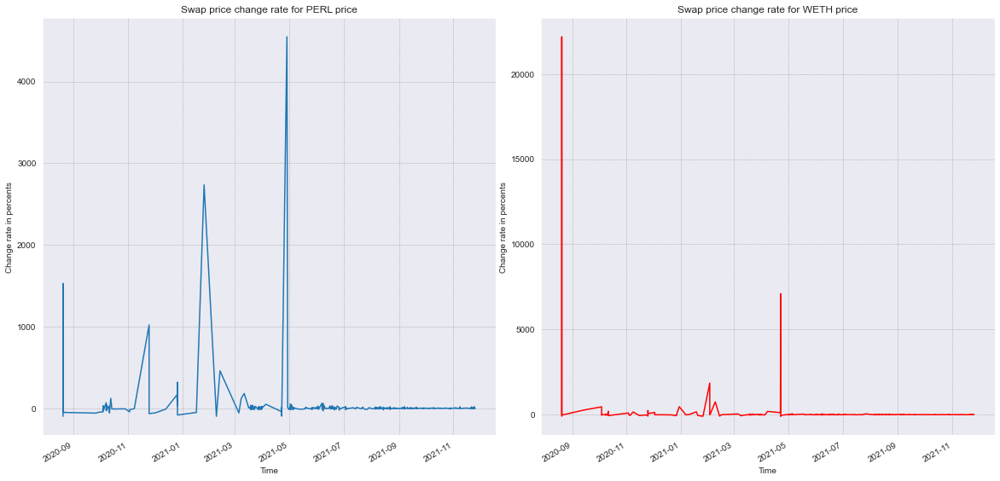

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


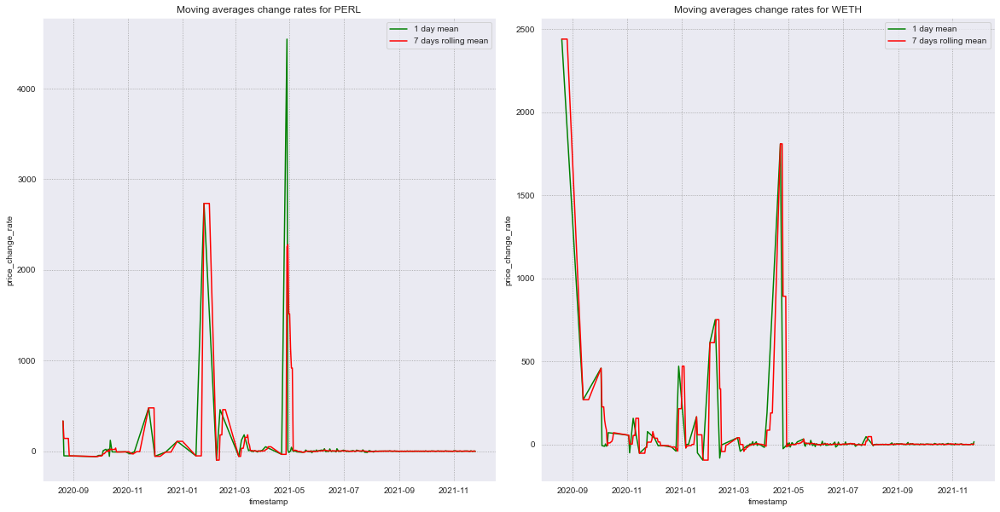

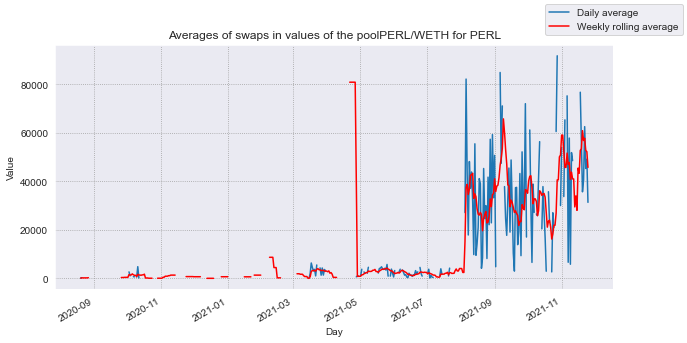

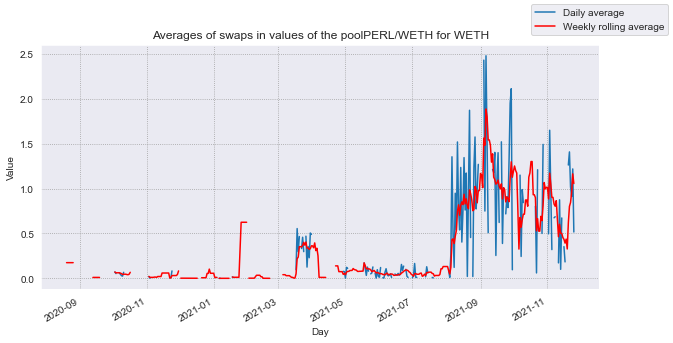

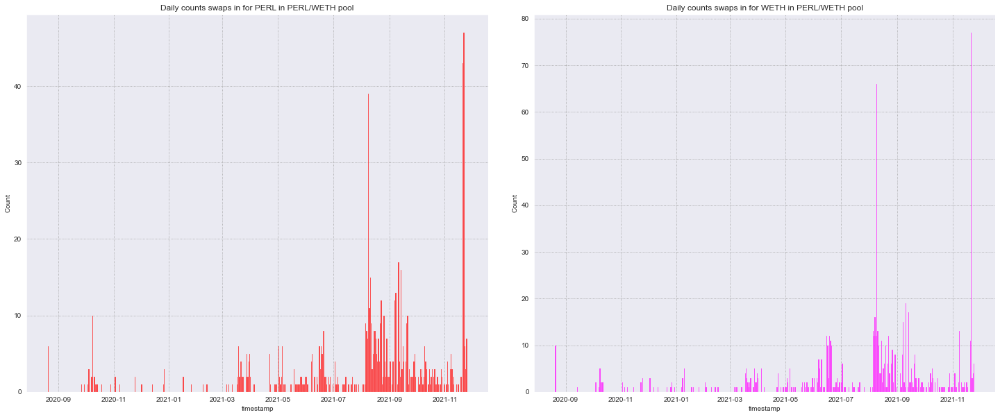

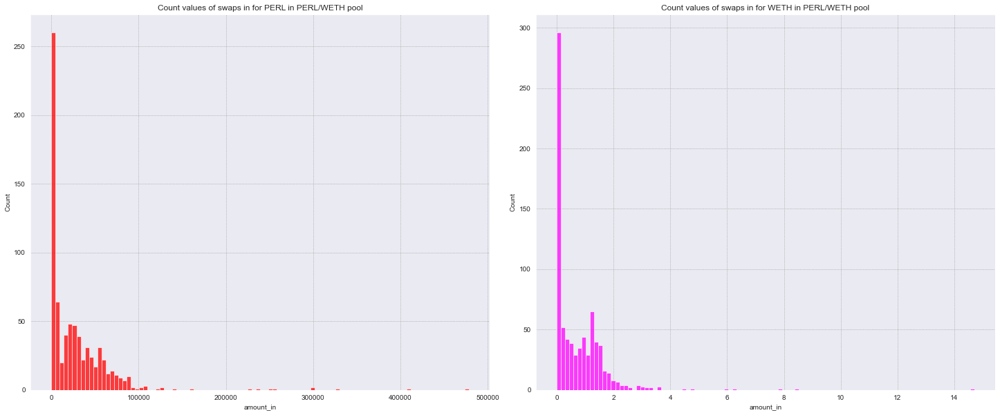

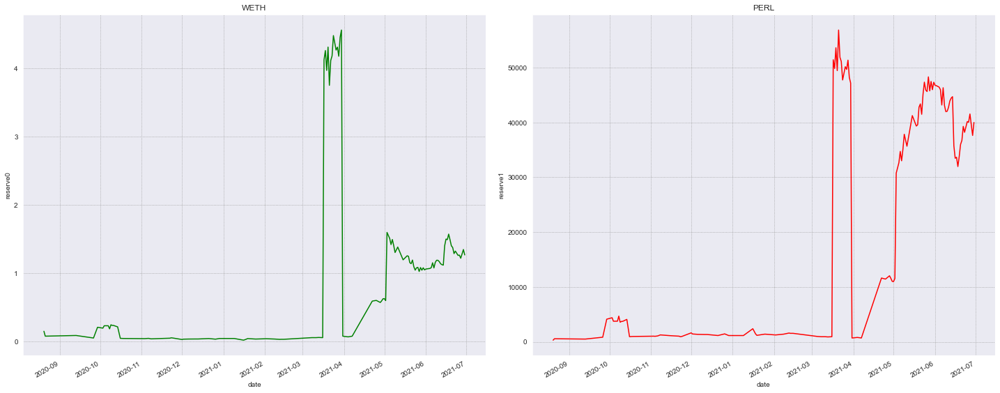

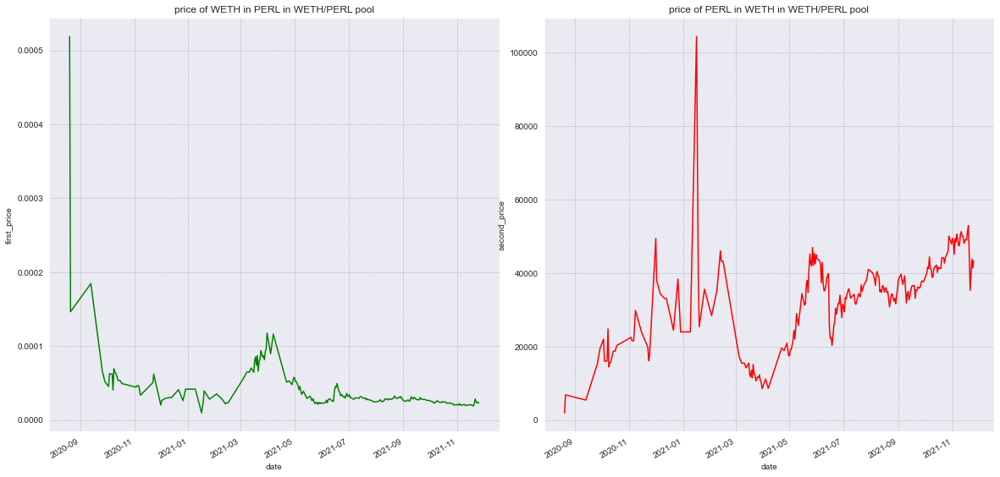

In [241]:
perl_weth_df = get_df_with_swap_prices_and_change_rates(perl_weth_df, 'PERL', 'WETH')

pyplot_line_swap_prices(perl_weth_df[(perl_weth_df.timestamp > datetime(2020, 8, 21)) & 
                                      (perl_weth_df.first_to_second_price < 1000000)], 
                        'PERL', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

pyplot_line_swap_change_rate(perl_weth_df, 'PERL', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

swaps_price_change_rates_moving_averages(perl_weth_df, 'PERL', 'WETH', 'Moving averages change rates for PERL',
                                           'Moving averages change rates for WETH', x_size=20, y_size=10, 
                                           wspace=0.1, hspace=0.1)

show_swaps_amount_in_moving_averages(swaps_df=perl_weth_df[(perl_weth_df.token_in == 'PERL')], 
                                     pool_name="PERL/WETH for PERL")
show_swaps_amount_in_moving_averages(swaps_df=perl_weth_df[(perl_weth_df.token_in == 'WETH')], 
                                     pool_name="PERL/WETH for WETH")

# swapping values histograms
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=perl_weth_df[perl_weth_df.token_in == 'PERL'], x='timestamp', 
             bins=(perl_weth_df.timestamp[len(perl_weth_df) - 1] - perl_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for PERL in PERL/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=perl_weth_df[perl_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(perl_weth_df.timestamp[len(perl_weth_df) - 1] - perl_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in PERL/WETH pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

# swapping in values distribution
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=perl_weth_df[perl_weth_df.token_in == 'PERL'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for PERL in PERL/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=perl_weth_df[perl_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for WETH in PERL/WETH pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

show_reserves_time_distribution(perl_weth_reserves_df[perl_weth_reserves_df.date < datetime(2021, 7, 1)],
                                           first_token_reserve_name="WETH", 
                                           second_token_reserve_name="PERL", x=25, y=10, wspace=0.1)

show_reserve_price_distributions(perl_weth_reserves_df, 
                                        first_token_price_name="price of WETH in PERL in WETH/PERL pool", 
                                        second_token_price_name="price of PERL in WETH in WETH/PERL pool", 
                                        x=20, y=10, wspace=0.1)

# BPT/WETH (STO)

In [242]:
bpt_weth_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\bpt_weth_swaps.pkl")
bpt_weth_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\bpt_weth_reserves.pkl")
bpt_weth_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\bpt_weth_mints.pkl")
bpt_weth_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\bpt_weth_burns.pkl")

In [243]:
bpt_weth_df[(bpt_weth_df.timestamp > datetime(2020, 6, 28, 0)) & 
            (bpt_weth_df.timestamp < datetime(2020, 6, 29, 0))]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
1679,WETH,BPT,0.785395,0.144970,172.630418,2020-06-28 00:29:44,0xf1ad4bfdf8829d55ec0ce7900ef9d122b2610673,0xf1ad4bfdf8829d55ec0ce7900ef9d122b2610673,0x792d27ff02c30601a91805d6feb7a866c7caf5af492e...
1680,BPT,WETH,0.244607,1.310709,285.438417,2020-06-28 00:47:49,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0xbd75e9077e7d420d4f679180a340f573bcd89d444db2...
1681,WETH,BPT,2.000000,0.368657,441.448686,2020-06-28 02:08:25,0xeca2e07abc83c78a7178c46b84962af86de342ff,0xeca2e07abc83c78a7178c46b84962af86de342ff,0x3ff801df572d420d858536aa4ef88c6b337a6124683c...
1682,WETH,BPT,2.000000,0.355175,441.371286,2020-06-28 02:08:25,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xaf2996a693bc46eb82c62cb9a0ef01a02986097f,0xbd3cfd2adcaa64a208e53b2657f55cc2f2189166bd51...
1683,BPT,WETH,0.368657,2.062279,447.984319,2020-06-28 02:08:25,0xeca2e07abc83c78a7178c46b84962af86de342ff,0xeca2e07abc83c78a7178c46b84962af86de342ff,0xe28c1e8985a5c5e8d97acdb5436d2d3f415f28e04366...
...,...,...,...,...,...,...,...,...,...
1973,BPT,WETH,100.000000,1.589892,311.153796,2020-06-28 23:58:41,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xcf99961bfbbc7ceaa744fc460d814cb118cf91cd3204...
1974,WETH,BPT,0.179904,10.000000,41.015644,2020-06-28 23:59:08,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xa17b0da8f2abc2973bc928ffeb4b1065427c30a7,0x931dc9b1f98aeec8de936b300b6c755ed30ac88bbf06...
1975,BPT,WETH,8.508639,0.145043,32.215190,2020-06-28 23:59:12,0x693c188e40f760ecf00d2946ef45260b84fbc43e,0x693c188e40f760ecf00d2946ef45260b84fbc43e,0xa14afca117120eae6e7cac258c3260cb9df3c830816d...
1976,BPT,WETH,8.372399,0.150515,33.425996,2020-06-28 23:59:12,0x693c188e40f760ecf00d2946ef45260b84fbc43e,0x693c188e40f760ecf00d2946ef45260b84fbc43e,0xf2153d15e988200359eeadf2a463ddbaa37d5009a850...


In [244]:
print(bpt_weth_df[(bpt_weth_df.index > 1700) & (bpt_weth_df.index < 1850) & 
                  (bpt_weth_df.token_in == 'BPT')]['amount_out'].sum())
print(bpt_weth_df[(bpt_weth_df.index > 1700) & (bpt_weth_df.index < 1850) & 
                  (bpt_weth_df.token_in == 'WETH')]['amount_in'].sum())

170.8054075413052
90.68834507991619


In [245]:
bpt_weth_df[(bpt_weth_df.index > 1720) & 
            (bpt_weth_df.index < 1850) & 
            (bpt_weth_df.token_in == 'BPT')]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
1721,BPT,WETH,0.004215,0.024040,5.424104,2020-06-28 15:58:01,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xe644ae0d7640ed2838e97a3a0689e9bf50627eab,0xba5acdb334e420ed9dbaa469fbbb226ef2bdaeee98e8...
1722,BPT,WETH,0.267191,1.500000,335.551931,2020-06-28 16:08:49,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x22e6869b5d7a895bcaa6b75d6b00378699ef9ea5ec54...
1725,BPT,WETH,0.121490,0.680867,153.222975,2020-06-28 17:11:22,0x000000000025d4386f7fb58984cbe110aee3a4c4,0x000000000025d4386f7fb58984cbe110aee3a4c4,0x43a7469912b079520f99f8699866bcb03145a2c37d16...
1726,BPT,WETH,0.157132,0.866407,194.780662,2020-06-28 17:12:07,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x1c387372410b4226910b5bac6a9bf5ccbf613990a562...
1729,BPT,WETH,0.474830,2.845818,634.537659,2020-06-28 17:57:22,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x9e5b29aee88011c038cdd0c23f2ce8b3913816af555a...
1730,BPT,WETH,0.301881,1.711233,383.648371,2020-06-28 17:57:45,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0xf164fc0ec4e93095b804a4795bbe1e041497b92a,0x0b5ca2ad19858642b2e5712cd52b97d61602c1524c1b...
1731,BPT,WETH,0.076169,0.441519,99.642952,2020-06-28 17:57:45,0x693c188e40f760ecf00d2946ef45260b84fbc43e,0x693c188e40f760ecf00d2946ef45260b84fbc43e,0x91b907040b92a61c3b5065dbbe935129faf4f402477f...
1733,BPT,WETH,494.784081,92.193342,10763.617011,2020-06-28 18:03:14,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0xe71b7ec874808805f1fd39106ebba7acc6b7533151c9...
1735,BPT,WETH,30.867565,2.265044,464.643724,2020-06-28 18:03:23,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0xe739f130dd8c0e3a86fdc966a6adbb0688319f101992...
1739,BPT,WETH,15.656916,1.572610,335.606901,2020-06-28 18:03:43,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x860bd2dba9cd475a61e6d1b45e16c365f6d78f66,0x1a572ef61d8cd249ec7e020d6f6282b7987a9e737db2...


In [246]:
print(bpt_weth_df[(bpt_weth_df.index > 1679) & 
                  (bpt_weth_df.index < 1977) & 
                  (bpt_weth_df.token_in == 'BPT')]['amount_out'].sum())
print(bpt_weth_df[(bpt_weth_df.index > 1679) & 
                  (bpt_weth_df.index < 1977) & 
                  (bpt_weth_df.token_in == 'WETH')]['amount_in'].sum())

227.1167151118571
138.73205975724926


In [247]:
bpt_weth_reserves_df.head(30)

,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date
0,8.600000e-17,1.174100e-14,5.524124e-12,3.953557e-02,7.049406,2020-05-31
1,3.568712e-01,1.034103e+00,4.988966e+02,7.047119e-01,4.782504,2020-06-06
2,2.933035e-01,1.278057e+00,3.108033e+02,1.694110e+00,7.916374,2020-06-07
3,9.057933e-01,5.475164e+00,2.675147e+03,1.948616e+00,11.165002,2020-06-08
4,7.743387e+00,3.873774e+01,1.891492e+04,7.808211e+00,44.955769,2020-06-09
5,8.807493e+00,3.977696e+01,1.964881e+04,4.789066e+00,22.577652,2020-06-10
6,1.398677e+01,6.559961e+01,3.020782e+04,1.284800e+01,69.235848,2020-06-11
7,2.178437e+01,1.050377e+02,4.987434e+04,1.945987e+01,92.403052,2020-06-12
8,2.195047e+01,1.044094e+02,4.967049e+04,1.154230e+01,58.261771,2020-06-13
9,2.401871e+01,1.117661e+02,5.135073e+04,1.726072e+01,85.201564,2020-06-14


In [248]:
bpt_weth_mints_df

,amount0,amount1,amountUSD,liquidity,timestamp
0,0.020000,10.000000,2354.500343,0.447214,2020-05-31 20:08:08
1,0.001831,0.250000,59.780438,0.021293,2020-06-06 07:04:20
2,0.340693,1.000000,239.076967,0.580127,2020-06-06 07:15:57
3,0.174360,1.000000,486.384907,0.409298,2020-06-08 09:55:18
4,0.167803,1.000000,486.499650,0.401232,2020-06-08 10:06:02
5,0.167803,1.000000,486.602570,0.401232,2020-06-08 10:17:14
6,0.137937,1.000000,486.689204,0.363726,2020-06-08 10:21:09
7,0.571854,2.500000,1215.168223,1.168421,2020-06-09 08:06:05
8,2.287418,10.000000,4860.672890,4.673685,2020-06-09 08:08:58
9,4.346094,19.000000,9201.905567,8.880001,2020-06-09 08:35:19


In [249]:
bpt_weth_burns_df

,amount0,amount1,amountUSD,liquidity,timestamp
0,0.038184,5.250594,2461.568018,0.447214,2020-05-31 21:06:15
1,0.417425,2.000000,945.674491,0.887479,2020-06-13 10:07:00
2,0.119339,0.582595,275.554580,0.256009,2020-06-13 16:50:17
3,3.280877,16.797741,7885.957027,7.204152,2020-06-14 10:14:07
4,2.659988,11.818349,5190.763404,5.436221,2020-06-15 06:32:10
5,2.575563,13.775960,6217.870796,5.772561,2020-06-15 17:54:35
6,0.007609,0.038823,17.953201,0.016500,2020-06-22 02:10:53
7,2.714016,13.339686,6494.472194,5.771805,2020-06-22 18:27:18
8,0.228369,1.126151,543.369184,0.485606,2020-06-23 16:38:16
9,4.187742,20.707012,9628.537045,8.880001,2020-06-25 16:48:59


C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


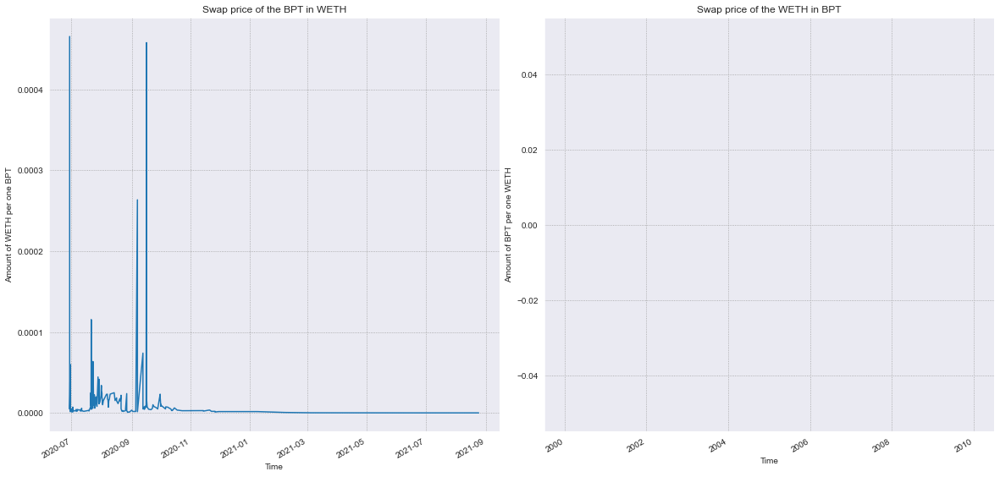

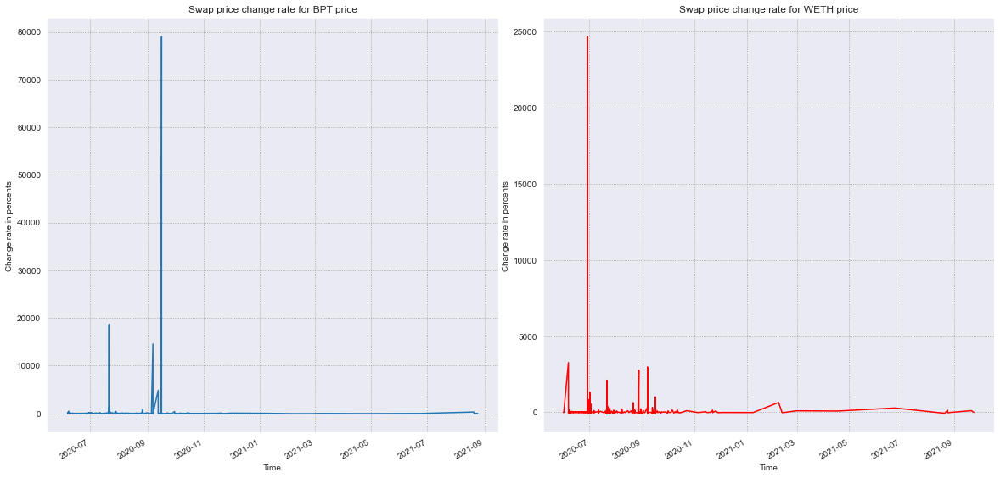

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


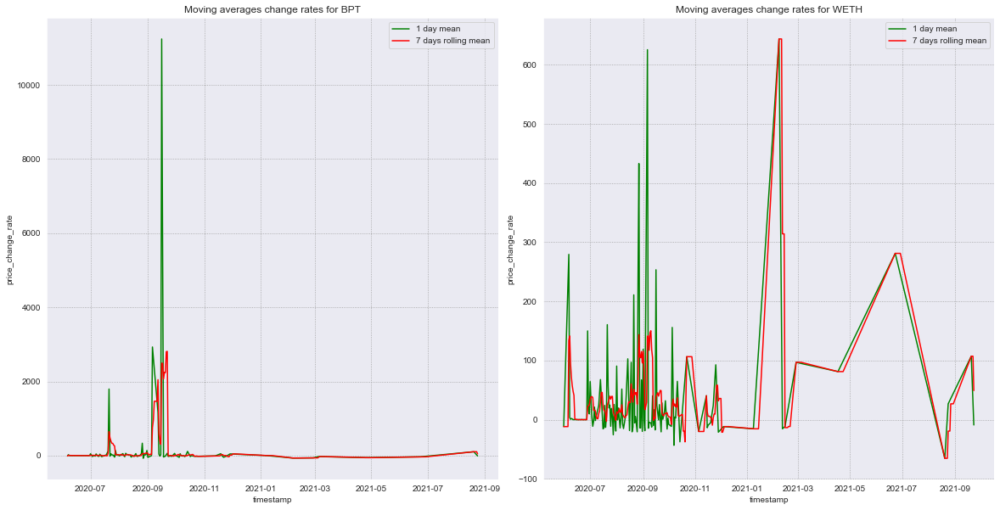

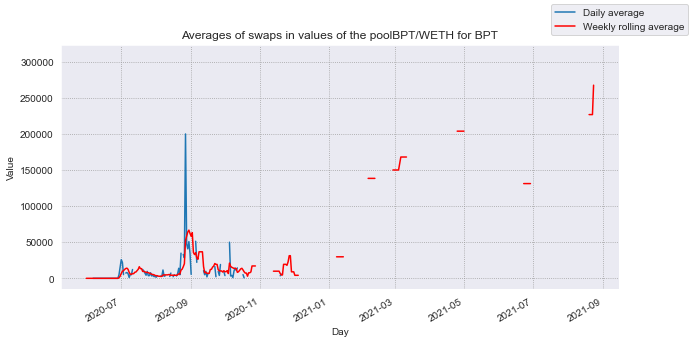

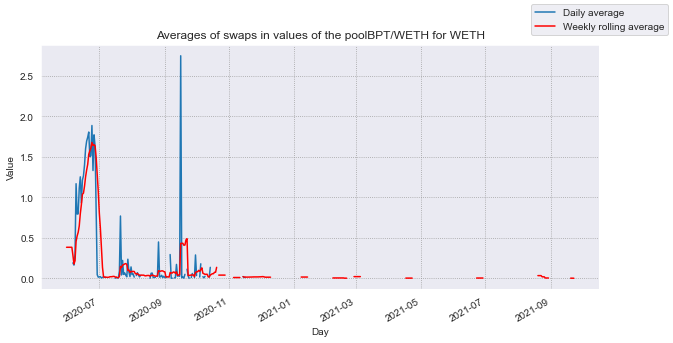

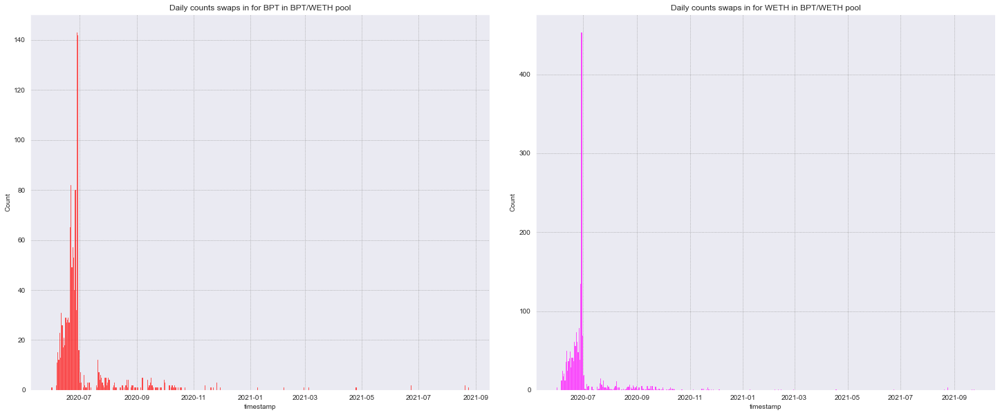

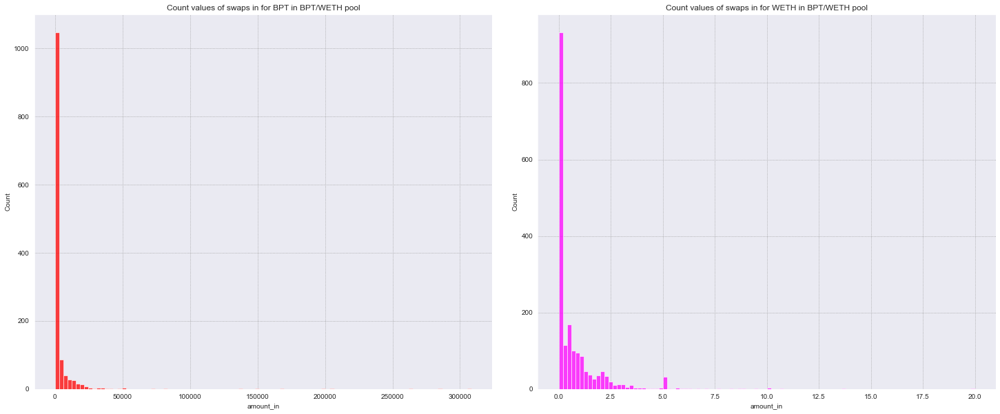

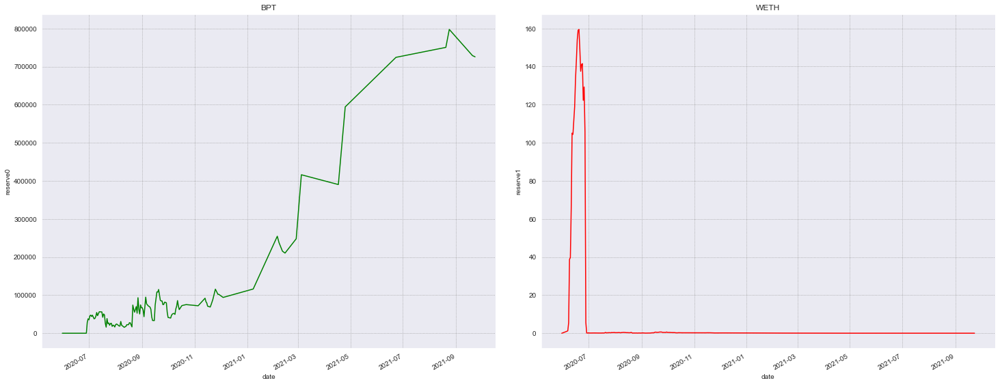

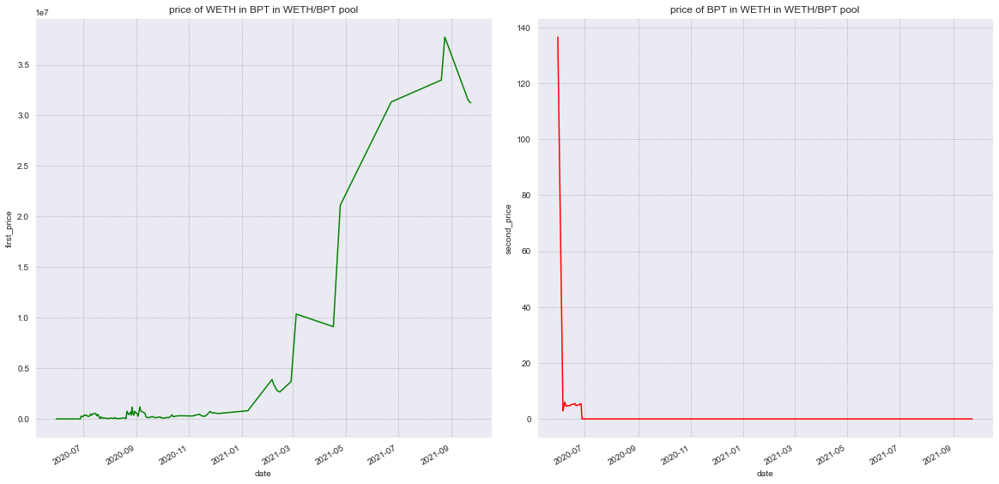

In [250]:
bpt_weth_df = get_df_with_swap_prices_and_change_rates(bpt_weth_df, 'BPT', 'WETH')

pyplot_line_swap_prices(bpt_weth_df[bpt_weth_df.first_to_second_price < 0.0005], 'BPT', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

pyplot_line_swap_change_rate(bpt_weth_df, 'BPT', 'WETH', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

swaps_price_change_rates_moving_averages(bpt_weth_df, 'BPT', 'WETH', 'Moving averages change rates for BPT',
                                           'Moving averages change rates for WETH', x_size=20, y_size=10, 
                                           wspace=0.1, hspace=0.1)

show_swaps_amount_in_moving_averages(swaps_df=bpt_weth_df[(bpt_weth_df.token_in == 'BPT')], 
                                     pool_name="BPT/WETH for BPT")
show_swaps_amount_in_moving_averages(swaps_df=bpt_weth_df[(bpt_weth_df.token_in == 'WETH')], 
                                     pool_name="BPT/WETH for WETH")

# swapping values histograms
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=bpt_weth_df[bpt_weth_df.token_in == 'BPT'], x='timestamp', 
             bins=(bpt_weth_df.timestamp[len(bpt_weth_df) - 1] - bpt_weth_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for BPT in BPT/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=bpt_weth_df[bpt_weth_df.token_in == 'WETH'], x='timestamp', 
             bins=(bpt_weth_df.timestamp[len(bpt_weth_df) - 1] - bpt_weth_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for WETH in BPT/WETH pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

# swapping in values distribution
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=bpt_weth_df[bpt_weth_df.token_in == 'BPT'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for BPT in BPT/WETH pool")
plt.subplot(1, 2, 2)
sns.histplot(data=bpt_weth_df[bpt_weth_df.token_in == 'WETH'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for WETH in BPT/WETH pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

show_reserves_time_distribution(bpt_weth_reserves_df,
                                           first_token_reserve_name="BPT", 
                                           second_token_reserve_name="WETH", x=25, y=10, wspace=0.1)

show_reserve_price_distributions(bpt_weth_reserves_df, 
                                        first_token_price_name="price of WETH in BPT in WETH/BPT pool", 
                                        second_token_price_name="price of BPT in WETH in WETH/BPT pool", 
                                        x=20, y=10, wspace=0.1)

# uSTONKS_APR21/USDC (STO)

In [251]:
stonks_usdc_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\stonks_usdc_swaps.pkl")
stonks_usdc_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\stonks_usdc_reserves.pkl")
stonks_usdc_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\stonks_usdc_mints.pkl")
stonks_usdc_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\stonks_usdc_burns.pkl")

In [252]:
stonks_usdc_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
0,USDC,uSTONKS_APR21,2159.220526,10.000000,2157.435115,2021-03-09 15:01:21,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x9670d11c6bdde4d239f699ac71dd77075c35603d,0xeaf57e2488fdd6b12b0d01ba29f687f2523efe2f1126...
1,USDC,uSTONKS_APR21,909.722591,4.178164,910.537242,2021-03-09 15:03:07,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x64e78ba4baca646f77a6bf7bcbcc5a31fc066ef2,0xdaa555d301b25d8dec1d814a1edf263b25ecf703c00e...
2,USDC,uSTONKS_APR21,8881.277097,40.000000,8903.658224,2021-03-09 15:41:02,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xd2a78bb82389d30075144d17e782964918999f7f,0x749f55e09dfd5ec051ad880919f44c9816b708718d18...
3,USDC,uSTONKS_APR21,225.978716,1.000000,225.626999,2021-03-09 16:10:17,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xf3239400cd2135cf5f99e191018eeb2a6d01eb76,0xbec0e4637d4a85ecbae54044c8b49a26929eca1a91d4...
4,USDC,uSTONKS_APR21,452.519620,2.000000,452.148230,2021-03-09 16:52:44,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x9ebc8ad4011c7f559743eb25705ccf5a9b58d0bc,0xadf350a8ae7c9576db9f875e88081856085159359245...
...,...,...,...,...,...,...,...,...,...
170,uSTONKS_APR21,USDC,0.085158,19.914283,19.936291,2021-06-06 21:24:34,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb4e16d0168e52d35cacd2c6185b44281ec28c9dc,0x1f6998d775b94a8dd2cbc1440aa8b98bc5436037fe8d...
171,uSTONKS_APR21,USDC,2.000000,456.462039,451.857246,2021-06-16 21:32:05,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb4e16d0168e52d35cacd2c6185b44281ec28c9dc,0xaec738f4941021329b4f22a5e3f4ac8b350094da6fea...
172,uSTONKS_APR21,USDC,14.194925,2628.472904,2408.735419,2021-06-16 22:20:28,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0x0990fd97223d006eae1f655e82467fa0ec5f0890,0x5ef7d1d1afae0c0ab474dd86361264bbc984686a4311...
173,USDC,uSTONKS_APR21,1757.054740,10.000000,1873.066834,2021-06-17 14:21:41,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x4481461f5d2cea356855917cd7c213001bbfa087,0xb0dd839a329ed3e0ff8339daacf3a41935ab35cd34b9...


In [253]:
stonks_usdc_df[stonks_usdc_df.timestamp < datetime(2021, 4, 1)]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd
0,USDC,uSTONKS_APR21,2159.220526,10.000000,2157.435115,2021-03-09 15:01:21,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x9670d11c6bdde4d239f699ac71dd77075c35603d,0xeaf57e2488fdd6b12b0d01ba29f687f2523efe2f1126...
1,USDC,uSTONKS_APR21,909.722591,4.178164,910.537242,2021-03-09 15:03:07,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x64e78ba4baca646f77a6bf7bcbcc5a31fc066ef2,0xdaa555d301b25d8dec1d814a1edf263b25ecf703c00e...
2,USDC,uSTONKS_APR21,8881.277097,40.000000,8903.658224,2021-03-09 15:41:02,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xd2a78bb82389d30075144d17e782964918999f7f,0x749f55e09dfd5ec051ad880919f44c9816b708718d18...
3,USDC,uSTONKS_APR21,225.978716,1.000000,225.626999,2021-03-09 16:10:17,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xf3239400cd2135cf5f99e191018eeb2a6d01eb76,0xbec0e4637d4a85ecbae54044c8b49a26929eca1a91d4...
4,USDC,uSTONKS_APR21,452.519620,2.000000,452.148230,2021-03-09 16:52:44,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x9ebc8ad4011c7f559743eb25705ccf5a9b58d0bc,0xadf350a8ae7c9576db9f875e88081856085159359245...
...,...,...,...,...,...,...,...,...,...
96,USDC,uSTONKS_APR21,939.190695,3.584000,940.250009,2021-03-30 22:06:18,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x653d63e4f2d7112a19f5eb993890a3f27b48ada5,0x76e3ca2fdcfdbcbd7eff52200940f5abba3c6b46bdae...
97,USDC,uSTONKS_APR21,524.625070,2.000000,524.313370,2021-03-31 05:44:10,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x828cad2d3a81cc04425cc73d551211edda1ab687,0xe46d13cf5c4a9154be69ce51c88d7c8097e263f54472...
98,USDC,uSTONKS_APR21,260.616433,0.993000,260.532392,2021-03-31 05:46:04,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x828cad2d3a81cc04425cc73d551211edda1ab687,0xb7b0189ec3bde062385453dc7e8c7c94c99ea859d258...
99,USDC,uSTONKS_APR21,89.255653,0.340000,89.303843,2021-03-31 15:08:46,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x576b1c2d113c634d5849181442aec5a3a9148c1e,0x193972b6018d106268cc953ef5618812b033766a0576...


C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


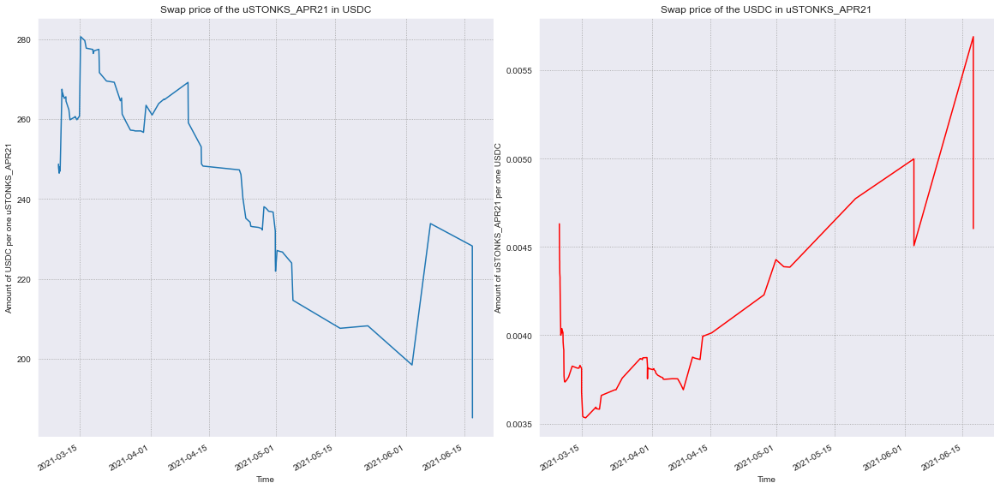

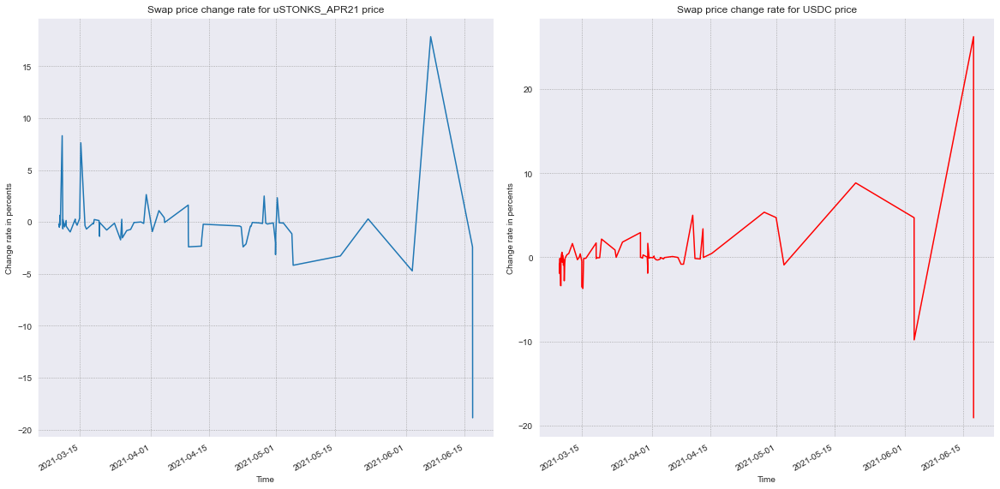

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


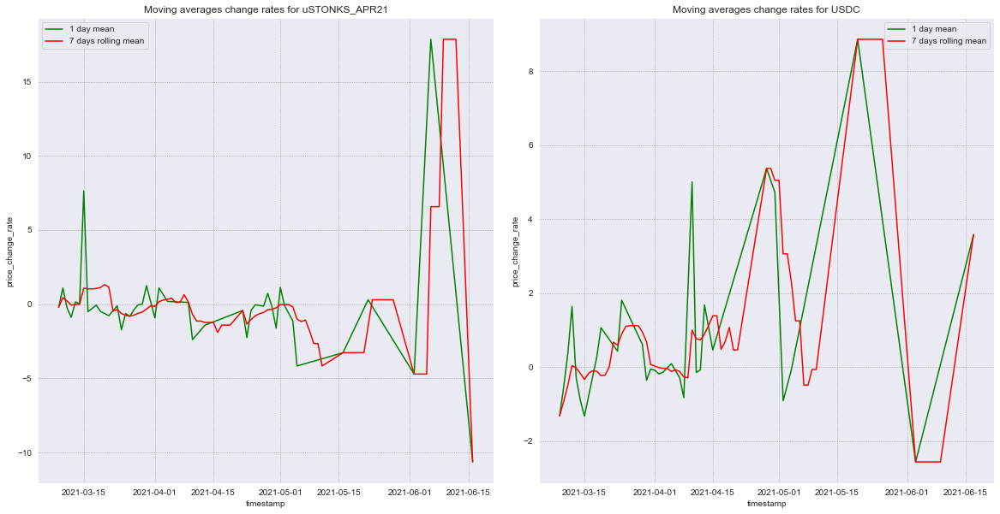

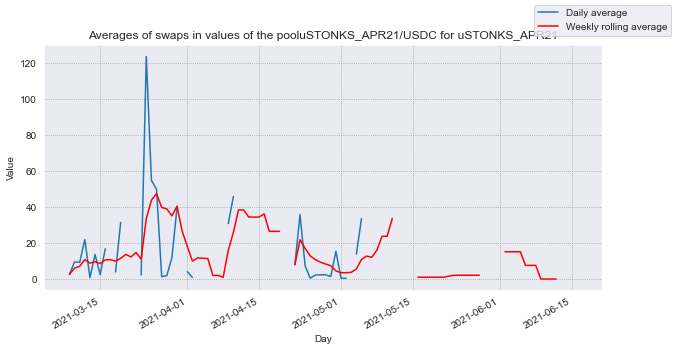

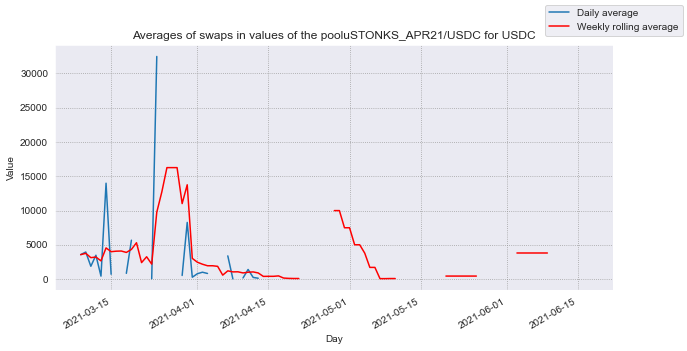

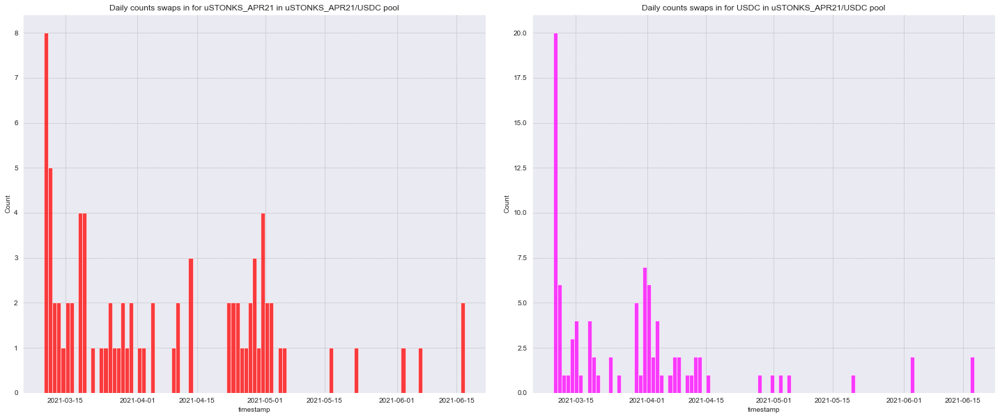

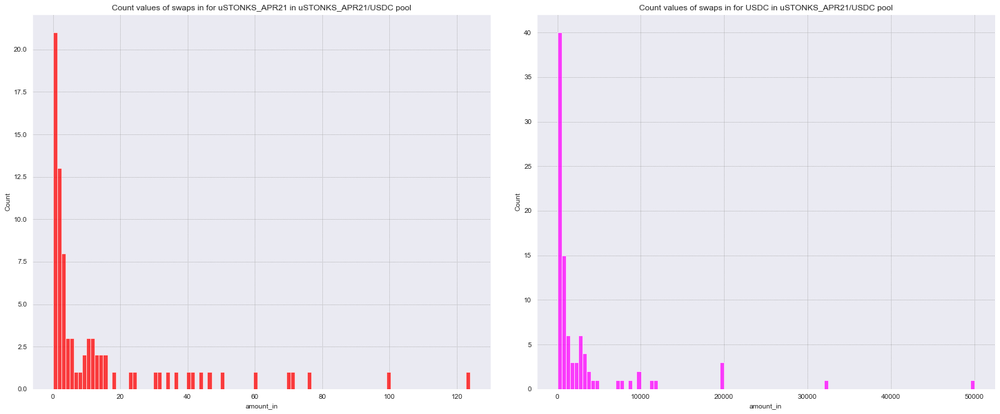

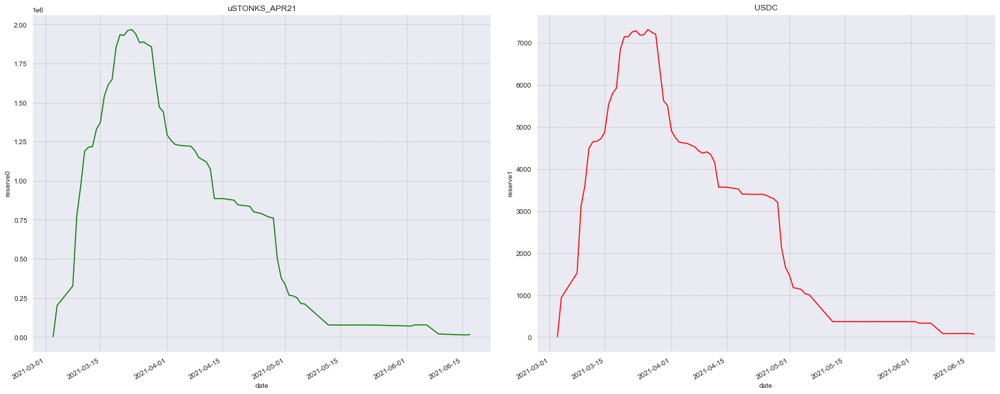

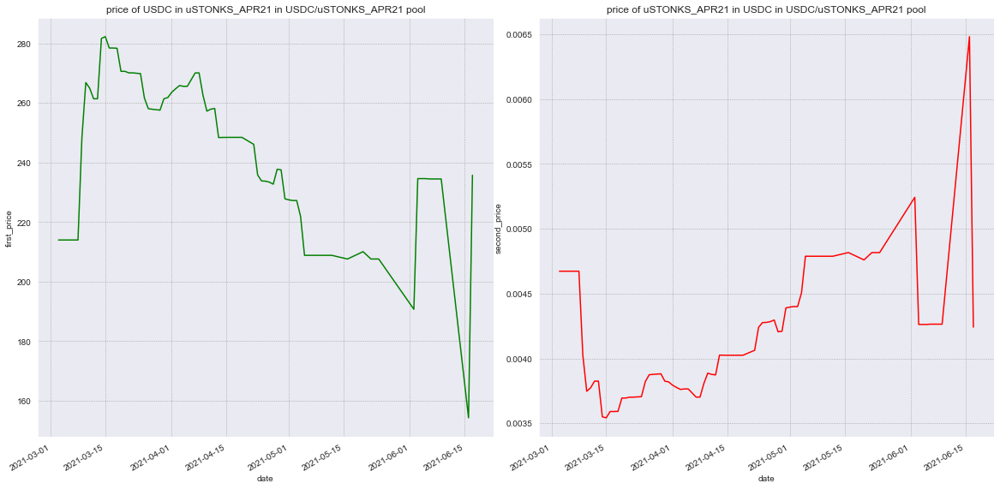

In [254]:
stonks_usdc_df = get_df_with_swap_prices_and_change_rates(stonks_usdc_df, 'uSTONKS_APR21', 'USDC')

pyplot_line_swap_prices(stonks_usdc_df, 'uSTONKS_APR21', 'USDC', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

pyplot_line_swap_change_rate(stonks_usdc_df, 'uSTONKS_APR21', 'USDC', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

swaps_price_change_rates_moving_averages(stonks_usdc_df, 'uSTONKS_APR21', 'USDC', 'Moving averages change rates for uSTONKS_APR21',
                                           'Moving averages change rates for USDC', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

show_swaps_amount_in_moving_averages(swaps_df=stonks_usdc_df[(stonks_usdc_df.token_in == 'uSTONKS_APR21')], 
                                     pool_name="uSTONKS_APR21/USDC for uSTONKS_APR21")
show_swaps_amount_in_moving_averages(swaps_df=stonks_usdc_df[(stonks_usdc_df.token_in == 'USDC')], 
                                     pool_name="uSTONKS_APR21/USDC for USDC")

# swapping values histograms
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=stonks_usdc_df[stonks_usdc_df.token_in == 'uSTONKS_APR21'], x='timestamp', 
             bins=(stonks_usdc_df.timestamp[len(stonks_usdc_df) - 1] - stonks_usdc_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for uSTONKS_APR21 in uSTONKS_APR21/USDC pool")
plt.subplot(1, 2, 2)
sns.histplot(data=stonks_usdc_df[stonks_usdc_df.token_in == 'USDC'], x='timestamp', 
             bins=(stonks_usdc_df.timestamp[len(stonks_usdc_df) - 1] - stonks_usdc_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for USDC in uSTONKS_APR21/USDC pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

# swapping in values distribution
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=stonks_usdc_df[stonks_usdc_df.token_in == 'uSTONKS_APR21'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for uSTONKS_APR21 in uSTONKS_APR21/USDC pool")
plt.subplot(1, 2, 2)
sns.histplot(data=stonks_usdc_df[stonks_usdc_df.token_in == 'USDC'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for USDC in uSTONKS_APR21/USDC pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

show_reserves_time_distribution(stonks_usdc_reserves_df,
                                           first_token_reserve_name="uSTONKS_APR21", 
                                           second_token_reserve_name="USDC", x=25, y=10, wspace=0.1)

show_reserve_price_distributions(stonks_usdc_reserves_df, 
                                        first_token_price_name="price of USDC in uSTONKS_APR21 in USDC/uSTONKS_APR21 pool", 
                                        second_token_price_name="price of uSTONKS_APR21 in USDC in USDC/uSTONKS_APR21 pool", 
                                        x=20, y=10, wspace=0.1)

# mAMZN/UST (STO)

In [255]:
amzn_ust_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\amzn_ust_swaps.pkl")
amzn_ust_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\amzn_ust_reserves.pkl")
amzn_ust_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\amzn_ust_mints.pkl")
amzn_ust_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\amzn_ust_burns.pkl")

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


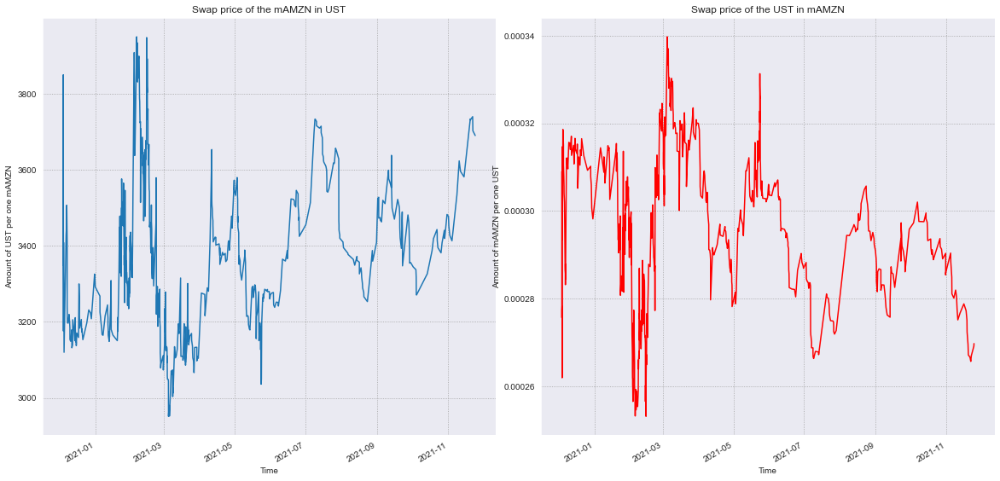

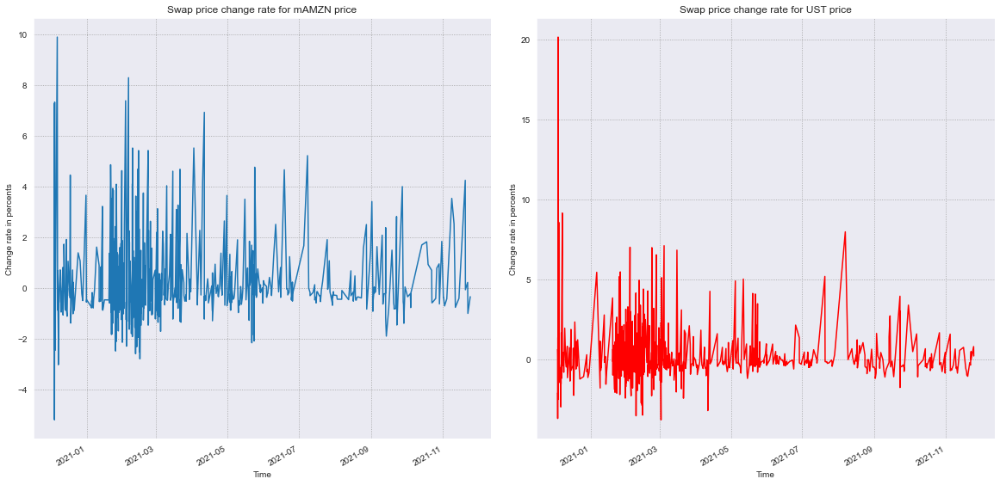

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


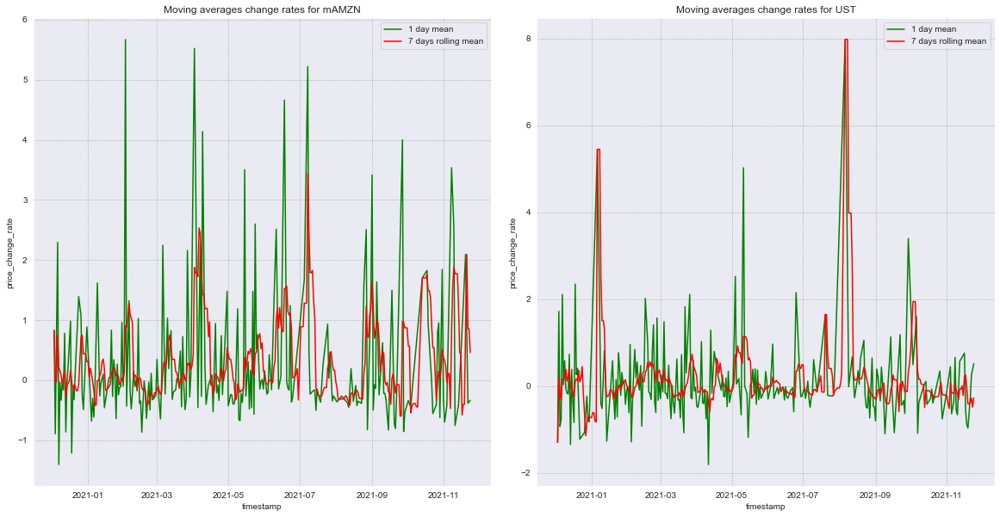

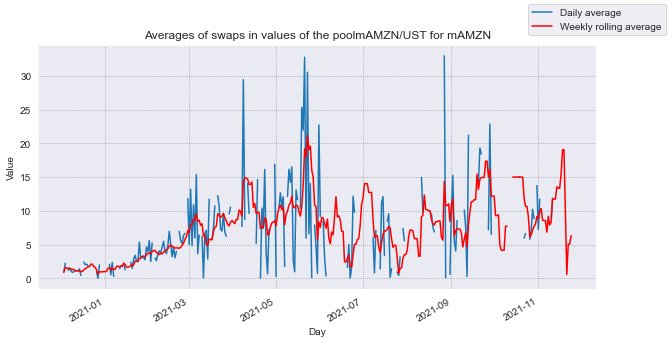

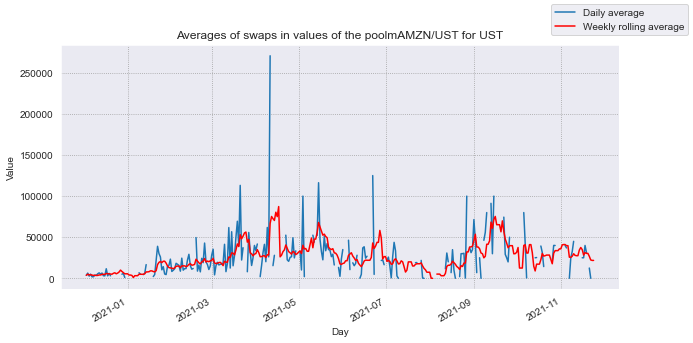

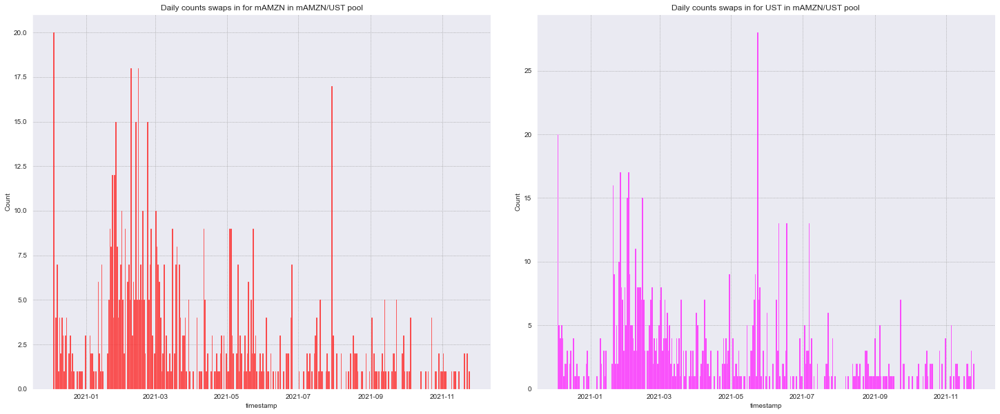

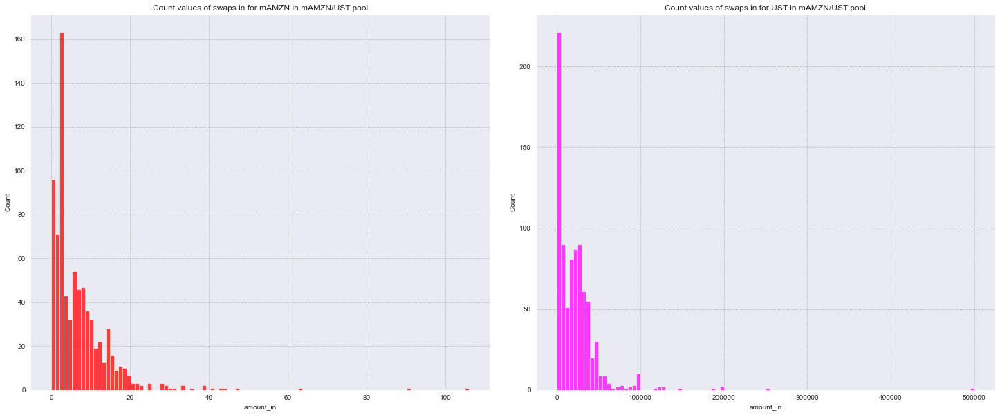

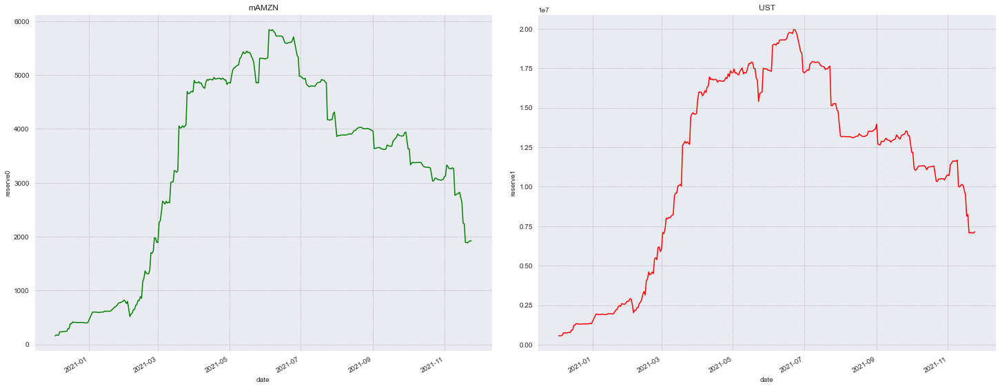

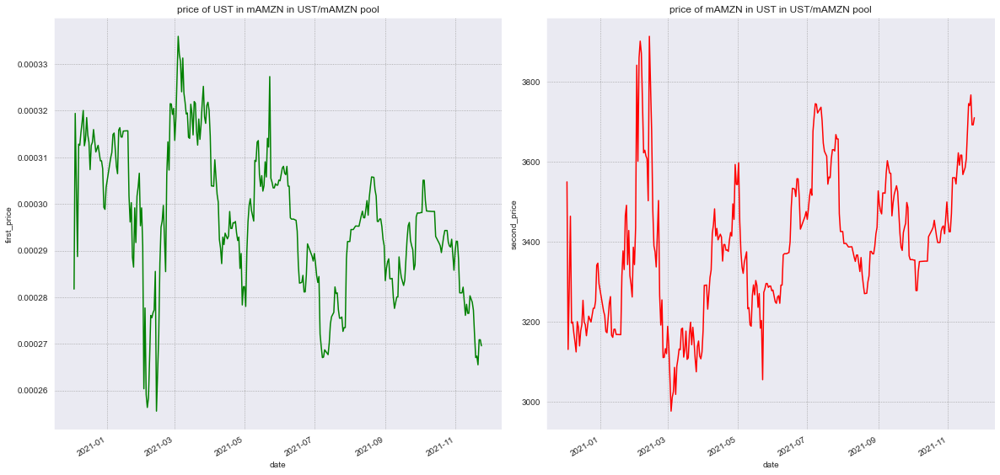

In [256]:
amzn_ust_df = get_df_with_swap_prices_and_change_rates(amzn_ust_df, 'mAMZN', 'UST')

pyplot_line_swap_prices(amzn_ust_df, 'mAMZN', 'UST', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

pyplot_line_swap_change_rate(amzn_ust_df, 'mAMZN', 'UST', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

swaps_price_change_rates_moving_averages(amzn_ust_df, 'mAMZN', 'UST', 'Moving averages change rates for mAMZN',
                                           'Moving averages change rates for UST', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

show_swaps_amount_in_moving_averages(swaps_df=amzn_ust_df[(amzn_ust_df.token_in == 'mAMZN')], 
                                     pool_name="mAMZN/UST for mAMZN")
show_swaps_amount_in_moving_averages(swaps_df=amzn_ust_df[(amzn_ust_df.token_in == 'UST')], 
                                     pool_name="mAMZN/UST for UST")

# swapping values histograms
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=amzn_ust_df[amzn_ust_df.token_in == 'mAMZN'], x='timestamp', 
             bins=(amzn_ust_df.timestamp[len(amzn_ust_df) - 1] - amzn_ust_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for mAMZN in mAMZN/UST pool")
plt.subplot(1, 2, 2)
sns.histplot(data=amzn_ust_df[amzn_ust_df.token_in == 'UST'], x='timestamp', 
             bins=(amzn_ust_df.timestamp[len(amzn_ust_df) - 1] - amzn_ust_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for UST in mAMZN/UST pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

# swapping in values distribution
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=amzn_ust_df[amzn_ust_df.token_in == 'mAMZN'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for mAMZN in mAMZN/UST pool")
plt.subplot(1, 2, 2)
sns.histplot(data=amzn_ust_df[amzn_ust_df.token_in == 'UST'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for UST in mAMZN/UST pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

show_reserves_time_distribution(amzn_ust_reserves_df,
                                           first_token_reserve_name="mAMZN", 
                                           second_token_reserve_name="UST", x=25, y=10, wspace=0.1)

show_reserve_price_distributions(amzn_ust_reserves_df, 
                                        first_token_price_name="price of UST in mAMZN in UST/mAMZN pool", 
                                        second_token_price_name="price of mAMZN in UST in UST/mAMZN pool", 
                                        x=20, y=10, wspace=0.1)

# mBABA/UST (STO)

In [257]:
baba_ust_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\baba_ust_swaps.pkl")
baba_ust_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\baba_ust_reserves.pkl")
baba_ust_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\baba_ust_mints.pkl")
baba_ust_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\baba_ust_burns.pkl")

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


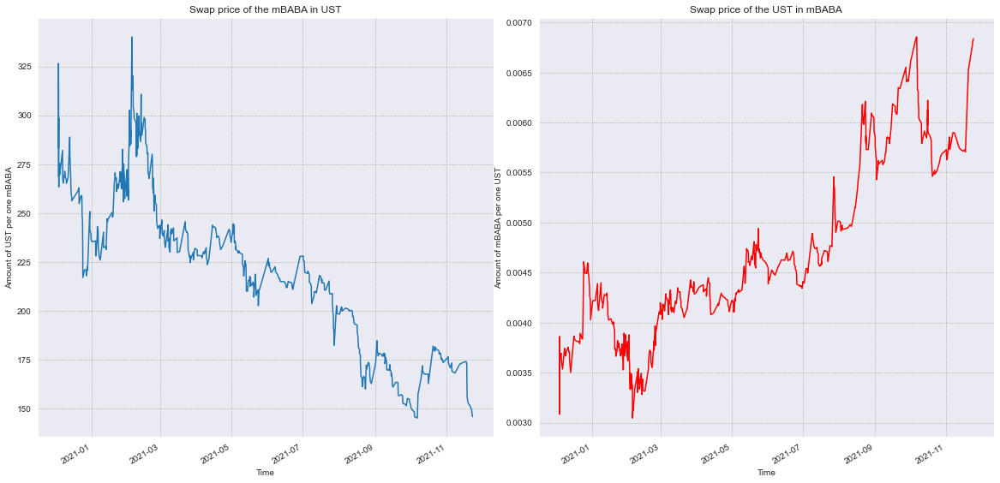

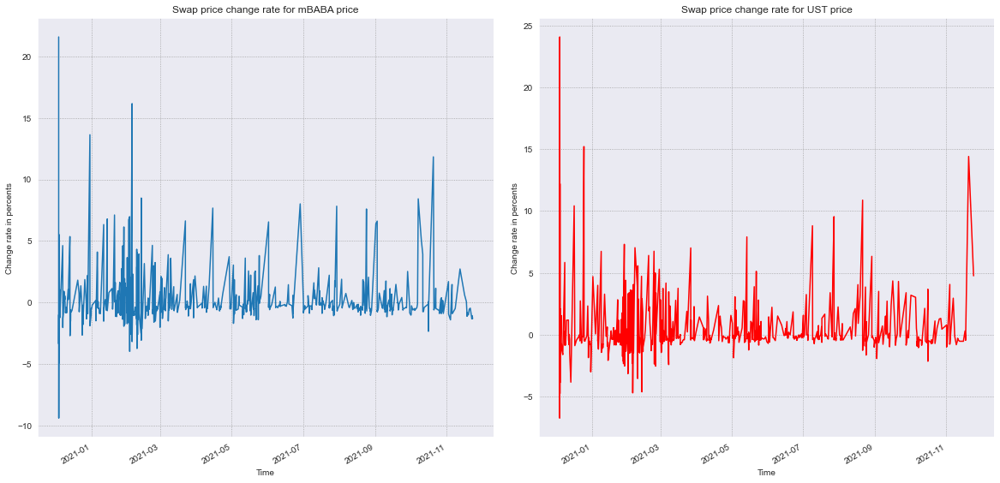

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


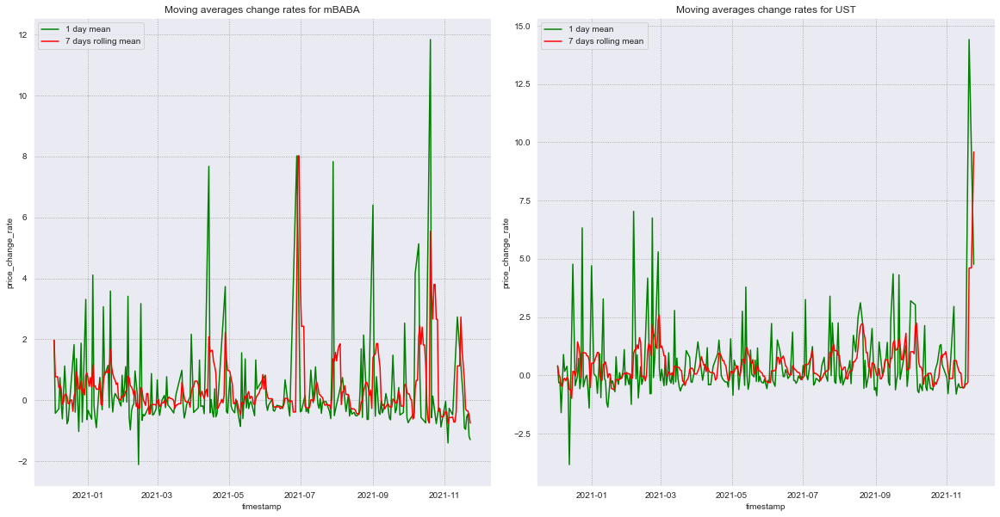

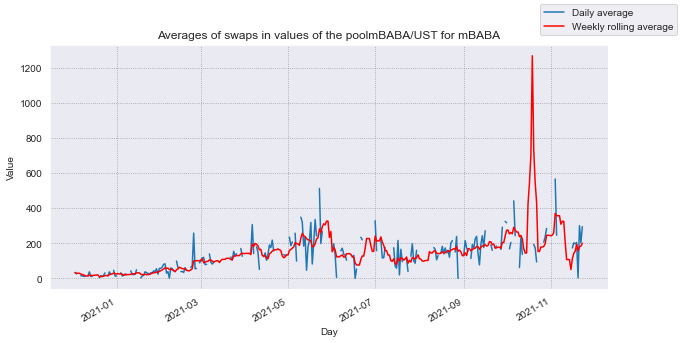

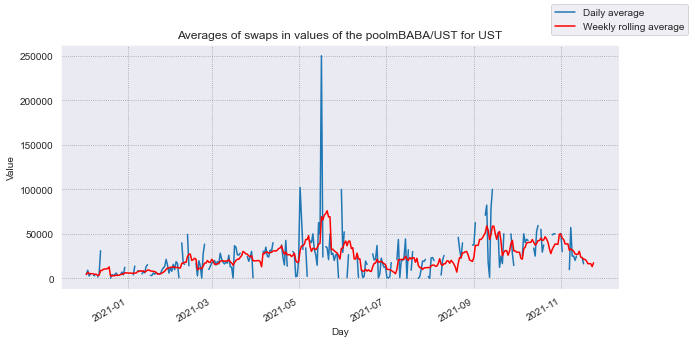

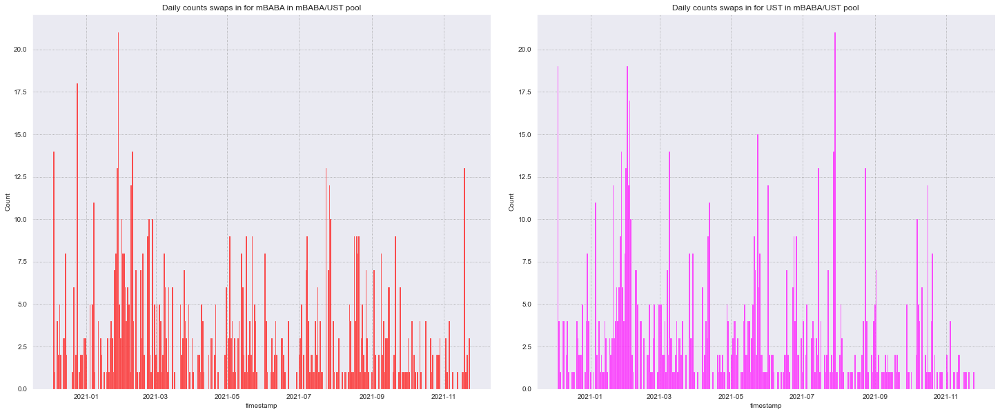

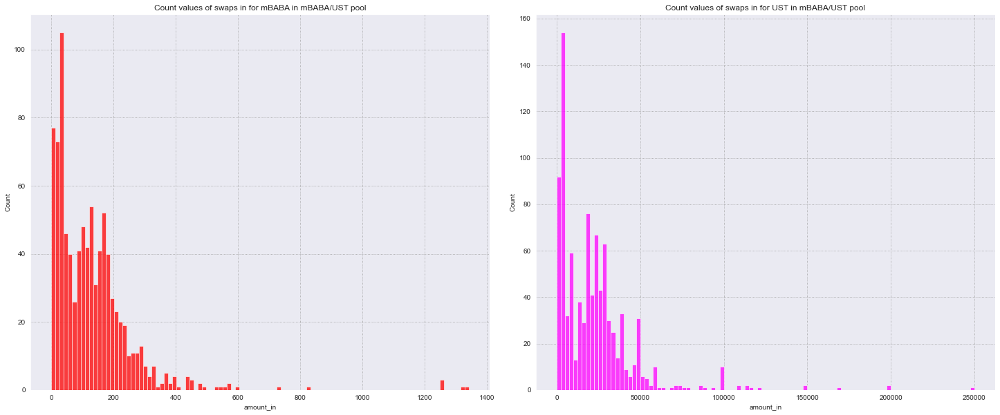

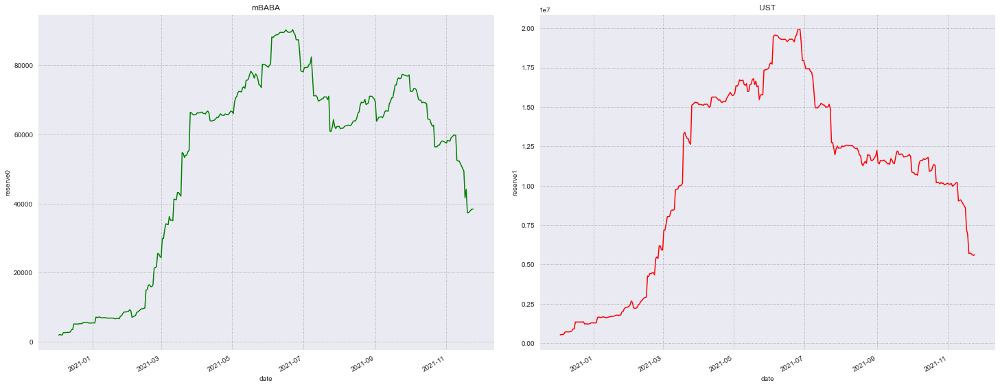

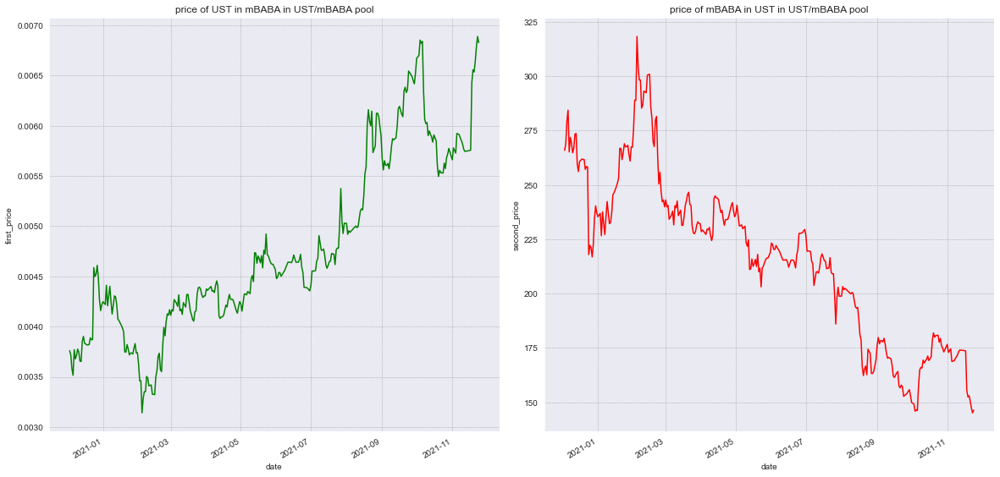

In [258]:
baba_ust_df = get_df_with_swap_prices_and_change_rates(baba_ust_df, 'mBABA', 'UST')

pyplot_line_swap_prices(baba_ust_df, 'mBABA', 'UST', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

pyplot_line_swap_change_rate(baba_ust_df, 'mBABA', 'UST', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

swaps_price_change_rates_moving_averages(baba_ust_df, 'mBABA', 'UST', 'Moving averages change rates for mBABA',
                                           'Moving averages change rates for UST', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

show_swaps_amount_in_moving_averages(swaps_df=baba_ust_df[(baba_ust_df.token_in == 'mBABA')], 
                                     pool_name="mBABA/UST for mBABA")
show_swaps_amount_in_moving_averages(swaps_df=baba_ust_df[(baba_ust_df.token_in == 'UST')], 
                                     pool_name="mBABA/UST for UST")

# swapping values histograms
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=baba_ust_df[baba_ust_df.token_in == 'mBABA'], x='timestamp', 
             bins=(baba_ust_df.timestamp[len(baba_ust_df) - 1] - baba_ust_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for mBABA in mBABA/UST pool")
plt.subplot(1, 2, 2)
sns.histplot(data=baba_ust_df[baba_ust_df.token_in == 'UST'], x='timestamp', 
             bins=(baba_ust_df.timestamp[len(baba_ust_df) - 1] - baba_ust_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for UST in mBABA/UST pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

# swapping in values distribution
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=baba_ust_df[baba_ust_df.token_in == 'mBABA'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for mBABA in mBABA/UST pool")
plt.subplot(1, 2, 2)
sns.histplot(data=baba_ust_df[baba_ust_df.token_in == 'UST'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for UST in mBABA/UST pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

show_reserves_time_distribution(baba_ust_reserves_df,
                                           first_token_reserve_name="mBABA", 
                                           second_token_reserve_name="UST", x=25, y=10, wspace=0.1)

show_reserve_price_distributions(baba_ust_reserves_df, 
                                        first_token_price_name="price of UST in mBABA in UST/mBABA pool", 
                                        second_token_price_name="price of mBABA in UST in UST/mBABA pool", 
                                        x=20, y=10, wspace=0.1)

# mAPPLE/UST (STO)

In [259]:
apple_ust_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\apple_ust_swaps.pkl")
apple_ust_reserves_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\apple_ust_reserves.pkl")
apple_ust_mints_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\apple_ust_mints.pkl")
apple_ust_burns_df = pd.read_pickle(os.getcwd() + "\\pkl_stories\\apple_ust_burns.pkl")

C:\Users\Zbook\anaconda3\lib\site-packages\pandas\core\generic.py:5494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


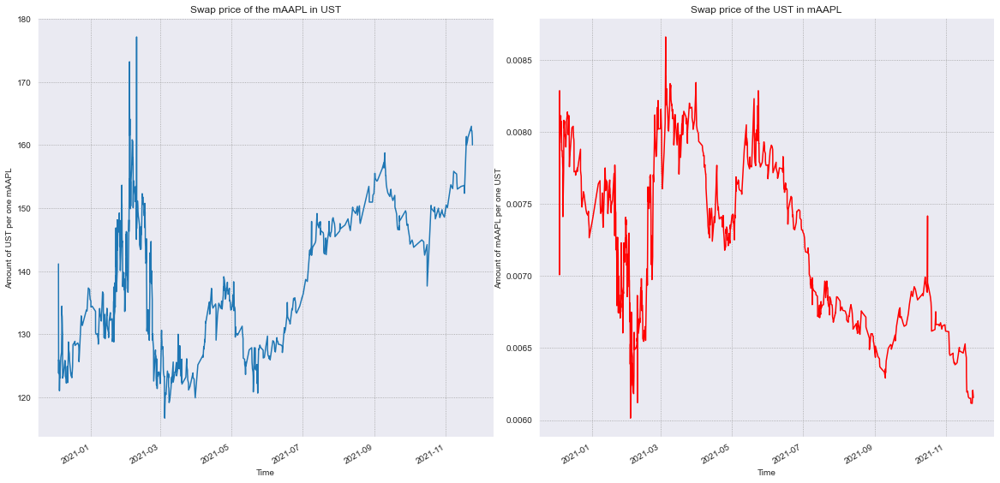

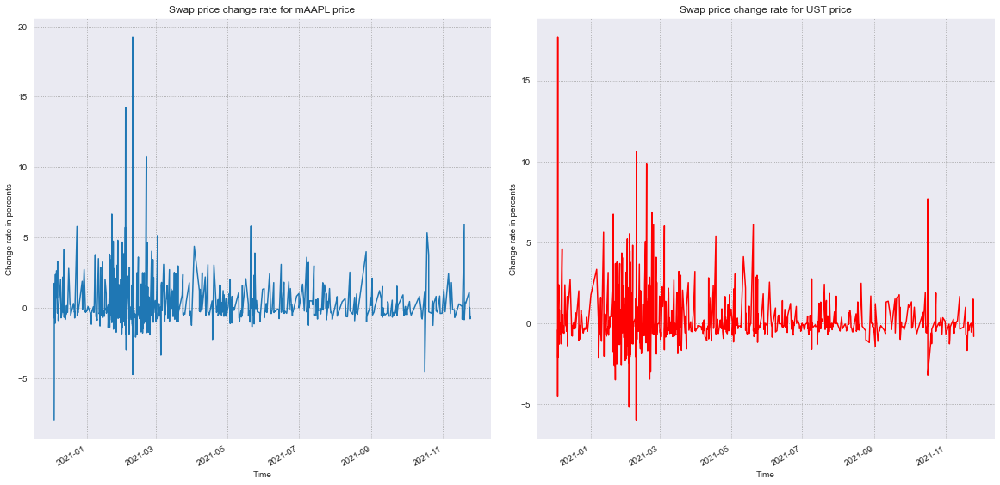

C:/workspace/data-science//libs\uniswap_v2_tools.py:235: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 1)
C:/workspace/data-science//libs\uniswap_v2_tools.py:242: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(1, 2, 2)


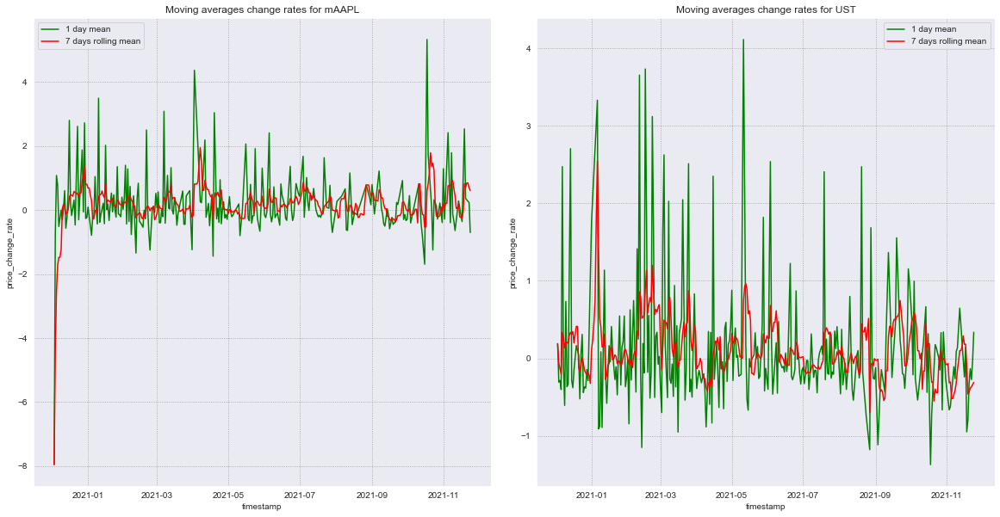

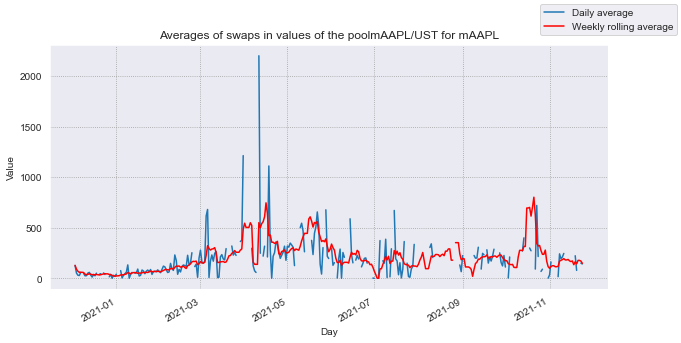

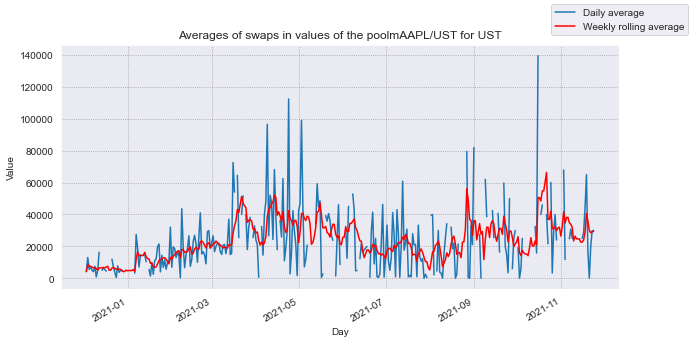

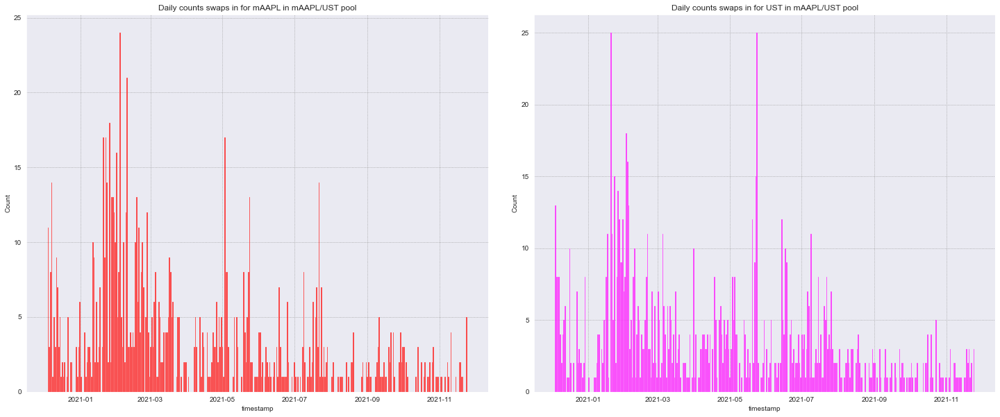

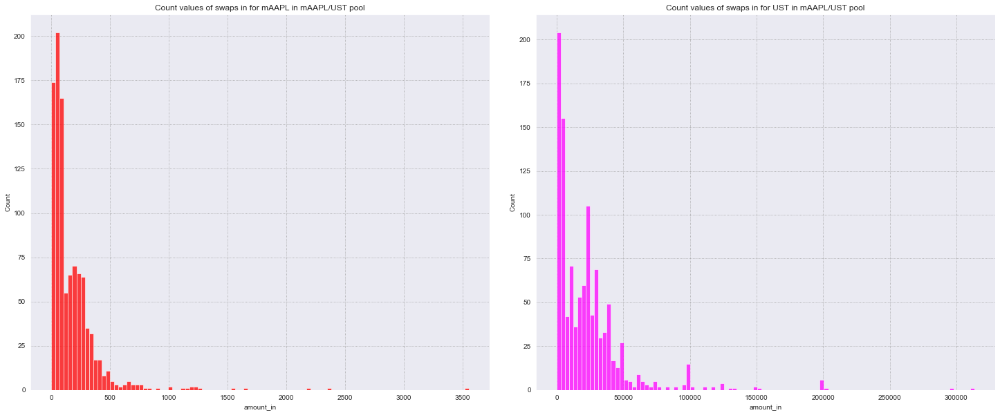

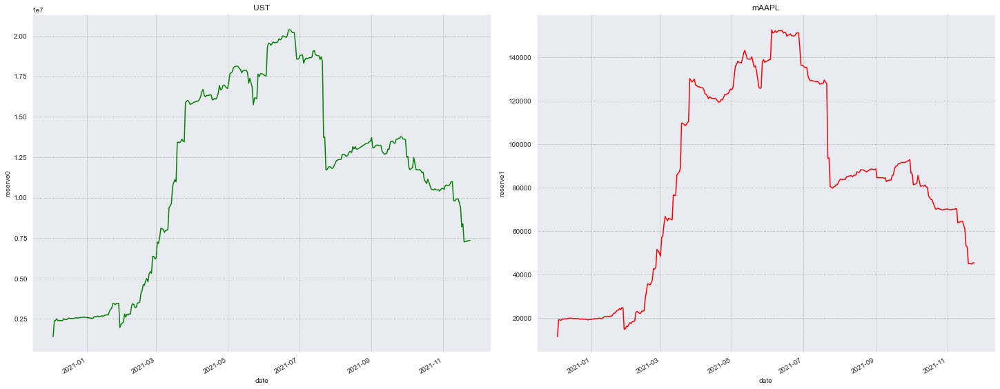

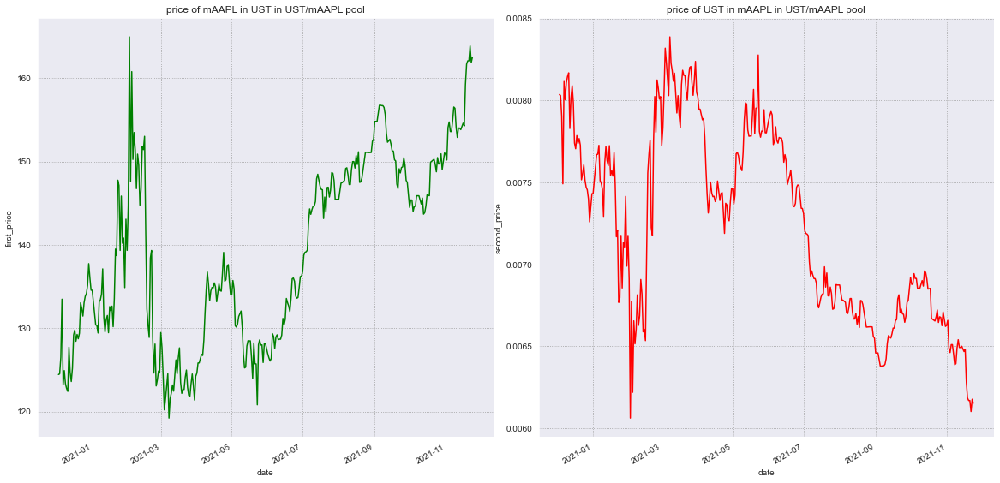

In [260]:
apple_ust_df = get_df_with_swap_prices_and_change_rates(apple_ust_df, 'mAAPL', 'UST')

pyplot_line_swap_prices(apple_ust_df, 'mAAPL', 'UST', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

pyplot_line_swap_change_rate(apple_ust_df, 'mAAPL', 'UST', xsize=20, ysize=10, wspace=0.1, hspace=0.1)

swaps_price_change_rates_moving_averages(apple_ust_df, 'mAAPL', 'UST', 'Moving averages change rates for mAAPL',
                                           'Moving averages change rates for UST', x_size=20, y_size=10, wspace=0.1, hspace=0.1)

show_swaps_amount_in_moving_averages(swaps_df=apple_ust_df[(apple_ust_df.token_in == 'mAAPL')], 
                                     pool_name="mAAPL/UST for mAAPL")
show_swaps_amount_in_moving_averages(swaps_df=apple_ust_df[(apple_ust_df.token_in == 'UST')], 
                                     pool_name="mAAPL/UST for UST")

# swapping values histograms
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=apple_ust_df[apple_ust_df.token_in == 'mAAPL'], x='timestamp', 
             bins=(apple_ust_df.timestamp[len(apple_ust_df) - 1] - apple_ust_df.timestamp[0]).days, 
             color='red').set_title("Daily counts swaps in for mAAPL in mAAPL/UST pool")
plt.subplot(1, 2, 2)
sns.histplot(data=apple_ust_df[apple_ust_df.token_in == 'UST'], x='timestamp', 
             bins=(apple_ust_df.timestamp[len(apple_ust_df) - 1] - apple_ust_df.timestamp[0]).days, 
             color='magenta').set_title("Daily counts swaps in for UST in mAAPL/UST pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

# swapping in values distribution
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
sns.histplot(data=apple_ust_df[apple_ust_df.token_in == 'mAAPL'], x='amount_in', bins=100, 
             color='red').set_title("Count values of swaps in for mAAPL in mAAPL/UST pool")
plt.subplot(1, 2, 2)
sns.histplot(data=apple_ust_df[apple_ust_df.token_in == 'UST'], x='amount_in', bins=100, 
             color='magenta').set_title("Count values of swaps in for UST in mAAPL/UST pool")
plt.subplots_adjust(wspace=0.1)
plt.show()

show_reserves_time_distribution(apple_ust_reserves_df, "UST", "mAAPL", x=25, y=10, wspace=0.1)

show_reserve_price_distributions(apple_ust_reserves_df, 
                                        first_token_price_name="price of mAAPL in UST in UST/mAAPL pool", 
                                        second_token_price_name="price of UST in mAAPL in UST/mAAPL pool", 
                                        x=20, y=10, wspace=0.1)